In [1]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [3]:
from utils import Logger

In [6]:
def mnist_data():
    compose = transforms.Compose(
    [transforms.ToTensor(),
    transforms.Normalize((.5,.5,.5),(.5,.5,.5))
    ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir,train=True,transform=compose,download=True)

# Load data
data = mnist_data()

# Create loader with data, so we can iterate over it
data_loader = torch.utils.data.DataLoader(data,batch_size=100,shuffle=True)

# Calculate the number of batches
num_batches = len(data_loader)

In [8]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden1 = nn.Sequential(
            nn.Linear(1024,512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden2 = nn.Sequential(
            nn.Linear(512,256),
            nn.LeakyReLU(0.3),
            nn.Dropout(0.3)
        )
        
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
    
discriminator = DiscriminatorNet()

In [9]:
# Image conversion to vector, and vice-versa

def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0),1,28,28)

In [10]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden1 = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )
        
    def forward(self,x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
    
generator = GeneratorNet()

In [11]:
# Create random noise to feed Generator
def noise(size):
    """
    Generates a 1-d vector of gaussian sampled random values
    """
    n = Variable(torch.randn(size,100))
    return n

In [12]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [13]:
loss = nn.BCELoss()

In [15]:
def ones_target(size):
    """
    Tensor containing ones, with shape = size
    """
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    """
    Tensor containing zeros, with shape = size
    """
    data = Variable(torch.zeros(size,1))
    return data

In [16]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()
    
    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [17]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    
    # Reset gradients
    optimizer.zero_grad()
    
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    
    # Update weights with gradients
    optimizer.step()
    
    # Return error
    return error

In [18]:
# To view how the GAN is learning, we will take a static batch of noise
# To test every few steps
num_test_samples = 16
test_noise = noise(num_test_samples)

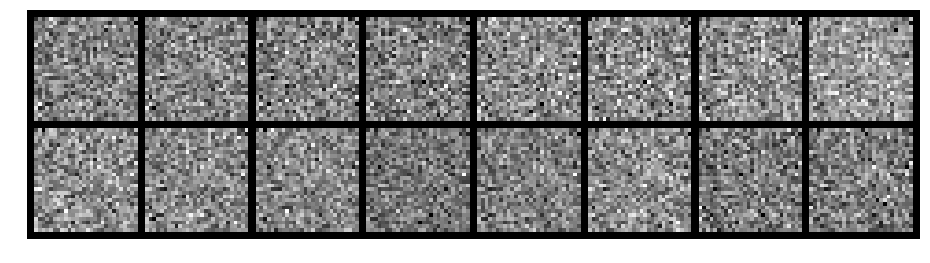

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3580, Generator Loss: 0.6965
D(x): 0.5134, D(G(z)): 0.4988


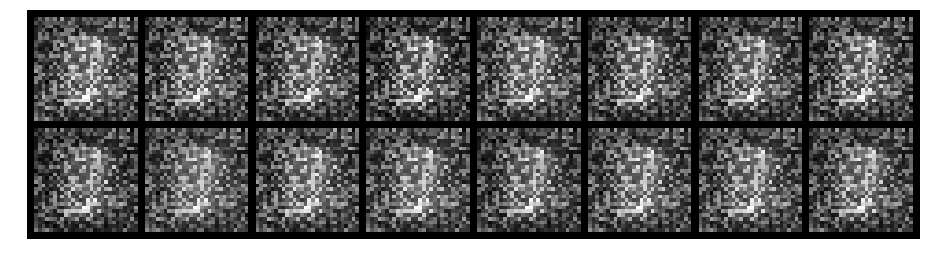

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.7808, Generator Loss: 2.1329
D(x): 0.8821, D(G(z)): 0.4280


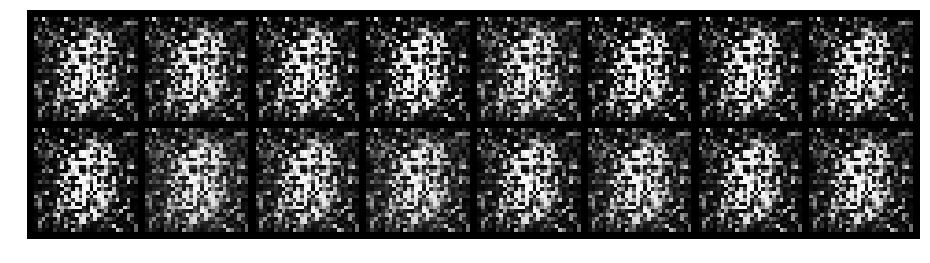

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.3789, Generator Loss: 3.8565
D(x): 0.8767, D(G(z)): 0.1628


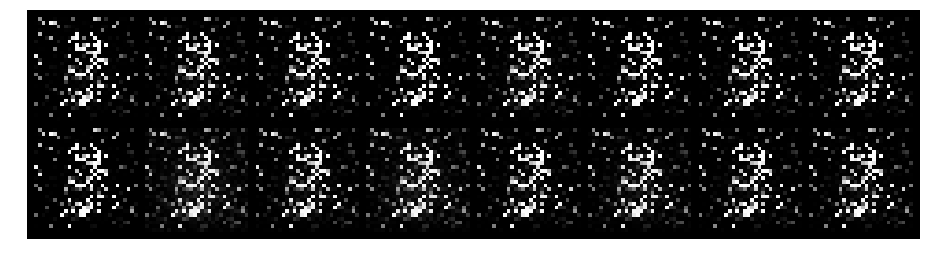

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0956, Generator Loss: 5.9606
D(x): 0.9570, D(G(z)): 0.0420


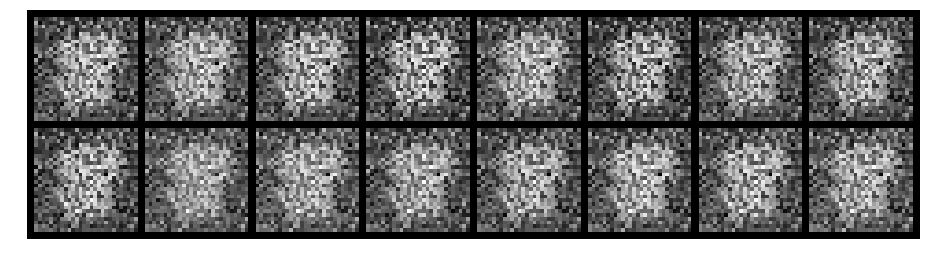

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 2.7125, Generator Loss: 0.2629
D(x): 0.8021, D(G(z)): 0.8755


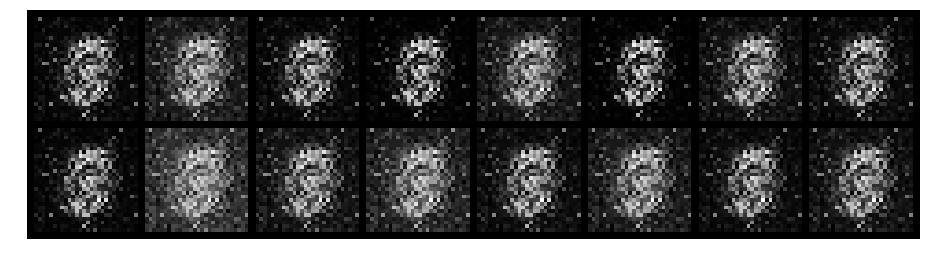

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.7750, Generator Loss: 1.8352
D(x): 0.6804, D(G(z)): 0.2636


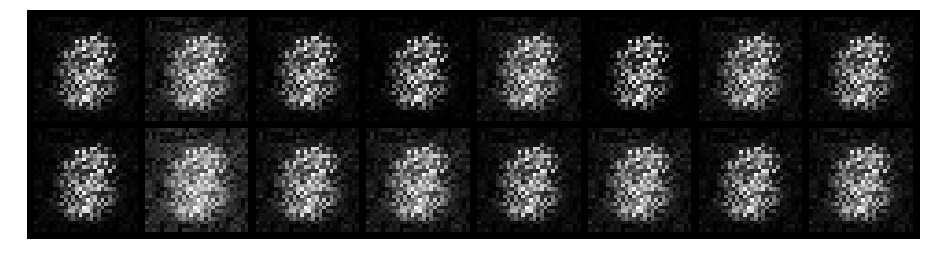

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.3029, Generator Loss: 2.3131
D(x): 0.8715, D(G(z)): 0.1391


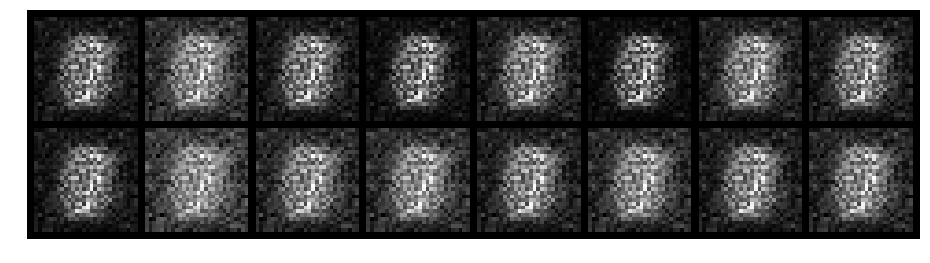

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.7986, Generator Loss: 0.7728
D(x): 0.6022, D(G(z)): 0.6285


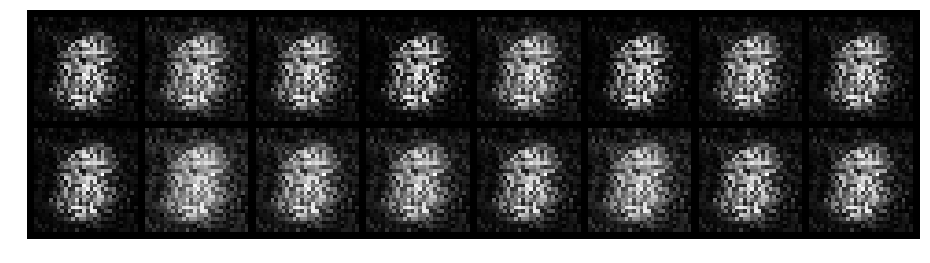

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.4664, Generator Loss: 1.2629
D(x): 0.5741, D(G(z)): 0.4879


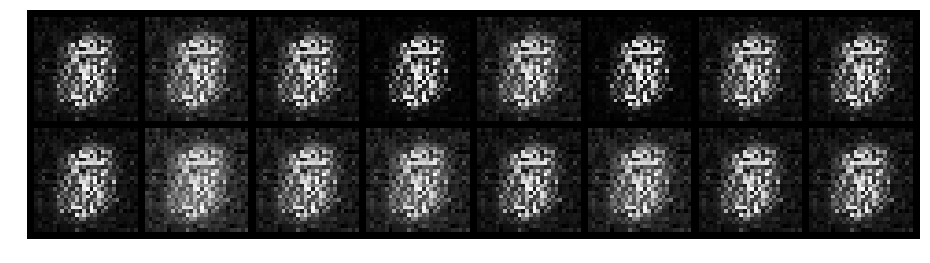

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.5692, Generator Loss: 2.9542
D(x): 0.7915, D(G(z)): 0.2229


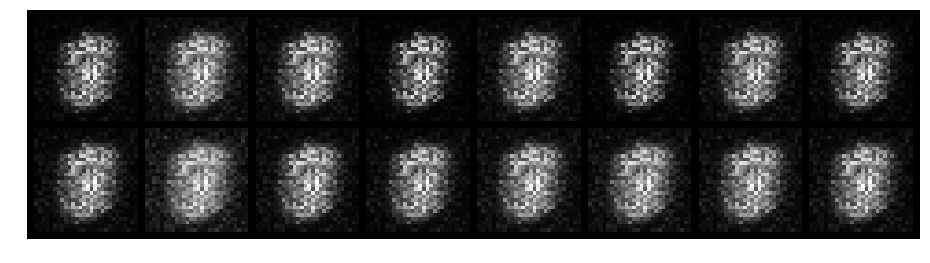

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.1159, Generator Loss: 1.1994
D(x): 0.5864, D(G(z)): 0.3926


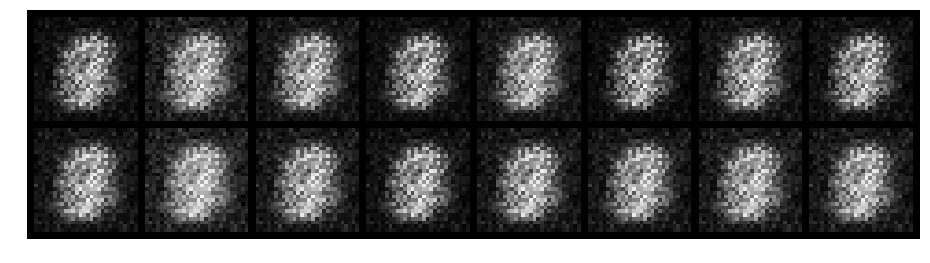

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.2287, Generator Loss: 0.9608
D(x): 0.6502, D(G(z)): 0.4950


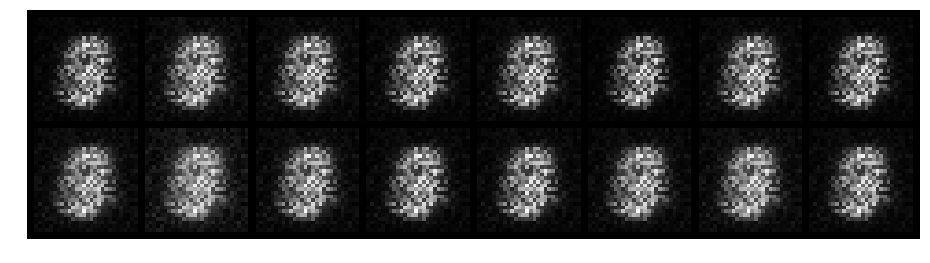

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.6534, Generator Loss: 2.1578
D(x): 0.7913, D(G(z)): 0.2897


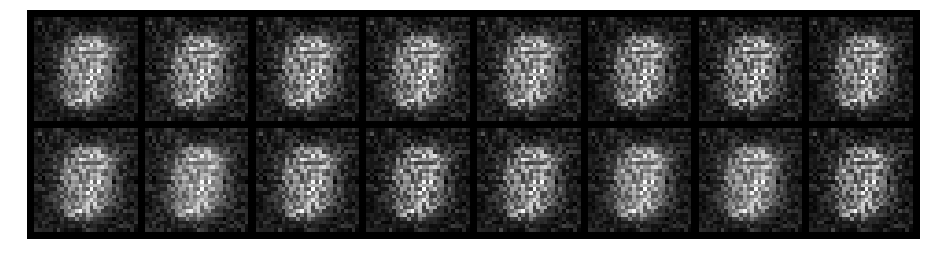

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.9846, Generator Loss: 1.3378
D(x): 0.7654, D(G(z)): 0.4592


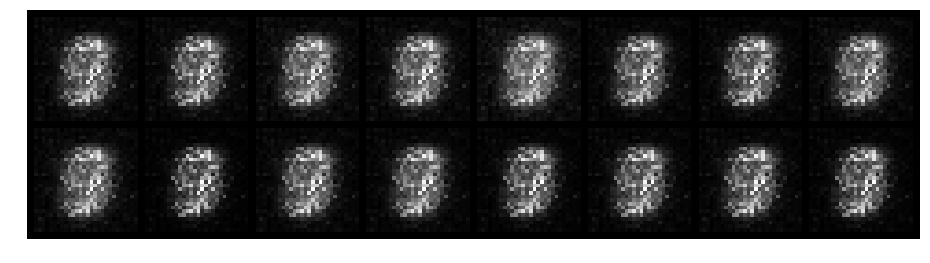

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.8749, Generator Loss: 0.4569
D(x): 0.5614, D(G(z)): 0.6809


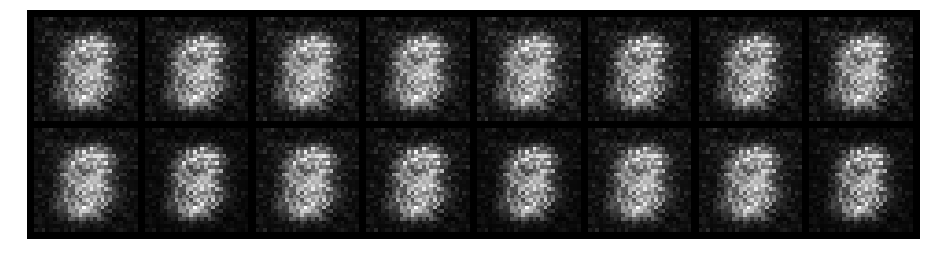

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.3830, Generator Loss: 1.7918
D(x): 0.8632, D(G(z)): 0.1908


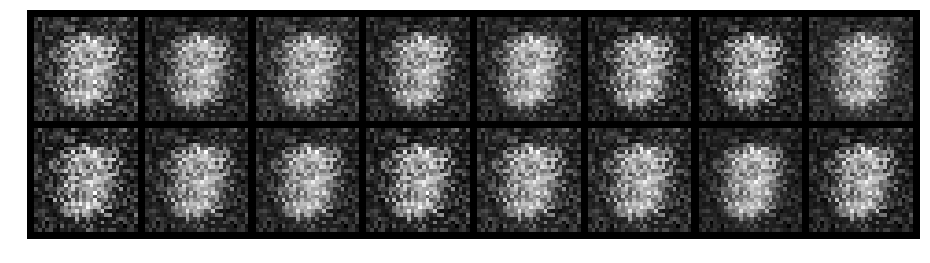

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.7123, Generator Loss: 1.4823
D(x): 0.8023, D(G(z)): 0.3141


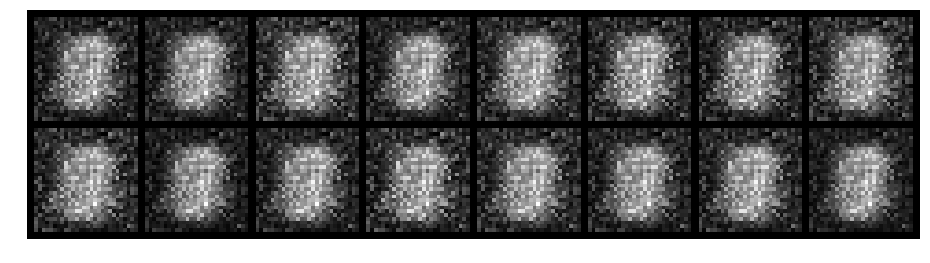

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.0738, Generator Loss: 0.9161
D(x): 0.7718, D(G(z)): 0.4958


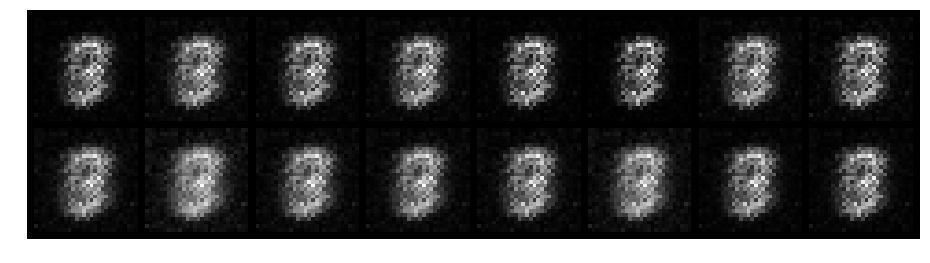

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.5269, Generator Loss: 2.4772
D(x): 0.8379, D(G(z)): 0.2211


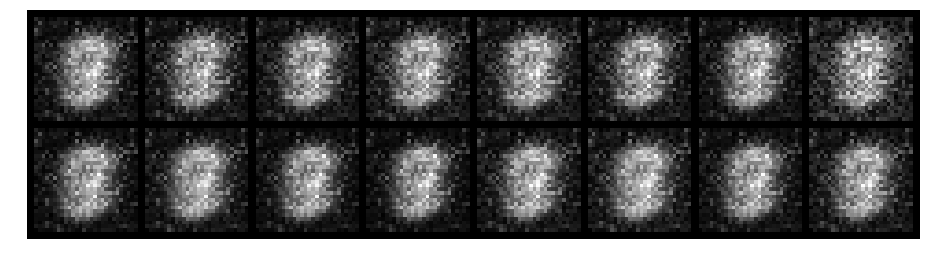

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.3322, Generator Loss: 0.9297
D(x): 0.6217, D(G(z)): 0.4775


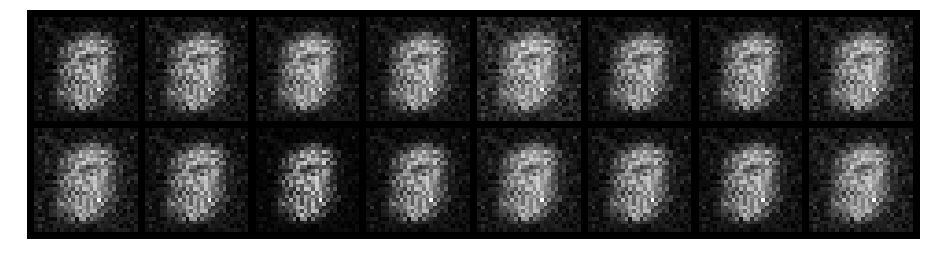

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.6417, Generator Loss: 2.2417
D(x): 0.7789, D(G(z)): 0.1761


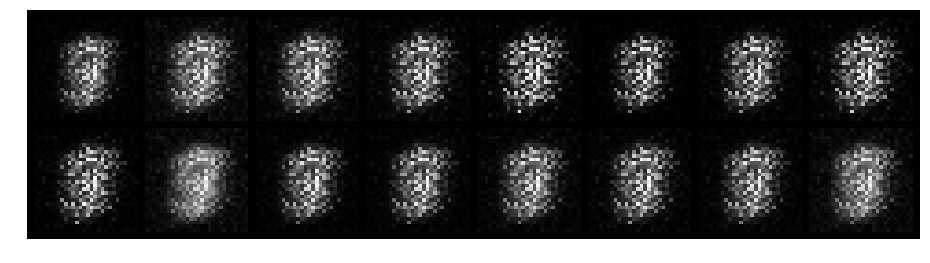

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.6045, Generator Loss: 3.2918
D(x): 0.8246, D(G(z)): 0.2135


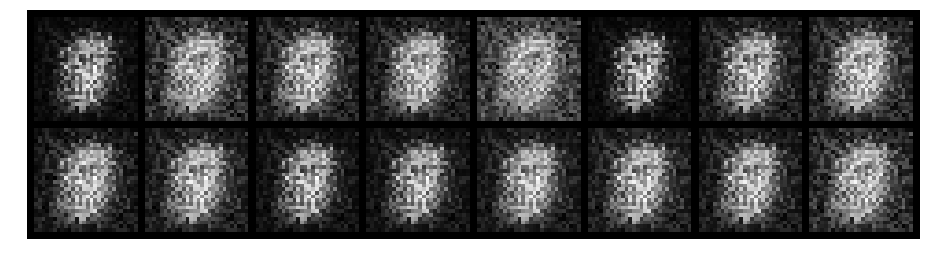

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6470, Generator Loss: 2.2482
D(x): 0.8571, D(G(z)): 0.2439


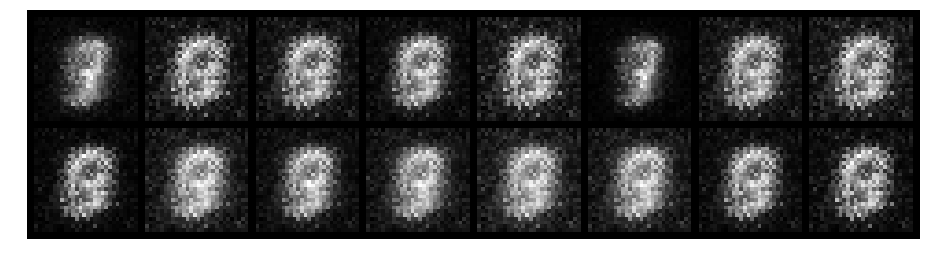

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.6453, Generator Loss: 2.1568
D(x): 0.7985, D(G(z)): 0.2254


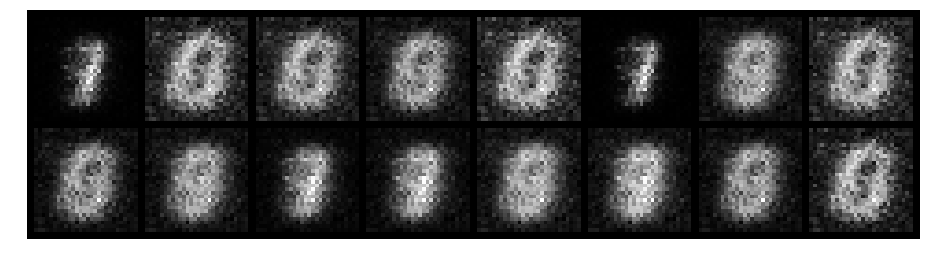

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 1.1382, Generator Loss: 1.4082
D(x): 0.7455, D(G(z)): 0.3901


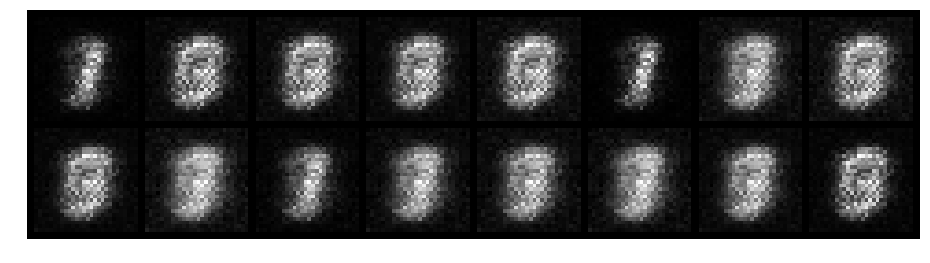

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.6763, Generator Loss: 1.7563
D(x): 0.8182, D(G(z)): 0.2722


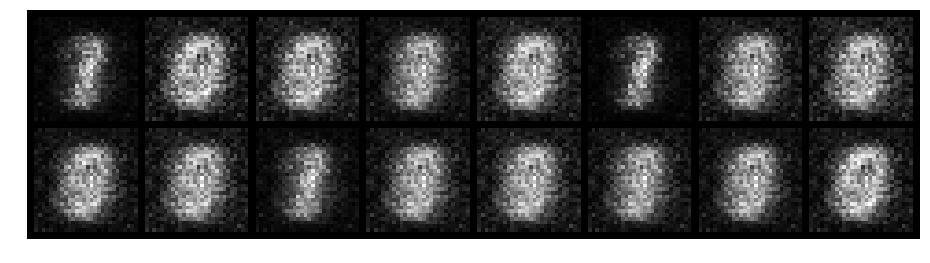

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5740, Generator Loss: 2.3578
D(x): 0.8278, D(G(z)): 0.1734


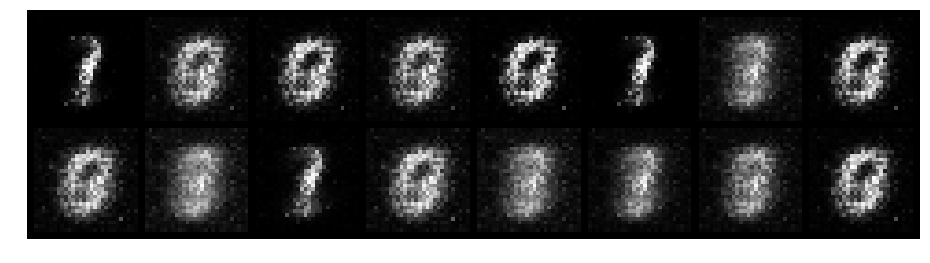

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.2083, Generator Loss: 2.6476
D(x): 0.9358, D(G(z)): 0.1125


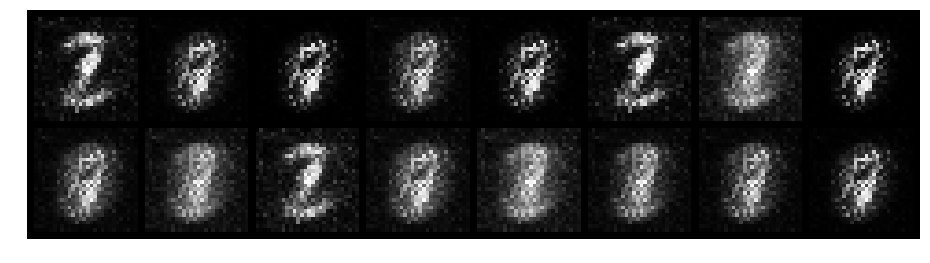

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.6334, Generator Loss: 3.2564
D(x): 0.8599, D(G(z)): 0.2291


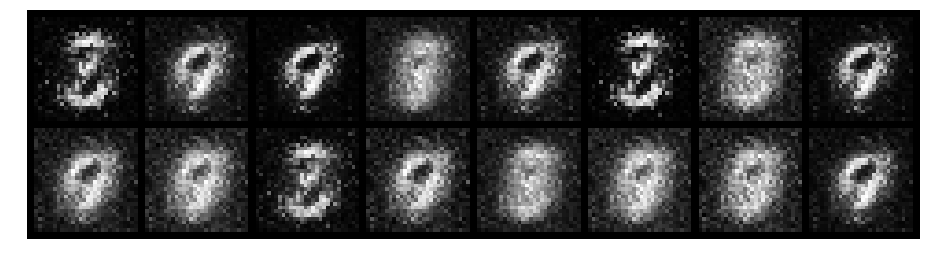

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.2360, Generator Loss: 2.9517
D(x): 0.9520, D(G(z)): 0.1209


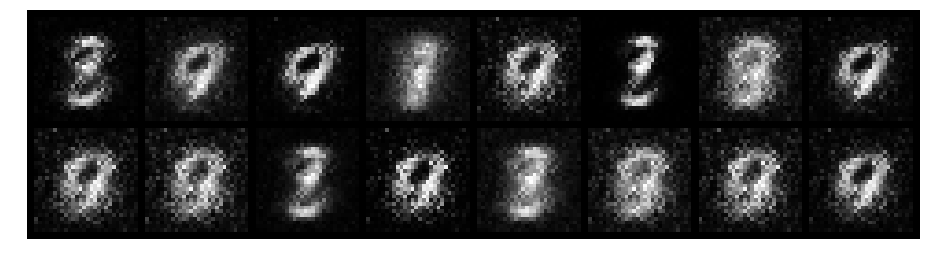

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.3964, Generator Loss: 3.0178
D(x): 0.8731, D(G(z)): 0.0962


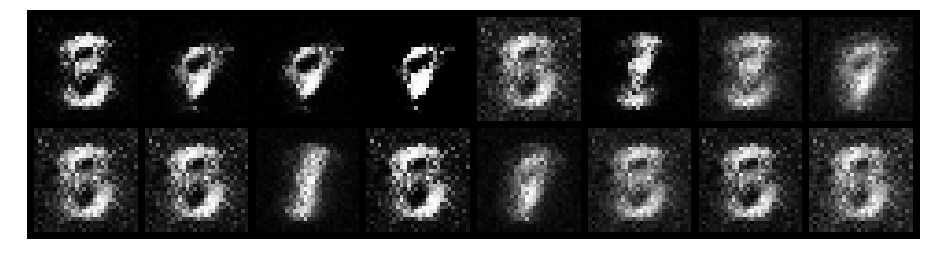

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.7030, Generator Loss: 2.8354
D(x): 0.8548, D(G(z)): 0.2047


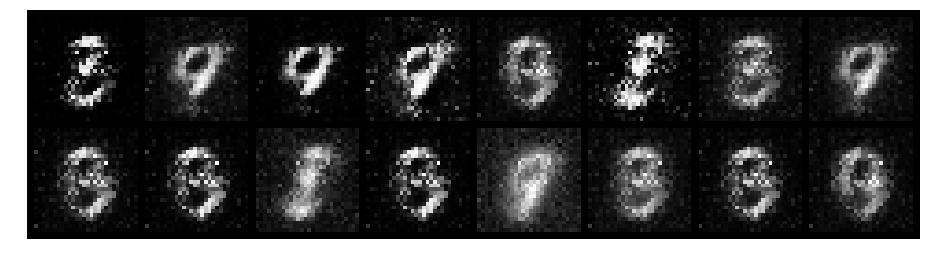

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.4368, Generator Loss: 2.3562
D(x): 0.9041, D(G(z)): 0.2031


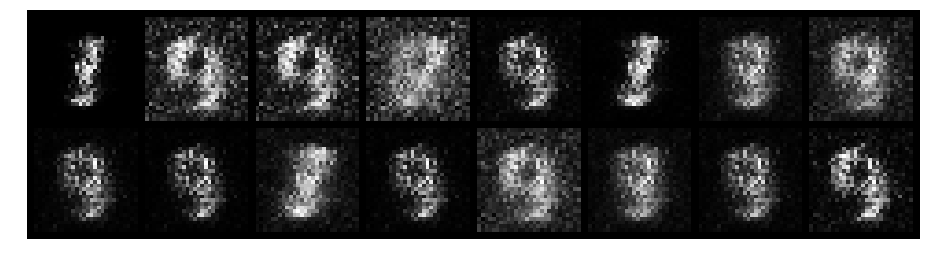

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4511, Generator Loss: 3.5466
D(x): 0.8628, D(G(z)): 0.1162


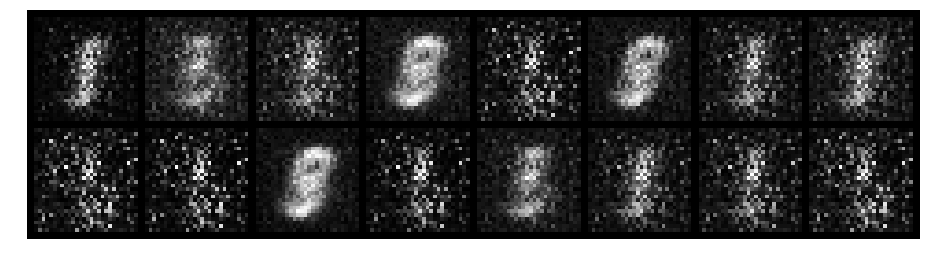

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.6908, Generator Loss: 3.1902
D(x): 0.7870, D(G(z)): 0.1580


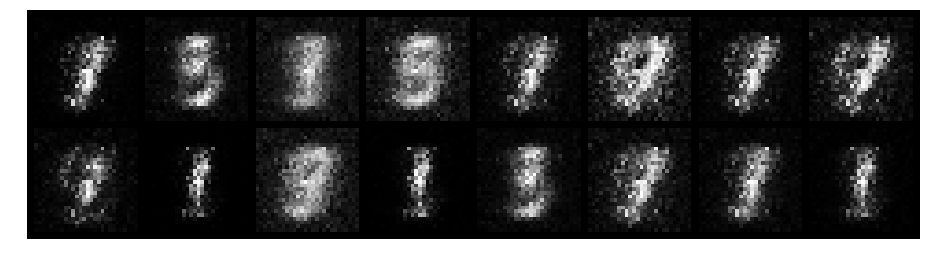

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.5175, Generator Loss: 3.8002
D(x): 0.7899, D(G(z)): 0.0718


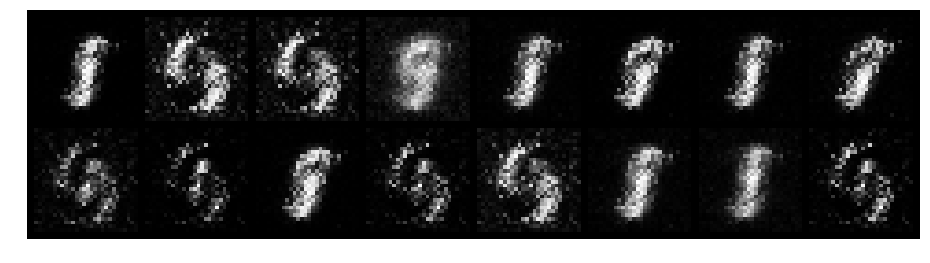

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.5173, Generator Loss: 3.2643
D(x): 0.8385, D(G(z)): 0.1517


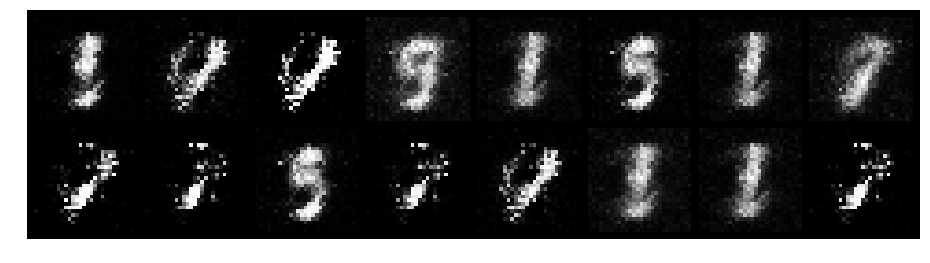

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.6961, Generator Loss: 2.3519
D(x): 0.8069, D(G(z)): 0.2003


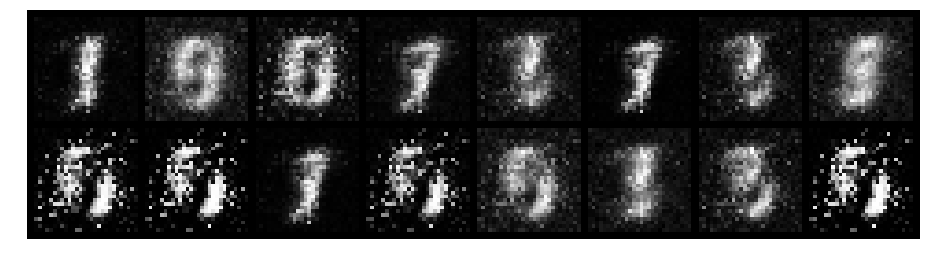

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.5215, Generator Loss: 2.3980
D(x): 0.8131, D(G(z)): 0.1677


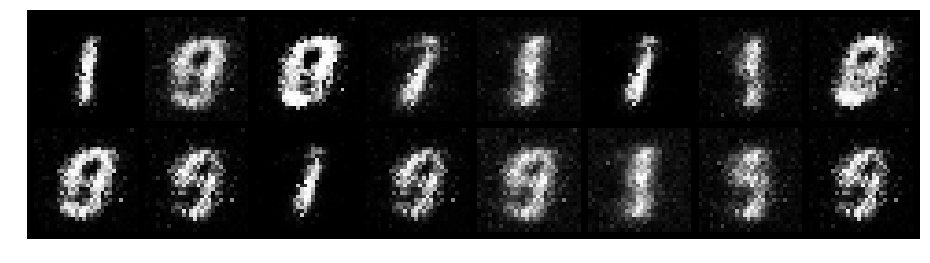

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.5873, Generator Loss: 2.5176
D(x): 0.8651, D(G(z)): 0.2132


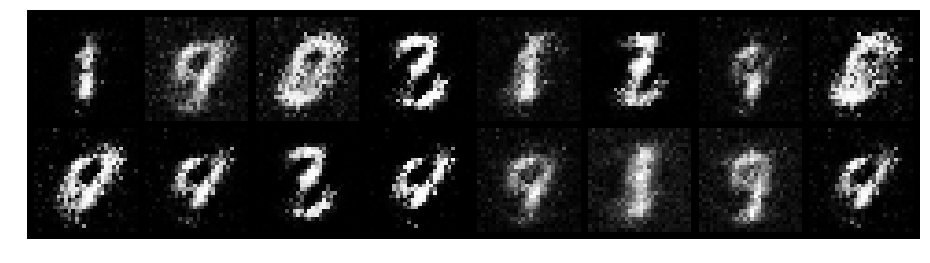

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.6609, Generator Loss: 2.3694
D(x): 0.7785, D(G(z)): 0.1688


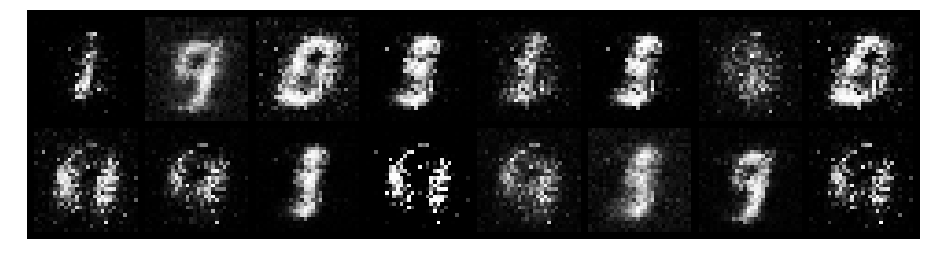

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.6772, Generator Loss: 2.1885
D(x): 0.8944, D(G(z)): 0.3104


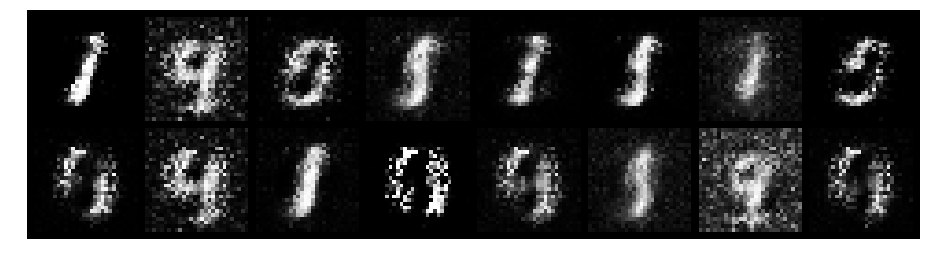

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5441, Generator Loss: 2.6899
D(x): 0.8590, D(G(z)): 0.1992


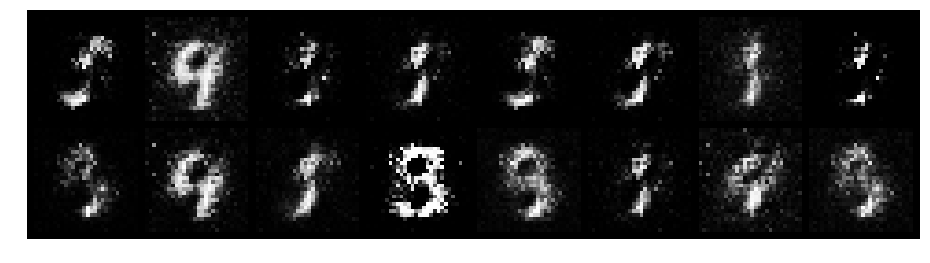

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.4716, Generator Loss: 4.1505
D(x): 0.8288, D(G(z)): 0.0795


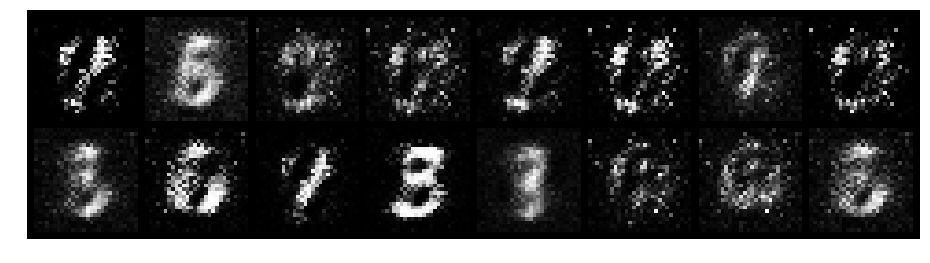

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.8023, Generator Loss: 2.5277
D(x): 0.7471, D(G(z)): 0.1842


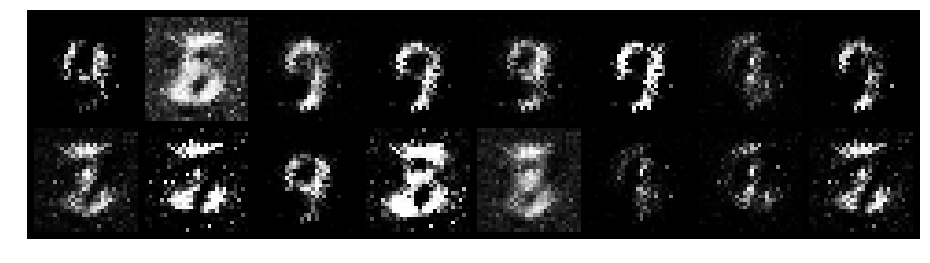

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.5901, Generator Loss: 2.9636
D(x): 0.7952, D(G(z)): 0.1932


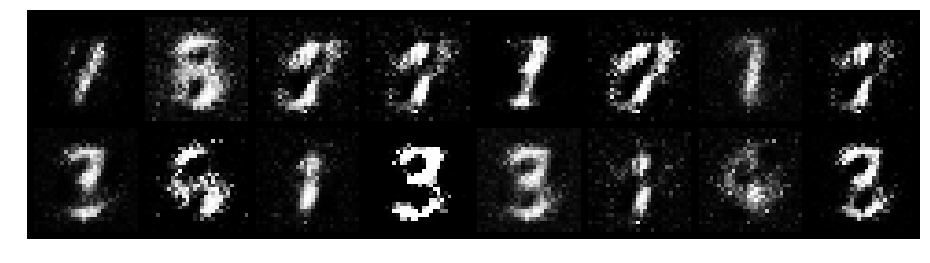

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.7131, Generator Loss: 2.3443
D(x): 0.7112, D(G(z)): 0.1399


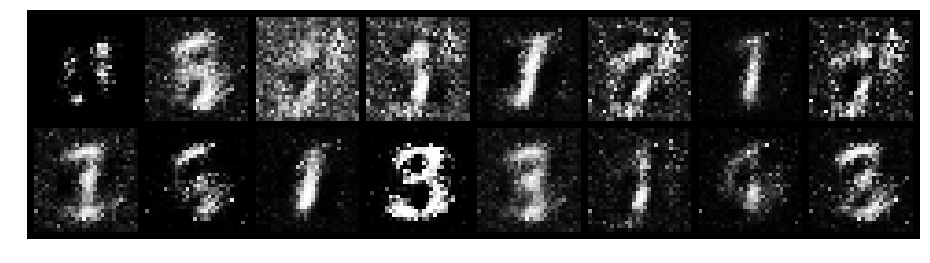

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.9674, Generator Loss: 2.7064
D(x): 0.6553, D(G(z)): 0.1018


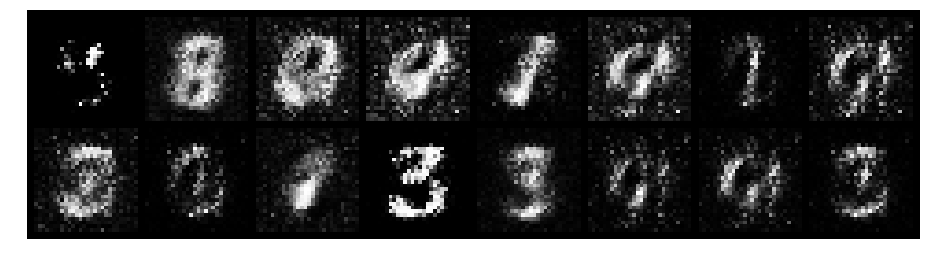

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4962, Generator Loss: 2.2129
D(x): 0.8672, D(G(z)): 0.1886


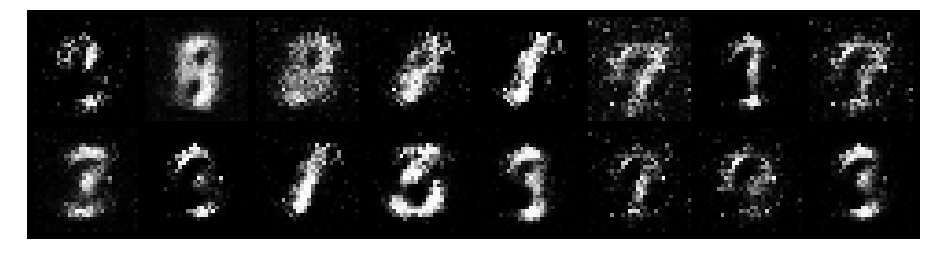

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.9775, Generator Loss: 1.8442
D(x): 0.7717, D(G(z)): 0.3287


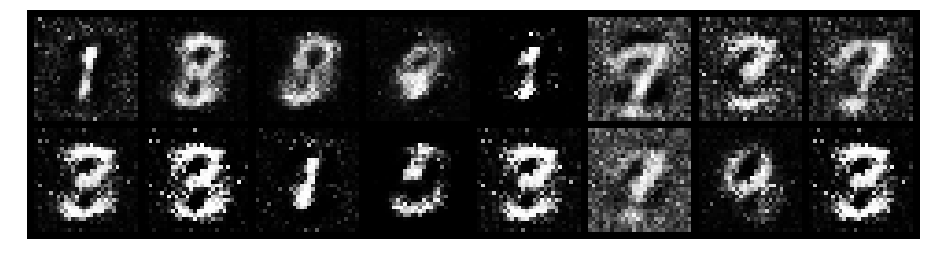

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5288, Generator Loss: 2.9075
D(x): 0.8435, D(G(z)): 0.1721


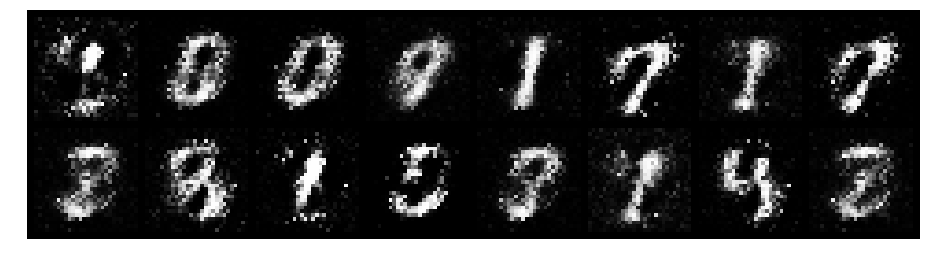

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.6014, Generator Loss: 2.5106
D(x): 0.7631, D(G(z)): 0.1295


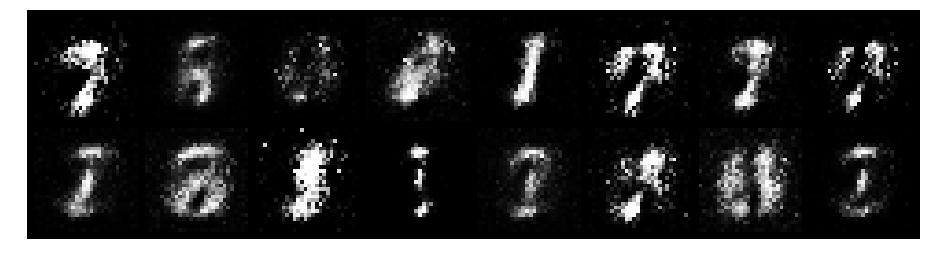

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6765, Generator Loss: 2.7167
D(x): 0.8244, D(G(z)): 0.2217


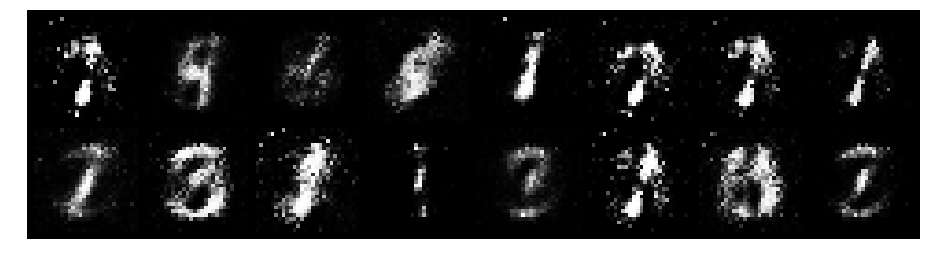

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5039, Generator Loss: 2.2895
D(x): 0.8075, D(G(z)): 0.1091


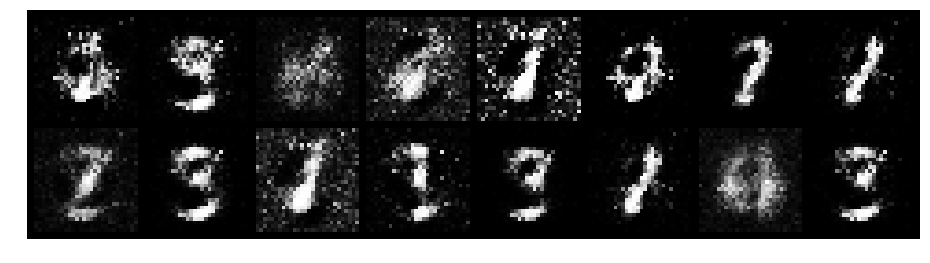

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7559, Generator Loss: 2.1177
D(x): 0.7891, D(G(z)): 0.2358


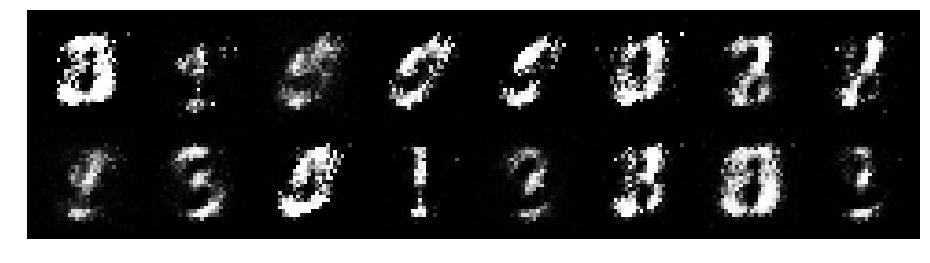

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6141, Generator Loss: 2.6432
D(x): 0.8444, D(G(z)): 0.1981


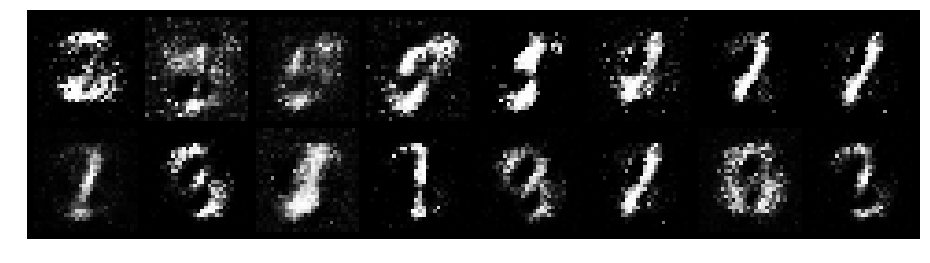

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.4532, Generator Loss: 2.6834
D(x): 0.8791, D(G(z)): 0.1422


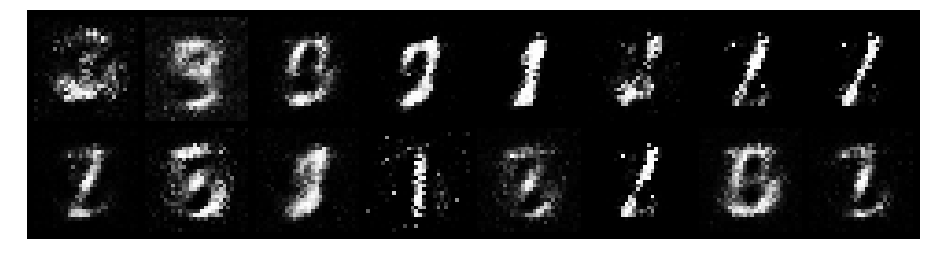

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6186, Generator Loss: 2.2026
D(x): 0.8511, D(G(z)): 0.2188


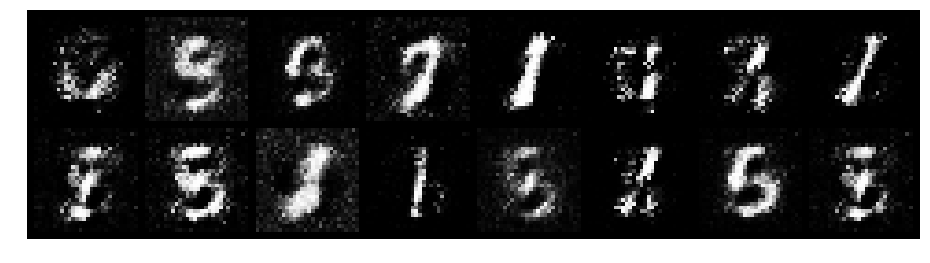

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.6277, Generator Loss: 2.3407
D(x): 0.7674, D(G(z)): 0.1864


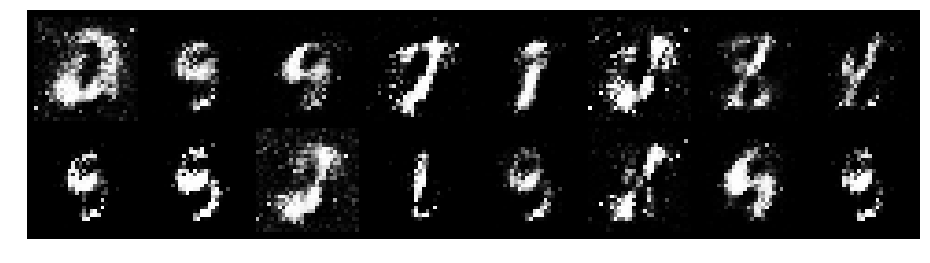

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.4434, Generator Loss: 2.2595
D(x): 0.8377, D(G(z)): 0.1464


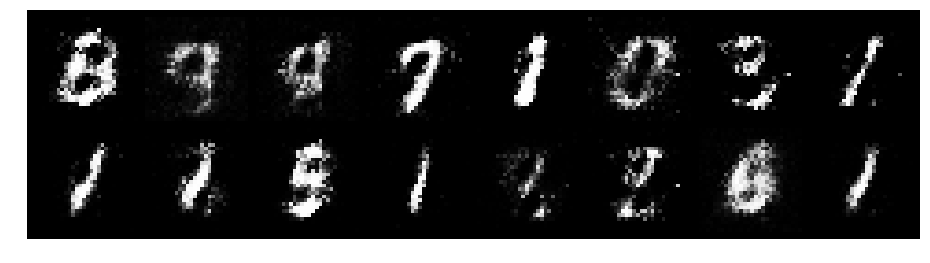

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.6165, Generator Loss: 2.6668
D(x): 0.7686, D(G(z)): 0.1587


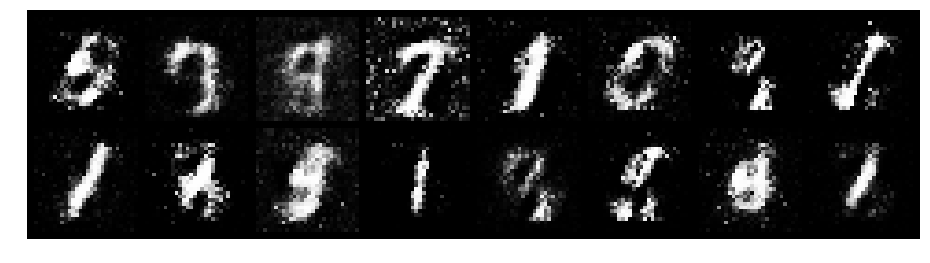

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5851, Generator Loss: 2.9351
D(x): 0.8860, D(G(z)): 0.2342


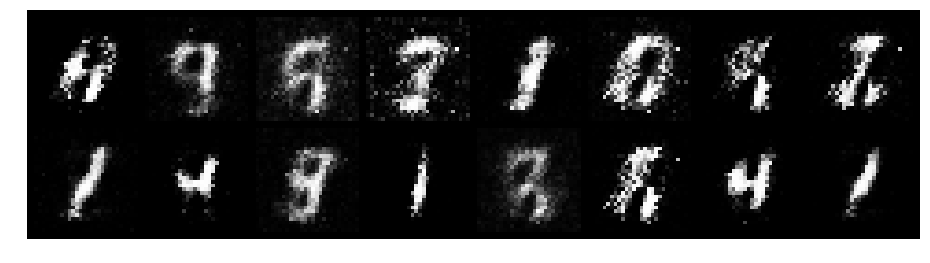

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.5938, Generator Loss: 1.8920
D(x): 0.7903, D(G(z)): 0.1776


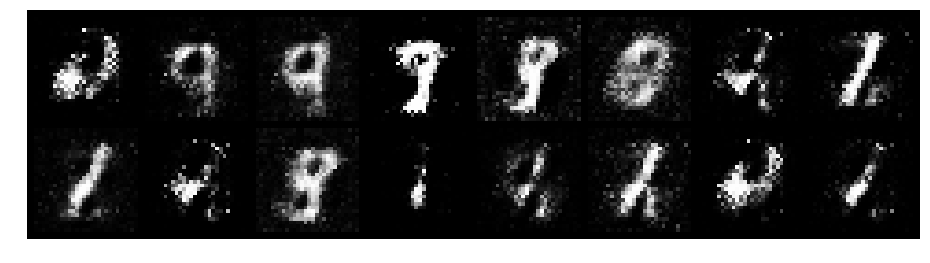

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.7323, Generator Loss: 1.7196
D(x): 0.7640, D(G(z)): 0.2464


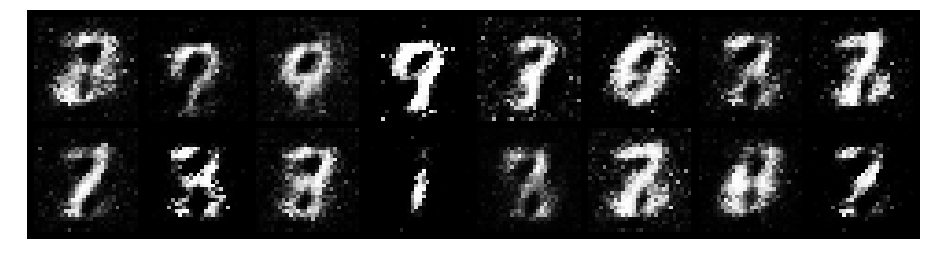

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.7346, Generator Loss: 2.6085
D(x): 0.7428, D(G(z)): 0.2014


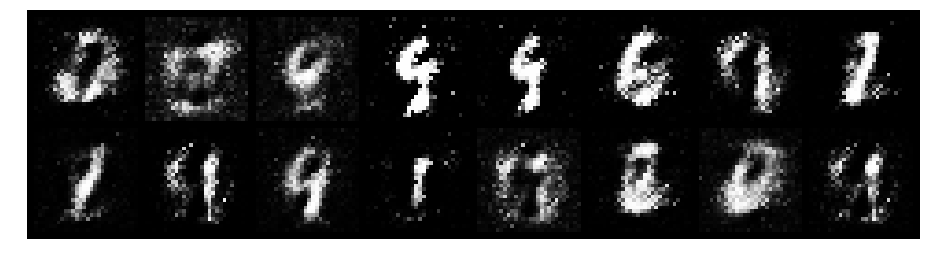

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.8741, Generator Loss: 2.1740
D(x): 0.8308, D(G(z)): 0.3399


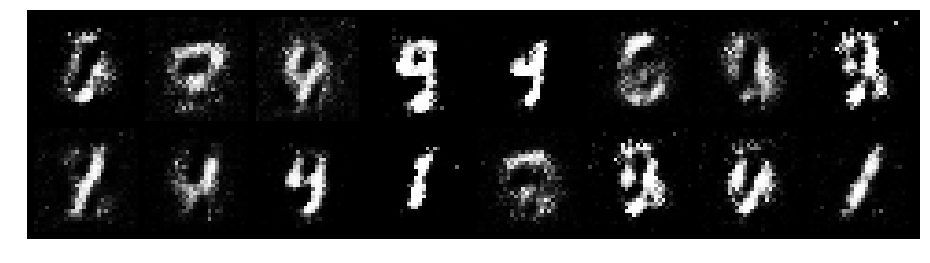

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.6370, Generator Loss: 2.4803
D(x): 0.8191, D(G(z)): 0.2237


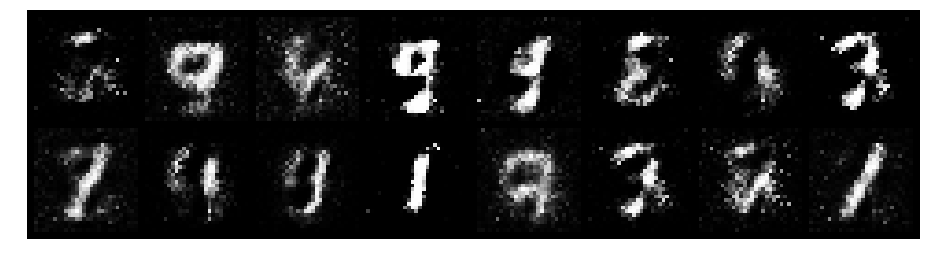

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.6599, Generator Loss: 1.7219
D(x): 0.7810, D(G(z)): 0.2142


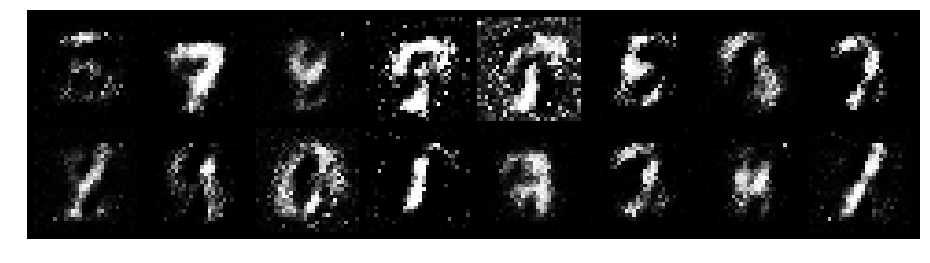

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.6866, Generator Loss: 2.0231
D(x): 0.8380, D(G(z)): 0.2855


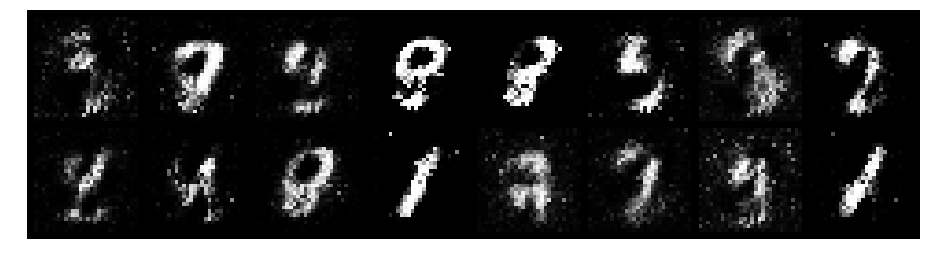

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.7651, Generator Loss: 1.9333
D(x): 0.7783, D(G(z)): 0.2368


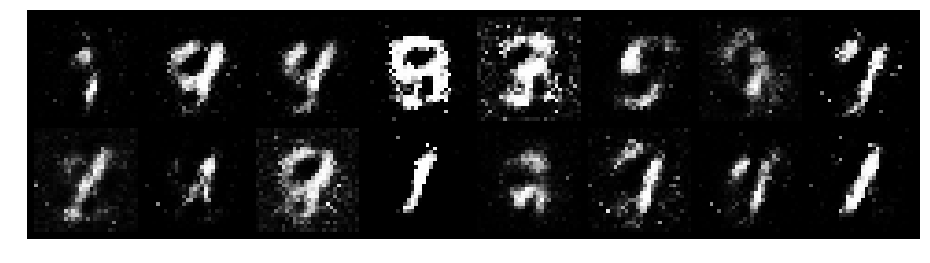

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.7448, Generator Loss: 2.0655
D(x): 0.7969, D(G(z)): 0.2738


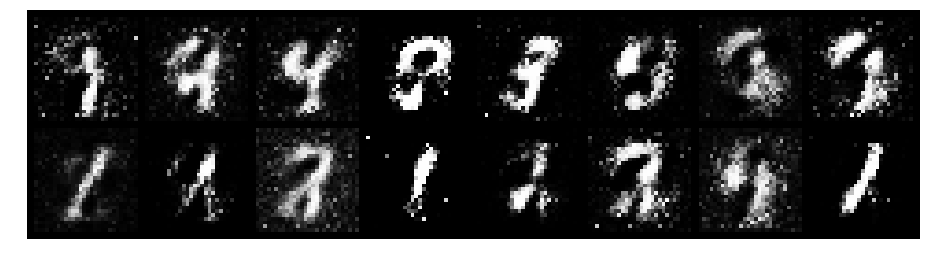

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.8568, Generator Loss: 1.9556
D(x): 0.6597, D(G(z)): 0.2063


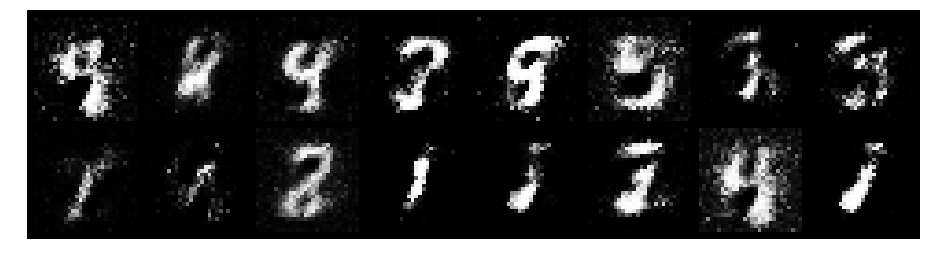

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.7003, Generator Loss: 1.9789
D(x): 0.7843, D(G(z)): 0.2582


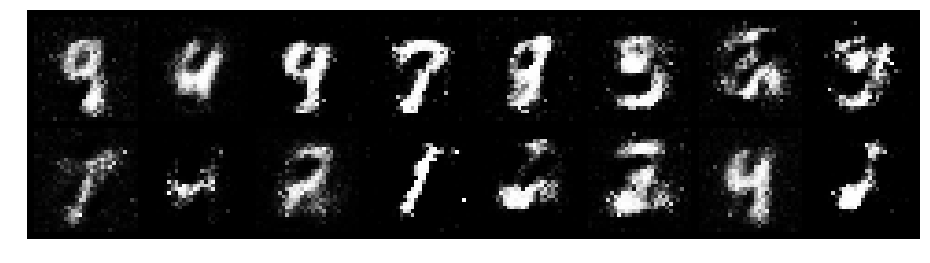

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8206, Generator Loss: 1.4881
D(x): 0.7977, D(G(z)): 0.3414


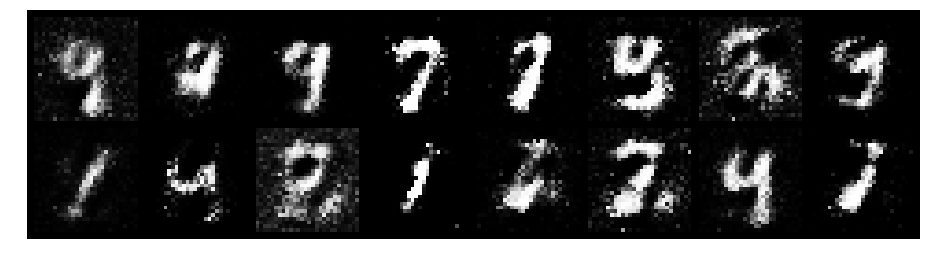

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.8127, Generator Loss: 2.0934
D(x): 0.8483, D(G(z)): 0.3277


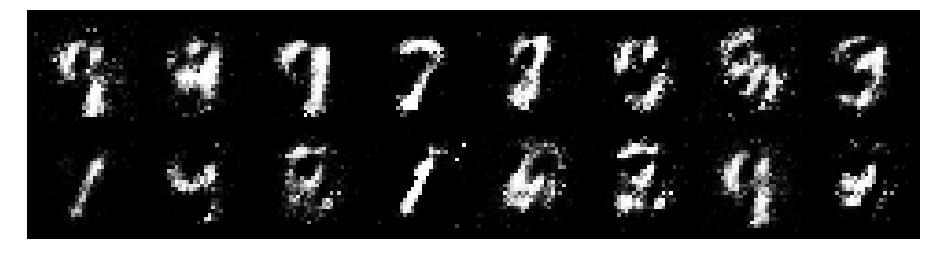

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.4957, Generator Loss: 2.2638
D(x): 0.8423, D(G(z)): 0.1747


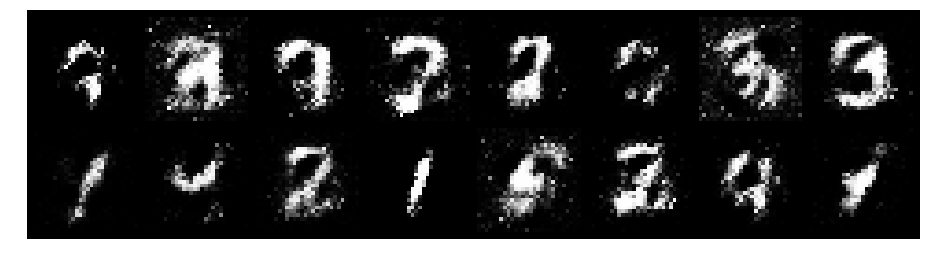

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 1.0987, Generator Loss: 1.6843
D(x): 0.6653, D(G(z)): 0.2479


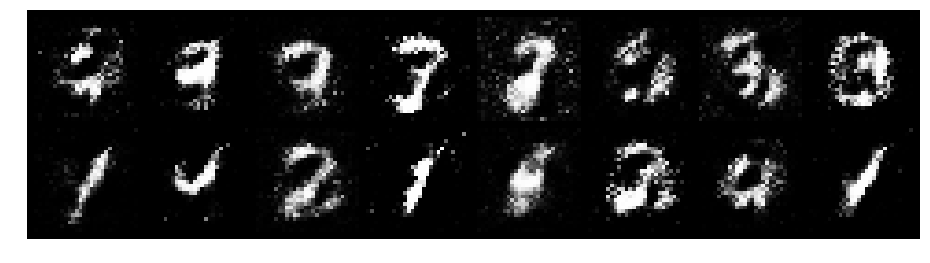

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.8151, Generator Loss: 1.5813
D(x): 0.8058, D(G(z)): 0.3067


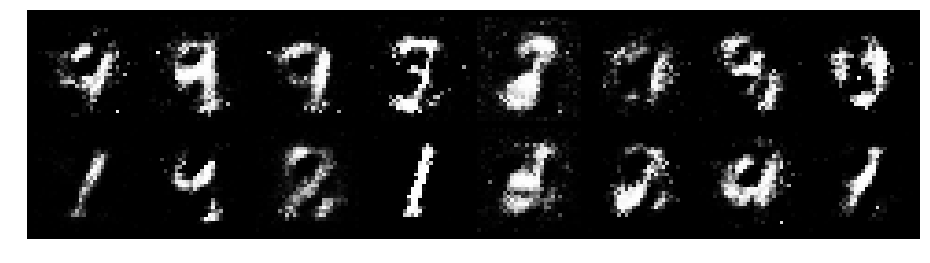

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.7260, Generator Loss: 2.3319
D(x): 0.7386, D(G(z)): 0.2018


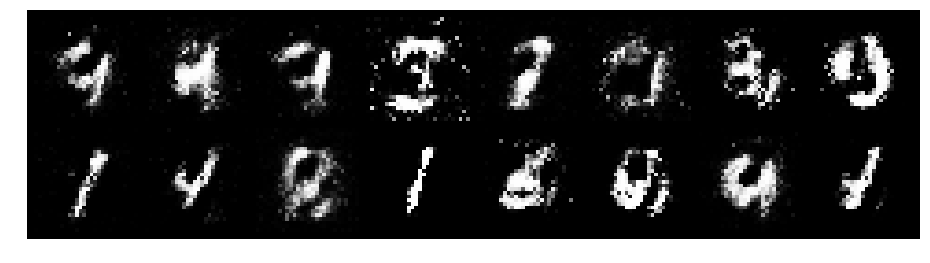

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.8436, Generator Loss: 2.0985
D(x): 0.7109, D(G(z)): 0.2084


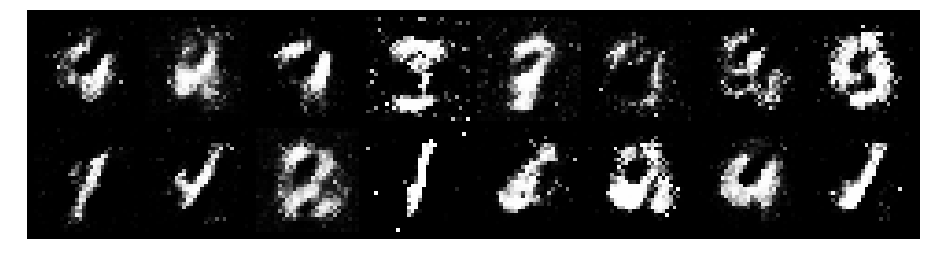

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.8001, Generator Loss: 1.9808
D(x): 0.7629, D(G(z)): 0.2119


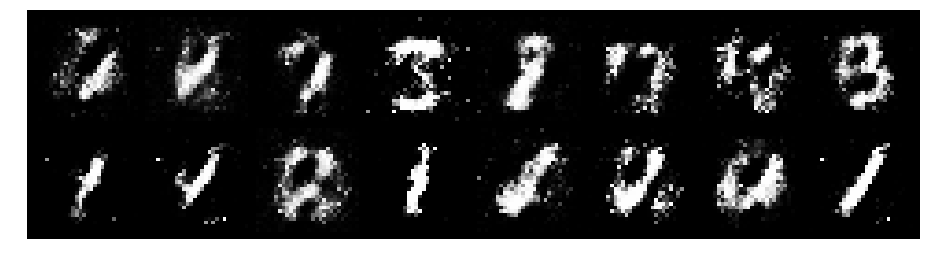

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.9049, Generator Loss: 1.8485
D(x): 0.7171, D(G(z)): 0.2355


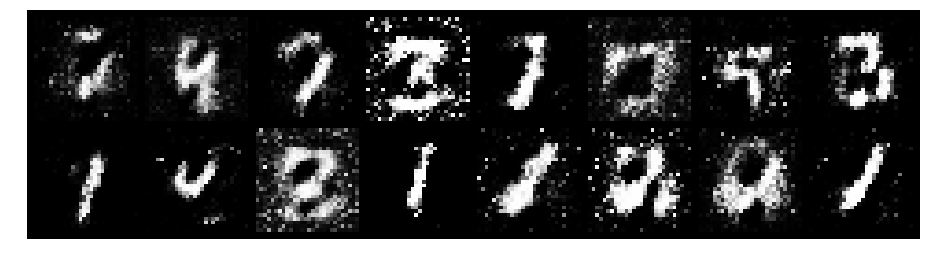

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.9103, Generator Loss: 2.5511
D(x): 0.7117, D(G(z)): 0.2363


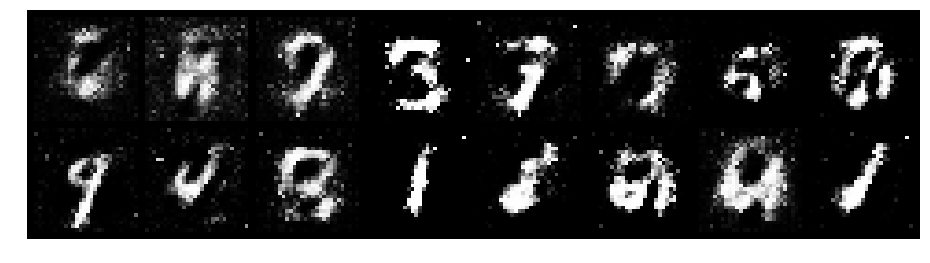

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7946, Generator Loss: 1.9847
D(x): 0.6905, D(G(z)): 0.1945


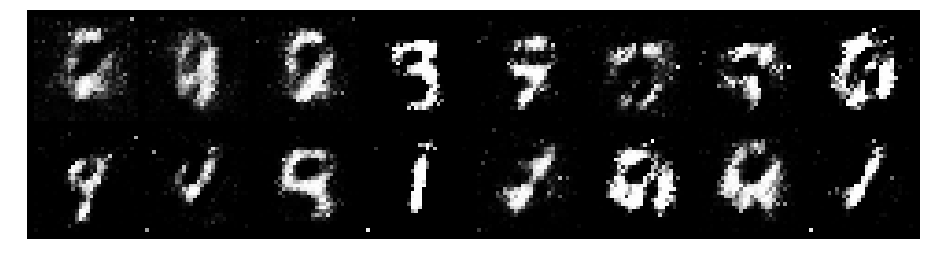

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.9391, Generator Loss: 1.5546
D(x): 0.8264, D(G(z)): 0.4041


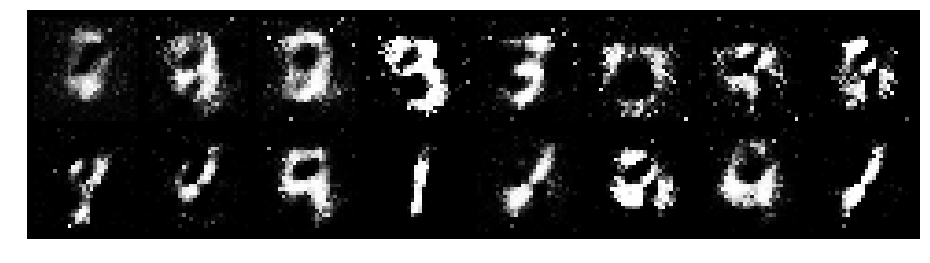

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.7595, Generator Loss: 2.1702
D(x): 0.6959, D(G(z)): 0.2060


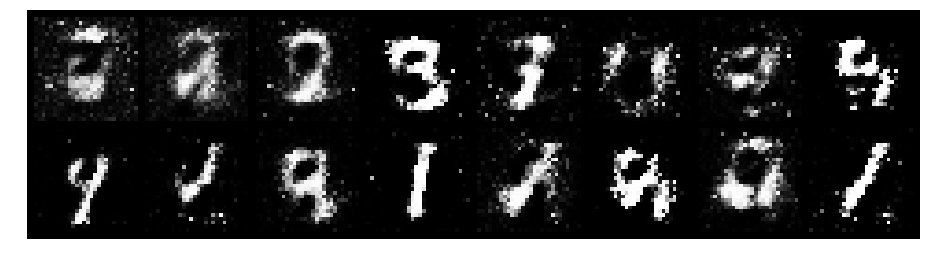

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.9053, Generator Loss: 1.8858
D(x): 0.7736, D(G(z)): 0.3164


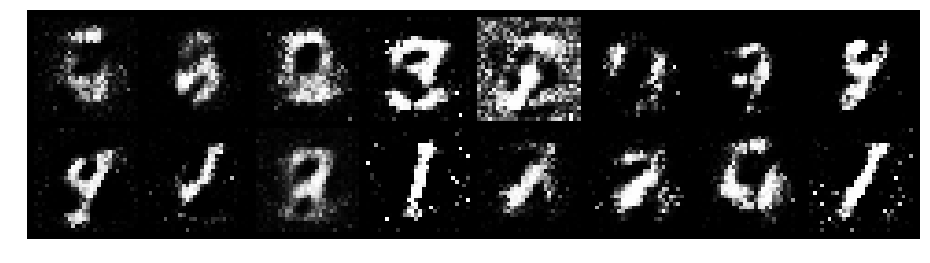

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.7174, Generator Loss: 1.6813
D(x): 0.8048, D(G(z)): 0.3112


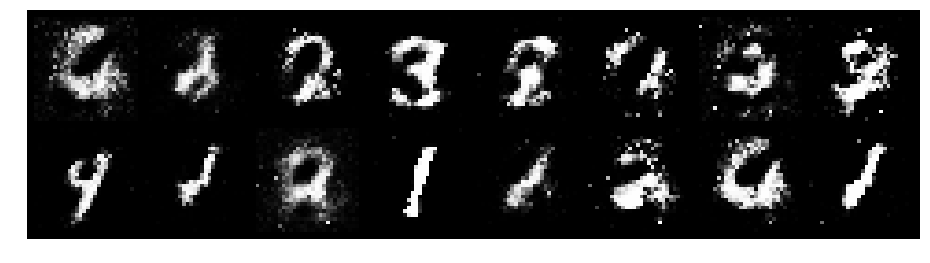

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 1.0030, Generator Loss: 1.5472
D(x): 0.7483, D(G(z)): 0.3191


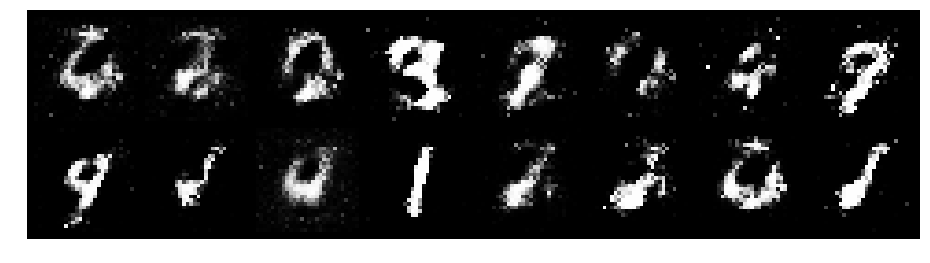

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.6305, Generator Loss: 1.8010
D(x): 0.8395, D(G(z)): 0.2753


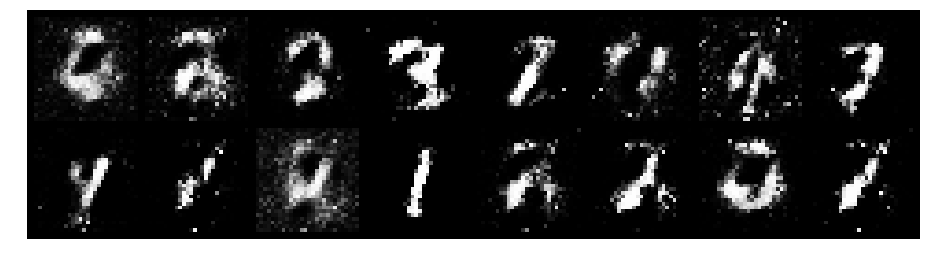

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.7670, Generator Loss: 2.7824
D(x): 0.8002, D(G(z)): 0.2480


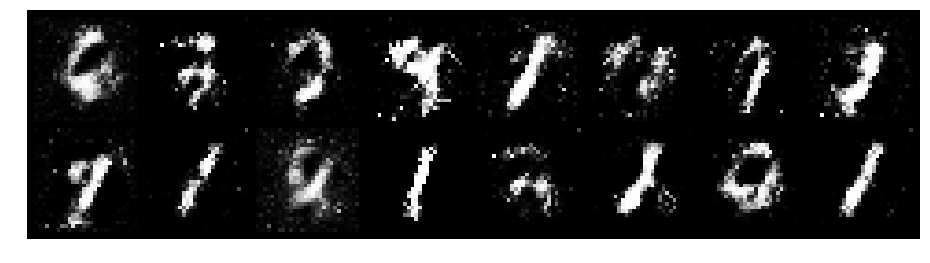

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7068, Generator Loss: 1.7132
D(x): 0.7932, D(G(z)): 0.2579


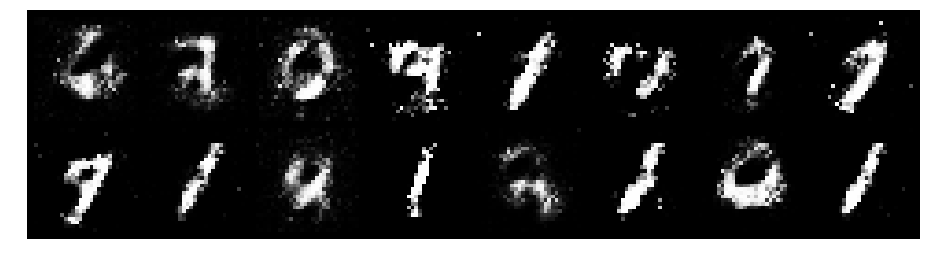

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.5653, Generator Loss: 2.1149
D(x): 0.8175, D(G(z)): 0.2093


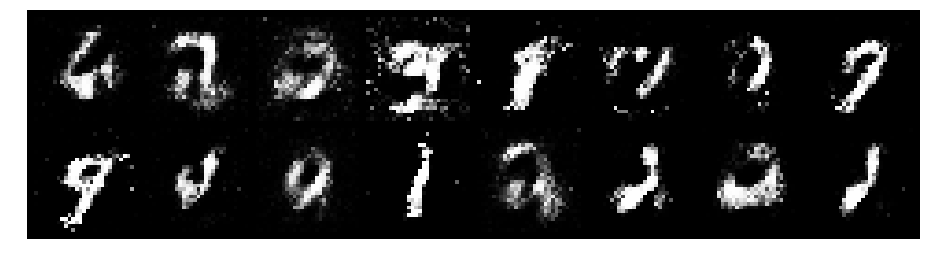

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8427, Generator Loss: 2.0255
D(x): 0.7039, D(G(z)): 0.2764


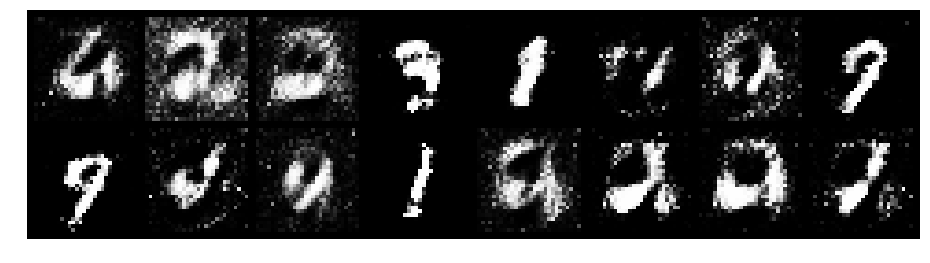

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8371, Generator Loss: 1.8986
D(x): 0.7138, D(G(z)): 0.2302


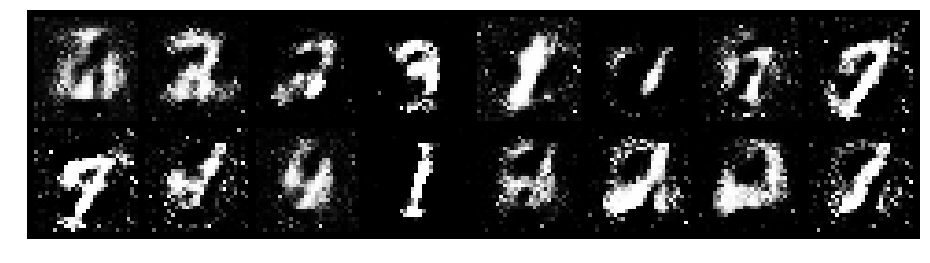

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7868, Generator Loss: 1.5743
D(x): 0.7000, D(G(z)): 0.2590


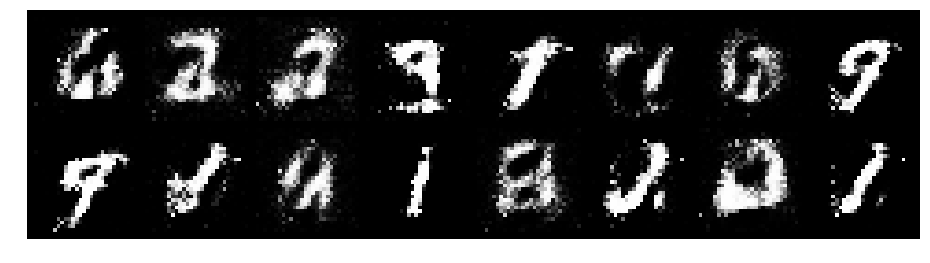

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8835, Generator Loss: 1.6230
D(x): 0.7807, D(G(z)): 0.3632


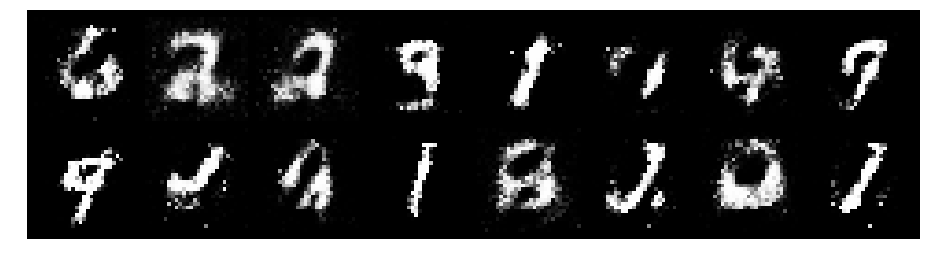

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7496, Generator Loss: 1.3949
D(x): 0.7785, D(G(z)): 0.2945


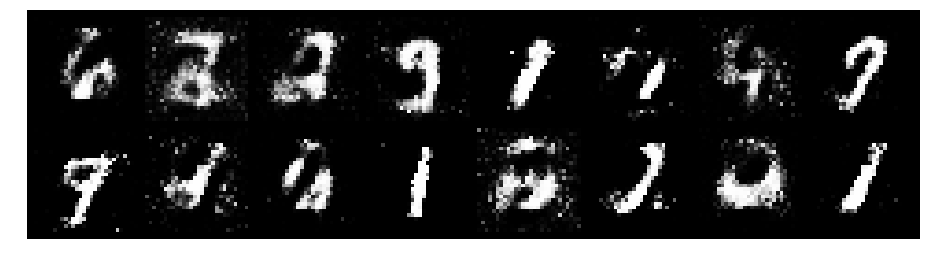

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7818, Generator Loss: 1.6914
D(x): 0.7307, D(G(z)): 0.2573


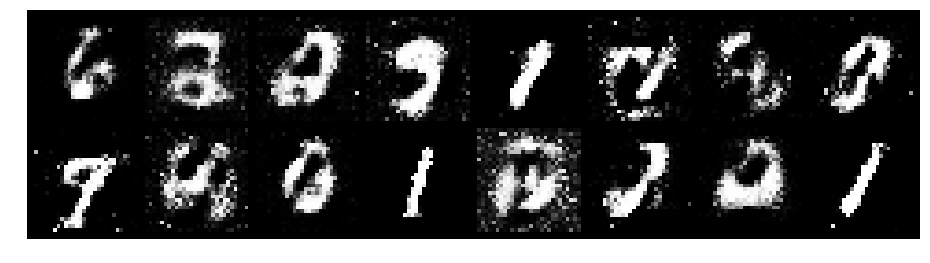

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 1.0639, Generator Loss: 1.7290
D(x): 0.6885, D(G(z)): 0.3278


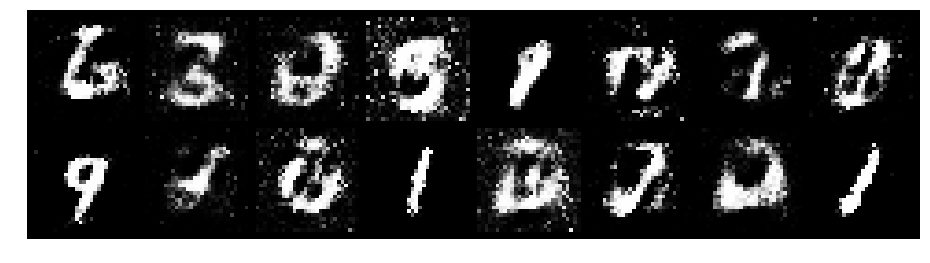

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.9018, Generator Loss: 1.5434
D(x): 0.7975, D(G(z)): 0.3422


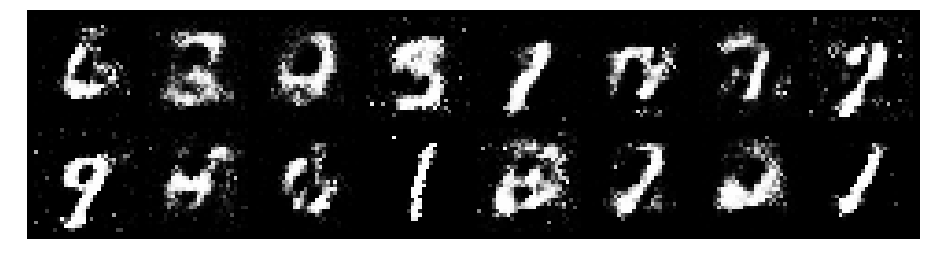

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8401, Generator Loss: 1.5013
D(x): 0.7784, D(G(z)): 0.3017


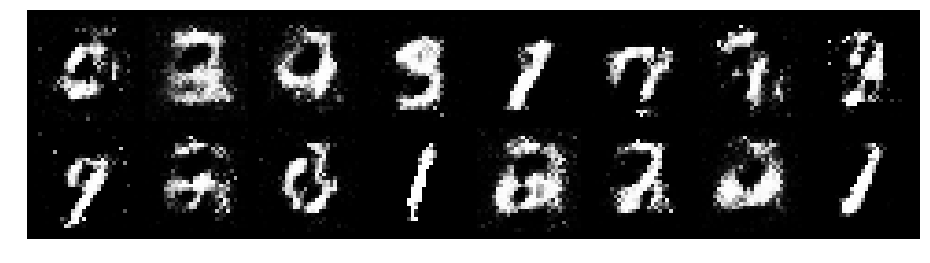

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 1.0606, Generator Loss: 1.2525
D(x): 0.6791, D(G(z)): 0.3743


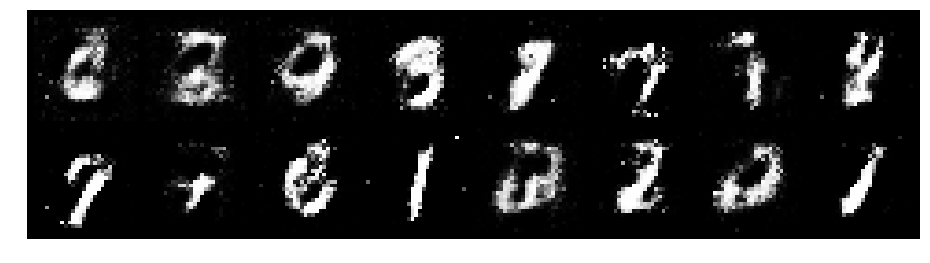

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.9823, Generator Loss: 1.4362
D(x): 0.6528, D(G(z)): 0.2646


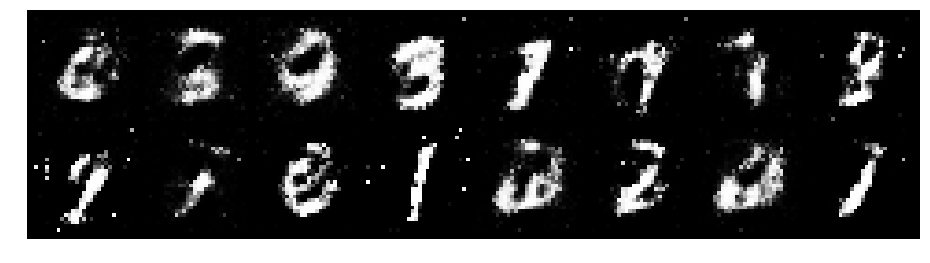

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.9550, Generator Loss: 1.3897
D(x): 0.7046, D(G(z)): 0.3324


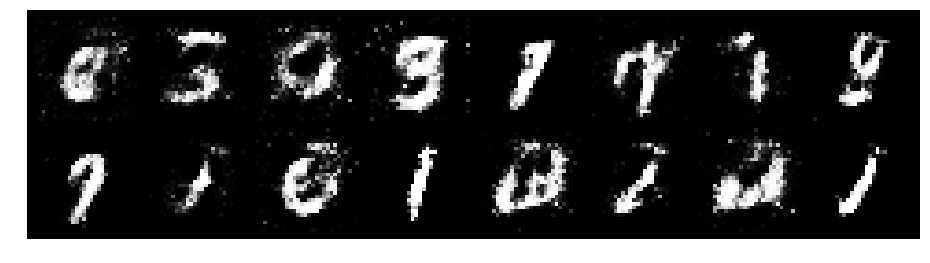

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.9281, Generator Loss: 1.7800
D(x): 0.7485, D(G(z)): 0.3555


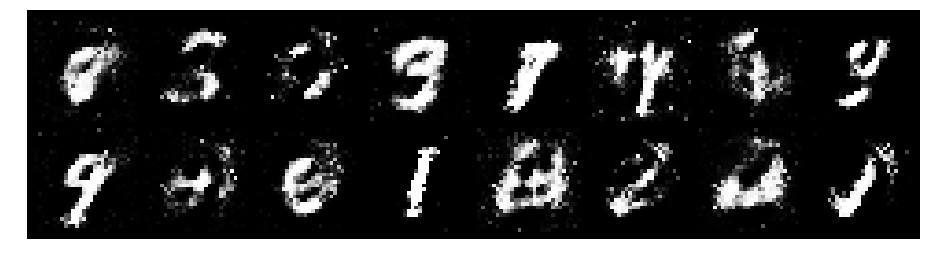

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.6789, Generator Loss: 2.2215
D(x): 0.7536, D(G(z)): 0.2391


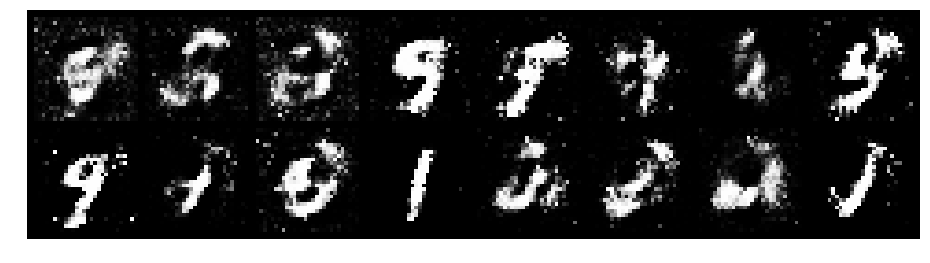

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6435, Generator Loss: 1.6796
D(x): 0.7959, D(G(z)): 0.2270


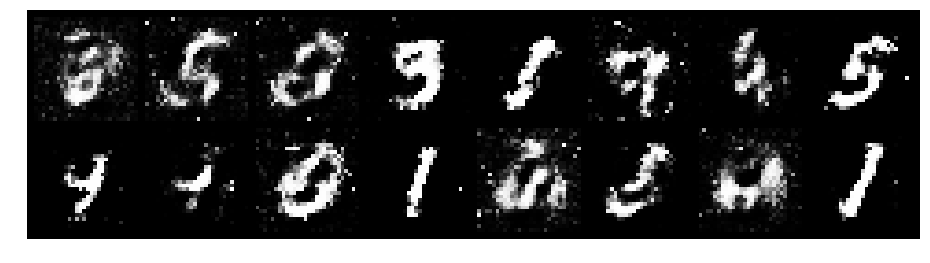

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.6022, Generator Loss: 1.9632
D(x): 0.8144, D(G(z)): 0.2013


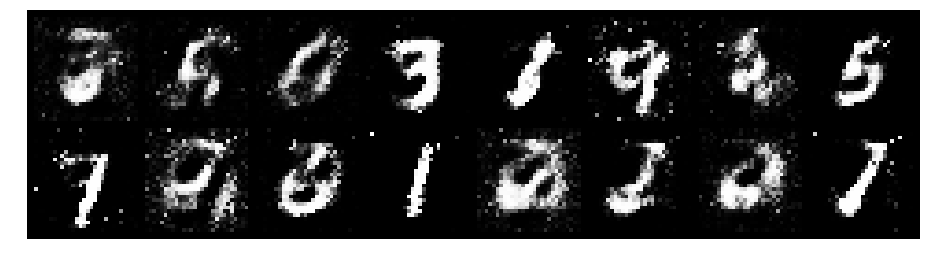

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 1.0533, Generator Loss: 1.8916
D(x): 0.6201, D(G(z)): 0.2235


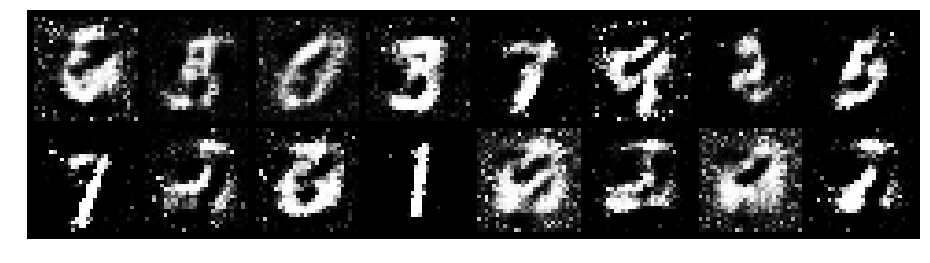

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.7523, Generator Loss: 1.5954
D(x): 0.7234, D(G(z)): 0.2291


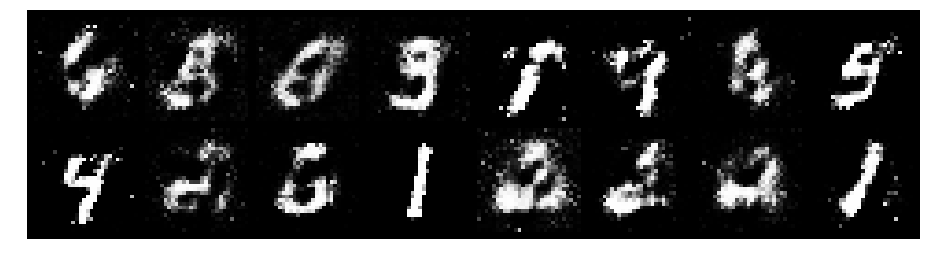

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.7523, Generator Loss: 1.7850
D(x): 0.7220, D(G(z)): 0.2370


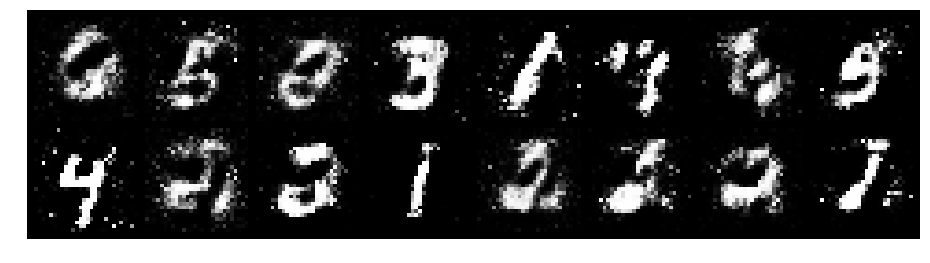

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.6023, Generator Loss: 2.4565
D(x): 0.7766, D(G(z)): 0.1624


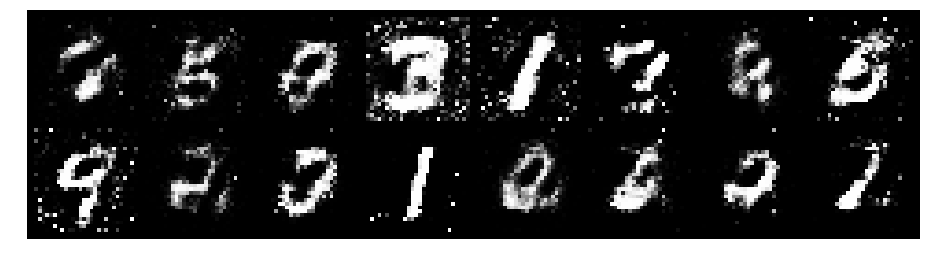

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.6289, Generator Loss: 1.9378
D(x): 0.8033, D(G(z)): 0.2307


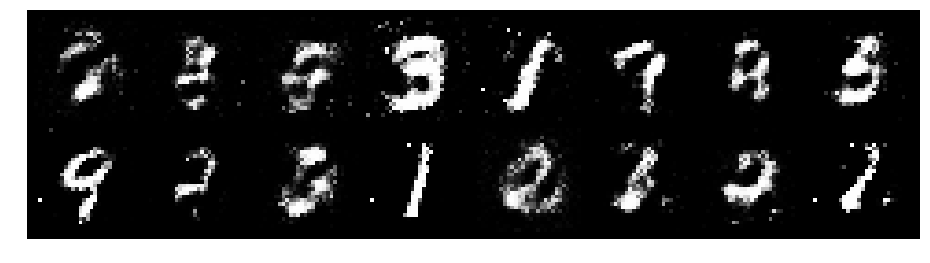

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.6315, Generator Loss: 1.9621
D(x): 0.7633, D(G(z)): 0.2002


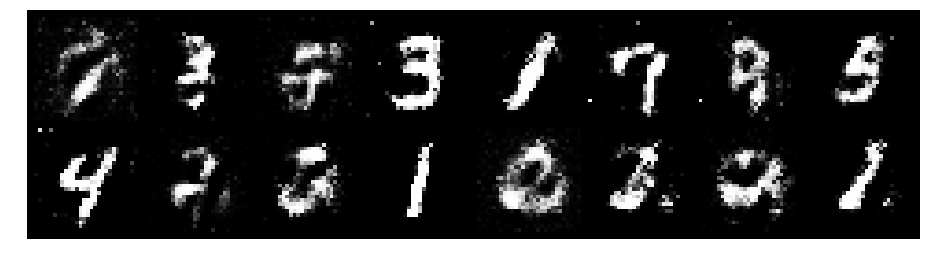

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.7821, Generator Loss: 1.7893
D(x): 0.8143, D(G(z)): 0.3283


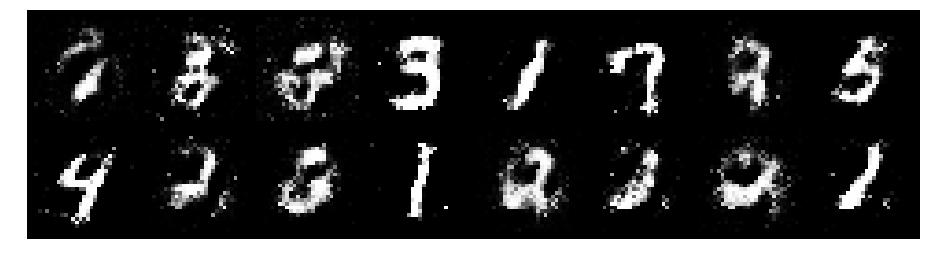

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7007, Generator Loss: 2.0703
D(x): 0.7332, D(G(z)): 0.2125


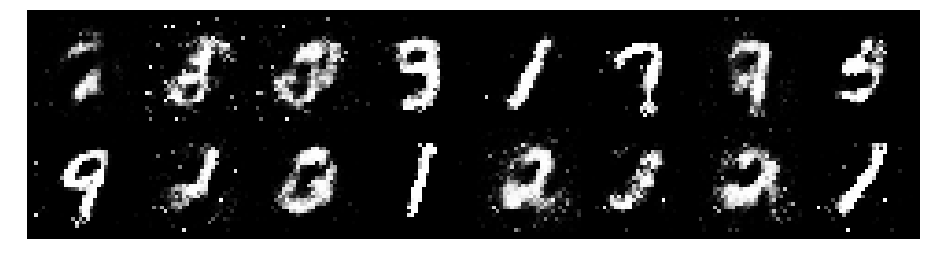

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8188, Generator Loss: 1.6531
D(x): 0.7321, D(G(z)): 0.2695


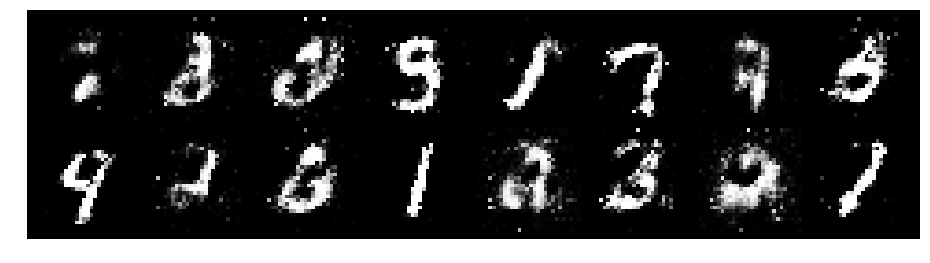

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 1.0685, Generator Loss: 1.5489
D(x): 0.6005, D(G(z)): 0.2827


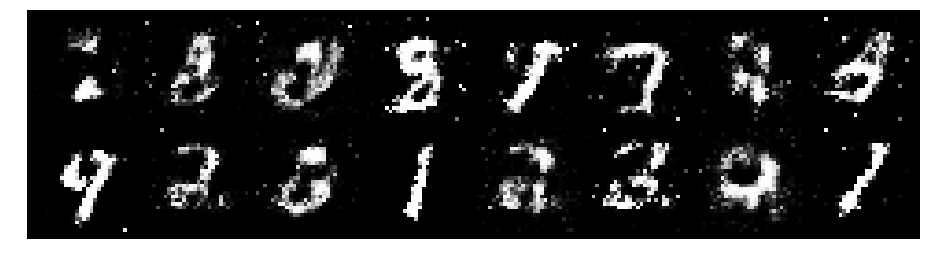

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.8627, Generator Loss: 1.1508
D(x): 0.7312, D(G(z)): 0.3386


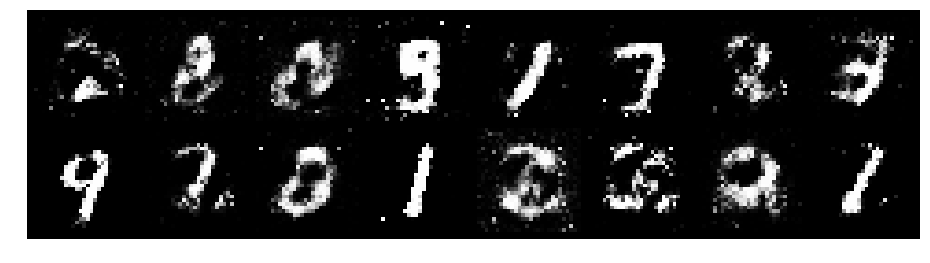

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9340, Generator Loss: 1.3993
D(x): 0.7306, D(G(z)): 0.3259


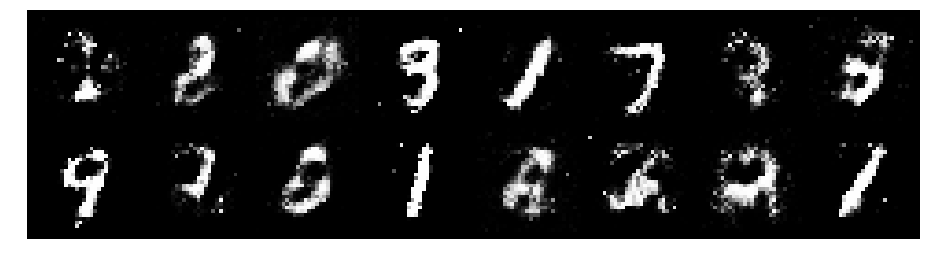

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.7472, Generator Loss: 2.0761
D(x): 0.7599, D(G(z)): 0.2528


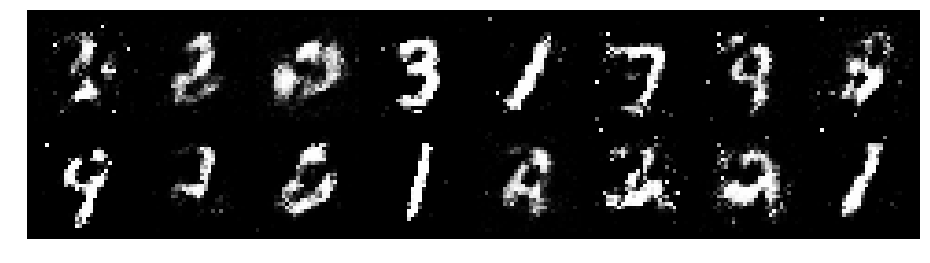

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8105, Generator Loss: 2.0539
D(x): 0.6626, D(G(z)): 0.1778


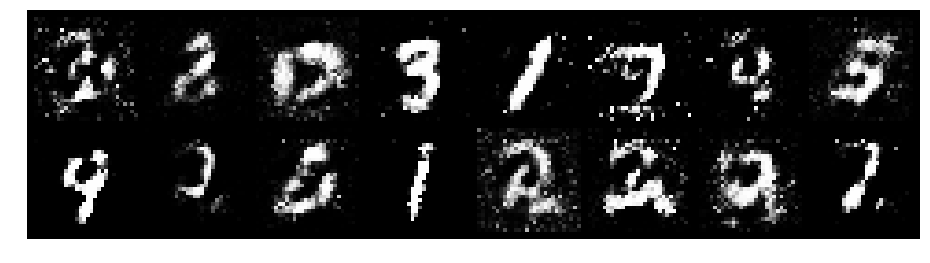

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.7648, Generator Loss: 1.5716
D(x): 0.7624, D(G(z)): 0.2996


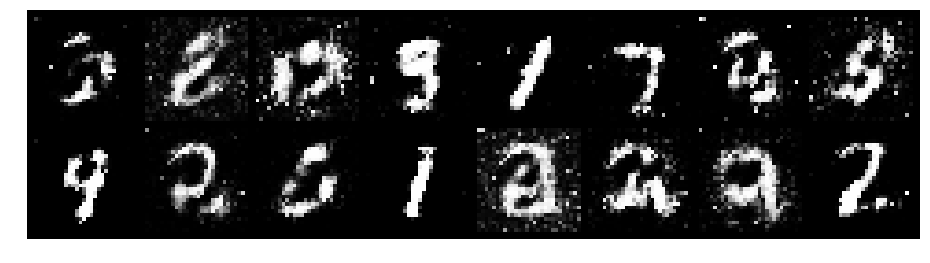

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8872, Generator Loss: 1.5813
D(x): 0.7136, D(G(z)): 0.2791


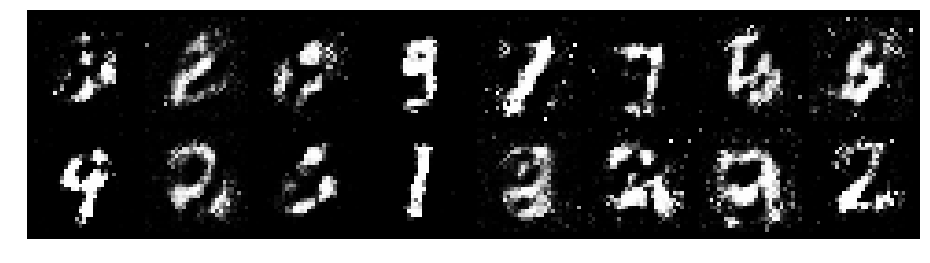

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9451, Generator Loss: 1.7554
D(x): 0.6841, D(G(z)): 0.2939


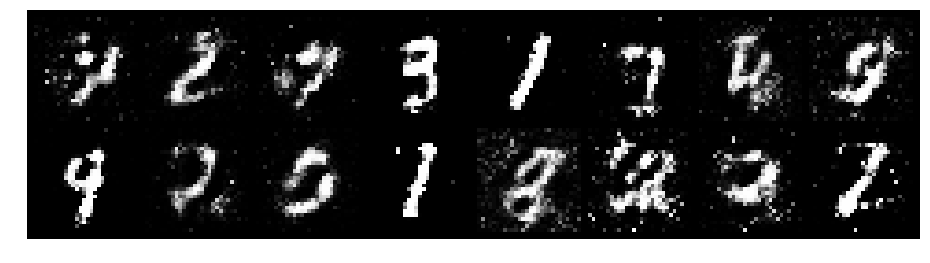

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.2556, Generator Loss: 1.1234
D(x): 0.6099, D(G(z)): 0.3658


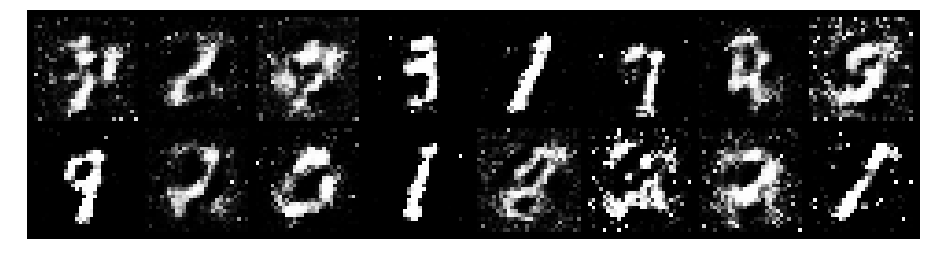

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8295, Generator Loss: 1.9542
D(x): 0.7271, D(G(z)): 0.2717


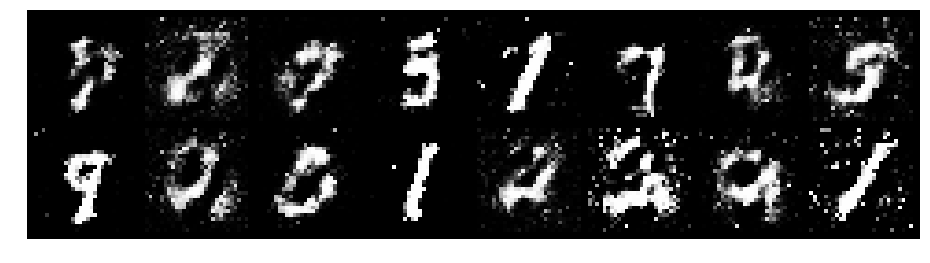

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 1.0318, Generator Loss: 1.4582
D(x): 0.7133, D(G(z)): 0.3452


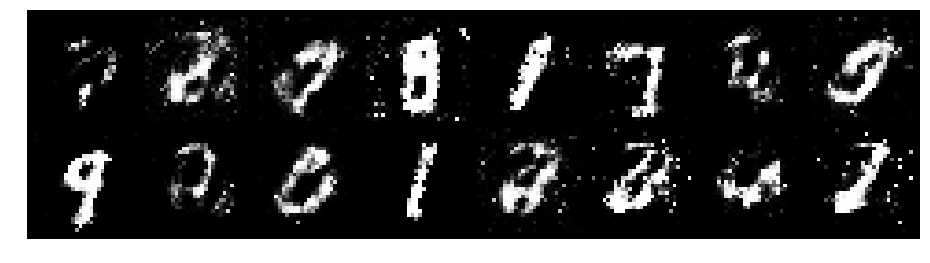

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 1.0091, Generator Loss: 1.6867
D(x): 0.6823, D(G(z)): 0.2890


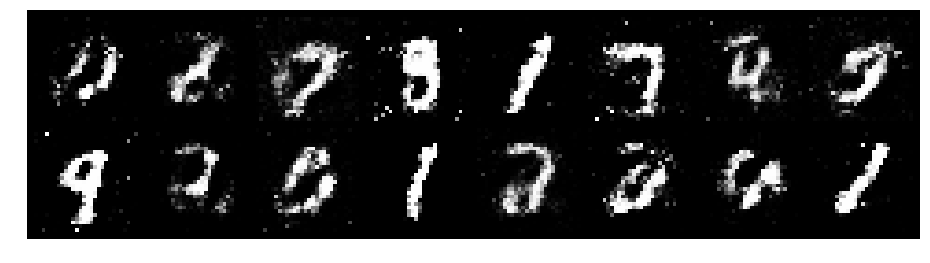

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.0578, Generator Loss: 1.6877
D(x): 0.6671, D(G(z)): 0.3130


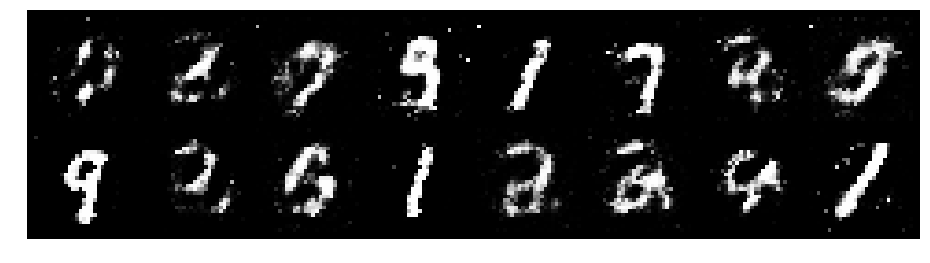

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8452, Generator Loss: 1.4954
D(x): 0.7061, D(G(z)): 0.2788


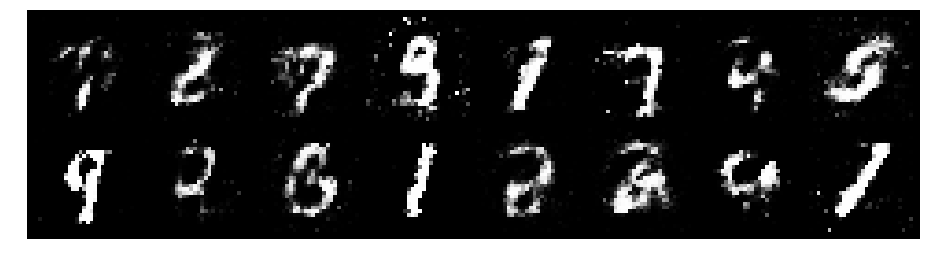

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.7457, Generator Loss: 1.8784
D(x): 0.7788, D(G(z)): 0.2793


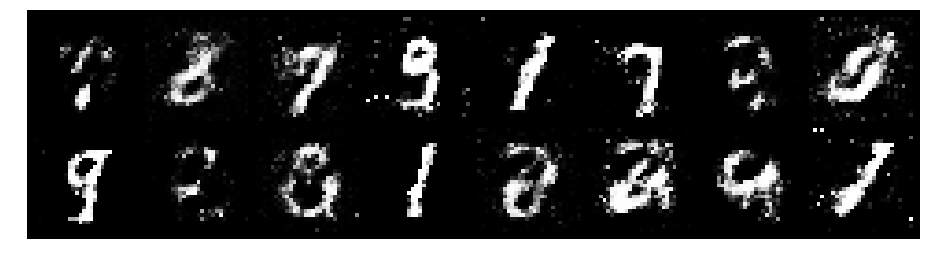

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8425, Generator Loss: 2.2162
D(x): 0.7579, D(G(z)): 0.2970


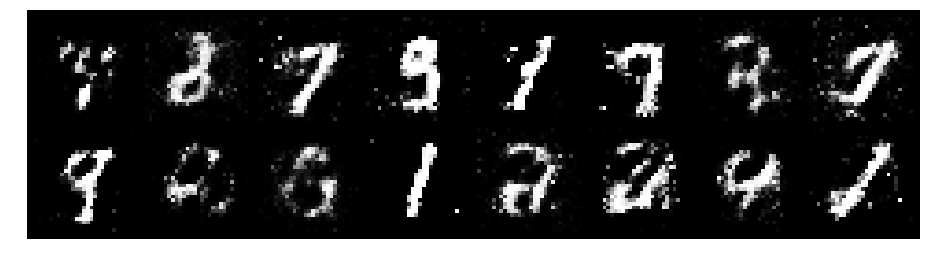

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.2162, Generator Loss: 1.3138
D(x): 0.6298, D(G(z)): 0.3546


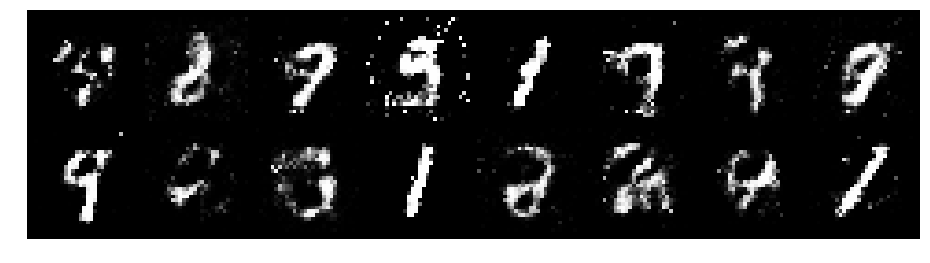

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.8957, Generator Loss: 1.8926
D(x): 0.6314, D(G(z)): 0.2272


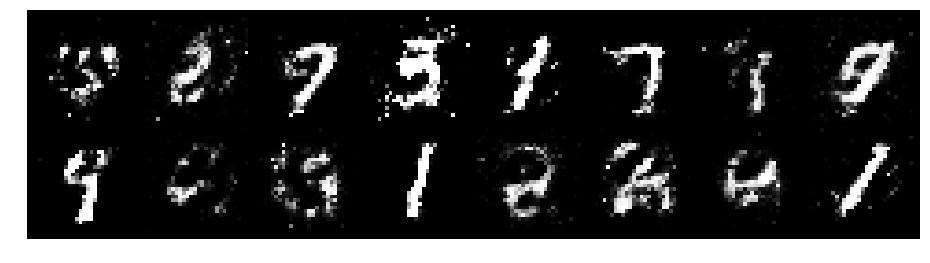

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.7839, Generator Loss: 1.5555
D(x): 0.7406, D(G(z)): 0.2837


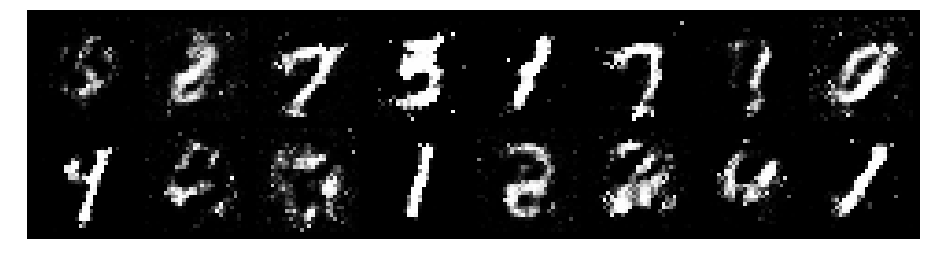

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 1.0084, Generator Loss: 1.6227
D(x): 0.6914, D(G(z)): 0.3451


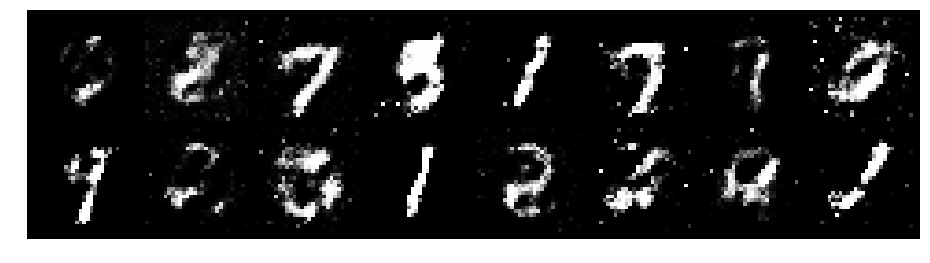

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 1.1117, Generator Loss: 1.4681
D(x): 0.5946, D(G(z)): 0.2785


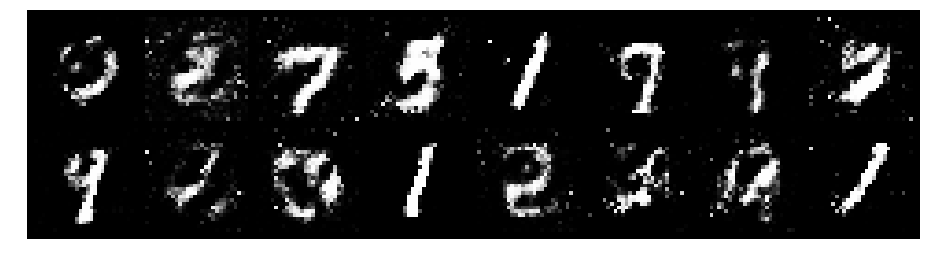

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9486, Generator Loss: 1.4650
D(x): 0.6402, D(G(z)): 0.2665


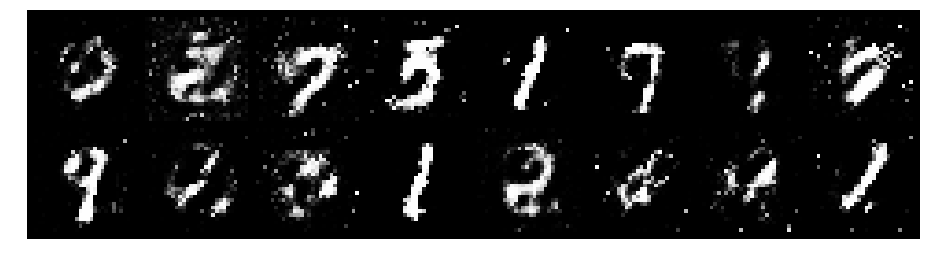

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 1.0179, Generator Loss: 1.4629
D(x): 0.7744, D(G(z)): 0.4174


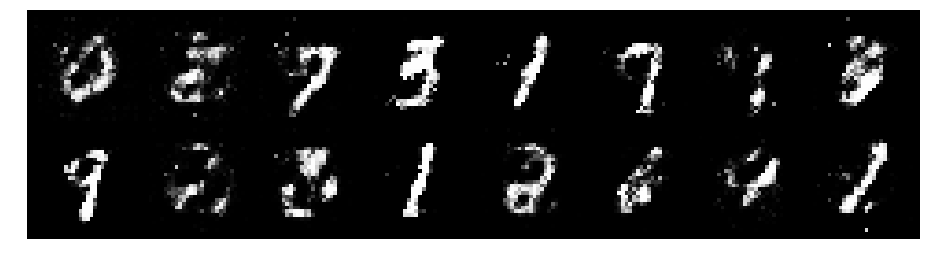

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0349, Generator Loss: 1.3271
D(x): 0.6302, D(G(z)): 0.3427


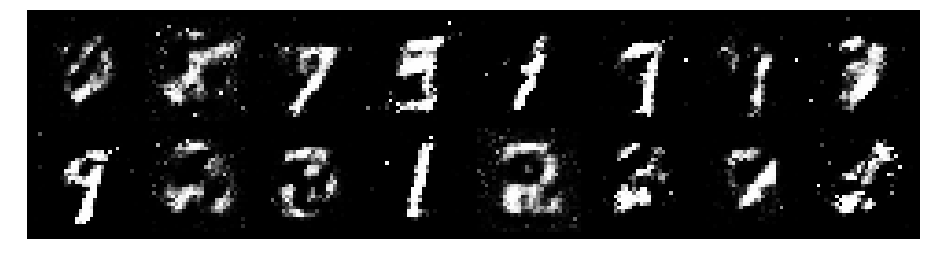

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.1611, Generator Loss: 1.3302
D(x): 0.6359, D(G(z)): 0.3834


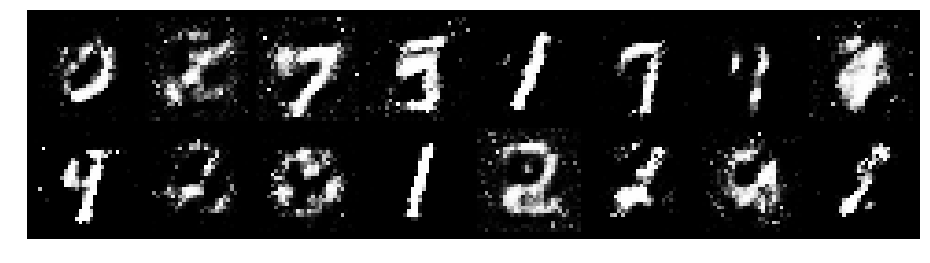

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.0340, Generator Loss: 1.4830
D(x): 0.6717, D(G(z)): 0.3431


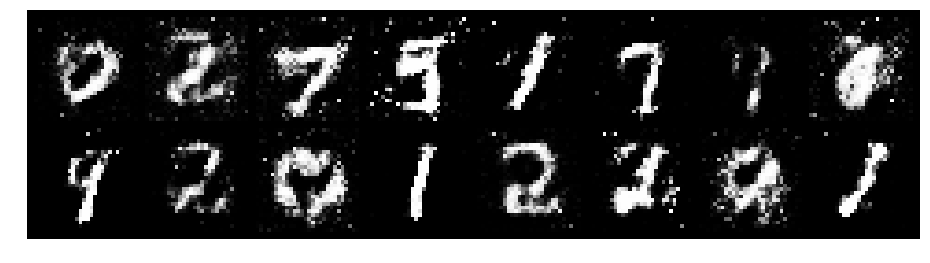

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8591, Generator Loss: 1.4276
D(x): 0.7397, D(G(z)): 0.3247


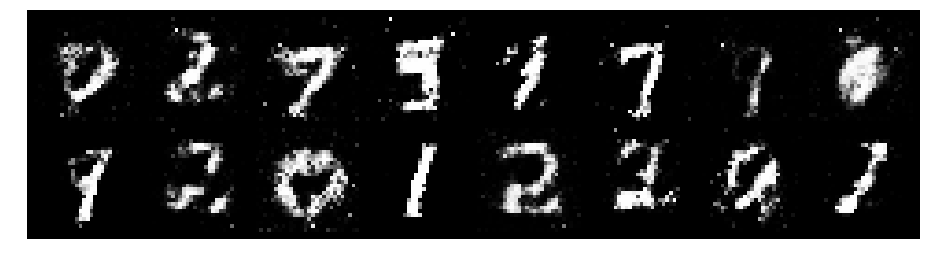

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8505, Generator Loss: 1.4137
D(x): 0.7304, D(G(z)): 0.3243


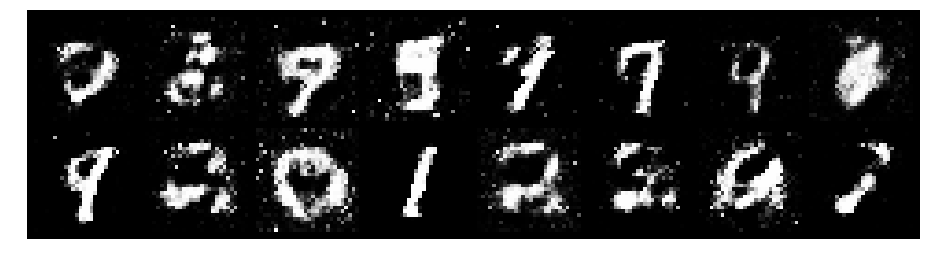

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.0207, Generator Loss: 1.3965
D(x): 0.6497, D(G(z)): 0.3087


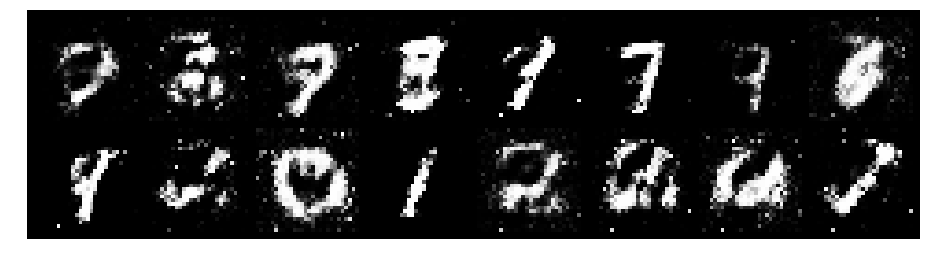

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.0367, Generator Loss: 1.2595
D(x): 0.6288, D(G(z)): 0.3420


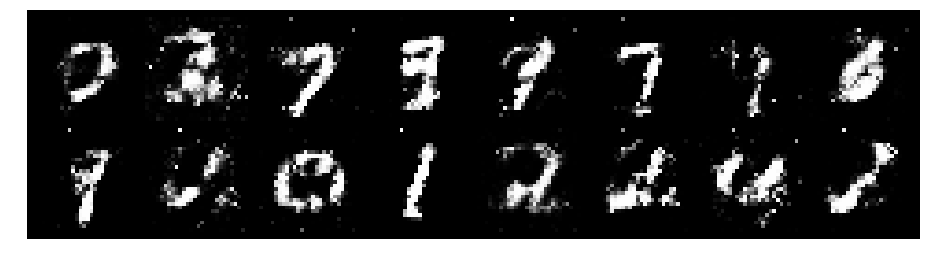

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0389, Generator Loss: 1.3691
D(x): 0.6749, D(G(z)): 0.3360


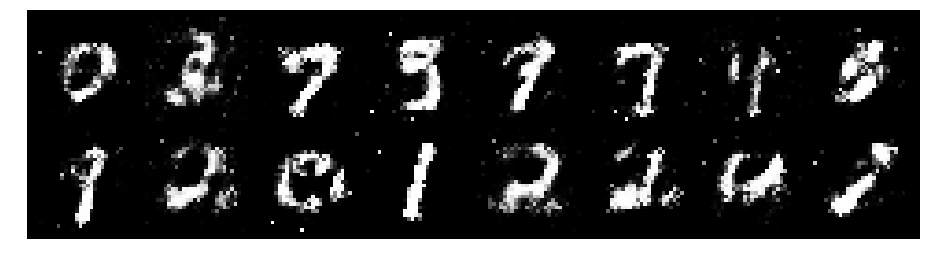

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7475, Generator Loss: 1.8583
D(x): 0.7046, D(G(z)): 0.2102


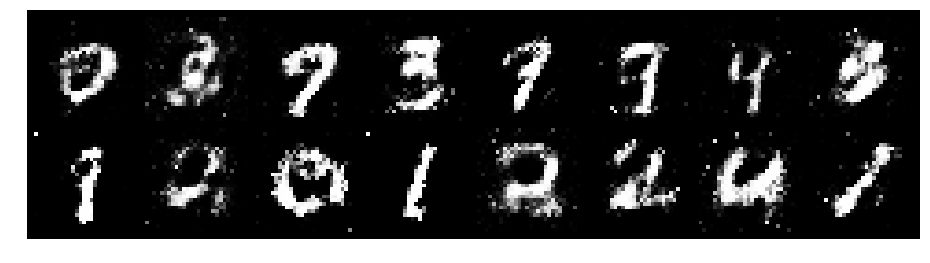

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7133, Generator Loss: 1.9887
D(x): 0.7532, D(G(z)): 0.2640


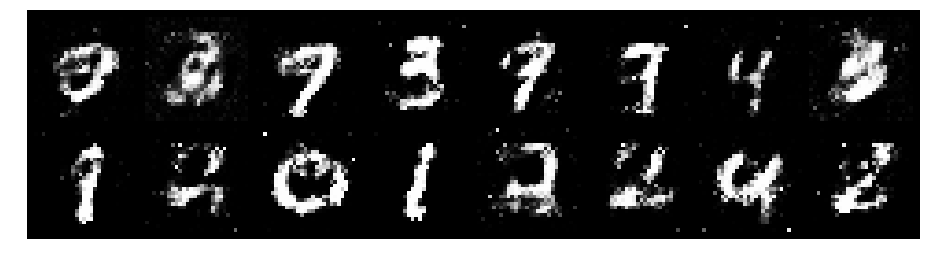

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8094, Generator Loss: 1.9018
D(x): 0.7283, D(G(z)): 0.2942


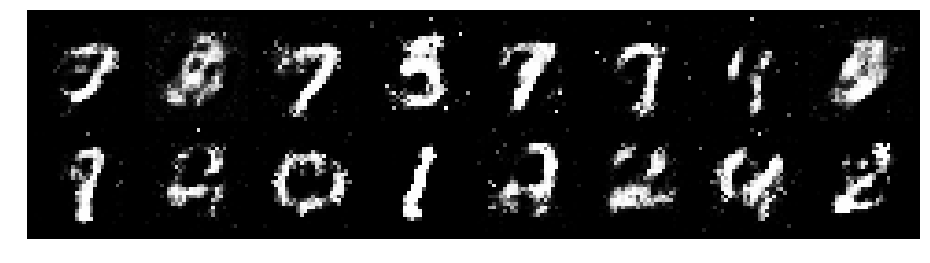

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9490, Generator Loss: 1.4669
D(x): 0.7221, D(G(z)): 0.3434


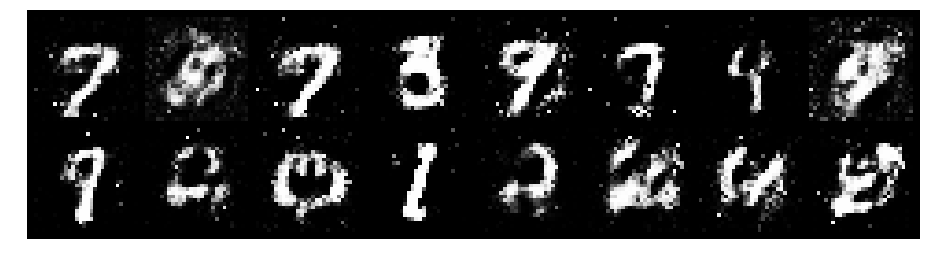

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.1439, Generator Loss: 1.7218
D(x): 0.7422, D(G(z)): 0.4457


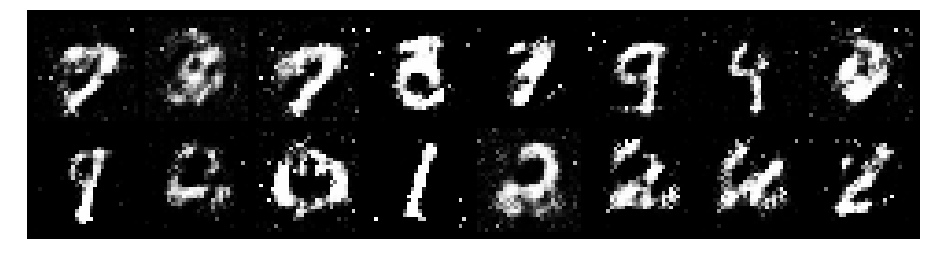

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.0358, Generator Loss: 1.6691
D(x): 0.6540, D(G(z)): 0.2994


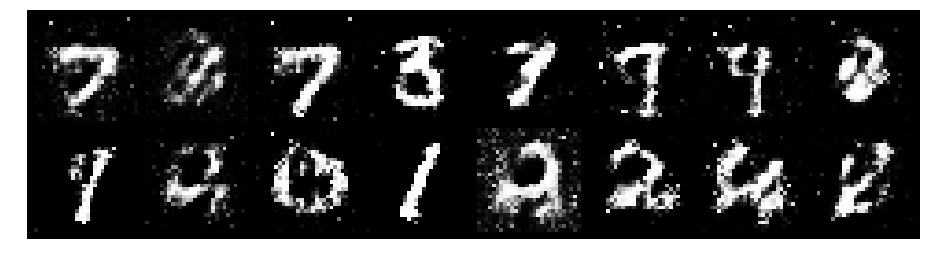

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.3471, Generator Loss: 1.3441
D(x): 0.5940, D(G(z)): 0.3912


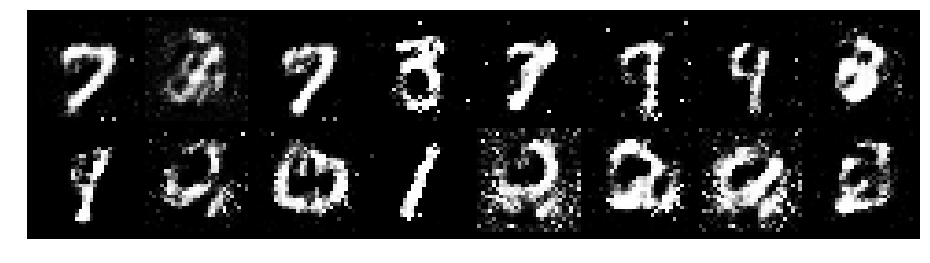

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9816, Generator Loss: 1.4516
D(x): 0.6681, D(G(z)): 0.3566


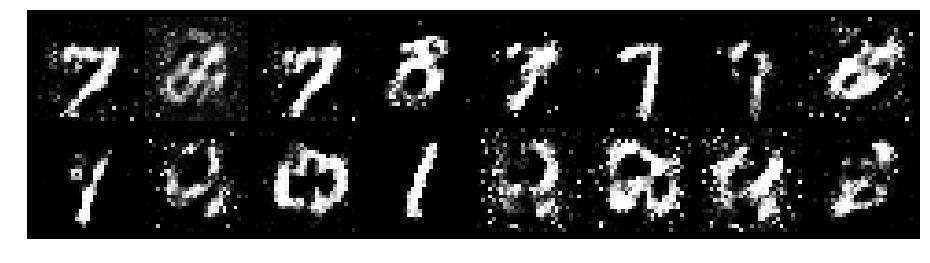

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0339, Generator Loss: 1.3861
D(x): 0.5912, D(G(z)): 0.2826


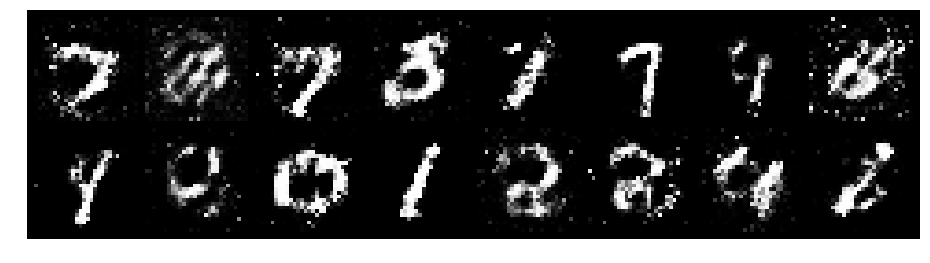

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.8827, Generator Loss: 1.3267
D(x): 0.7348, D(G(z)): 0.3486


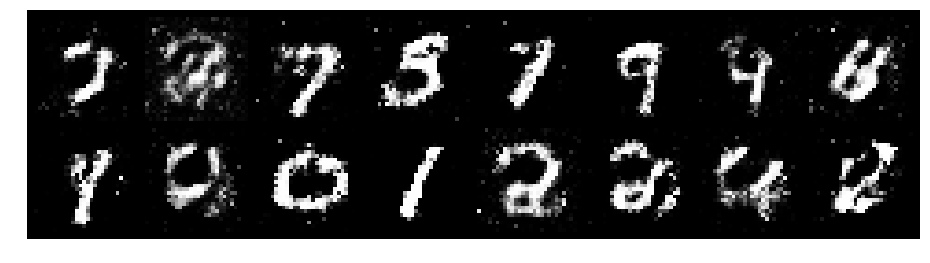

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9705, Generator Loss: 1.1359
D(x): 0.6839, D(G(z)): 0.3387


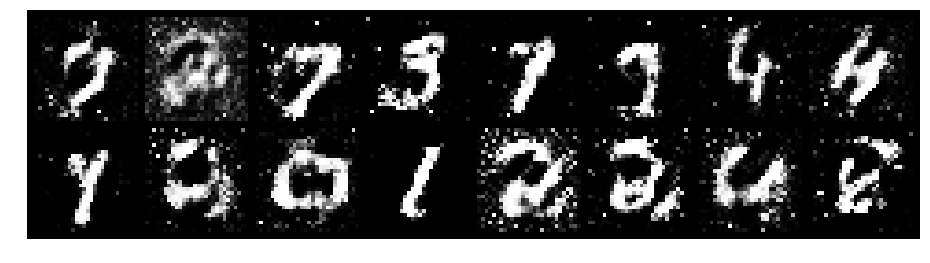

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0827, Generator Loss: 1.7233
D(x): 0.7211, D(G(z)): 0.4185


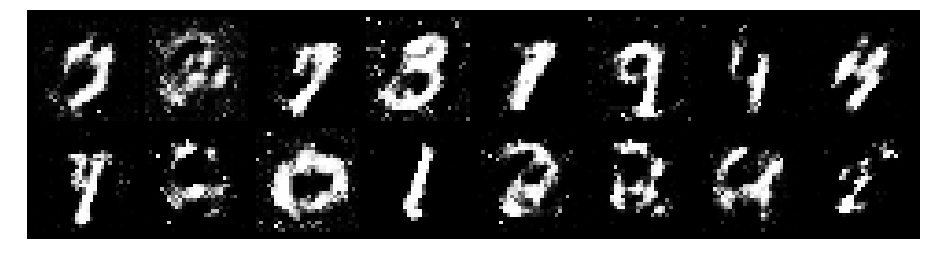

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.8476, Generator Loss: 1.3143
D(x): 0.7470, D(G(z)): 0.3384


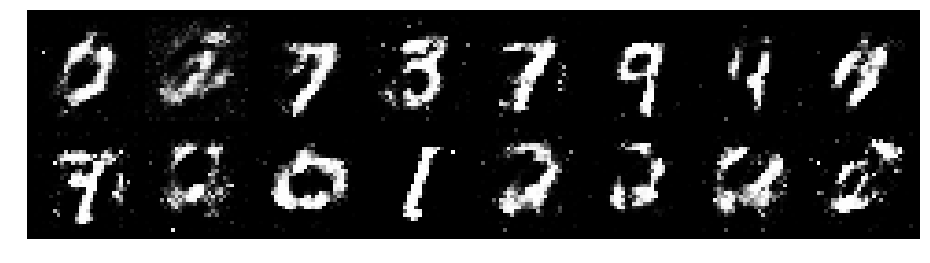

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9625, Generator Loss: 1.3744
D(x): 0.6901, D(G(z)): 0.3232


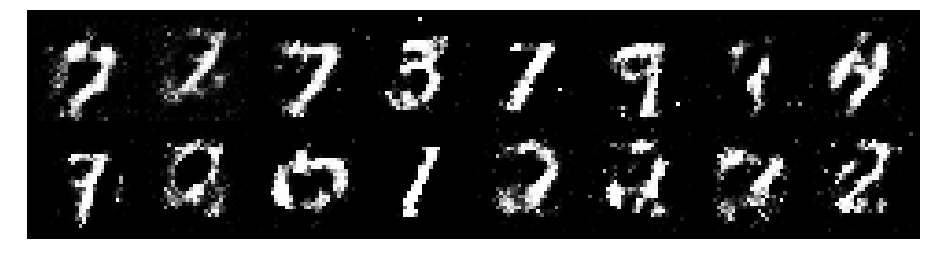

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.2048, Generator Loss: 1.5899
D(x): 0.6017, D(G(z)): 0.3311


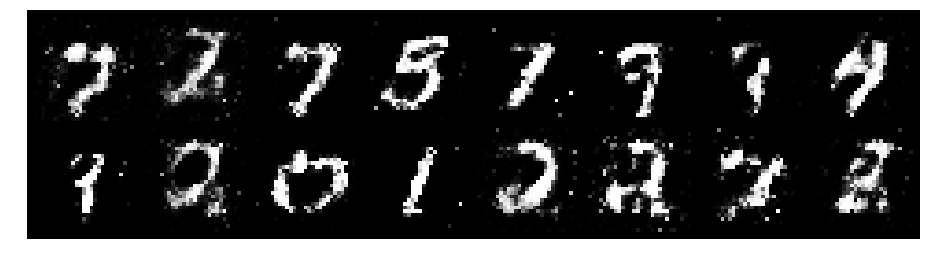

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8440, Generator Loss: 1.4434
D(x): 0.7431, D(G(z)): 0.3178


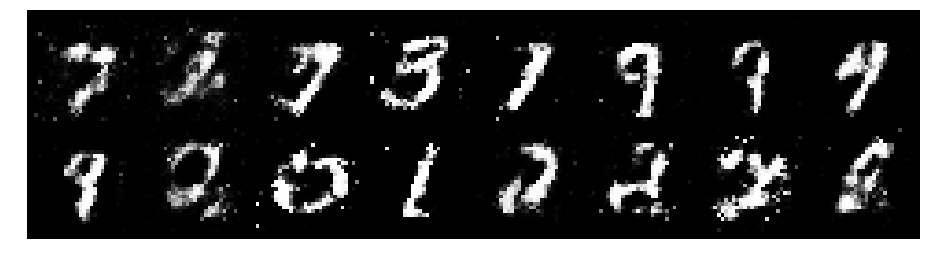

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8626, Generator Loss: 1.5289
D(x): 0.7084, D(G(z)): 0.3294


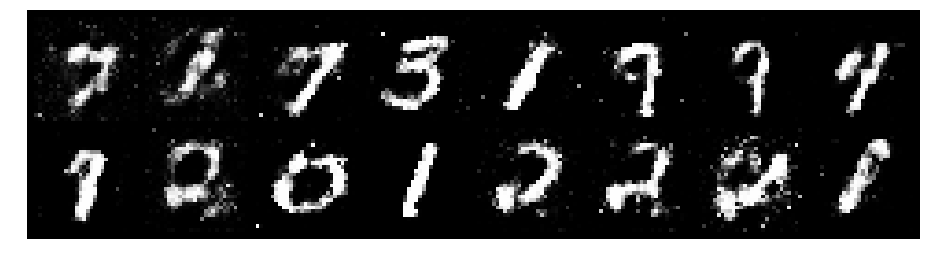

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8560, Generator Loss: 1.8778
D(x): 0.6931, D(G(z)): 0.2650


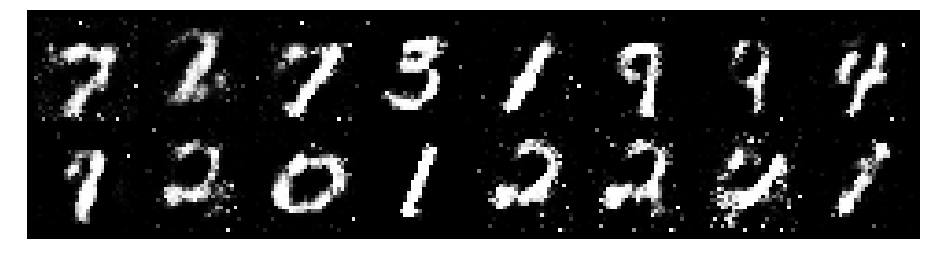

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0195, Generator Loss: 1.2227
D(x): 0.6122, D(G(z)): 0.2544


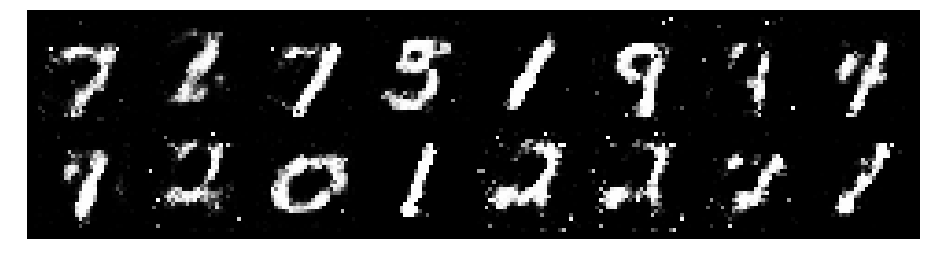

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9573, Generator Loss: 1.5991
D(x): 0.6749, D(G(z)): 0.3212


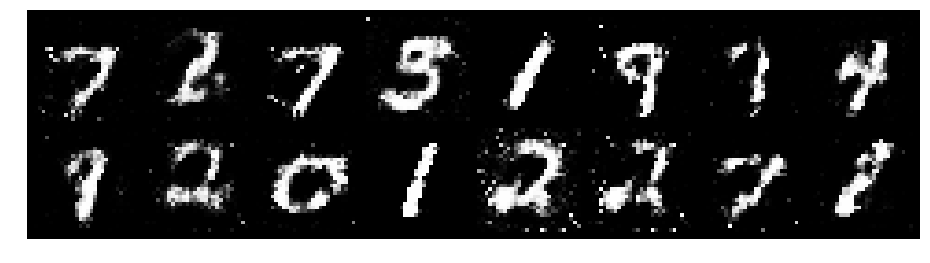

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0018, Generator Loss: 1.5273
D(x): 0.6520, D(G(z)): 0.3227


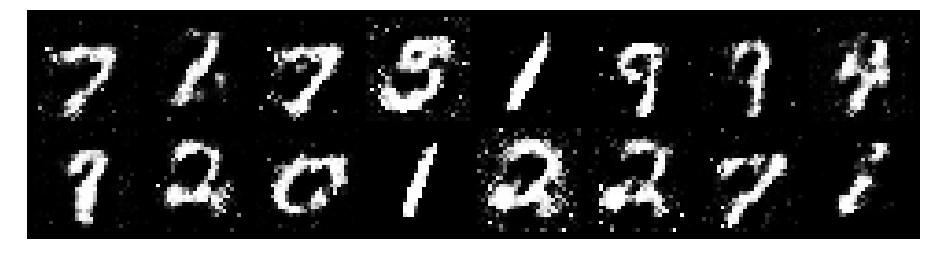

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.9517, Generator Loss: 1.4641
D(x): 0.6908, D(G(z)): 0.3407


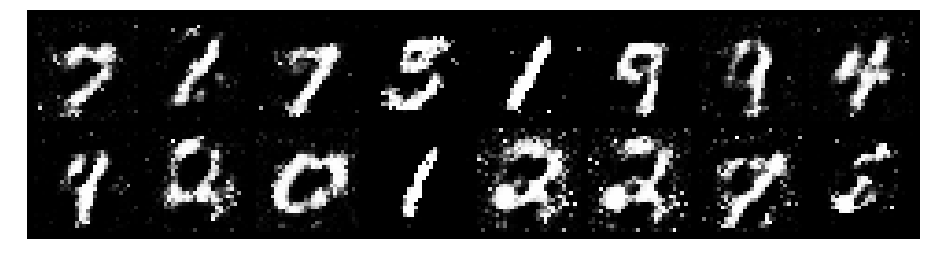

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.8542, Generator Loss: 1.6418
D(x): 0.6958, D(G(z)): 0.3085


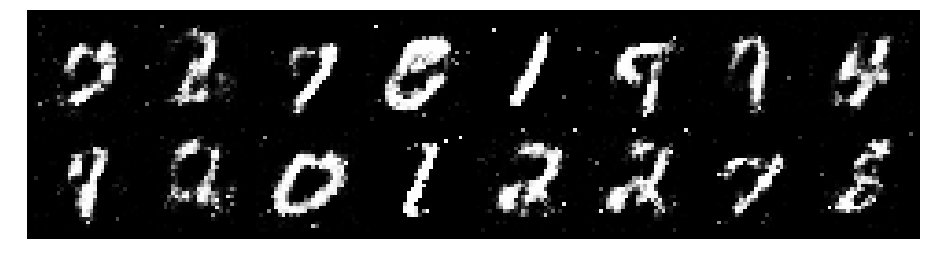

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.8831, Generator Loss: 1.6779
D(x): 0.6432, D(G(z)): 0.2579


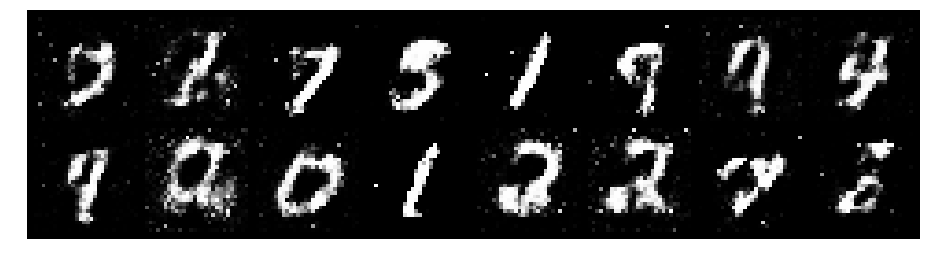

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9046, Generator Loss: 1.8149
D(x): 0.6955, D(G(z)): 0.2736


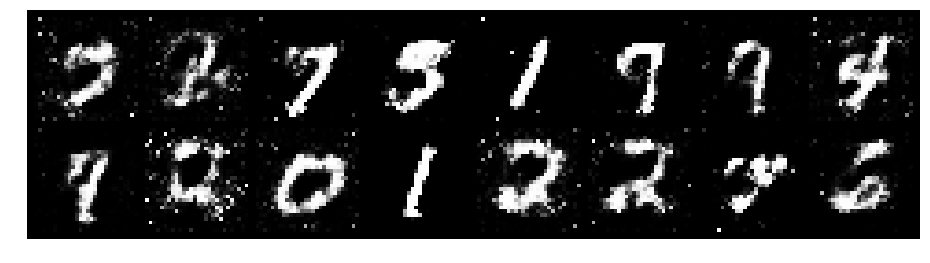

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.9376, Generator Loss: 1.8130
D(x): 0.6502, D(G(z)): 0.2722


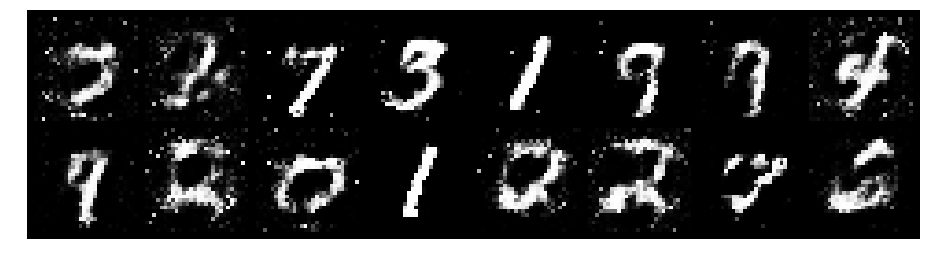

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8627, Generator Loss: 1.3990
D(x): 0.6682, D(G(z)): 0.2554


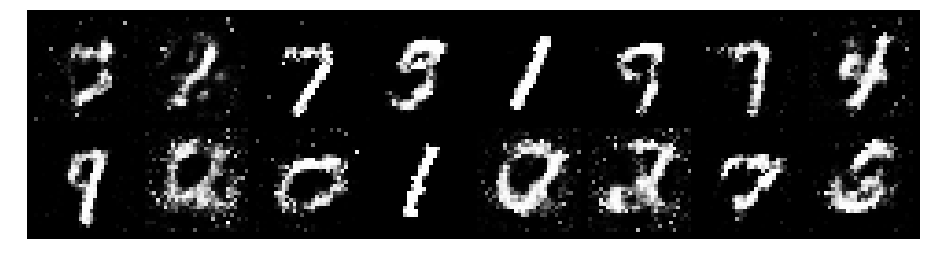

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0962, Generator Loss: 1.4079
D(x): 0.6714, D(G(z)): 0.3524


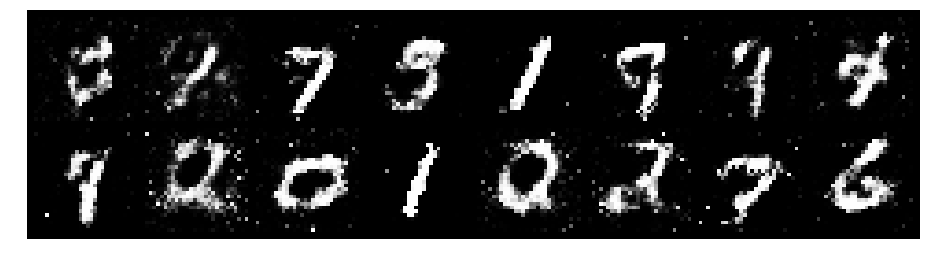

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9979, Generator Loss: 1.2551
D(x): 0.6869, D(G(z)): 0.3124


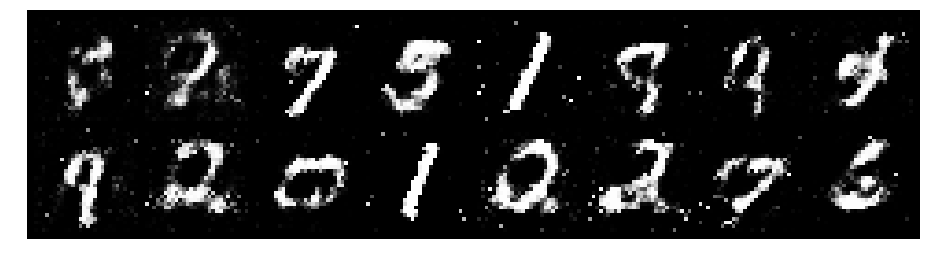

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.8770, Generator Loss: 1.1955
D(x): 0.7156, D(G(z)): 0.3157


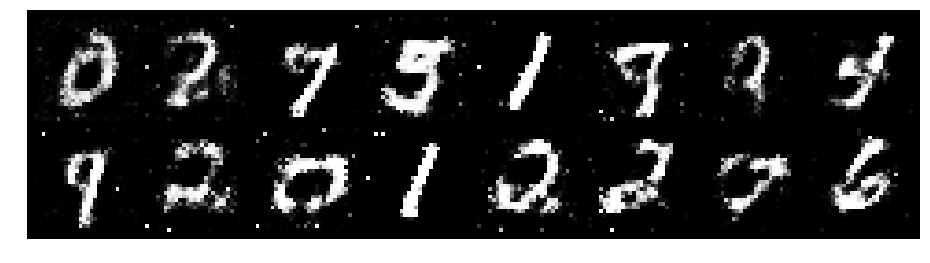

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.0184, Generator Loss: 1.2680
D(x): 0.6895, D(G(z)): 0.3615


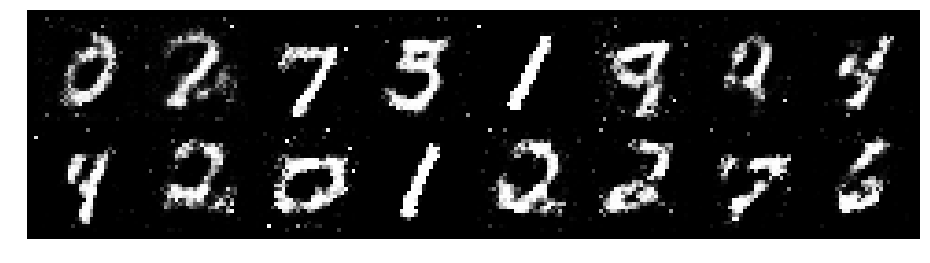

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.9896, Generator Loss: 1.5810
D(x): 0.6412, D(G(z)): 0.2836


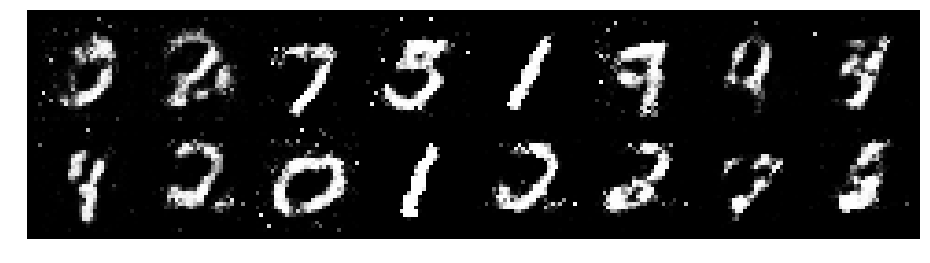

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8271, Generator Loss: 1.6206
D(x): 0.6853, D(G(z)): 0.2577


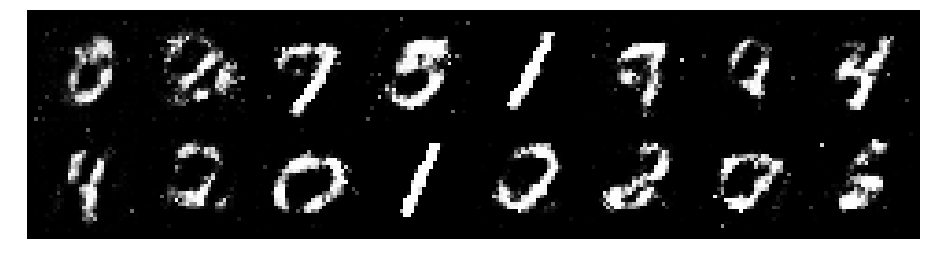

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9930, Generator Loss: 1.5585
D(x): 0.6604, D(G(z)): 0.3212


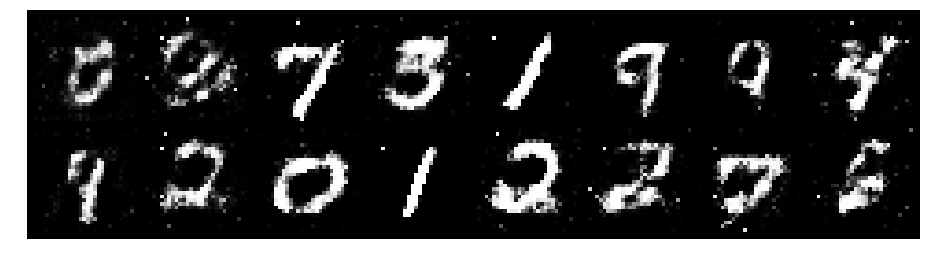

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0052, Generator Loss: 1.5603
D(x): 0.6660, D(G(z)): 0.3039


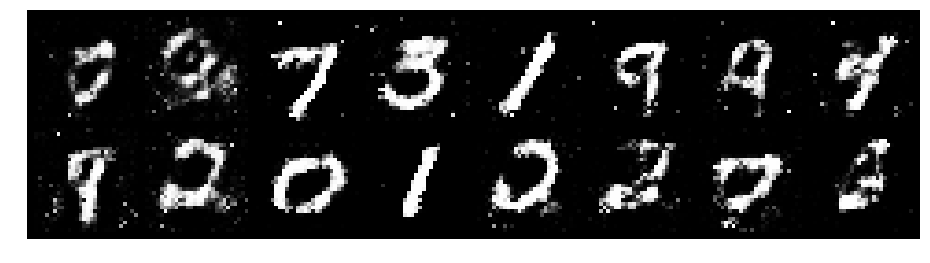

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.9621, Generator Loss: 1.3204
D(x): 0.7848, D(G(z)): 0.3834


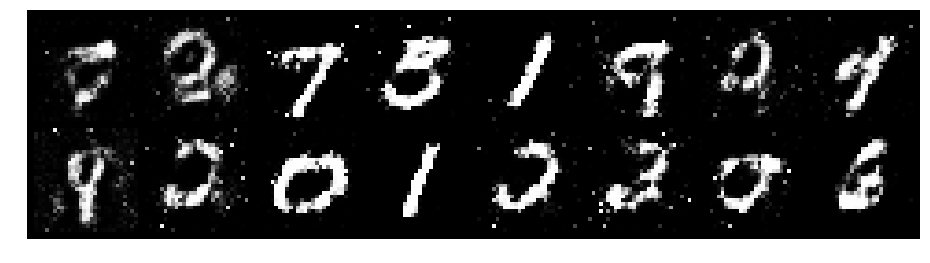

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.8770, Generator Loss: 1.4057
D(x): 0.6903, D(G(z)): 0.3130


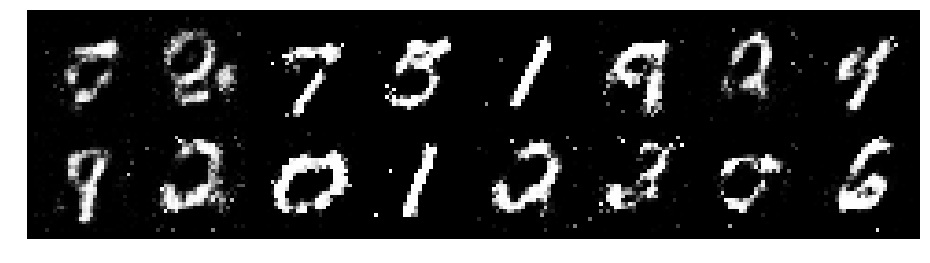

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9732, Generator Loss: 1.7071
D(x): 0.6452, D(G(z)): 0.2652


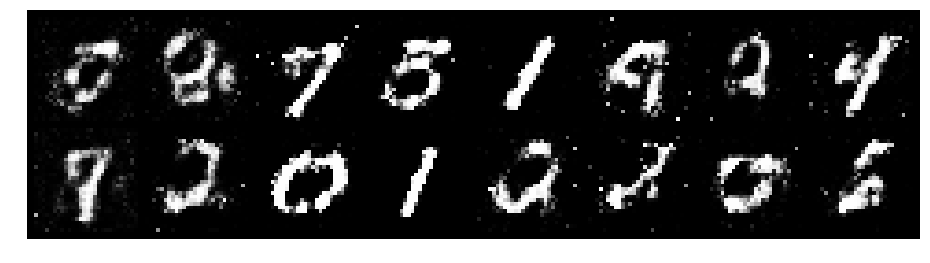

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.1777, Generator Loss: 1.4094
D(x): 0.7027, D(G(z)): 0.4079


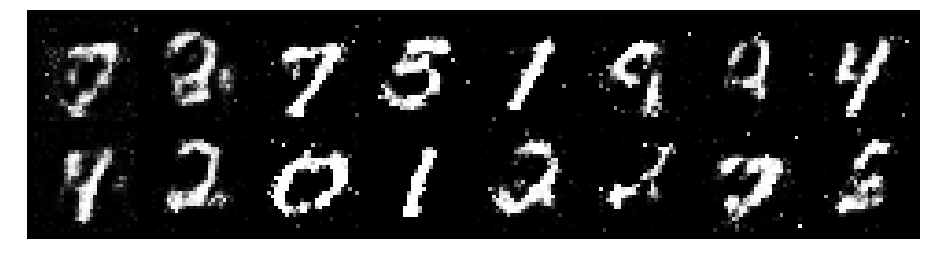

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1711, Generator Loss: 1.5603
D(x): 0.6781, D(G(z)): 0.3799


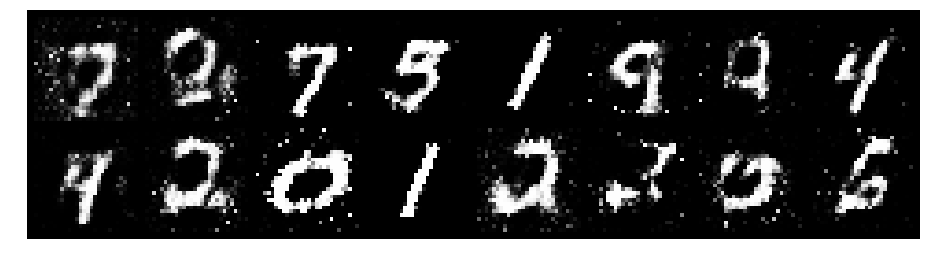

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0004, Generator Loss: 1.4430
D(x): 0.6022, D(G(z)): 0.2822


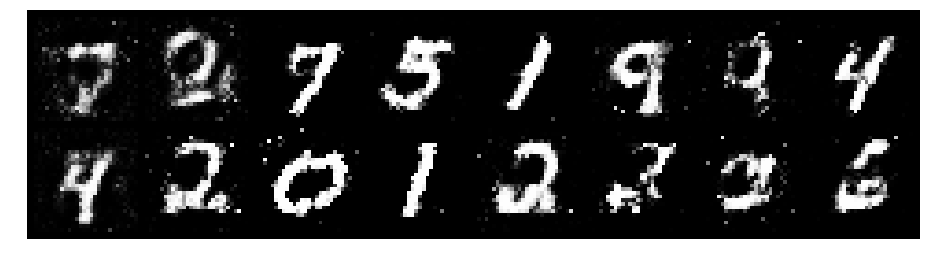

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9323, Generator Loss: 1.3370
D(x): 0.6956, D(G(z)): 0.3318


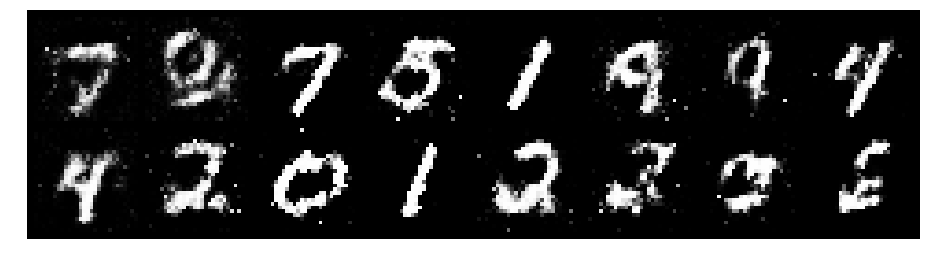

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.8523, Generator Loss: 1.4006
D(x): 0.7512, D(G(z)): 0.3411


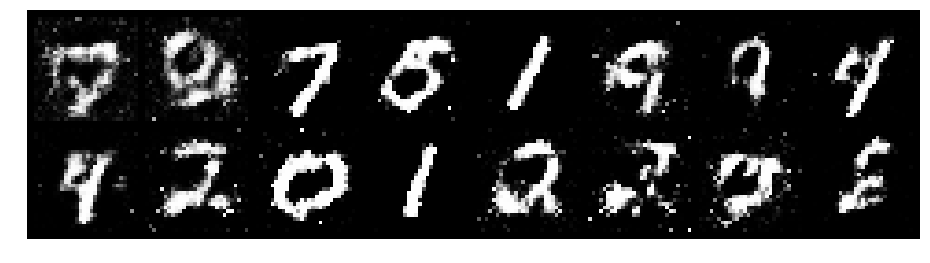

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.8199, Generator Loss: 1.4491
D(x): 0.6657, D(G(z)): 0.2178


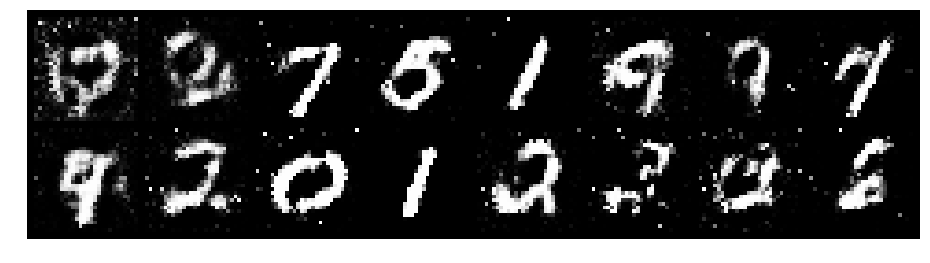

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.1365, Generator Loss: 1.2518
D(x): 0.6610, D(G(z)): 0.3852


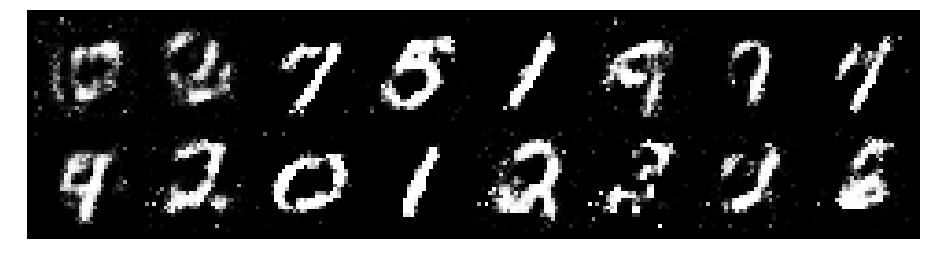

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.1003, Generator Loss: 1.1921
D(x): 0.6467, D(G(z)): 0.3775


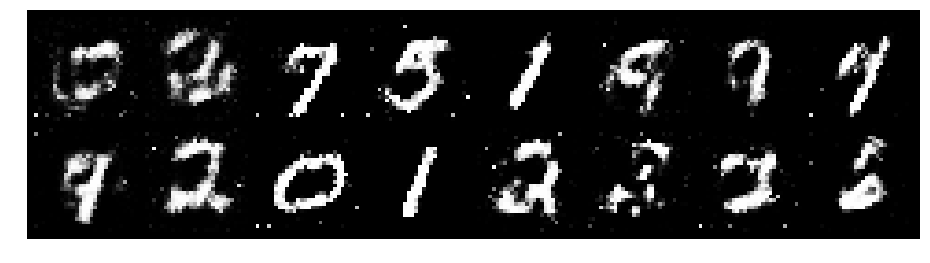

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0282, Generator Loss: 1.2603
D(x): 0.7073, D(G(z)): 0.3739


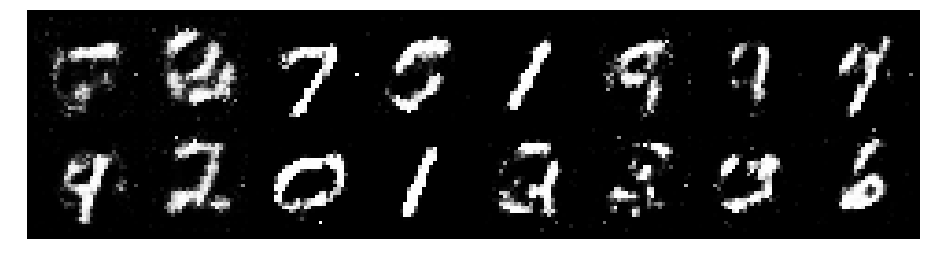

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0013, Generator Loss: 1.3655
D(x): 0.7075, D(G(z)): 0.3884


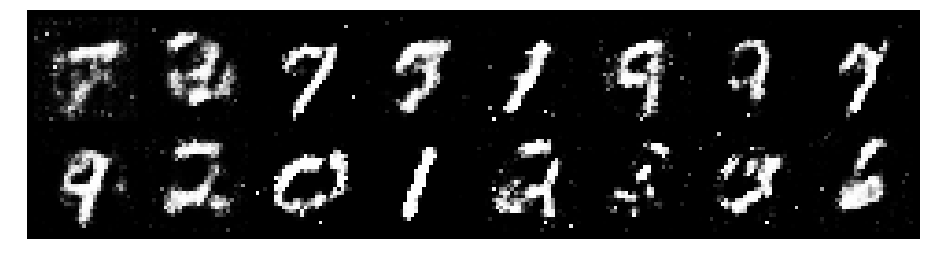

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9873, Generator Loss: 1.5360
D(x): 0.6544, D(G(z)): 0.3153


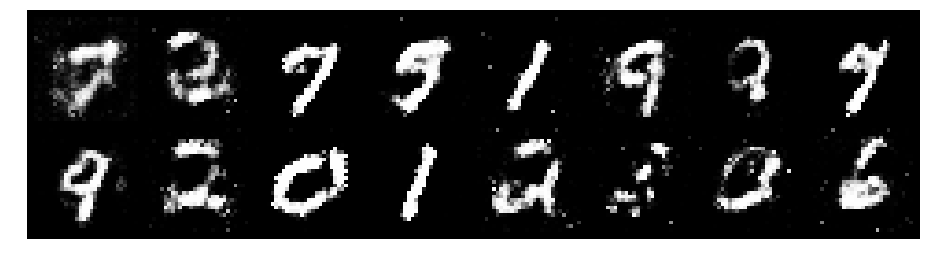

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.2336, Generator Loss: 1.2748
D(x): 0.6930, D(G(z)): 0.4768


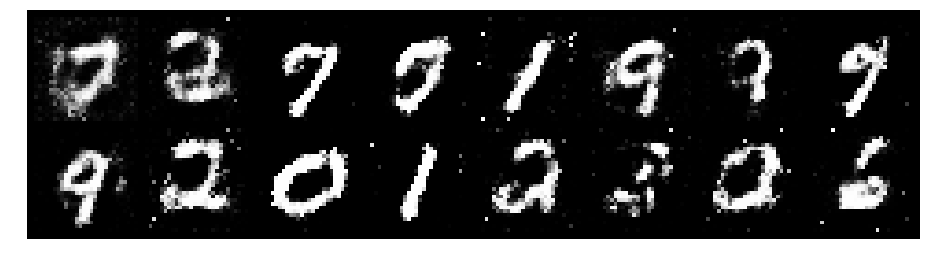

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.2454, Generator Loss: 1.0164
D(x): 0.6711, D(G(z)): 0.4428


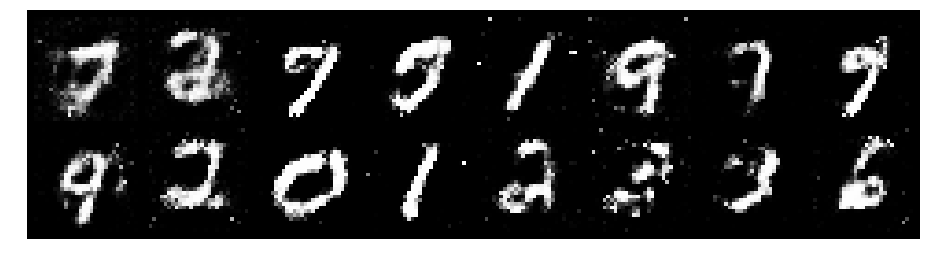

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.3222, Generator Loss: 1.0317
D(x): 0.5995, D(G(z)): 0.4076


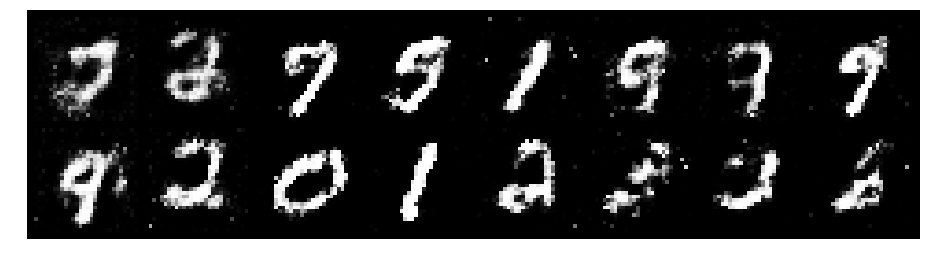

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1419, Generator Loss: 0.9013
D(x): 0.7078, D(G(z)): 0.4519


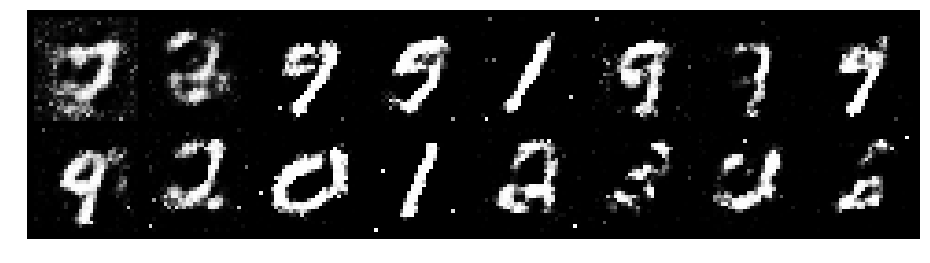

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1294, Generator Loss: 1.0644
D(x): 0.6230, D(G(z)): 0.3892


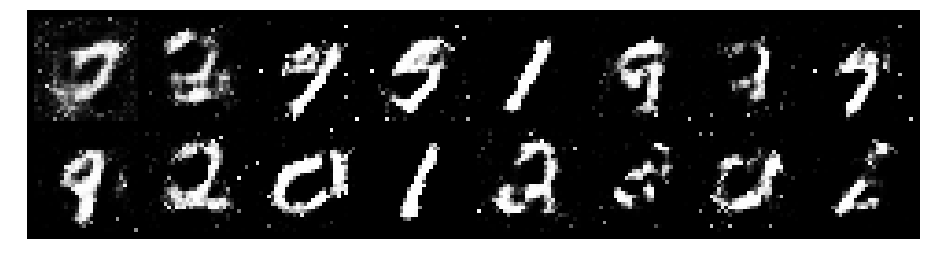

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0739, Generator Loss: 1.3721
D(x): 0.6221, D(G(z)): 0.3433


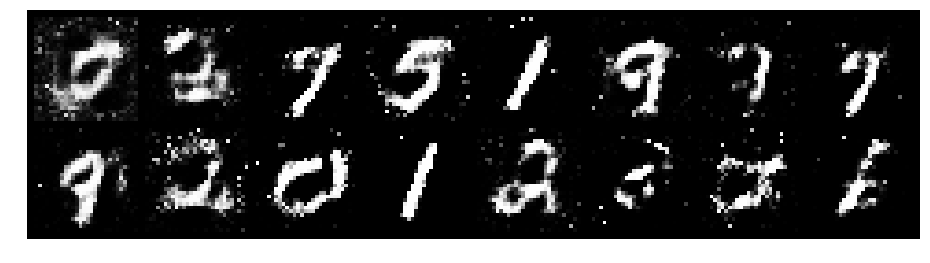

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.0944, Generator Loss: 1.2669
D(x): 0.6488, D(G(z)): 0.3616


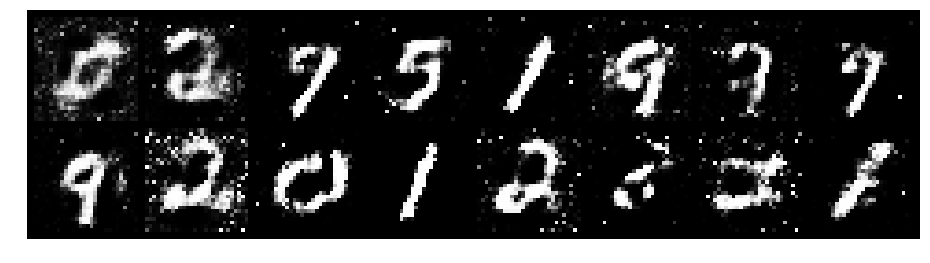

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.1222, Generator Loss: 1.0301
D(x): 0.6030, D(G(z)): 0.3750


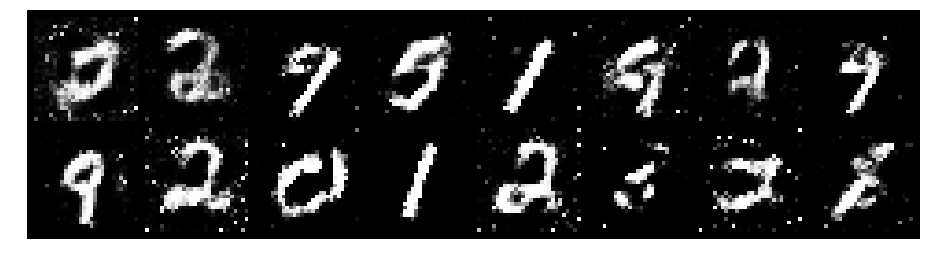

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.0271, Generator Loss: 1.3334
D(x): 0.6173, D(G(z)): 0.3069


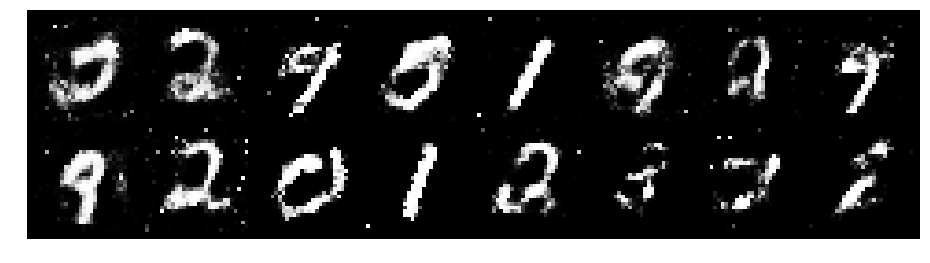

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.8699, Generator Loss: 1.7292
D(x): 0.6857, D(G(z)): 0.2688


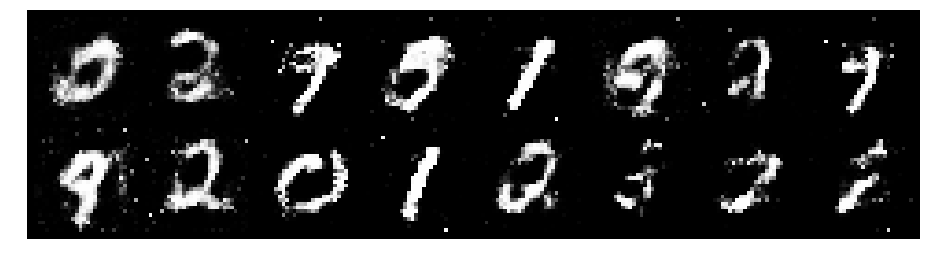

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9688, Generator Loss: 1.4625
D(x): 0.6440, D(G(z)): 0.3107


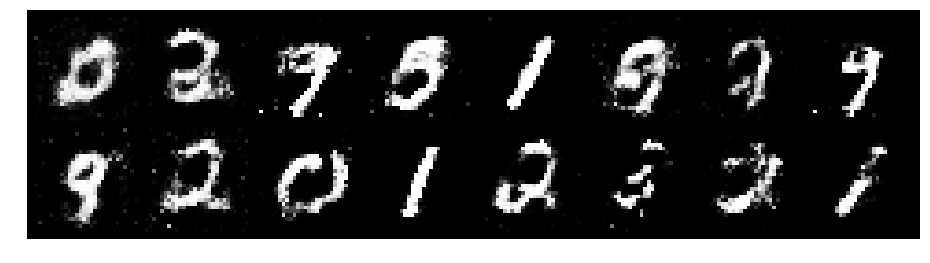

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9750, Generator Loss: 1.4039
D(x): 0.6616, D(G(z)): 0.3084


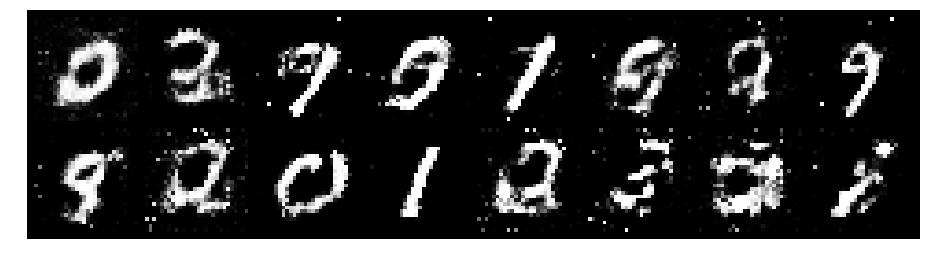

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0488, Generator Loss: 1.4080
D(x): 0.6485, D(G(z)): 0.3476


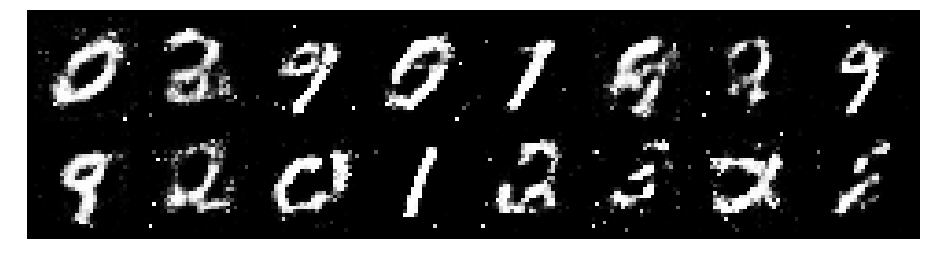

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0759, Generator Loss: 1.3171
D(x): 0.6379, D(G(z)): 0.3552


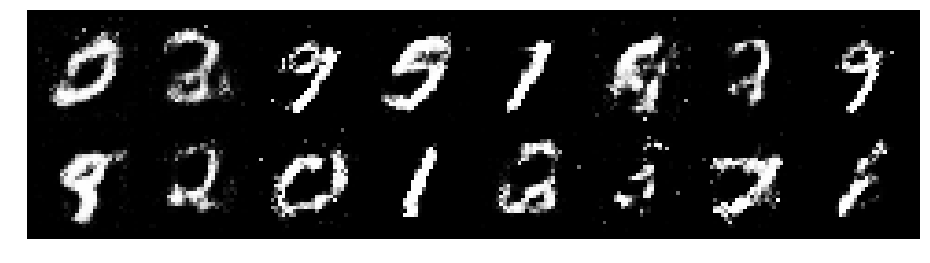

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.2838, Generator Loss: 1.1170
D(x): 0.5957, D(G(z)): 0.4137


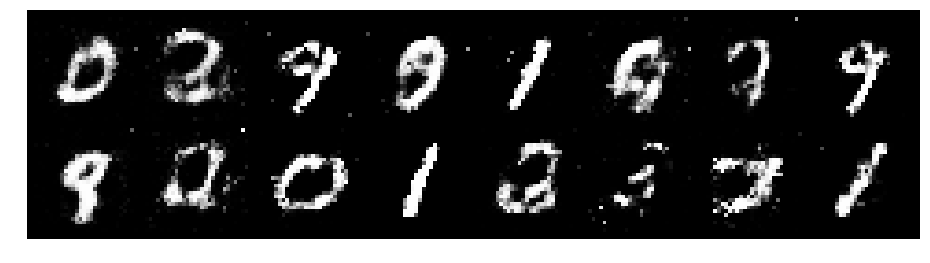

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1023, Generator Loss: 1.1247
D(x): 0.5786, D(G(z)): 0.3289


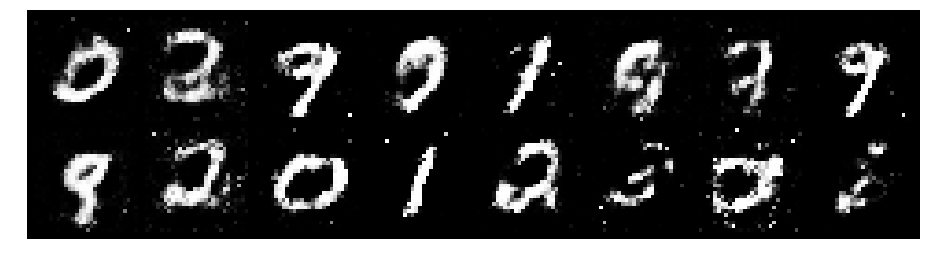

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9283, Generator Loss: 1.4856
D(x): 0.7295, D(G(z)): 0.3657


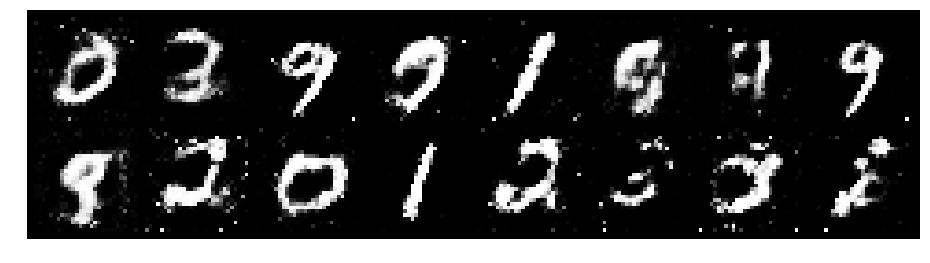

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 0.8116, Generator Loss: 1.5526
D(x): 0.7292, D(G(z)): 0.2961


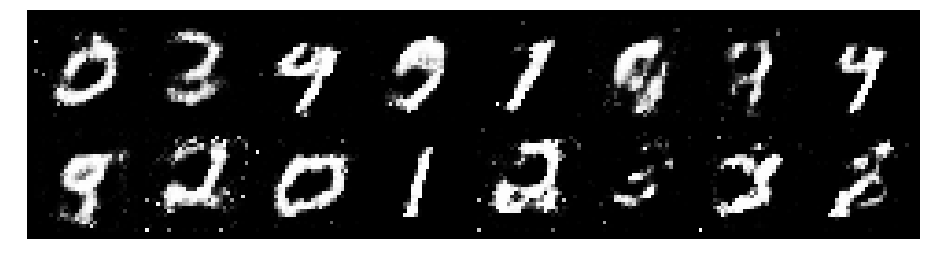

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1026, Generator Loss: 1.6013
D(x): 0.6657, D(G(z)): 0.3550


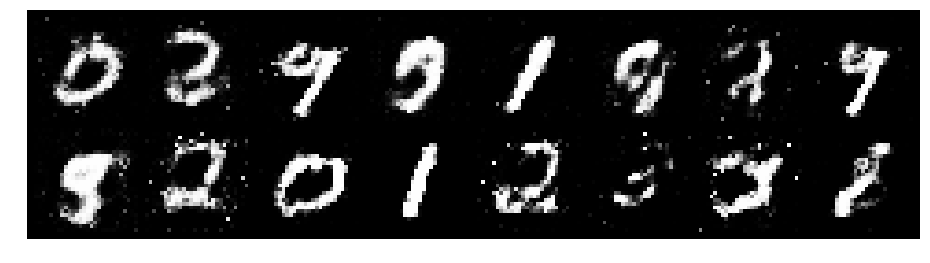

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.2489, Generator Loss: 1.0608
D(x): 0.5921, D(G(z)): 0.3699


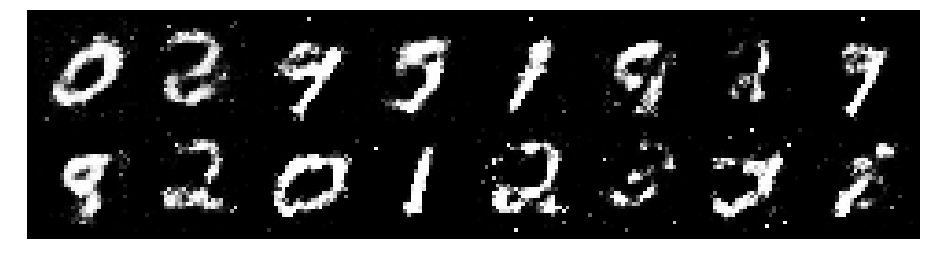

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0091, Generator Loss: 1.3845
D(x): 0.6934, D(G(z)): 0.3752


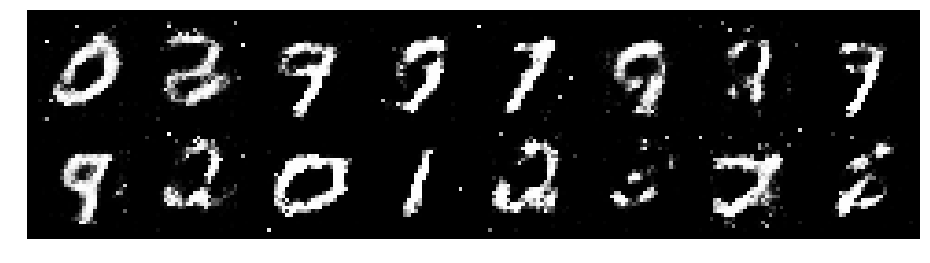

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1156, Generator Loss: 1.1800
D(x): 0.6024, D(G(z)): 0.3729


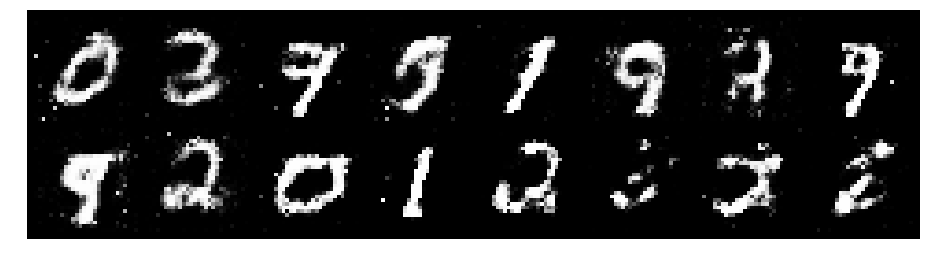

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0110, Generator Loss: 1.1537
D(x): 0.6496, D(G(z)): 0.3502


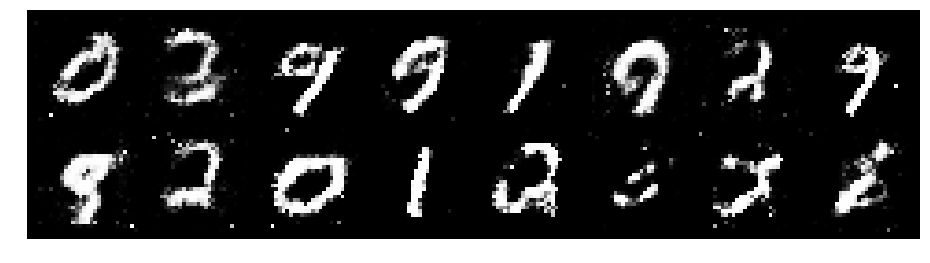

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.8549, Generator Loss: 1.4601
D(x): 0.6959, D(G(z)): 0.3168


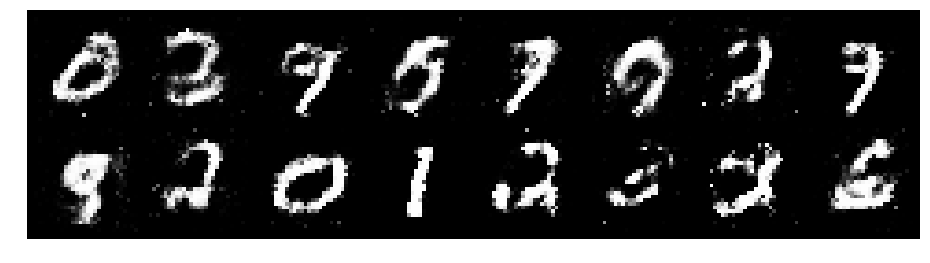

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 0.9890, Generator Loss: 1.3108
D(x): 0.6502, D(G(z)): 0.3346


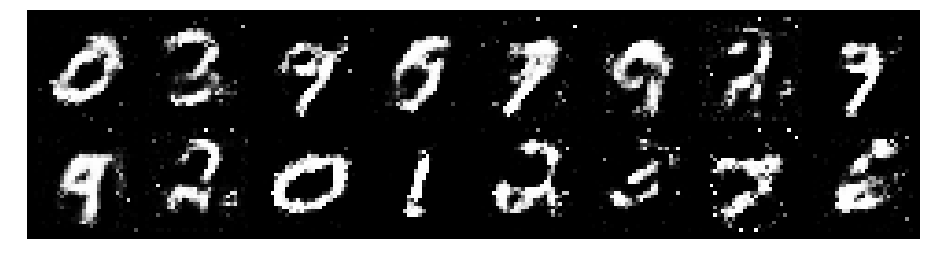

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0918, Generator Loss: 1.2774
D(x): 0.6747, D(G(z)): 0.3799


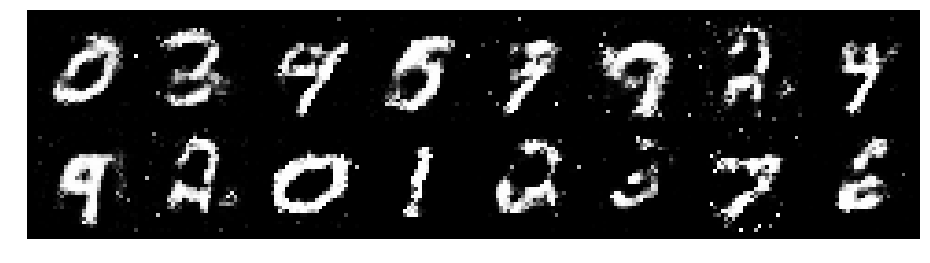

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0993, Generator Loss: 1.2187
D(x): 0.6231, D(G(z)): 0.3611


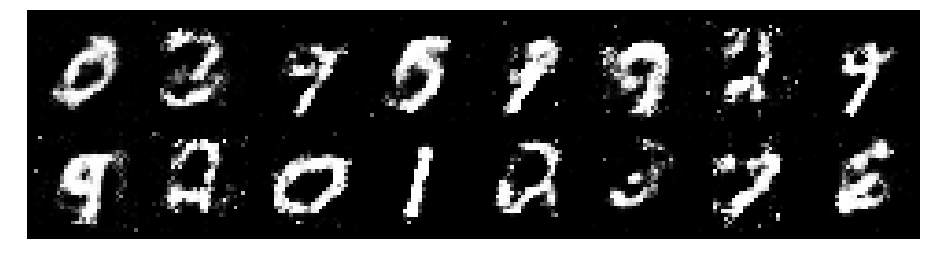

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 0.9678, Generator Loss: 1.3000
D(x): 0.6177, D(G(z)): 0.2791


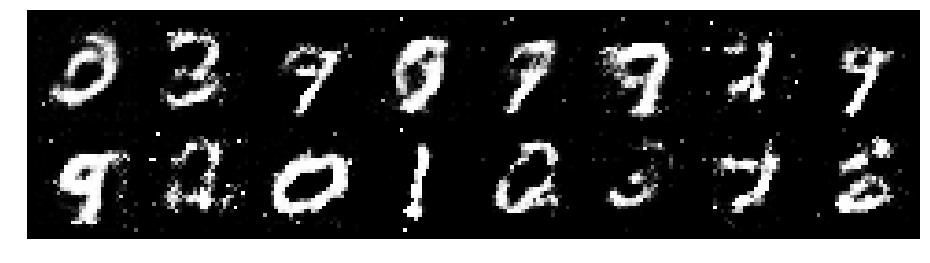

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9172, Generator Loss: 1.2417
D(x): 0.6730, D(G(z)): 0.3322


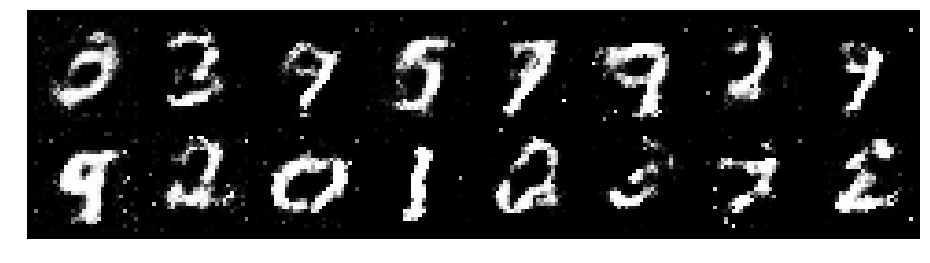

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.0709, Generator Loss: 1.2537
D(x): 0.6272, D(G(z)): 0.3672


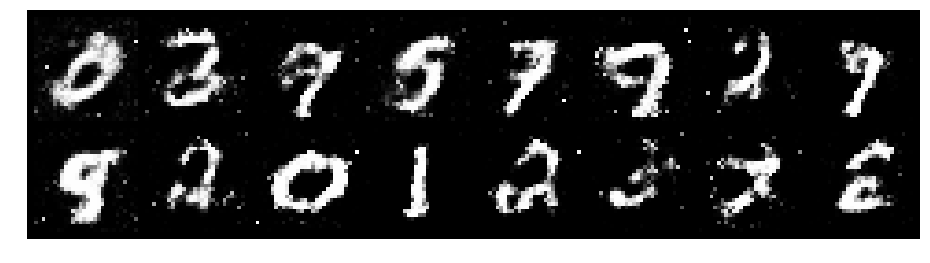

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.2969, Generator Loss: 1.2854
D(x): 0.5885, D(G(z)): 0.4292


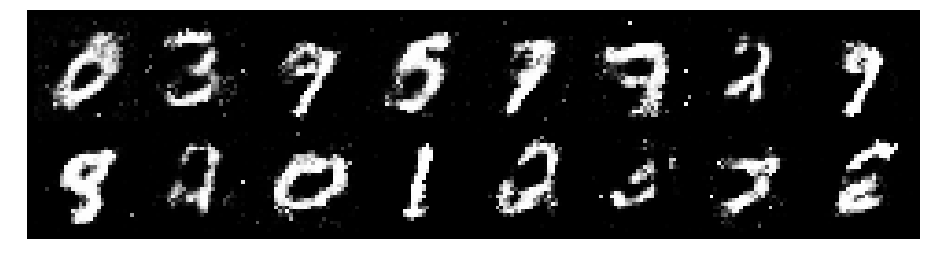

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0962, Generator Loss: 1.3044
D(x): 0.6634, D(G(z)): 0.3827


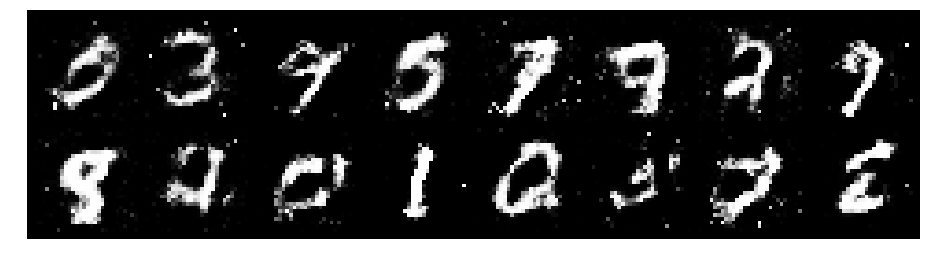

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.1436, Generator Loss: 0.9362
D(x): 0.6297, D(G(z)): 0.4096


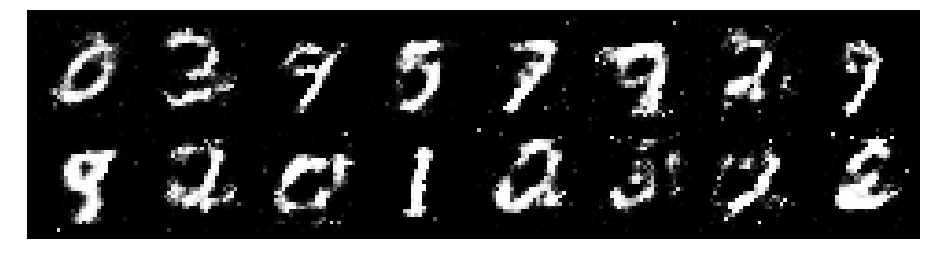

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0294, Generator Loss: 1.4416
D(x): 0.6643, D(G(z)): 0.3647


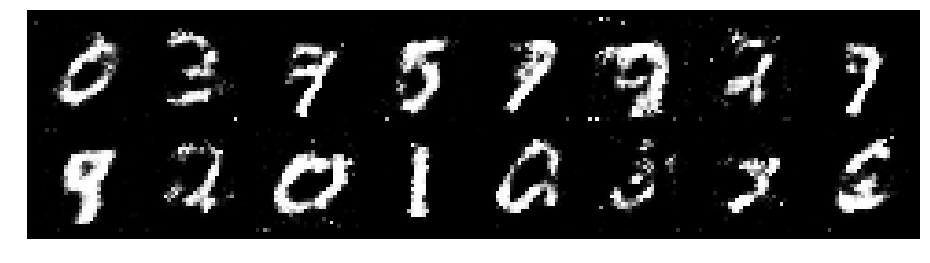

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 0.9294, Generator Loss: 1.3409
D(x): 0.6990, D(G(z)): 0.3402


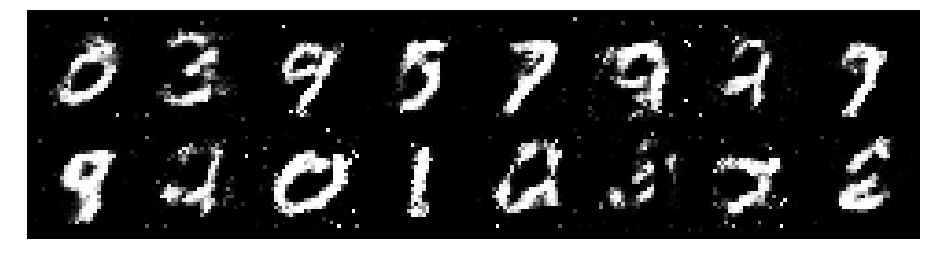

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0639, Generator Loss: 1.3986
D(x): 0.5990, D(G(z)): 0.2937


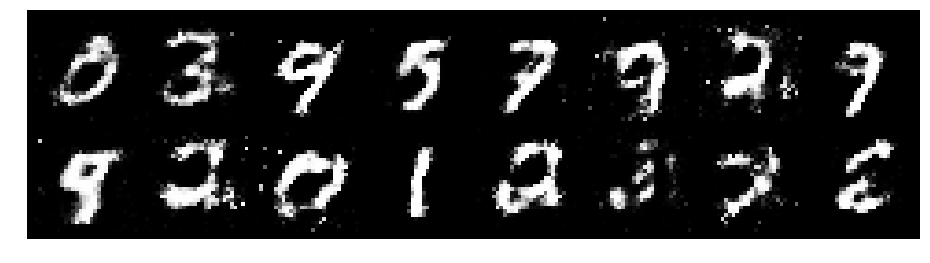

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1748, Generator Loss: 1.3636
D(x): 0.6699, D(G(z)): 0.4186


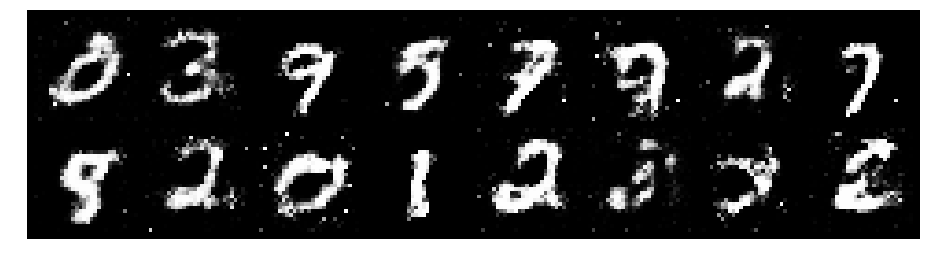

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1895, Generator Loss: 0.9666
D(x): 0.6590, D(G(z)): 0.4460


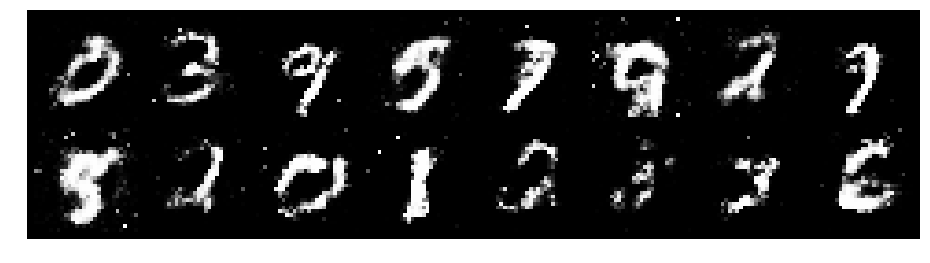

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0962, Generator Loss: 1.5903
D(x): 0.6130, D(G(z)): 0.3282


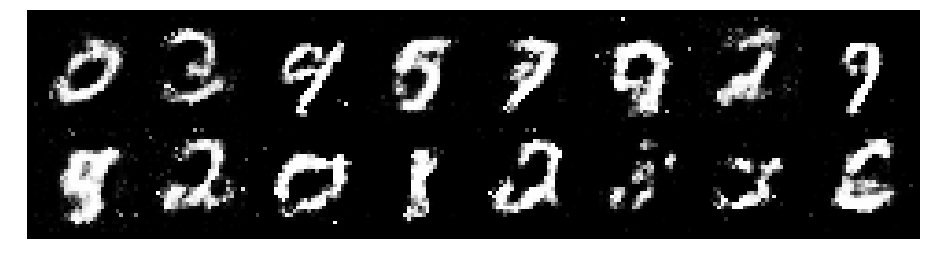

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.2444, Generator Loss: 1.1327
D(x): 0.6353, D(G(z)): 0.4337


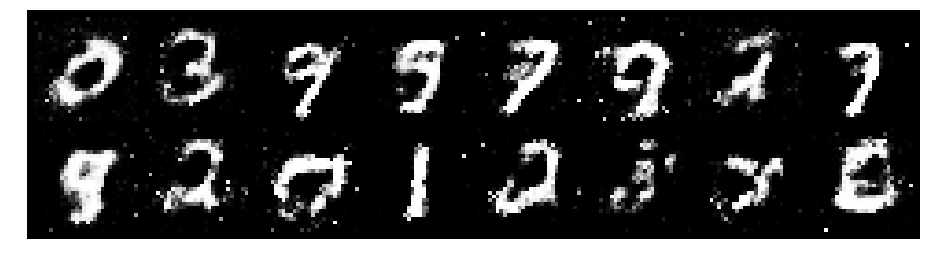

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0985, Generator Loss: 1.2674
D(x): 0.5727, D(G(z)): 0.3122


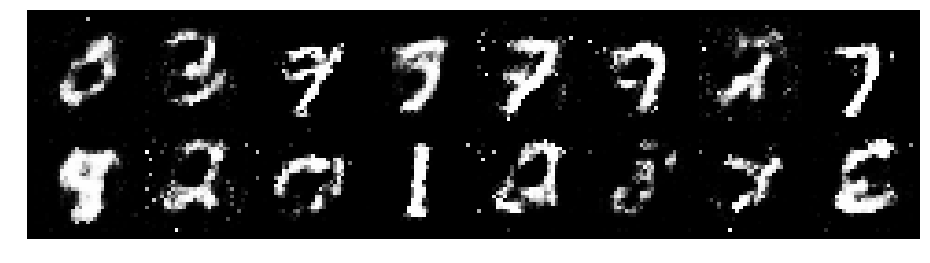

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9615, Generator Loss: 1.2567
D(x): 0.7379, D(G(z)): 0.3813


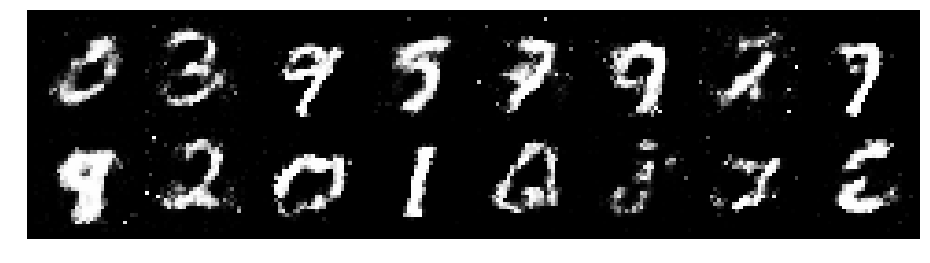

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0697, Generator Loss: 1.3015
D(x): 0.6292, D(G(z)): 0.3181


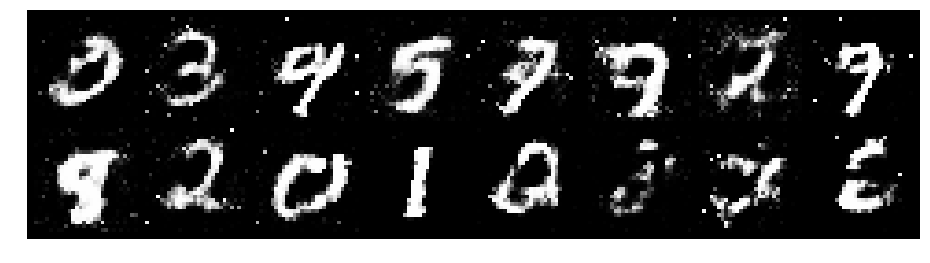

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.1996, Generator Loss: 1.2145
D(x): 0.6333, D(G(z)): 0.3924


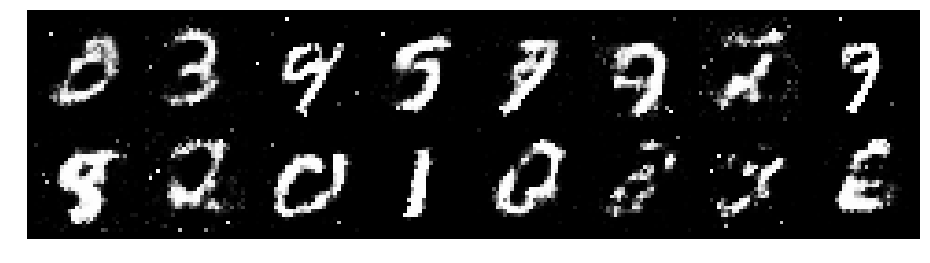

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1154, Generator Loss: 1.2886
D(x): 0.6333, D(G(z)): 0.3692


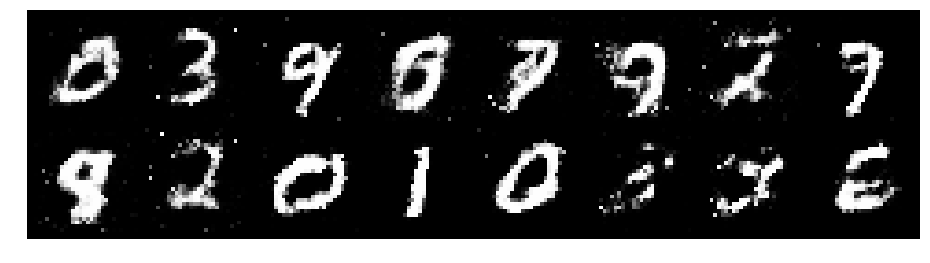

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0305, Generator Loss: 1.2591
D(x): 0.6263, D(G(z)): 0.3518


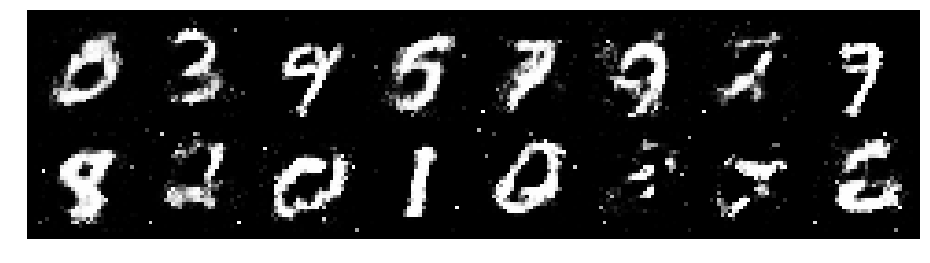

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0305, Generator Loss: 1.3944
D(x): 0.6550, D(G(z)): 0.3419


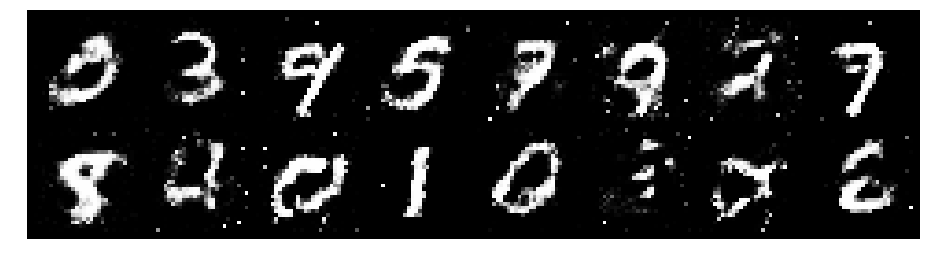

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.2415, Generator Loss: 1.0980
D(x): 0.6110, D(G(z)): 0.4137


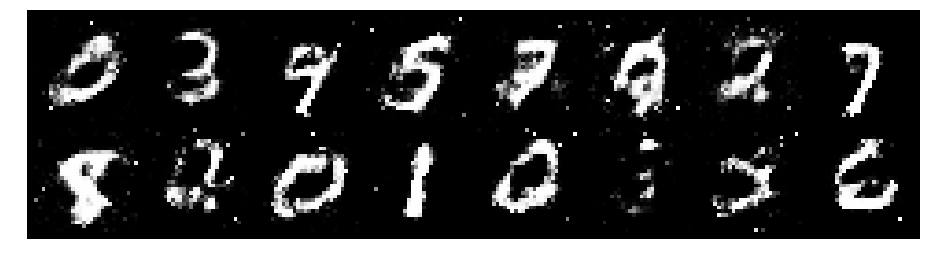

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.2976, Generator Loss: 0.9872
D(x): 0.5432, D(G(z)): 0.4028


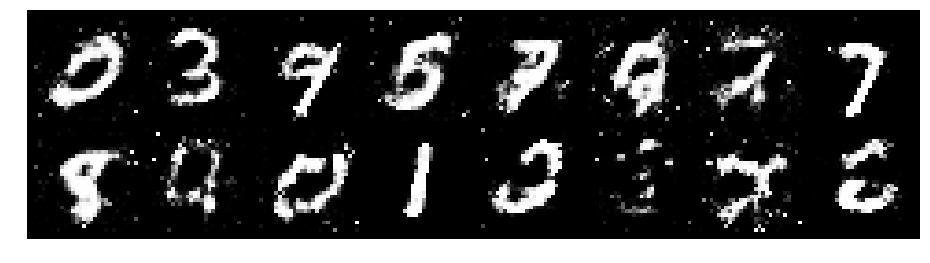

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.2641, Generator Loss: 1.0278
D(x): 0.5902, D(G(z)): 0.4174


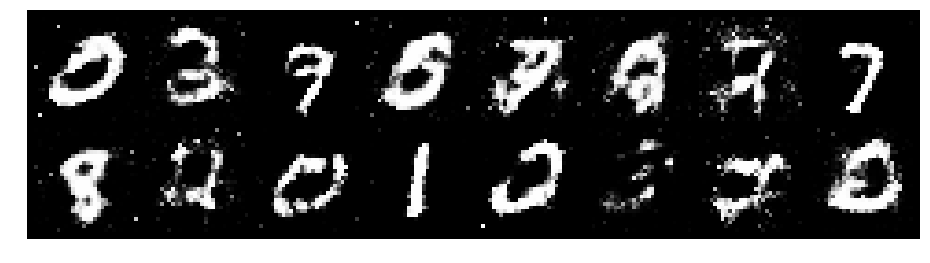

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1493, Generator Loss: 0.9097
D(x): 0.6353, D(G(z)): 0.4051


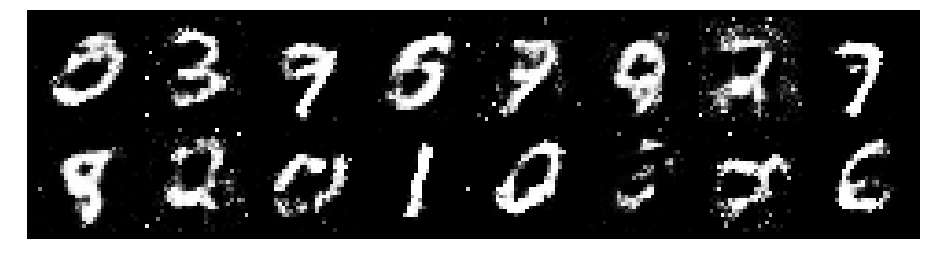

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.1341, Generator Loss: 1.1486
D(x): 0.6148, D(G(z)): 0.3816


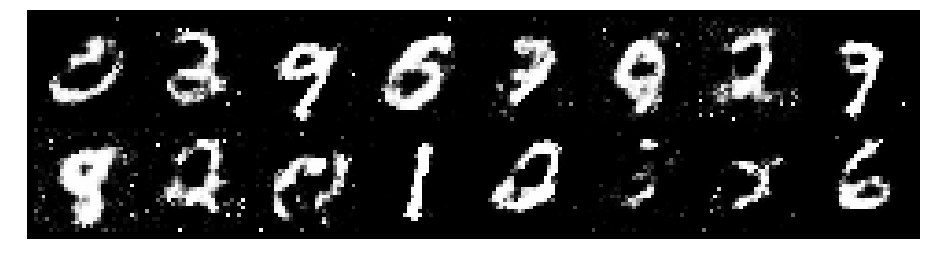

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.2223, Generator Loss: 1.0892
D(x): 0.6366, D(G(z)): 0.4492


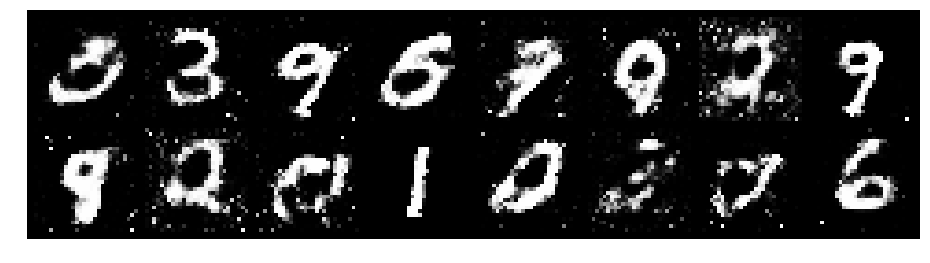

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1888, Generator Loss: 0.9609
D(x): 0.6166, D(G(z)): 0.4063


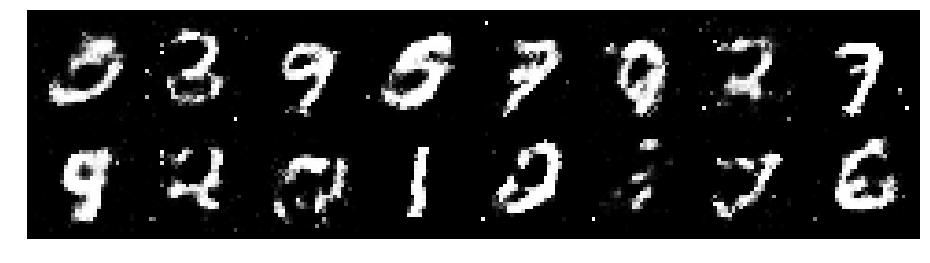

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2623, Generator Loss: 1.0144
D(x): 0.6040, D(G(z)): 0.4429


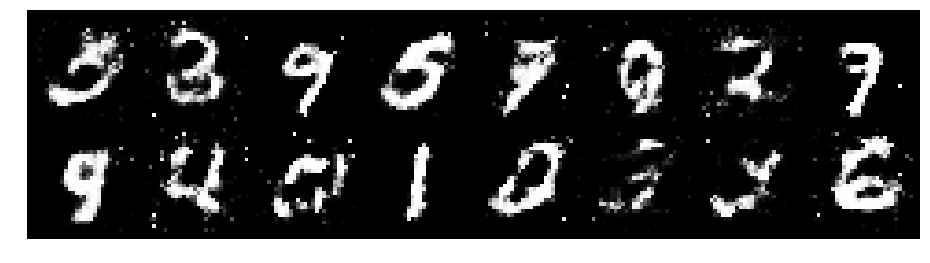

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.2627, Generator Loss: 1.2077
D(x): 0.5475, D(G(z)): 0.3767


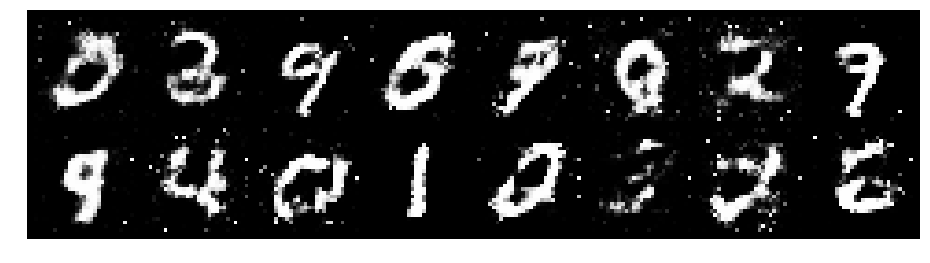

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.2958, Generator Loss: 0.8924
D(x): 0.6090, D(G(z)): 0.4682


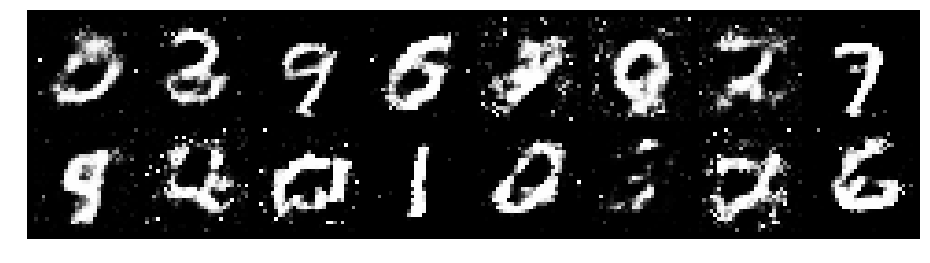

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.2009, Generator Loss: 1.0127
D(x): 0.6617, D(G(z)): 0.4498


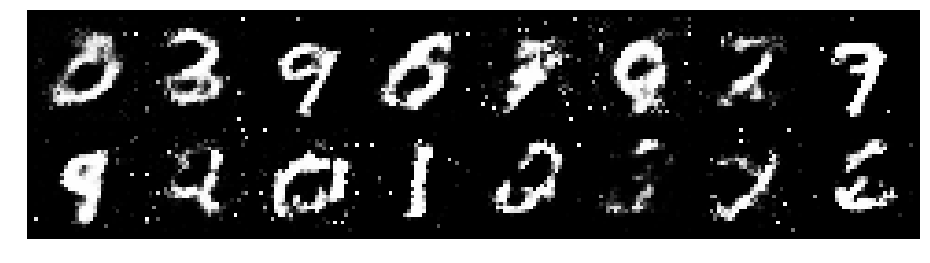

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0790, Generator Loss: 0.9635
D(x): 0.6705, D(G(z)): 0.4150


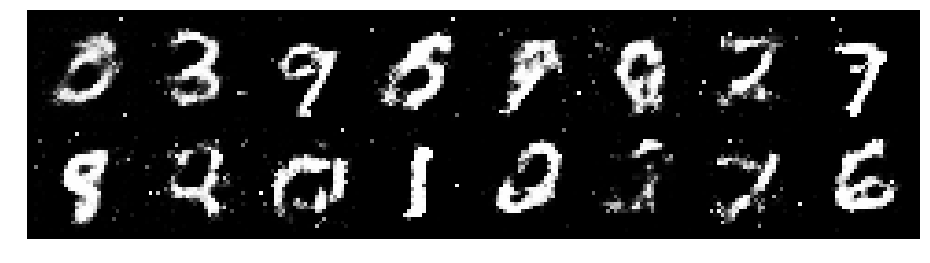

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.2071, Generator Loss: 1.1431
D(x): 0.5862, D(G(z)): 0.4004


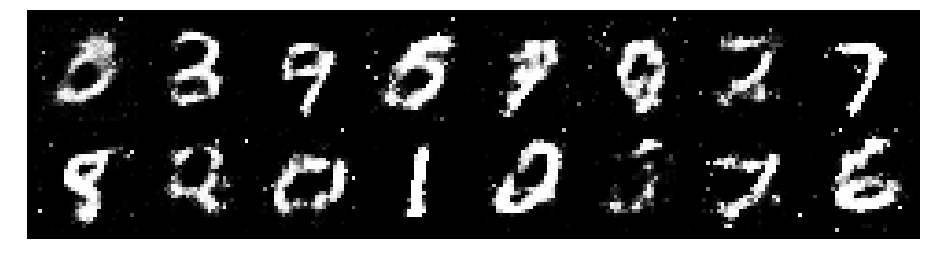

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1019, Generator Loss: 1.3187
D(x): 0.5633, D(G(z)): 0.3310


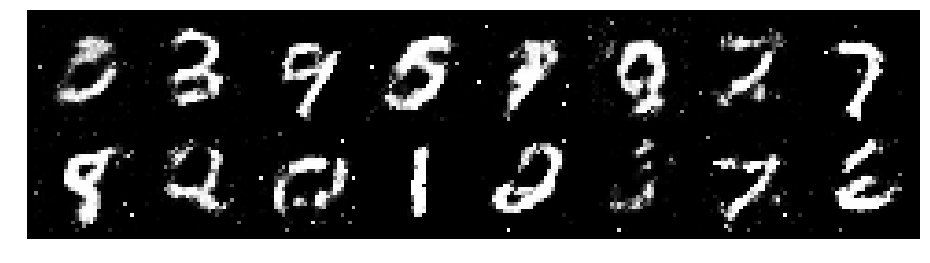

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0654, Generator Loss: 1.1669
D(x): 0.6548, D(G(z)): 0.4039


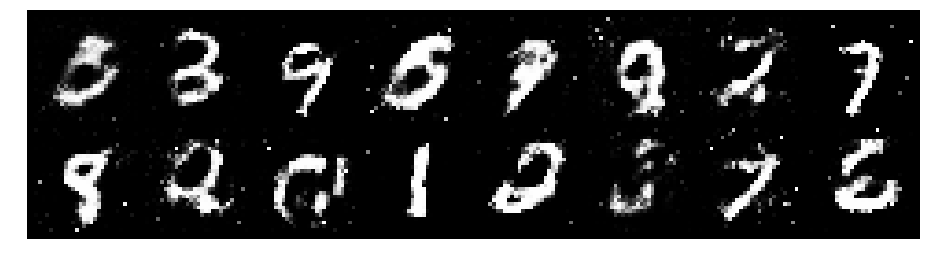

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1172, Generator Loss: 1.2237
D(x): 0.5597, D(G(z)): 0.3271


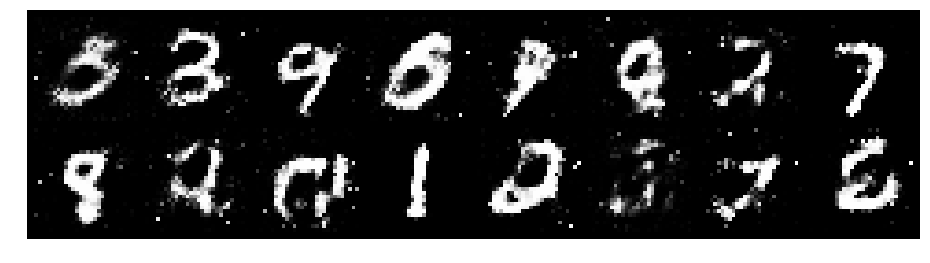

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 0.9970, Generator Loss: 1.3209
D(x): 0.6547, D(G(z)): 0.3519


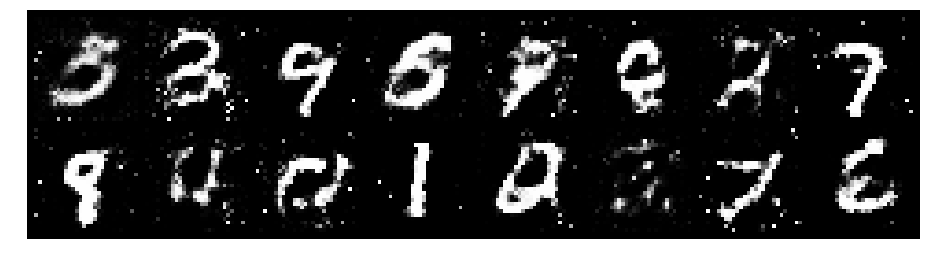

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.0003, Generator Loss: 1.2229
D(x): 0.6947, D(G(z)): 0.3725


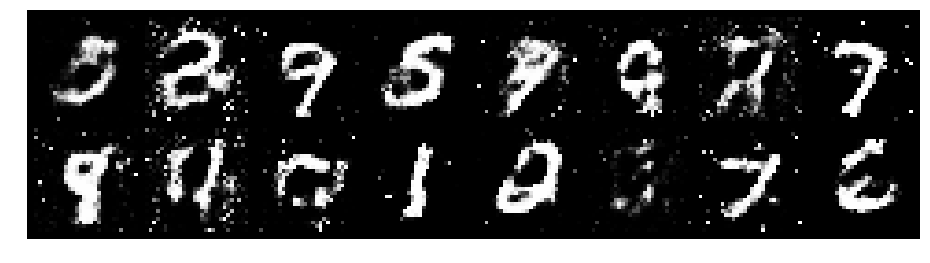

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0778, Generator Loss: 1.0396
D(x): 0.5717, D(G(z)): 0.3434


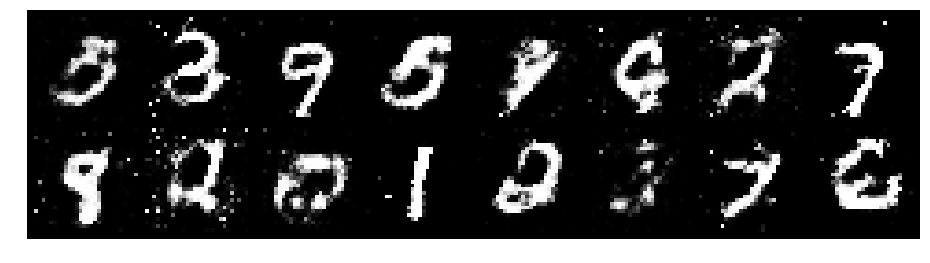

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1056, Generator Loss: 1.1327
D(x): 0.6202, D(G(z)): 0.3926


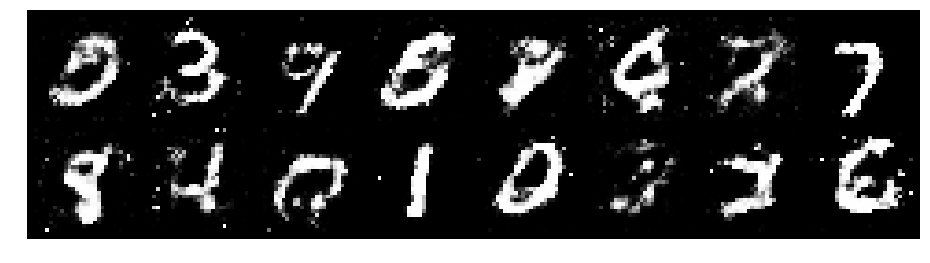

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1072, Generator Loss: 1.0915
D(x): 0.6069, D(G(z)): 0.3803


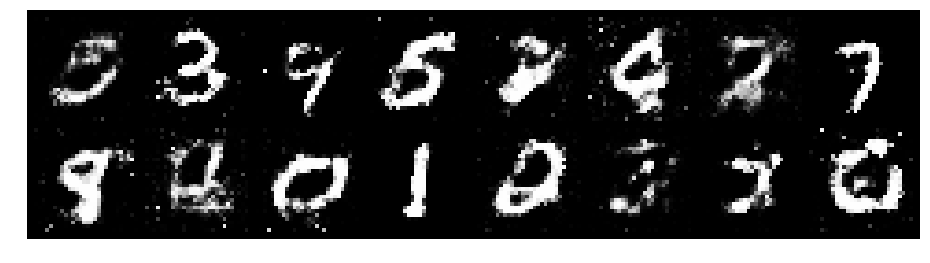

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1858, Generator Loss: 0.9424
D(x): 0.6275, D(G(z)): 0.4306


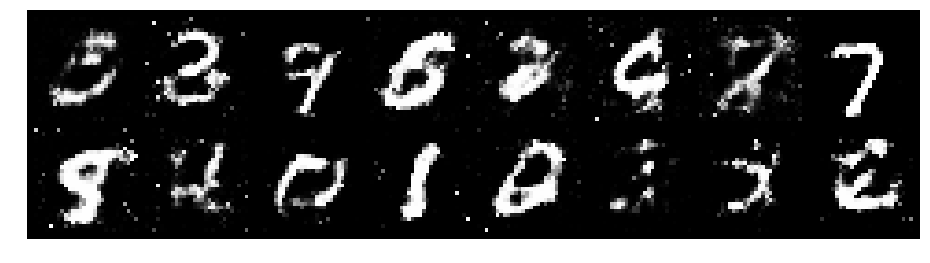

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1938, Generator Loss: 0.9622
D(x): 0.5872, D(G(z)): 0.3873


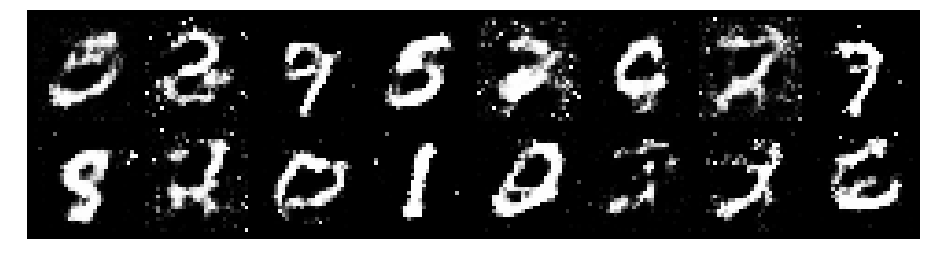

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.2407, Generator Loss: 1.0817
D(x): 0.5514, D(G(z)): 0.3804


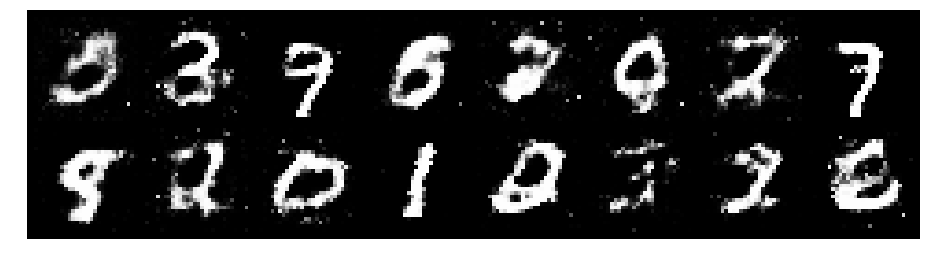

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1167, Generator Loss: 1.0959
D(x): 0.6564, D(G(z)): 0.4153


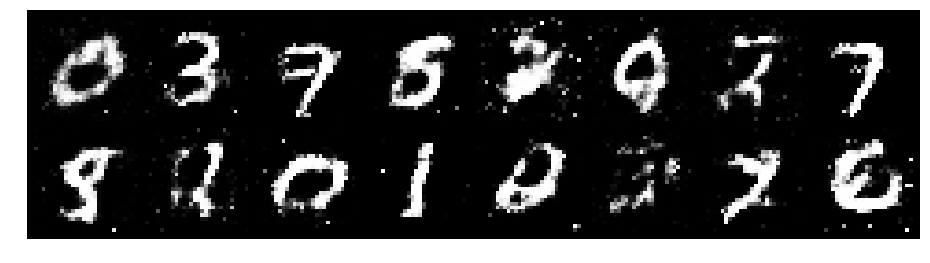

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1983, Generator Loss: 1.1927
D(x): 0.6409, D(G(z)): 0.4352


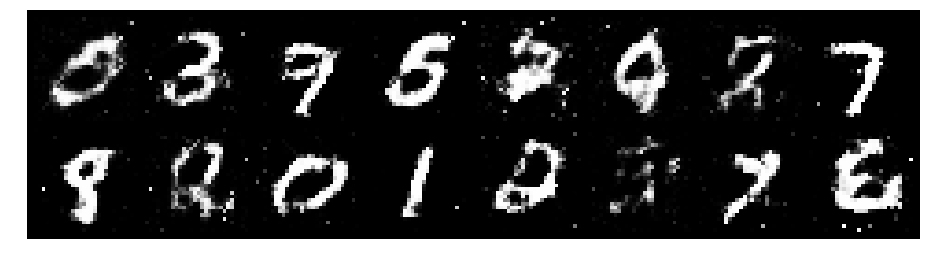

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1569, Generator Loss: 1.1919
D(x): 0.6215, D(G(z)): 0.4039


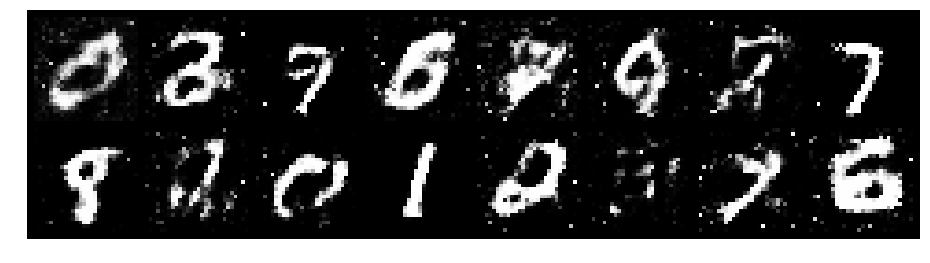

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1390, Generator Loss: 1.1960
D(x): 0.6256, D(G(z)): 0.3945


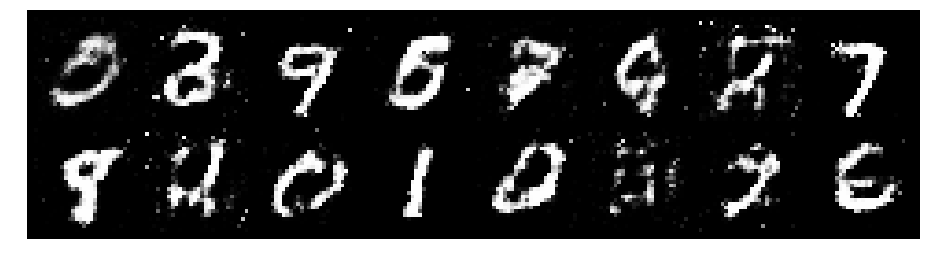

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0009, Generator Loss: 1.3519
D(x): 0.6279, D(G(z)): 0.3086


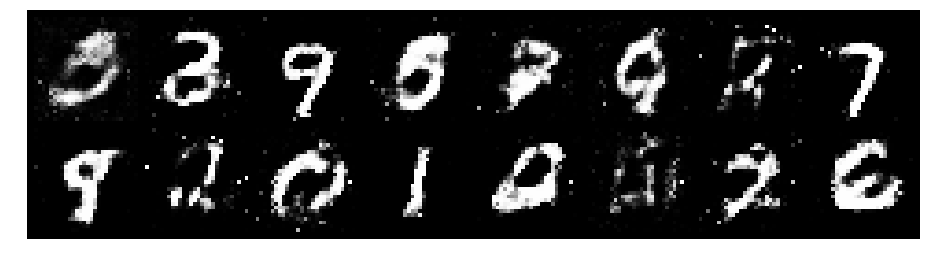

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1581, Generator Loss: 1.2294
D(x): 0.6100, D(G(z)): 0.3715


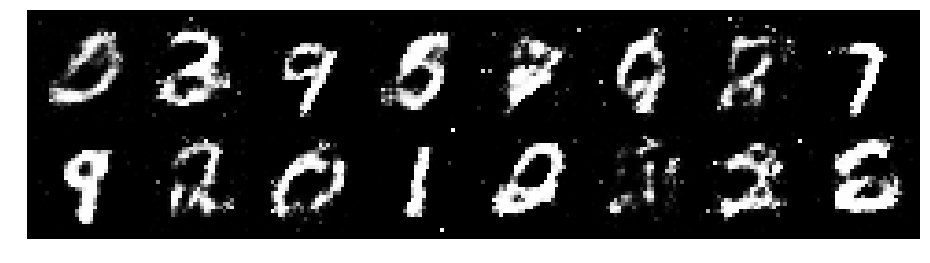

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.3602, Generator Loss: 0.8786
D(x): 0.6279, D(G(z)): 0.4960


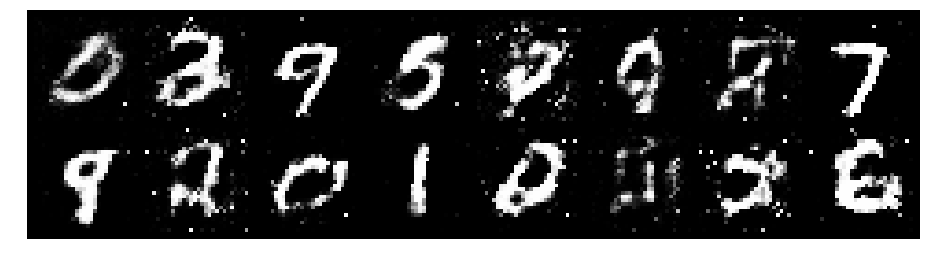

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1082, Generator Loss: 1.1087
D(x): 0.6447, D(G(z)): 0.3924


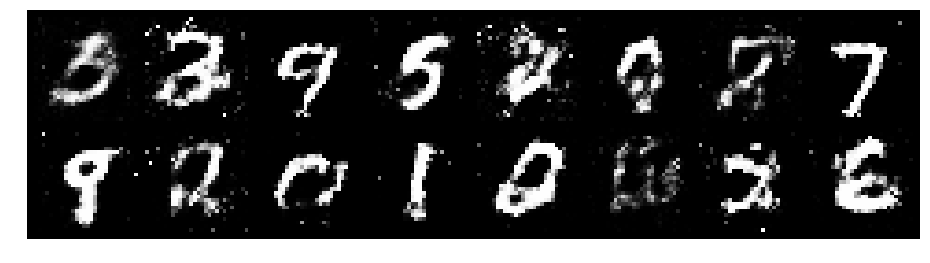

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1222, Generator Loss: 1.1985
D(x): 0.6044, D(G(z)): 0.3757


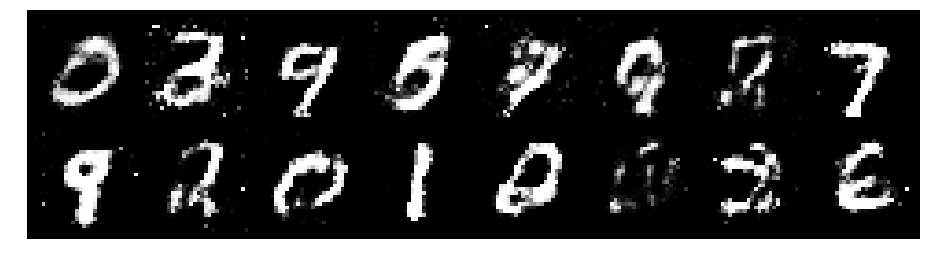

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2003, Generator Loss: 1.1243
D(x): 0.5882, D(G(z)): 0.3639


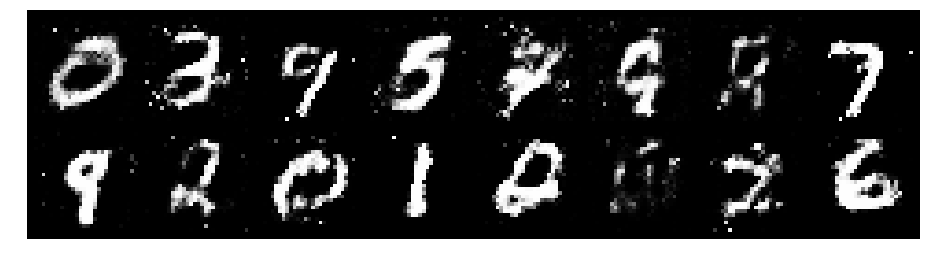

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.0502, Generator Loss: 1.2899
D(x): 0.6037, D(G(z)): 0.3521


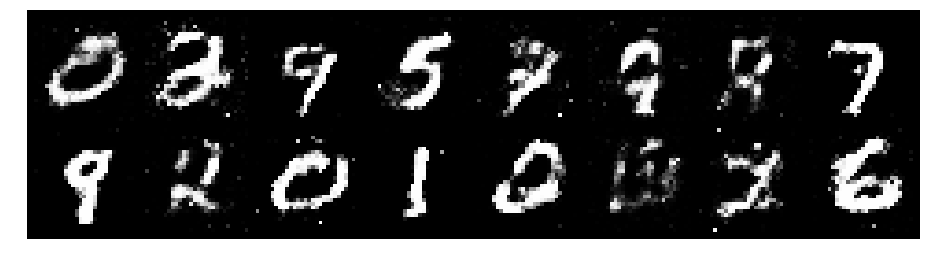

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0535, Generator Loss: 1.3008
D(x): 0.6431, D(G(z)): 0.3626


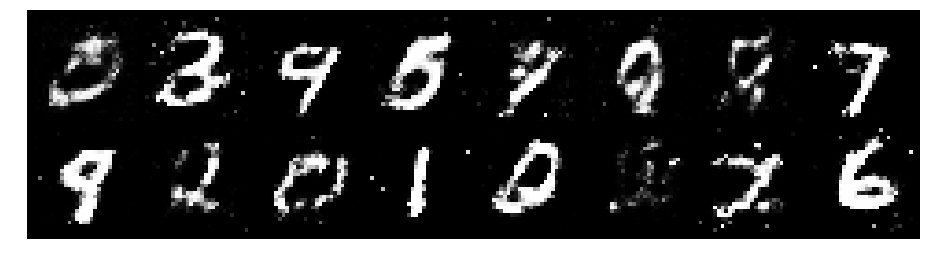

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1285, Generator Loss: 1.1476
D(x): 0.5740, D(G(z)): 0.3458


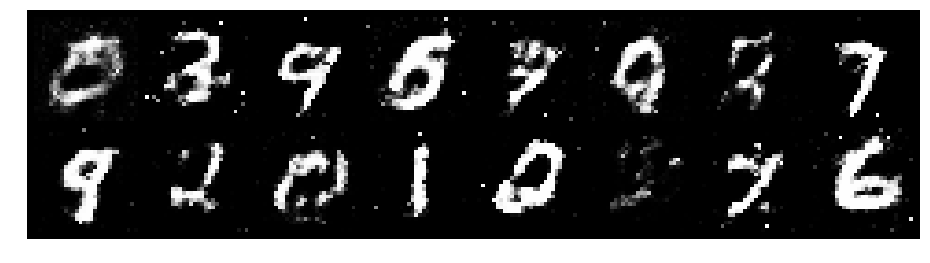

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0924, Generator Loss: 0.9448
D(x): 0.6425, D(G(z)): 0.4008


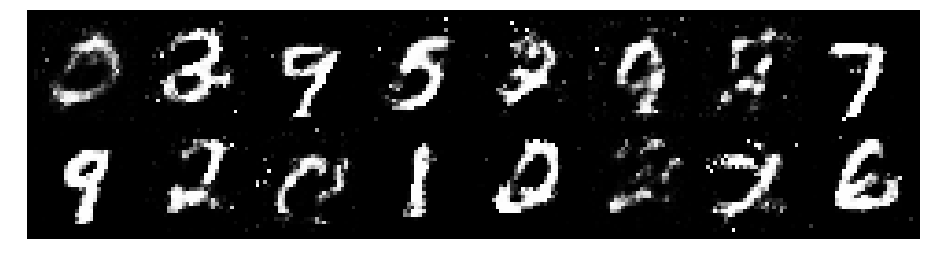

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.0883, Generator Loss: 1.0189
D(x): 0.6072, D(G(z)): 0.3934


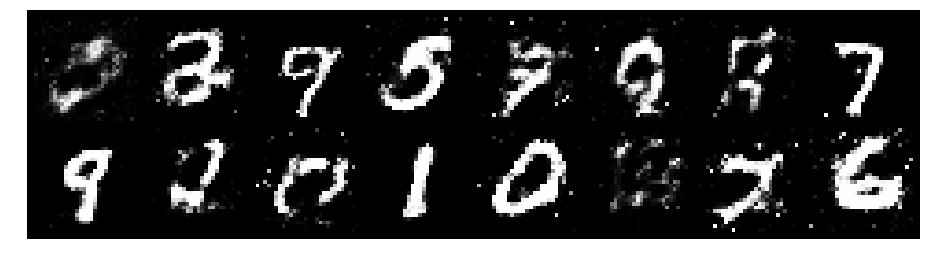

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.2920, Generator Loss: 0.9161
D(x): 0.5535, D(G(z)): 0.4441


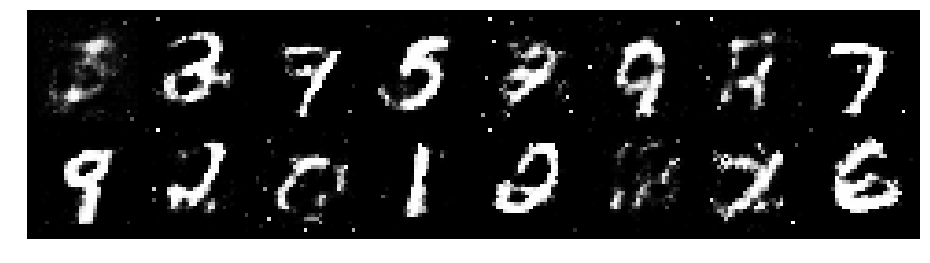

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.2267, Generator Loss: 0.9867
D(x): 0.6029, D(G(z)): 0.4245


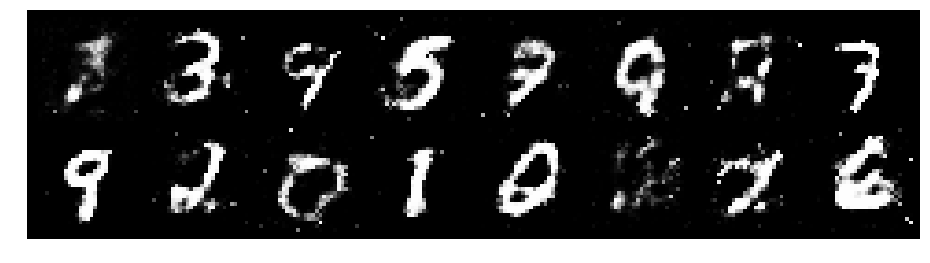

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2042, Generator Loss: 1.0535
D(x): 0.6354, D(G(z)): 0.4529


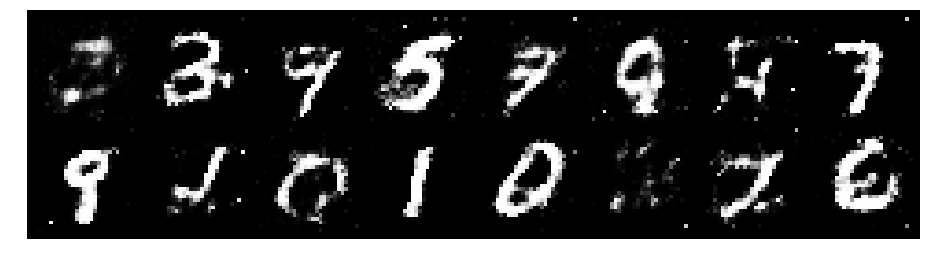

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.2606, Generator Loss: 0.8643
D(x): 0.6170, D(G(z)): 0.4890


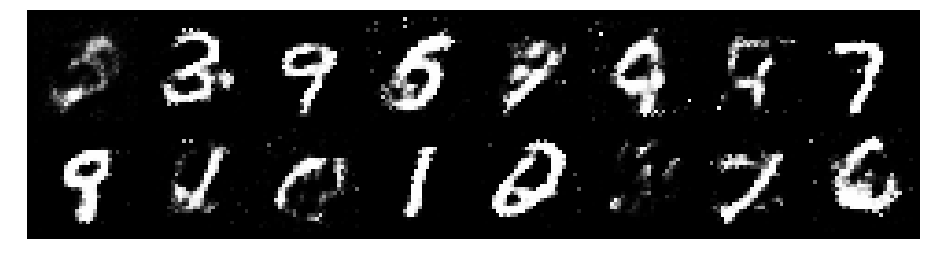

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0947, Generator Loss: 1.0078
D(x): 0.6289, D(G(z)): 0.4083


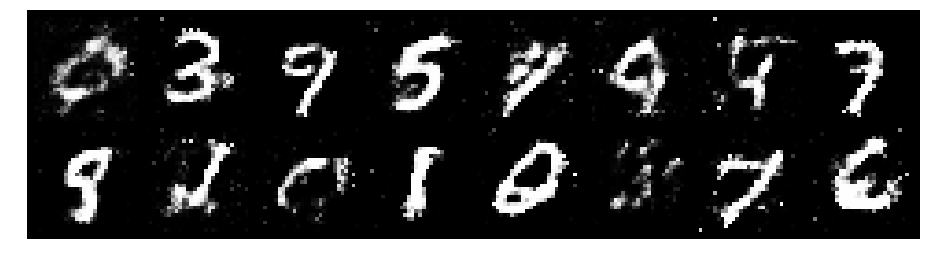

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0631, Generator Loss: 0.8876
D(x): 0.6306, D(G(z)): 0.4025


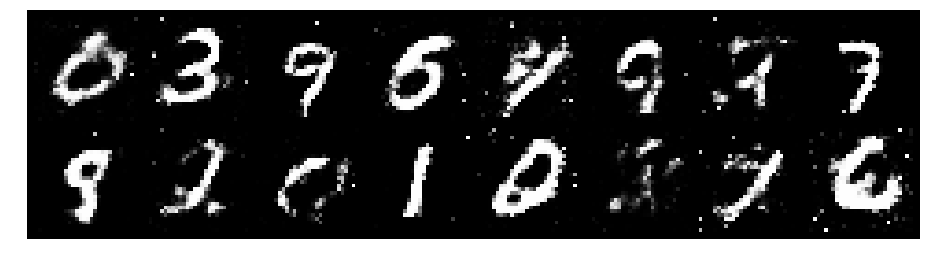

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1691, Generator Loss: 0.8897
D(x): 0.5671, D(G(z)): 0.4109


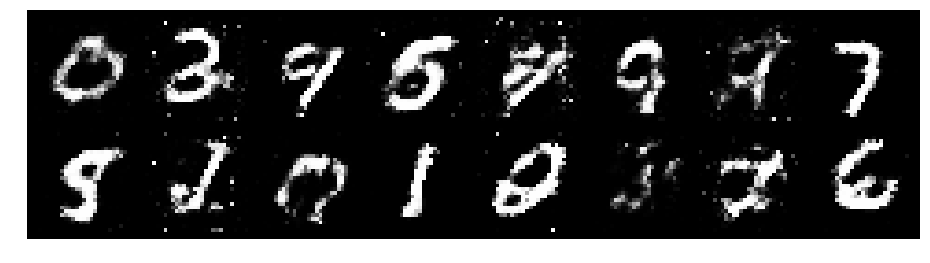

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0320, Generator Loss: 1.0863
D(x): 0.6183, D(G(z)): 0.3695


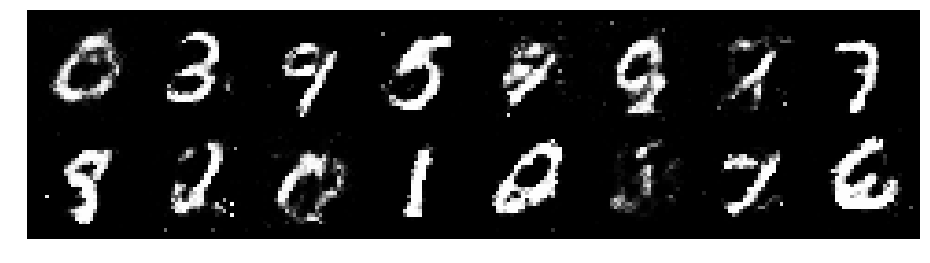

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 0.9412, Generator Loss: 1.0638
D(x): 0.6555, D(G(z)): 0.3602


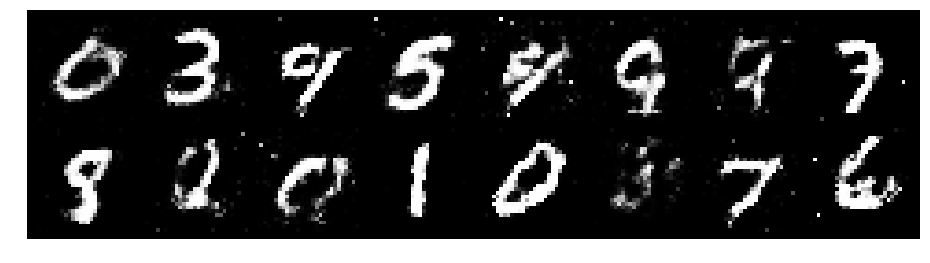

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1013, Generator Loss: 1.2329
D(x): 0.5852, D(G(z)): 0.3790


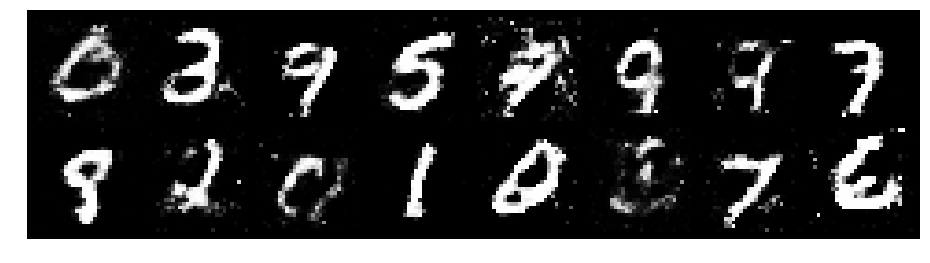

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9778
D(x): 0.5998, D(G(z)): 0.4189


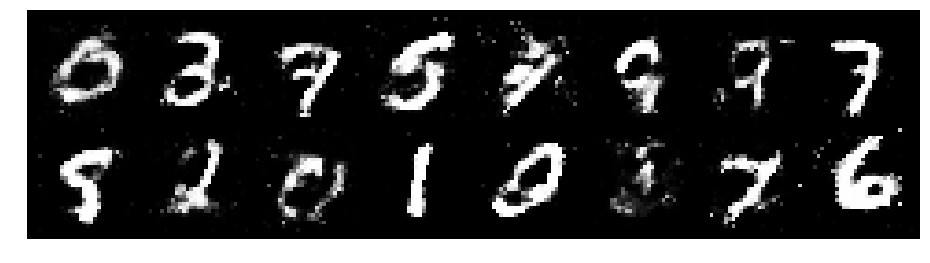

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0368, Generator Loss: 1.2001
D(x): 0.6629, D(G(z)): 0.3805


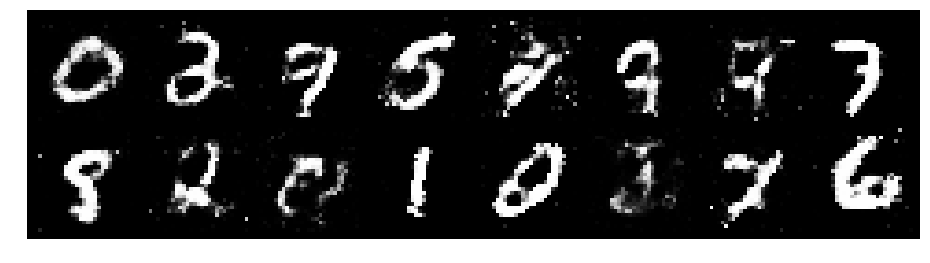

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1324, Generator Loss: 1.1192
D(x): 0.5880, D(G(z)): 0.3591


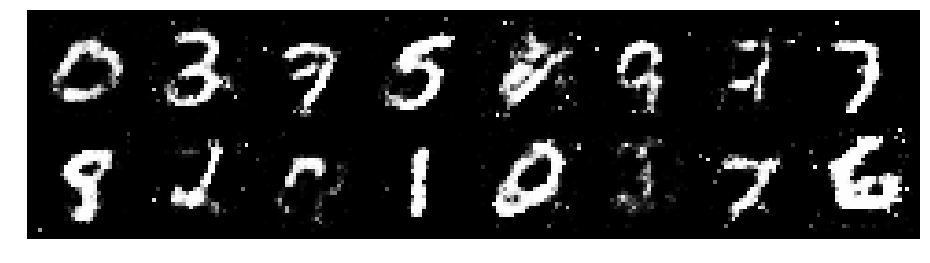

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 0.9567, Generator Loss: 1.1358
D(x): 0.6636, D(G(z)): 0.3482


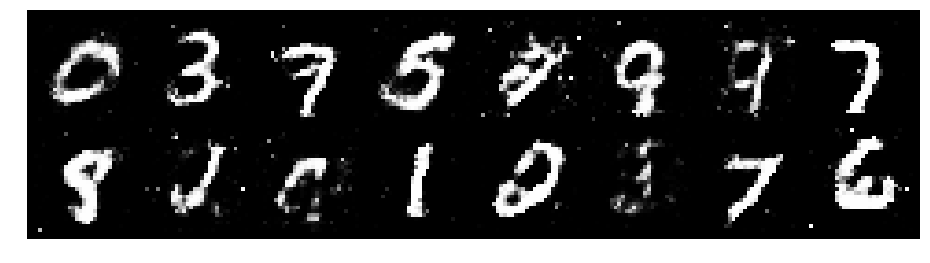

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1618, Generator Loss: 1.0924
D(x): 0.6361, D(G(z)): 0.4258


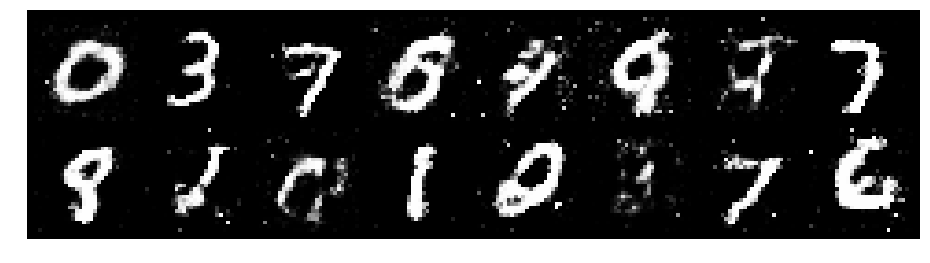

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0585, Generator Loss: 1.3175
D(x): 0.6389, D(G(z)): 0.3771


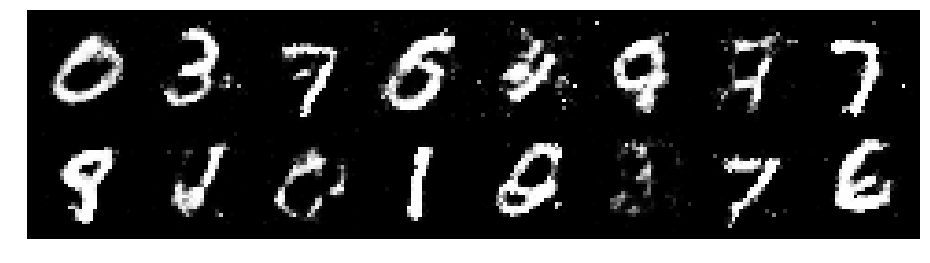

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1787, Generator Loss: 1.3314
D(x): 0.6288, D(G(z)): 0.3968


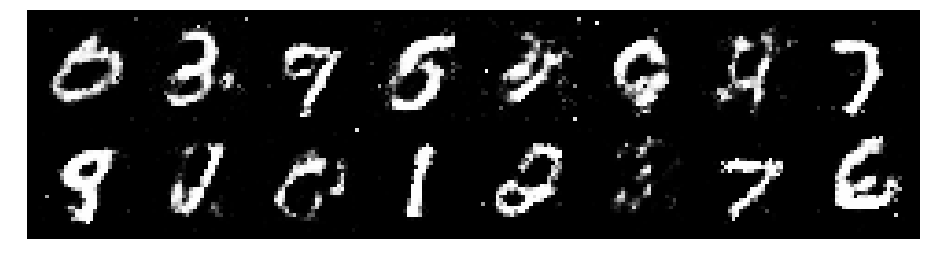

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0168
D(x): 0.6045, D(G(z)): 0.4180


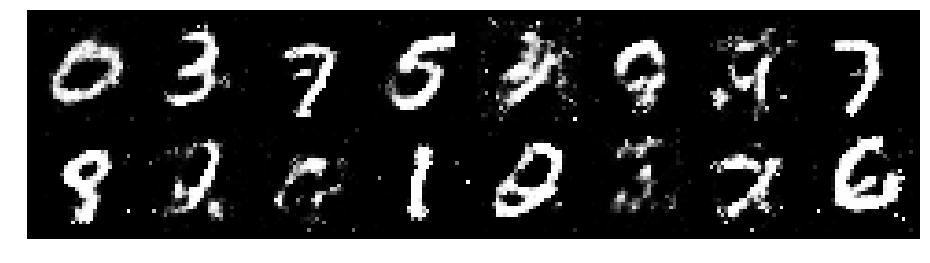

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0816, Generator Loss: 1.2465
D(x): 0.6606, D(G(z)): 0.4009


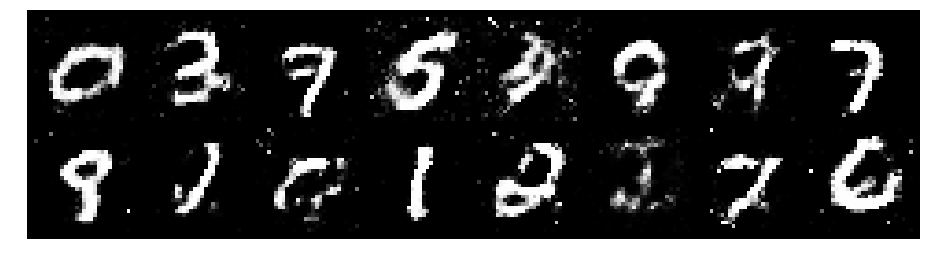

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1121, Generator Loss: 1.1881
D(x): 0.6157, D(G(z)): 0.3912


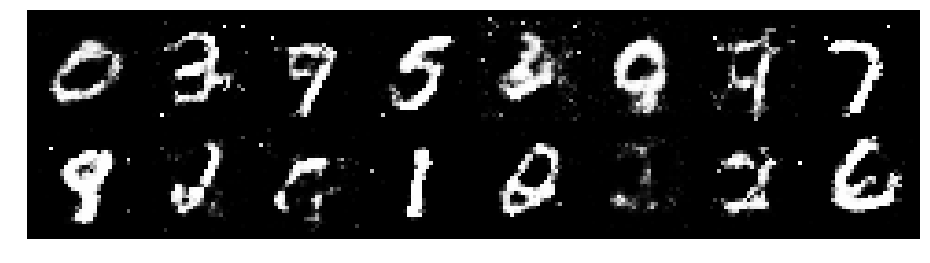

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1988, Generator Loss: 1.0620
D(x): 0.5967, D(G(z)): 0.4188


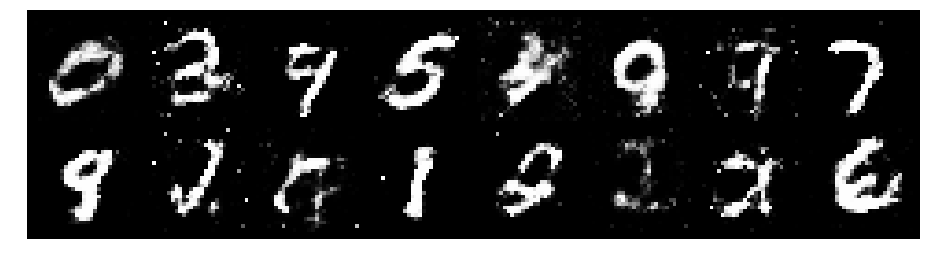

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.0434, Generator Loss: 1.1124
D(x): 0.6024, D(G(z)): 0.3545


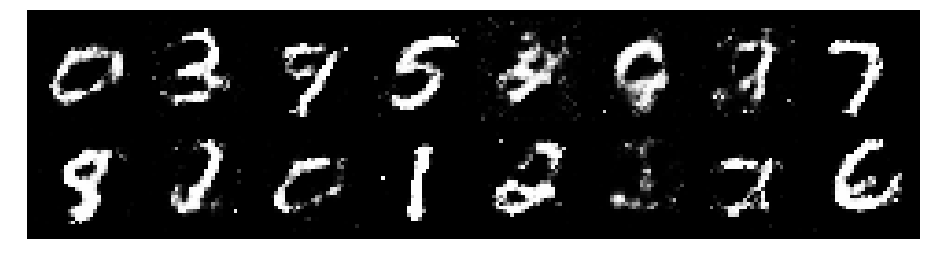

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1730, Generator Loss: 0.9039
D(x): 0.6167, D(G(z)): 0.4390


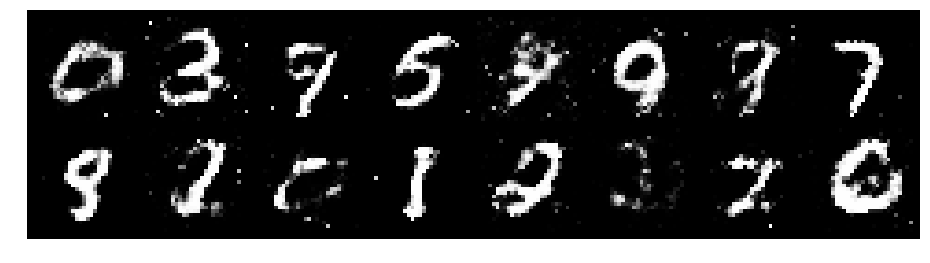

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1967, Generator Loss: 0.9859
D(x): 0.6073, D(G(z)): 0.4430


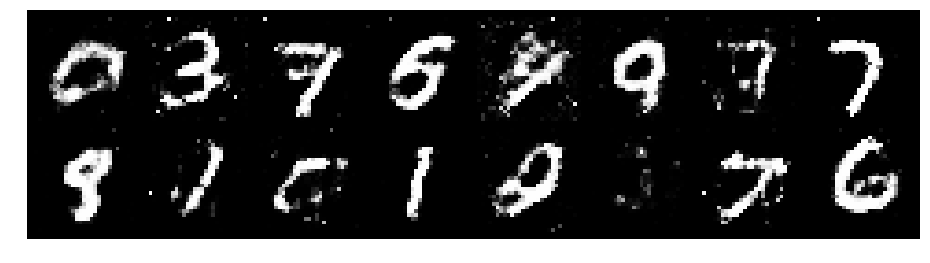

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1039, Generator Loss: 0.9565
D(x): 0.6253, D(G(z)): 0.3877


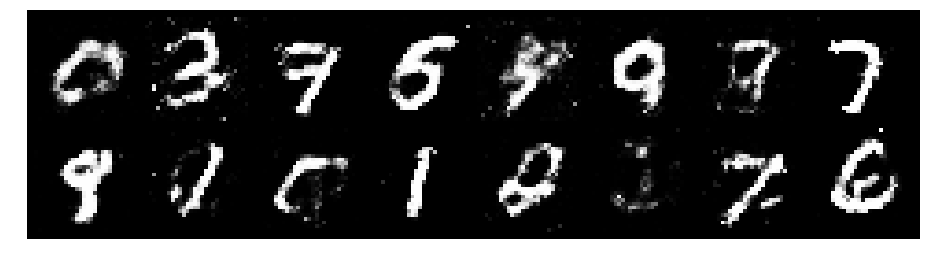

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1455, Generator Loss: 1.1774
D(x): 0.5860, D(G(z)): 0.3834


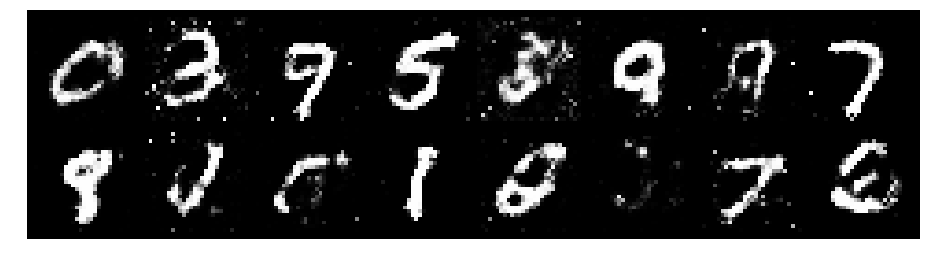

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.0918, Generator Loss: 1.2952
D(x): 0.6018, D(G(z)): 0.3455


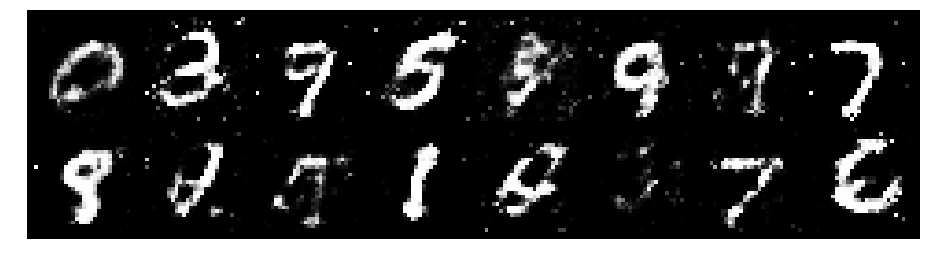

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.0881, Generator Loss: 1.0308
D(x): 0.6171, D(G(z)): 0.3871


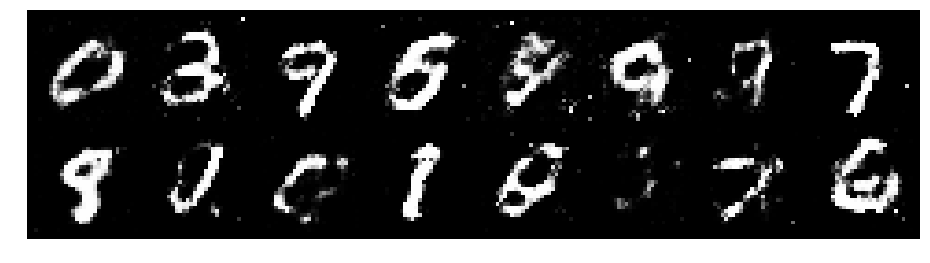

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.0495, Generator Loss: 1.0077
D(x): 0.6157, D(G(z)): 0.3766


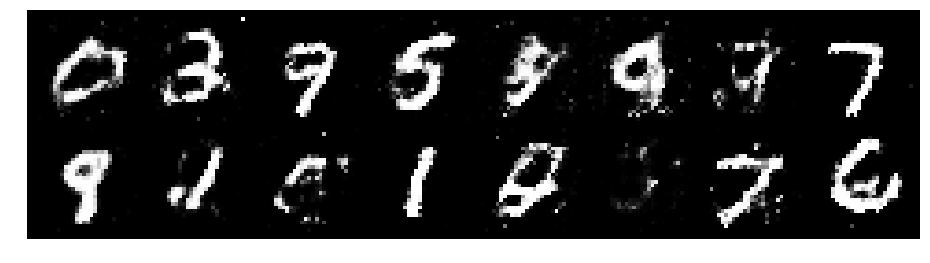

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.0660, Generator Loss: 1.2272
D(x): 0.6227, D(G(z)): 0.3824


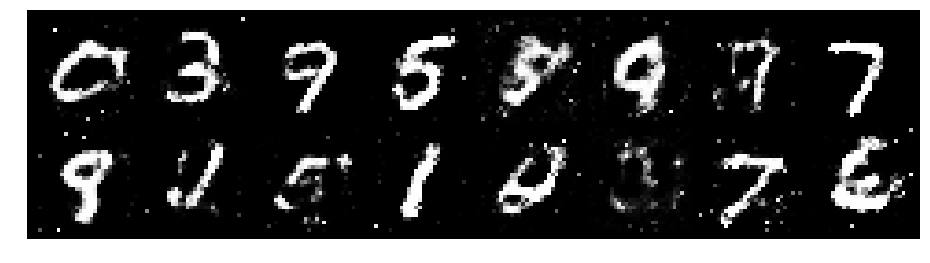

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.0993, Generator Loss: 1.0165
D(x): 0.5785, D(G(z)): 0.3783


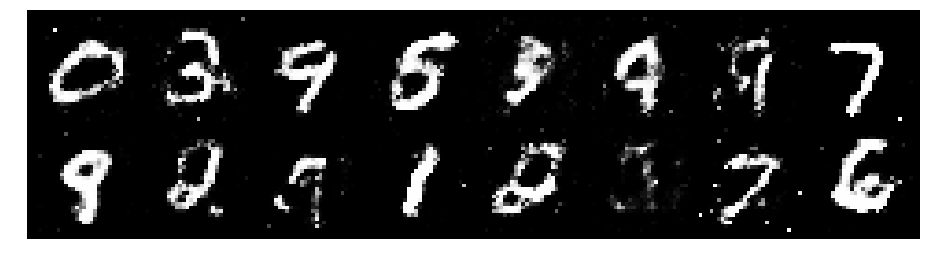

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.3691, Generator Loss: 0.8563
D(x): 0.5397, D(G(z)): 0.4755


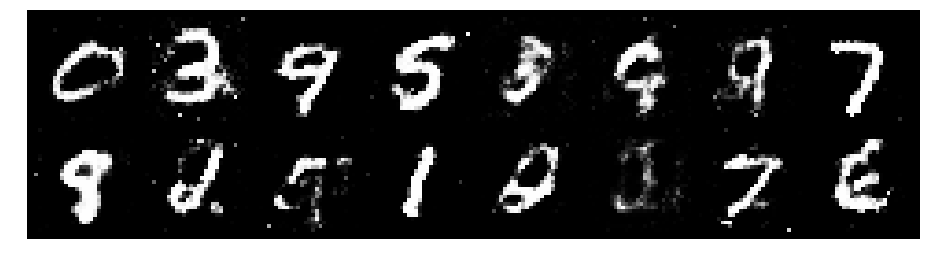

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2606, Generator Loss: 0.7625
D(x): 0.6276, D(G(z)): 0.4670


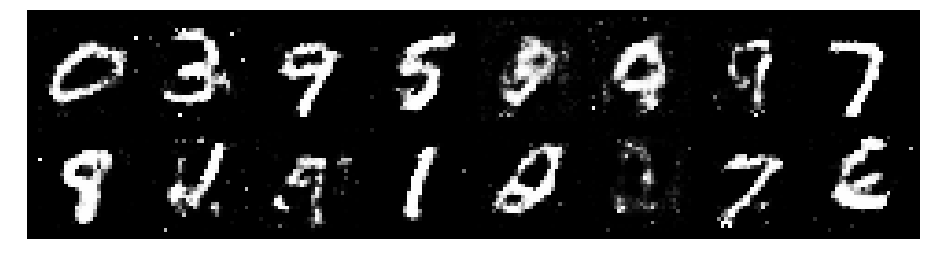

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2610, Generator Loss: 0.8287
D(x): 0.6005, D(G(z)): 0.4565


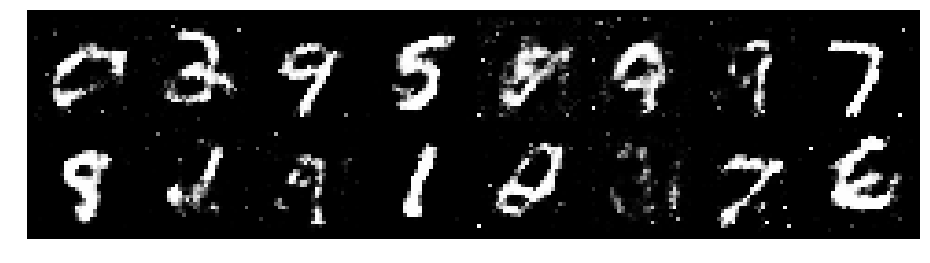

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1800, Generator Loss: 1.0466
D(x): 0.5872, D(G(z)): 0.4036


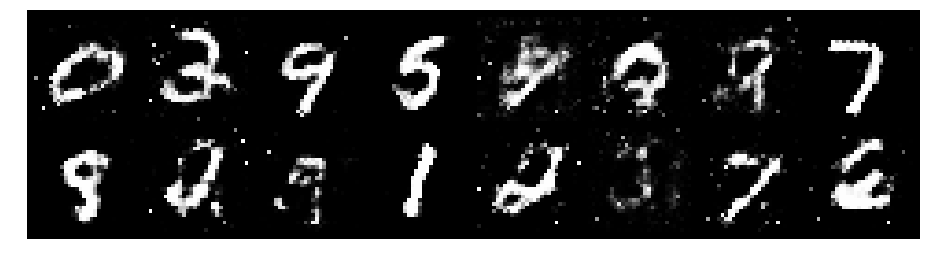

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.3078, Generator Loss: 1.0096
D(x): 0.5529, D(G(z)): 0.4381


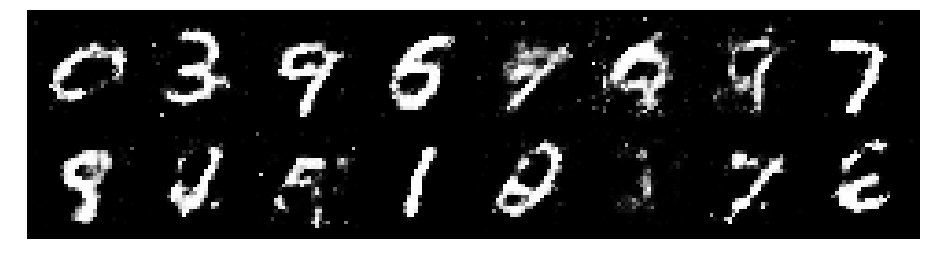

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1310, Generator Loss: 0.8611
D(x): 0.6064, D(G(z)): 0.4260


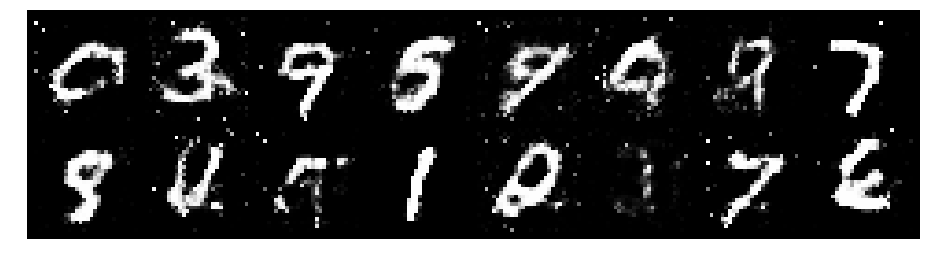

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0121, Generator Loss: 1.0528
D(x): 0.6219, D(G(z)): 0.3451


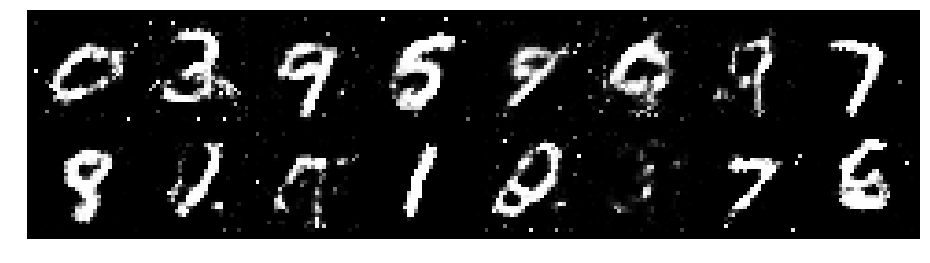

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.1002, Generator Loss: 1.1250
D(x): 0.6196, D(G(z)): 0.3859


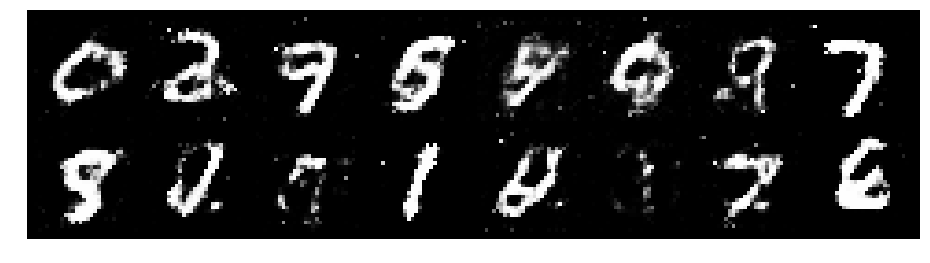

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1720, Generator Loss: 1.0858
D(x): 0.5963, D(G(z)): 0.4071


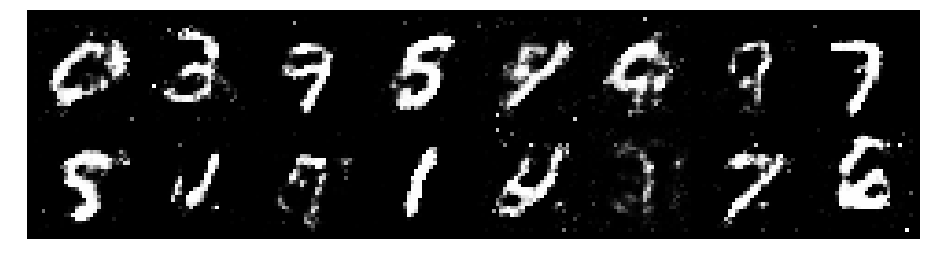

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 0.9563, Generator Loss: 1.2095
D(x): 0.6671, D(G(z)): 0.3631


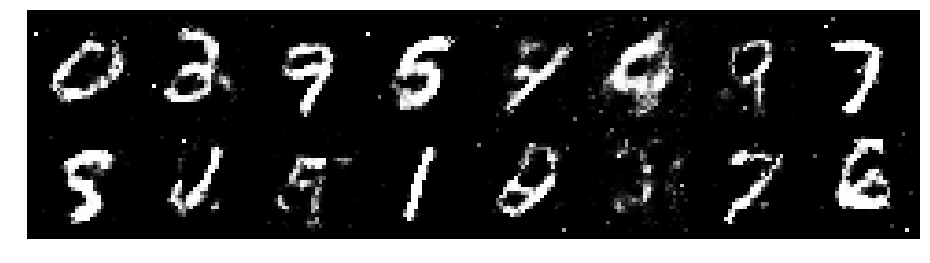

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0531, Generator Loss: 1.1289
D(x): 0.6552, D(G(z)): 0.3958


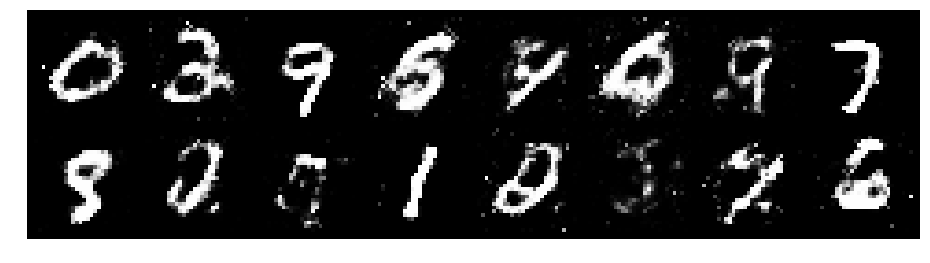

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0473, Generator Loss: 1.3153
D(x): 0.6578, D(G(z)): 0.3669


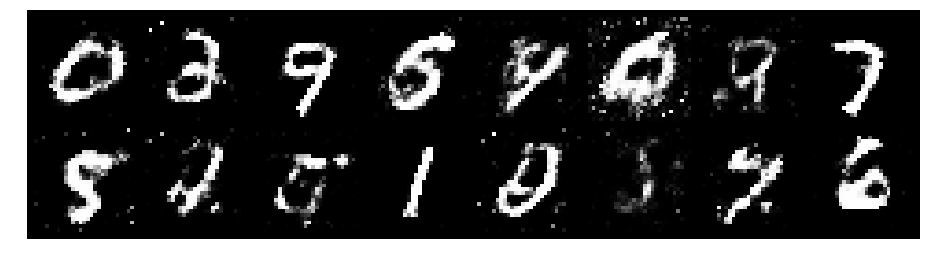

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1271, Generator Loss: 1.1825
D(x): 0.5849, D(G(z)): 0.3865


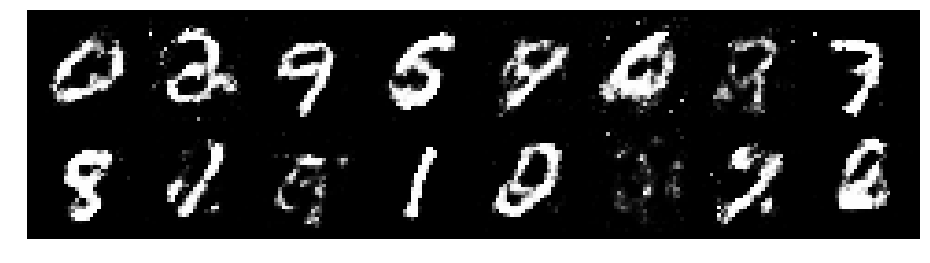

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1983, Generator Loss: 1.0221
D(x): 0.5709, D(G(z)): 0.3908


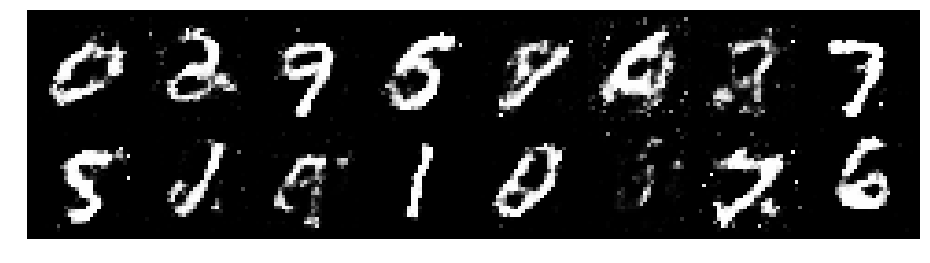

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1918, Generator Loss: 1.1062
D(x): 0.5958, D(G(z)): 0.4076


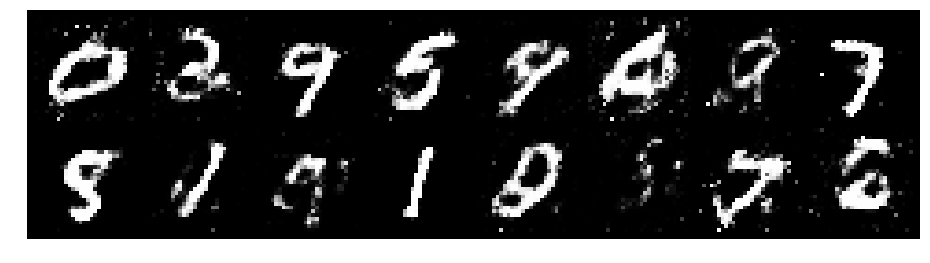

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 0.9871, Generator Loss: 1.2303
D(x): 0.5900, D(G(z)): 0.2950


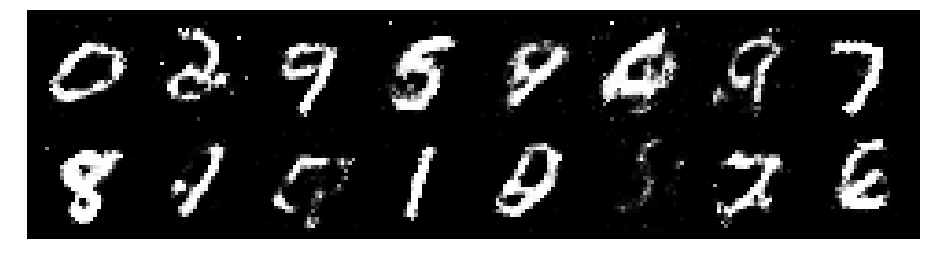

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 0.9776, Generator Loss: 1.2659
D(x): 0.6523, D(G(z)): 0.3352


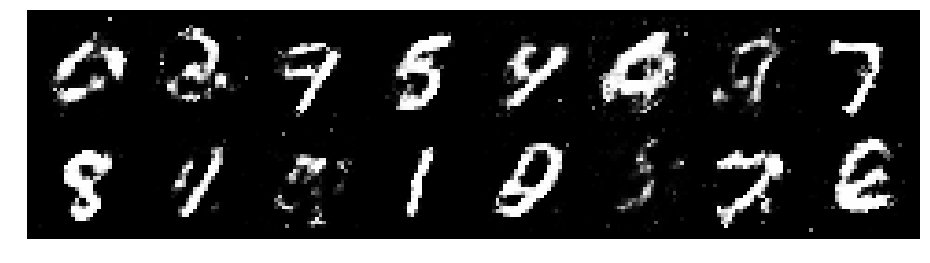

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.0571, Generator Loss: 1.4506
D(x): 0.5893, D(G(z)): 0.3411


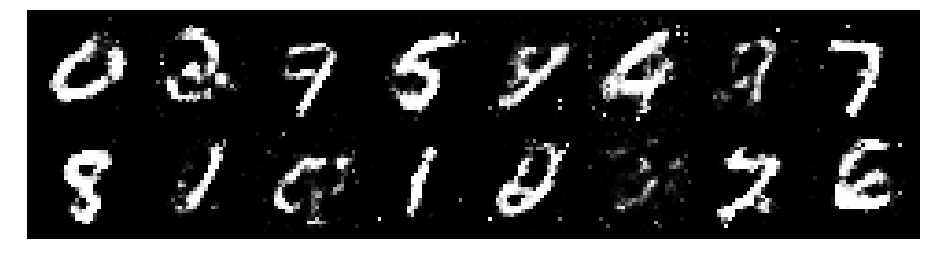

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1717, Generator Loss: 1.1472
D(x): 0.6016, D(G(z)): 0.4031


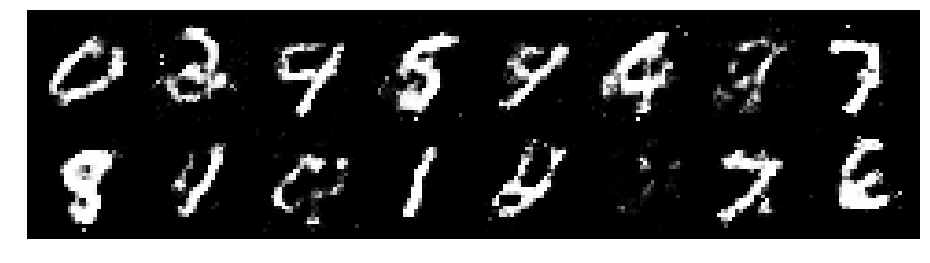

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1500, Generator Loss: 1.0119
D(x): 0.5910, D(G(z)): 0.4131


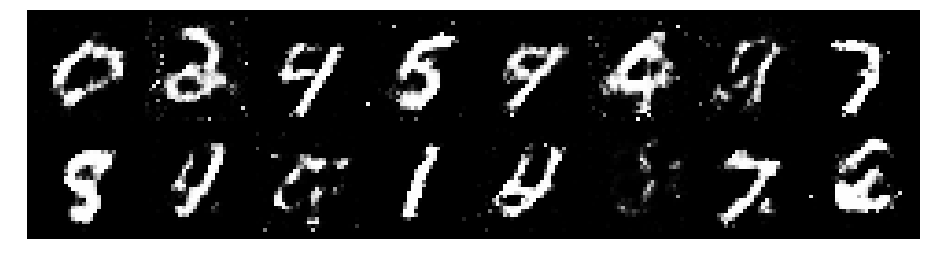

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2445, Generator Loss: 0.9658
D(x): 0.5322, D(G(z)): 0.4071


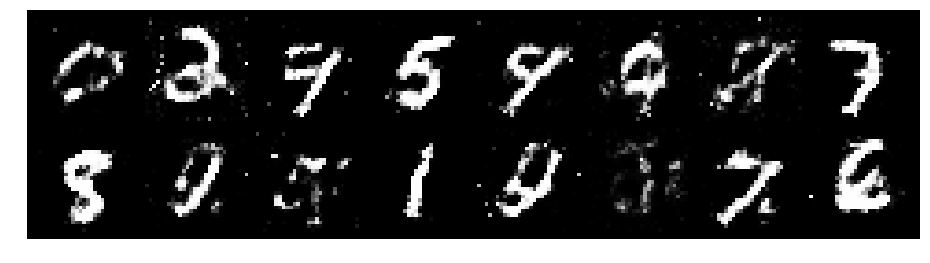

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.1932, Generator Loss: 0.9466
D(x): 0.6128, D(G(z)): 0.4145


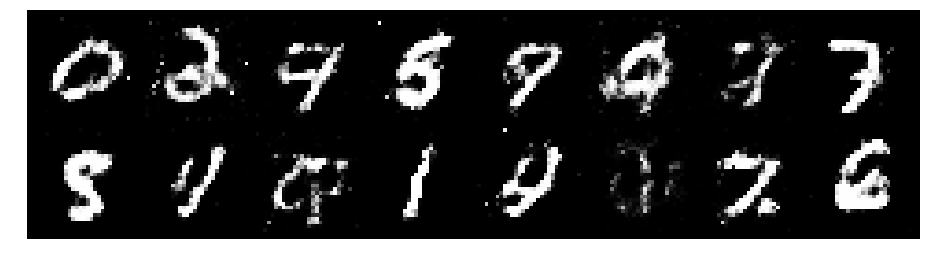

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2025, Generator Loss: 0.8510
D(x): 0.5742, D(G(z)): 0.4390


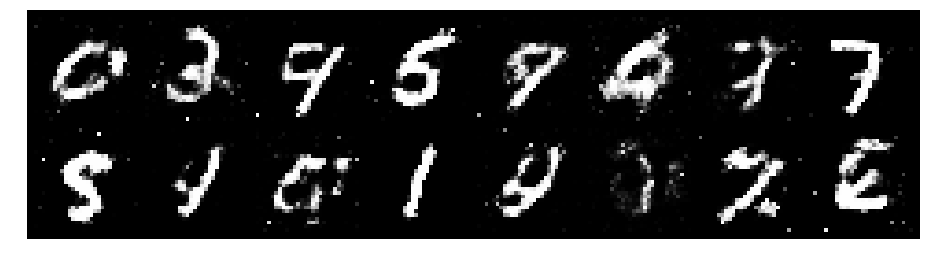

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8779
D(x): 0.5803, D(G(z)): 0.4332


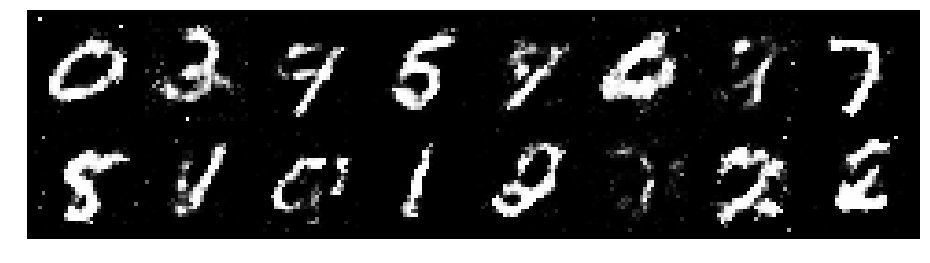

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.3405, Generator Loss: 0.8672
D(x): 0.5676, D(G(z)): 0.4648


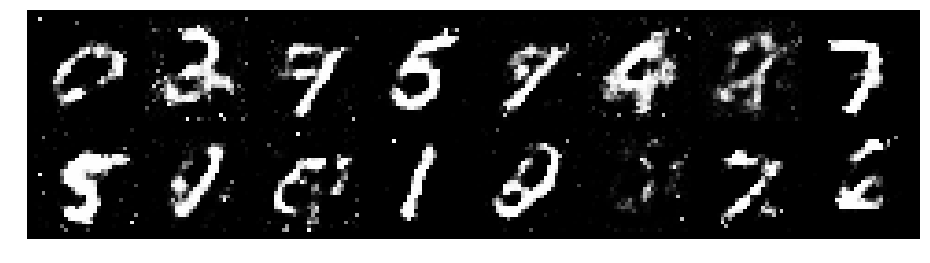

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.3056, Generator Loss: 0.9032
D(x): 0.5494, D(G(z)): 0.4133


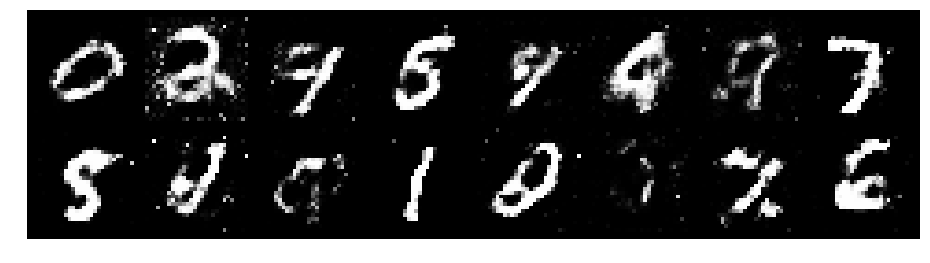

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1451, Generator Loss: 1.1183
D(x): 0.6209, D(G(z)): 0.3934


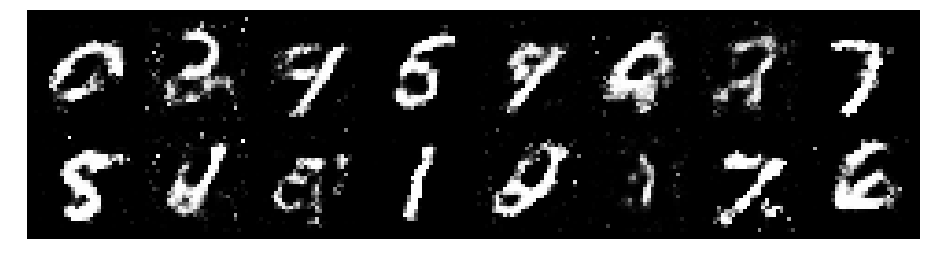

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9393
D(x): 0.5601, D(G(z)): 0.3961


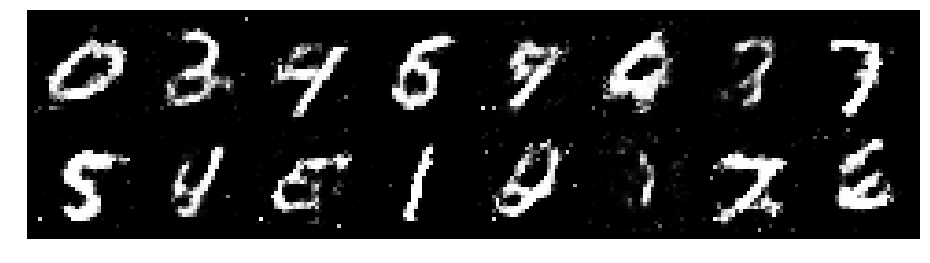

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2339, Generator Loss: 1.2547
D(x): 0.5124, D(G(z)): 0.3388


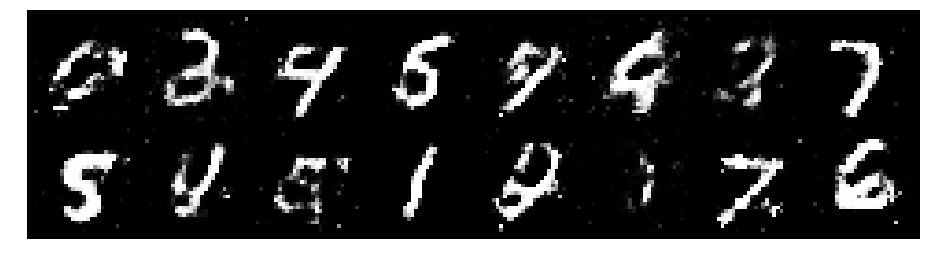

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2026, Generator Loss: 1.1636
D(x): 0.5790, D(G(z)): 0.3729


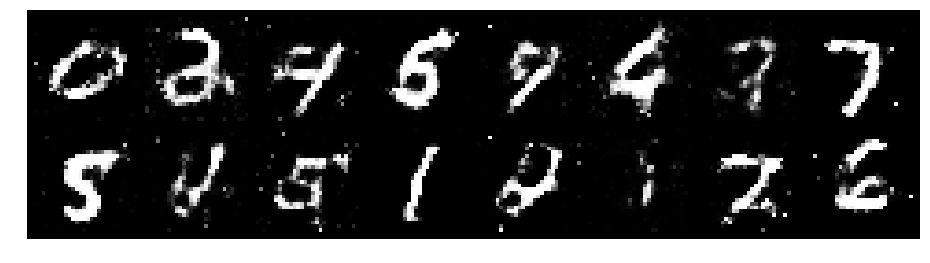

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1758, Generator Loss: 1.0900
D(x): 0.6507, D(G(z)): 0.4151


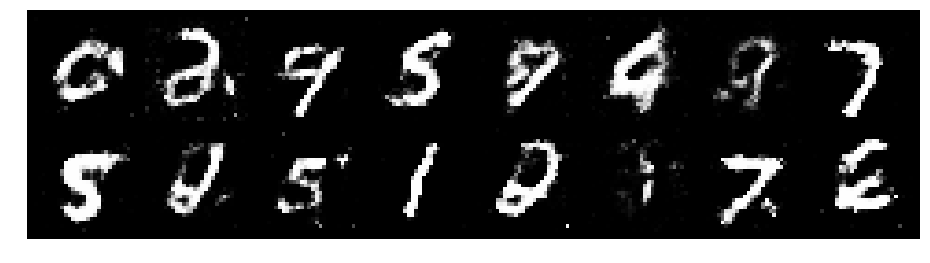

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.0858, Generator Loss: 0.9016
D(x): 0.6017, D(G(z)): 0.3683


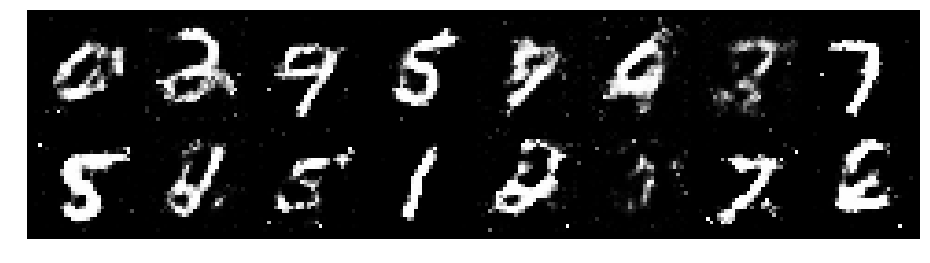

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.0068, Generator Loss: 1.0496
D(x): 0.6419, D(G(z)): 0.3711


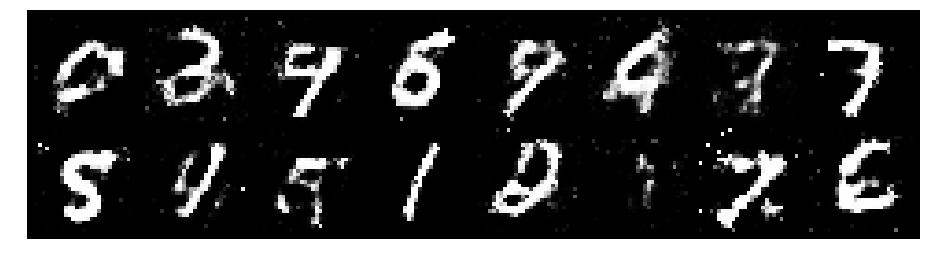

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1771, Generator Loss: 1.0507
D(x): 0.5994, D(G(z)): 0.4303


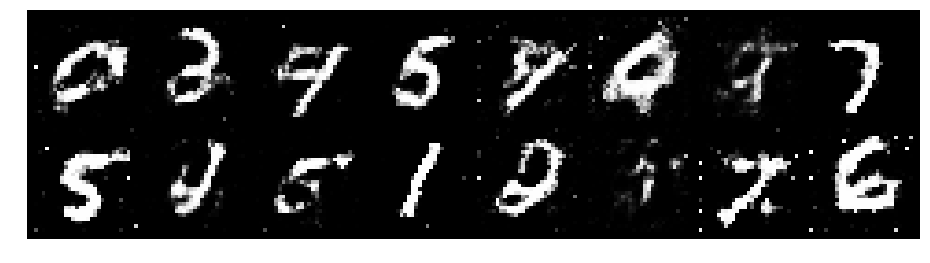

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.0229, Generator Loss: 0.9896
D(x): 0.6707, D(G(z)): 0.4056


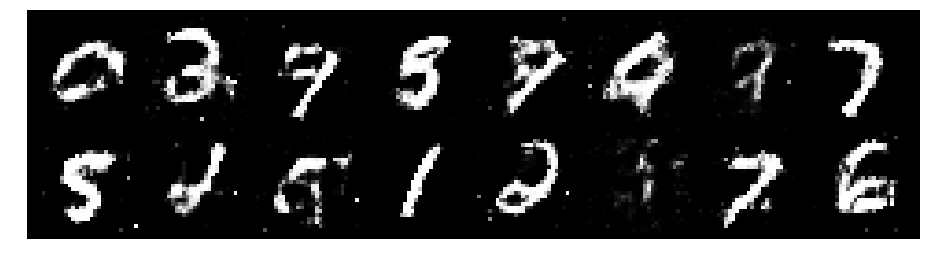

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2108, Generator Loss: 0.9570
D(x): 0.5582, D(G(z)): 0.4052


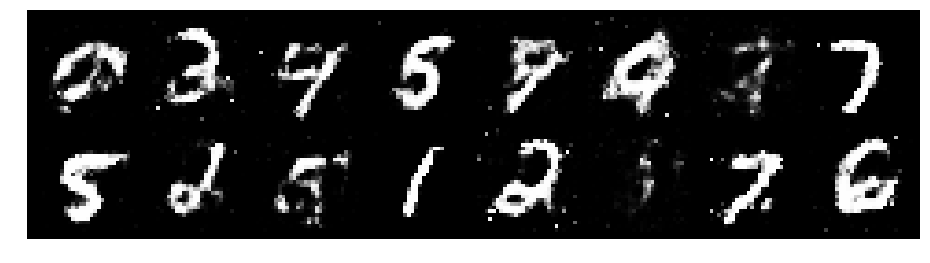

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2758, Generator Loss: 0.9755
D(x): 0.5629, D(G(z)): 0.4416


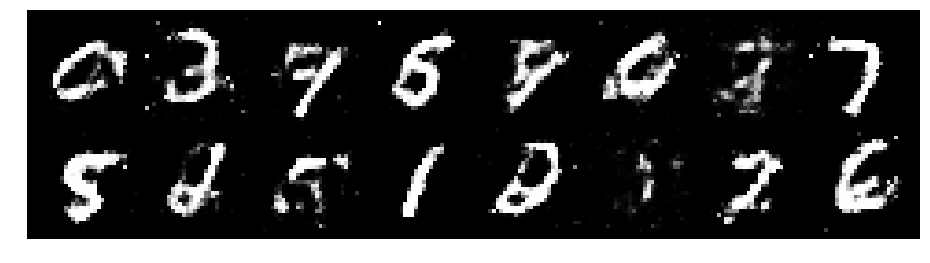

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2714, Generator Loss: 0.9401
D(x): 0.5401, D(G(z)): 0.4249


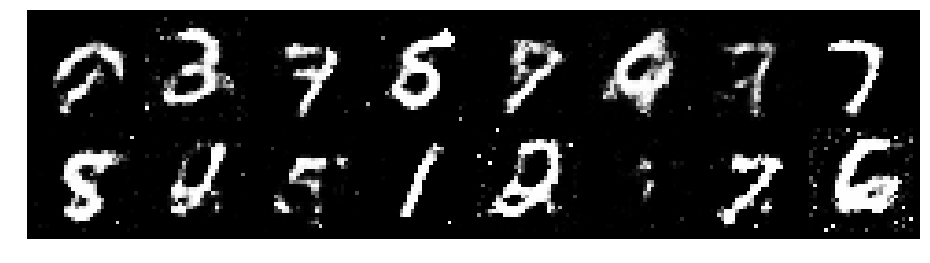

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.3475, Generator Loss: 1.1623
D(x): 0.5404, D(G(z)): 0.4231


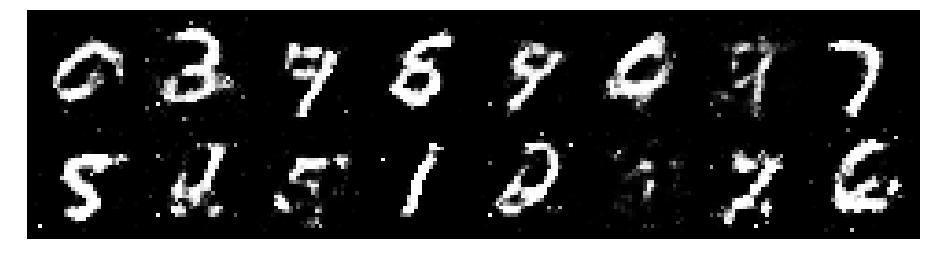

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1960, Generator Loss: 1.0502
D(x): 0.5777, D(G(z)): 0.4063


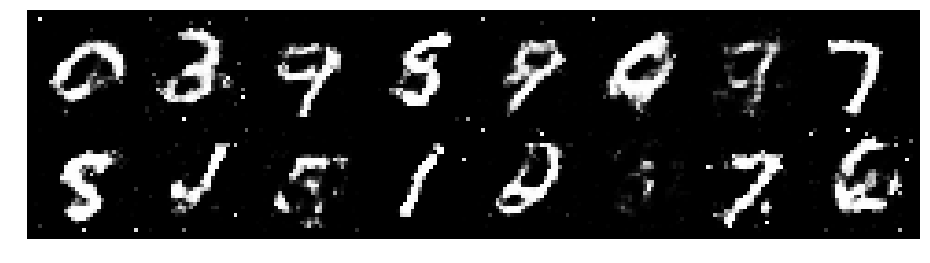

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1690, Generator Loss: 0.9376
D(x): 0.6187, D(G(z)): 0.4319


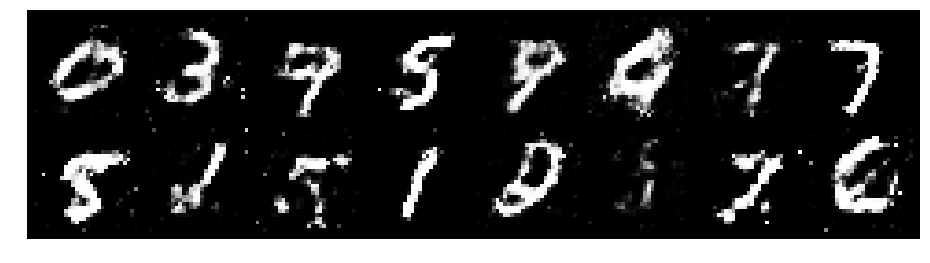

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2676, Generator Loss: 0.9303
D(x): 0.6172, D(G(z)): 0.4816


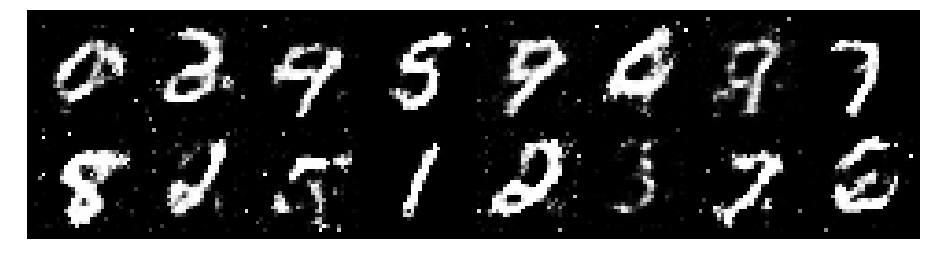

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2810, Generator Loss: 0.8683
D(x): 0.5906, D(G(z)): 0.4795


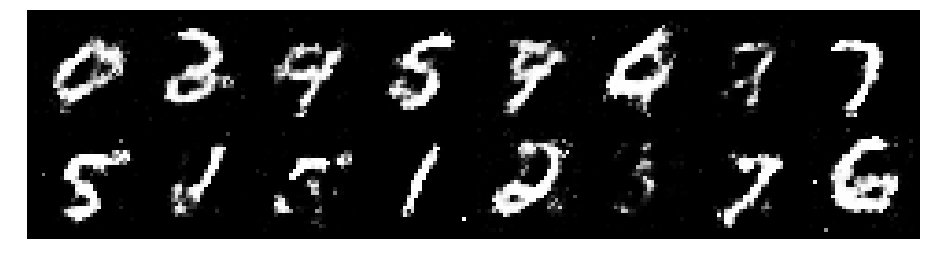

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1986, Generator Loss: 0.8689
D(x): 0.5429, D(G(z)): 0.3941


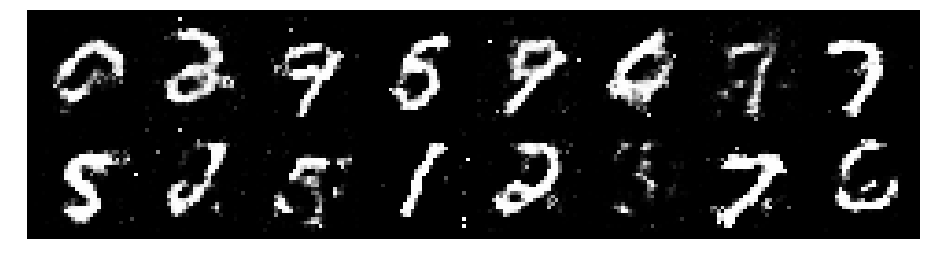

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1455, Generator Loss: 0.9870
D(x): 0.5638, D(G(z)): 0.3887


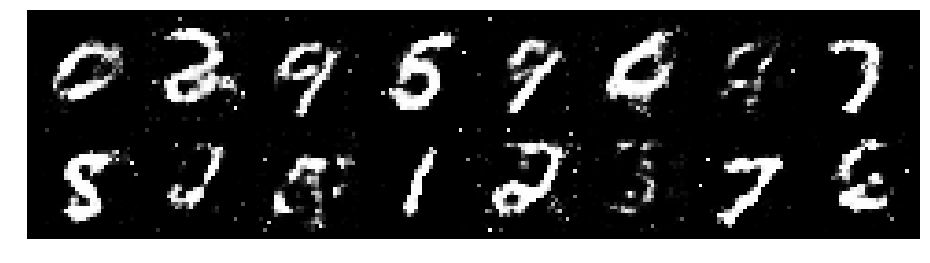

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.0572, Generator Loss: 1.0948
D(x): 0.5773, D(G(z)): 0.3292


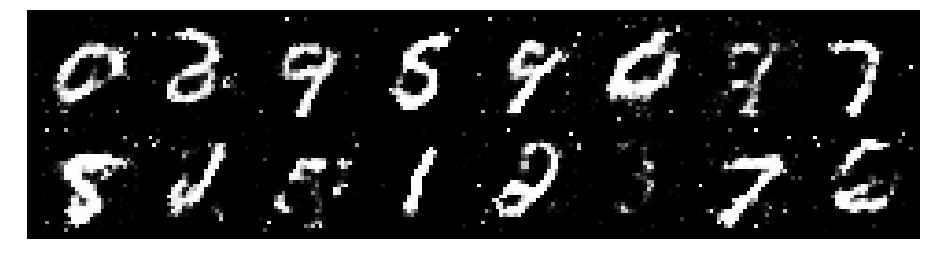

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2332, Generator Loss: 1.0962
D(x): 0.5377, D(G(z)): 0.3874


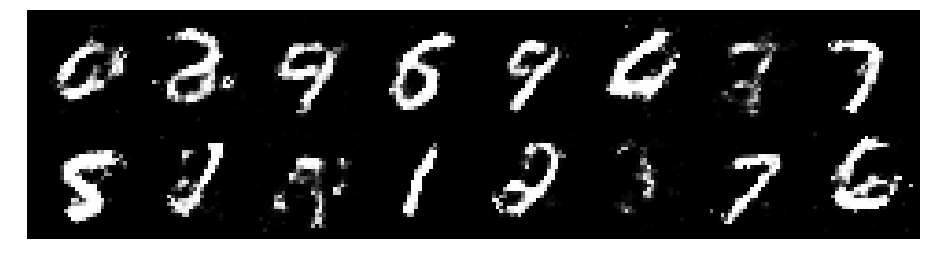

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1994, Generator Loss: 1.1181
D(x): 0.5906, D(G(z)): 0.3937


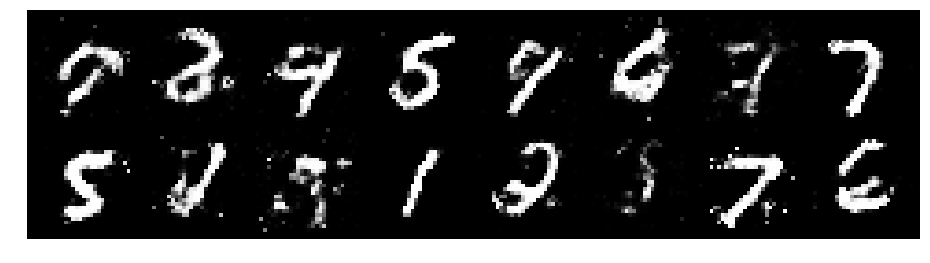

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1315, Generator Loss: 1.1425
D(x): 0.6223, D(G(z)): 0.4054


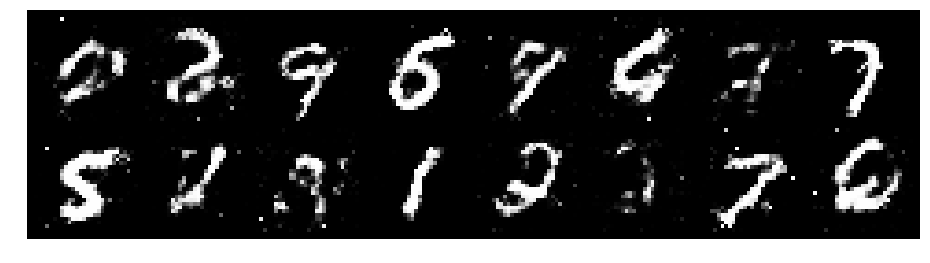

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.3763, Generator Loss: 1.0248
D(x): 0.6237, D(G(z)): 0.4905


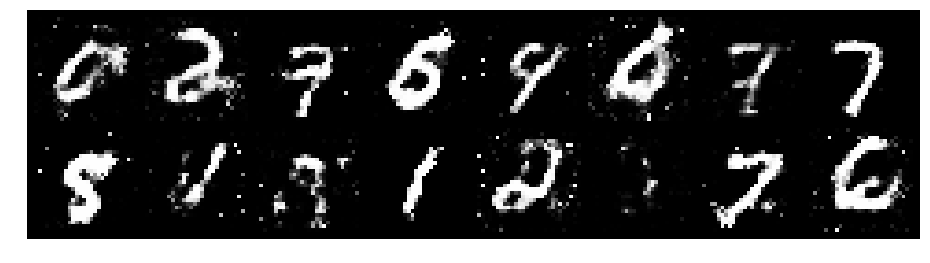

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.3073, Generator Loss: 0.9625
D(x): 0.5882, D(G(z)): 0.4716


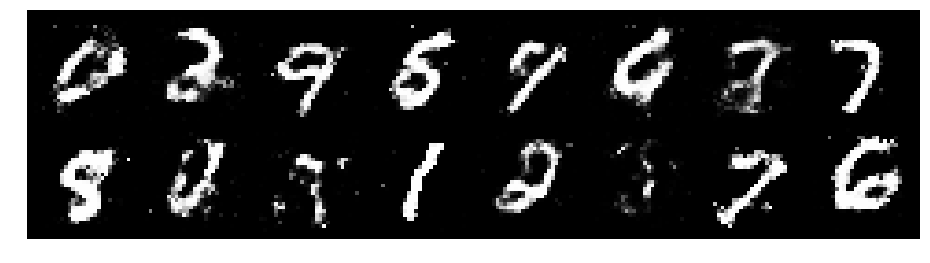

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2083, Generator Loss: 0.9482
D(x): 0.6225, D(G(z)): 0.4599


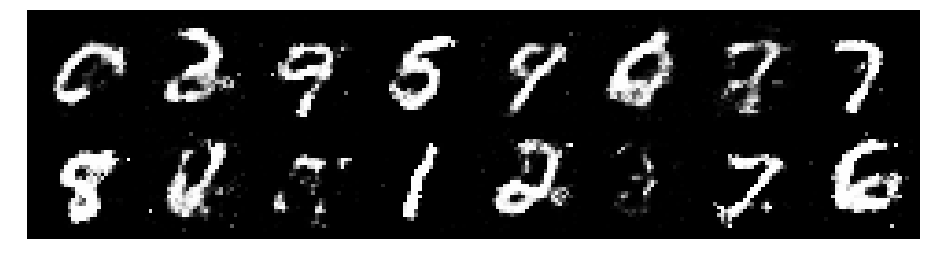

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2301, Generator Loss: 0.8089
D(x): 0.6094, D(G(z)): 0.4709


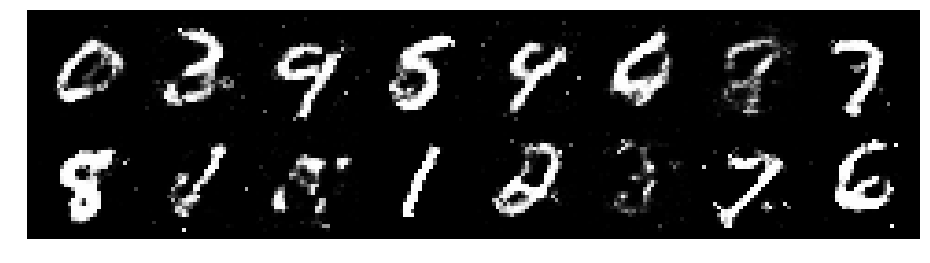

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1885, Generator Loss: 0.8556
D(x): 0.6106, D(G(z)): 0.4309


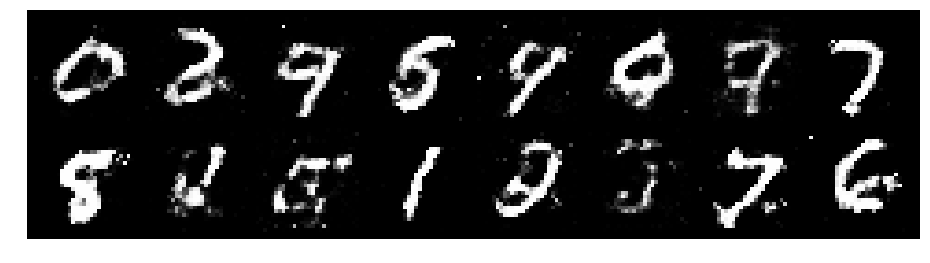

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.3211, Generator Loss: 0.9214
D(x): 0.5578, D(G(z)): 0.4515


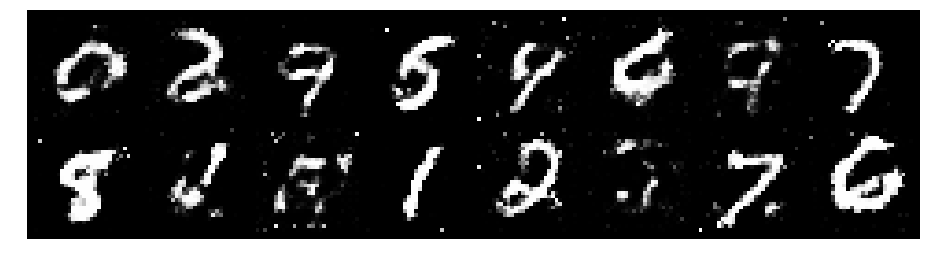

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.3108, Generator Loss: 1.0678
D(x): 0.5276, D(G(z)): 0.4233


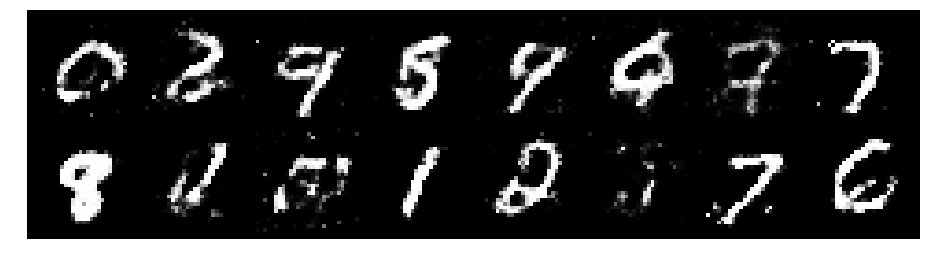

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1866, Generator Loss: 0.9696
D(x): 0.5841, D(G(z)): 0.4157


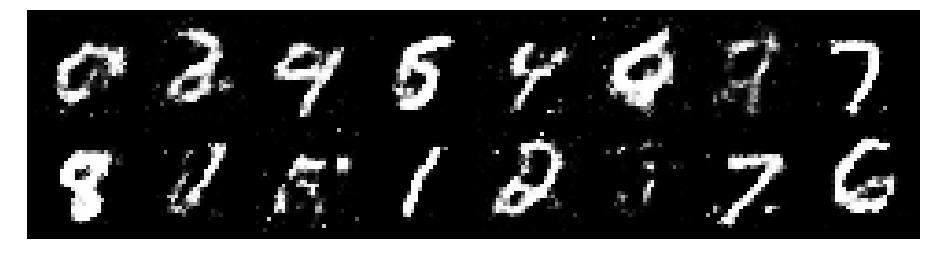

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2797, Generator Loss: 1.1465
D(x): 0.5749, D(G(z)): 0.4088


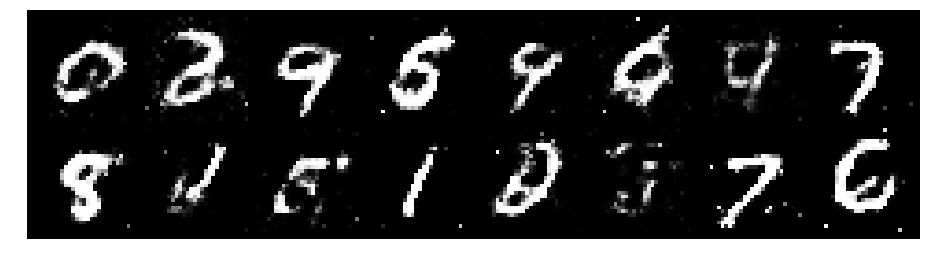

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1494, Generator Loss: 1.1954
D(x): 0.5972, D(G(z)): 0.3789


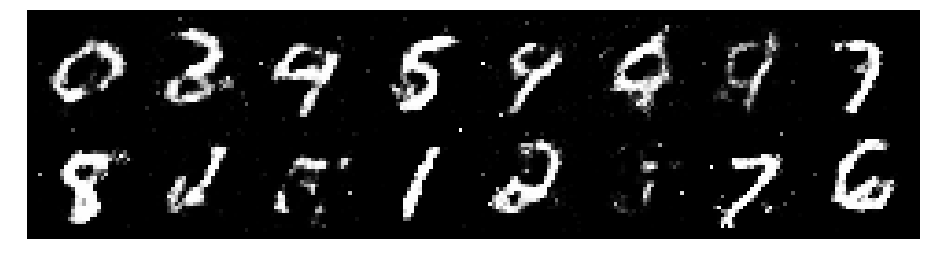

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 0.9571, Generator Loss: 1.1929
D(x): 0.6406, D(G(z)): 0.3224


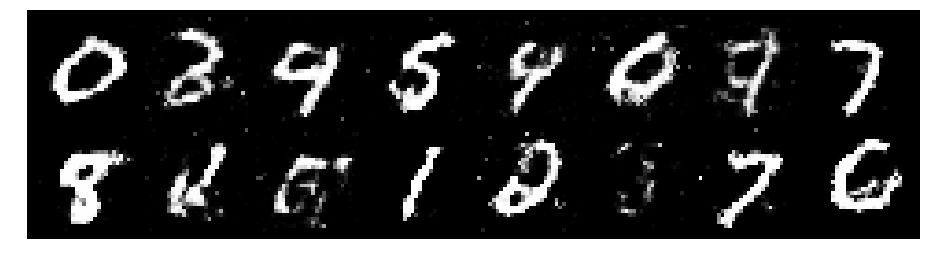

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2589, Generator Loss: 1.3584
D(x): 0.6246, D(G(z)): 0.4333


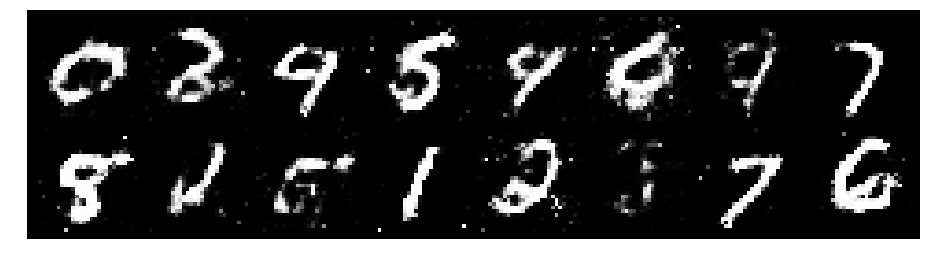

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2185, Generator Loss: 1.1942
D(x): 0.5888, D(G(z)): 0.4067


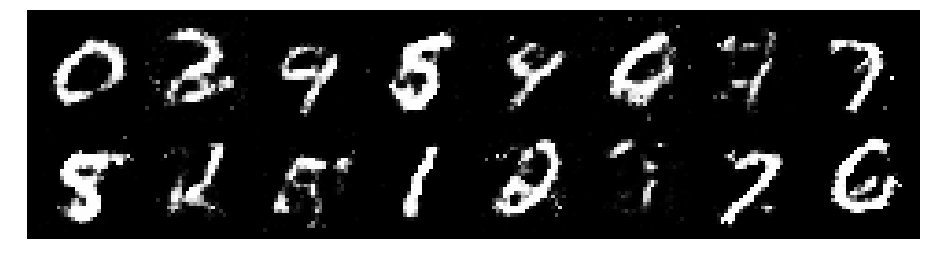

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.1117, Generator Loss: 1.1955
D(x): 0.5952, D(G(z)): 0.3586


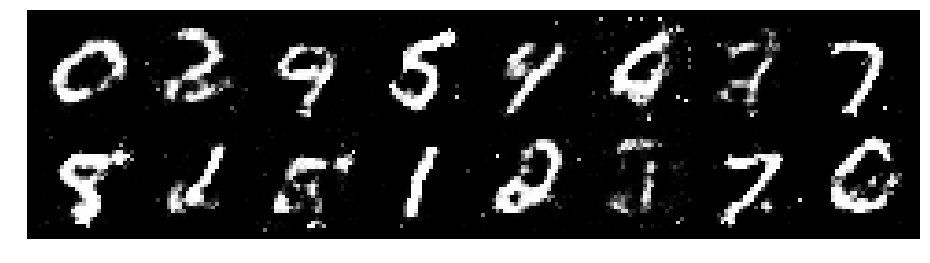

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.0753, Generator Loss: 1.3007
D(x): 0.6148, D(G(z)): 0.3643


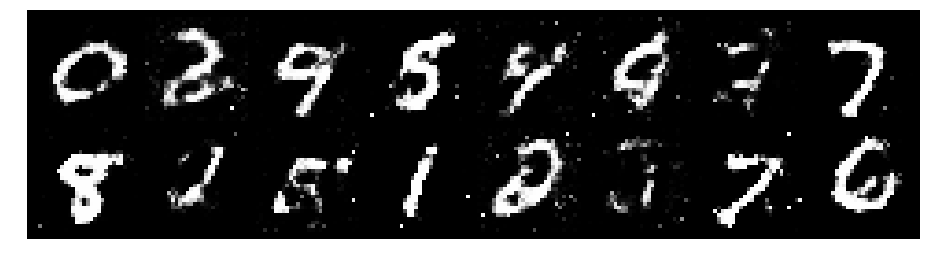

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1188, Generator Loss: 1.3807
D(x): 0.5934, D(G(z)): 0.3542


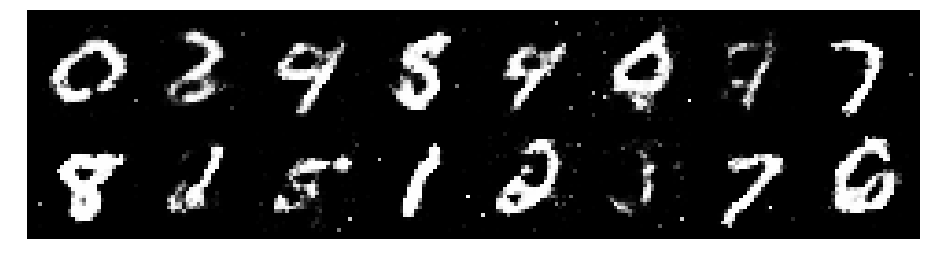

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.1742, Generator Loss: 1.1183
D(x): 0.6146, D(G(z)): 0.4248


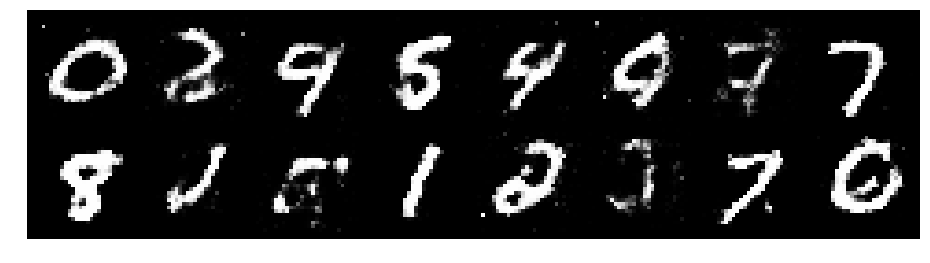

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.2468, Generator Loss: 0.9516
D(x): 0.5510, D(G(z)): 0.4201


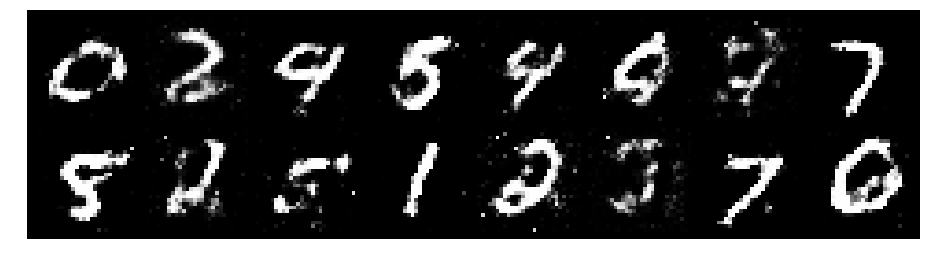

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9596
D(x): 0.5863, D(G(z)): 0.4696


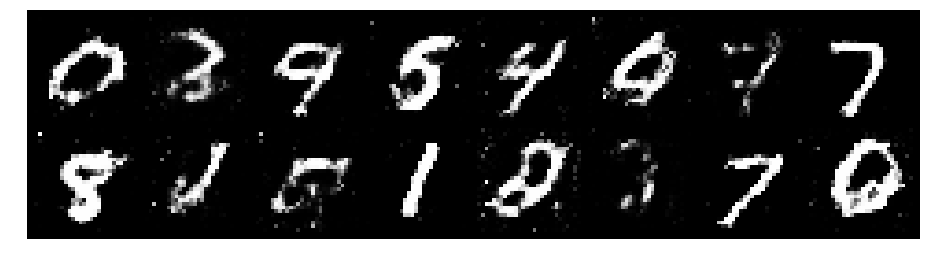

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1780, Generator Loss: 0.8149
D(x): 0.5957, D(G(z)): 0.4501


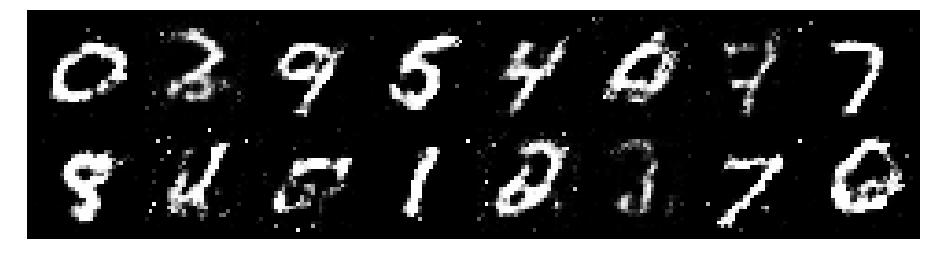

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2238, Generator Loss: 1.0753
D(x): 0.5595, D(G(z)): 0.4044


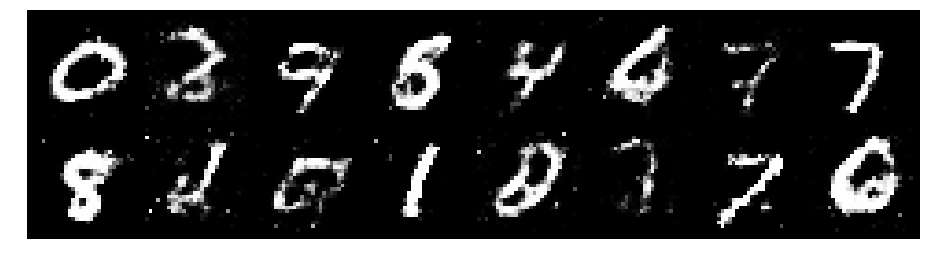

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.1507, Generator Loss: 0.9446
D(x): 0.5825, D(G(z)): 0.4179


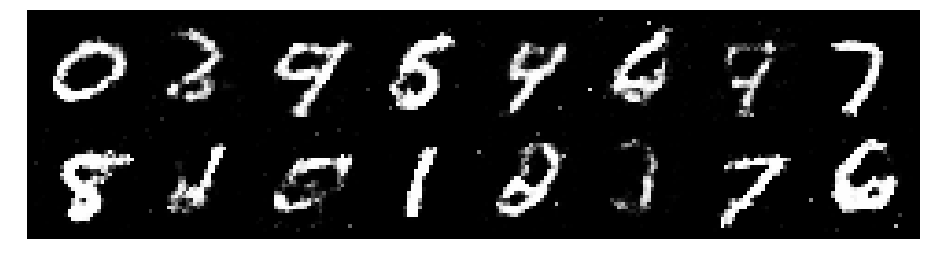

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1498, Generator Loss: 0.9301
D(x): 0.5921, D(G(z)): 0.4076


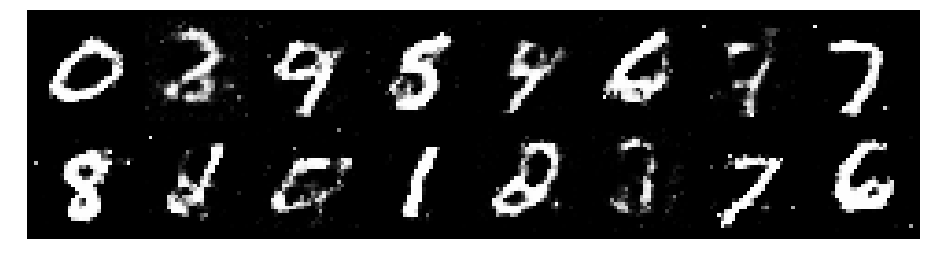

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2693, Generator Loss: 0.8653
D(x): 0.5797, D(G(z)): 0.4610


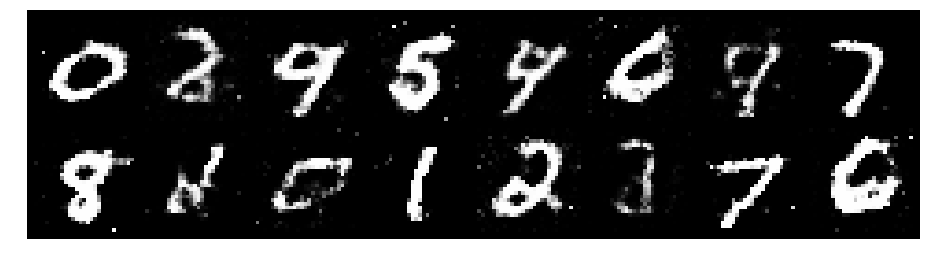

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8855
D(x): 0.5282, D(G(z)): 0.4213


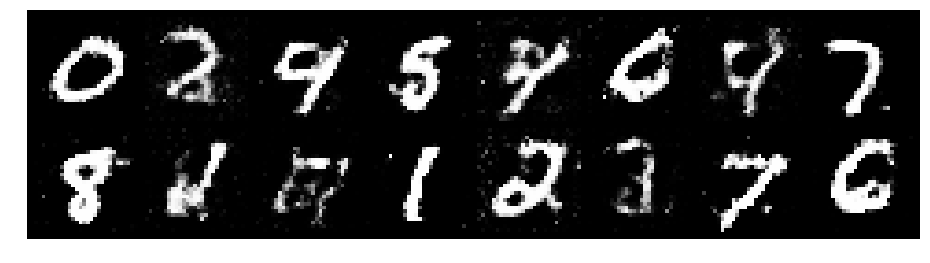

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1956, Generator Loss: 0.8761
D(x): 0.6032, D(G(z)): 0.4465


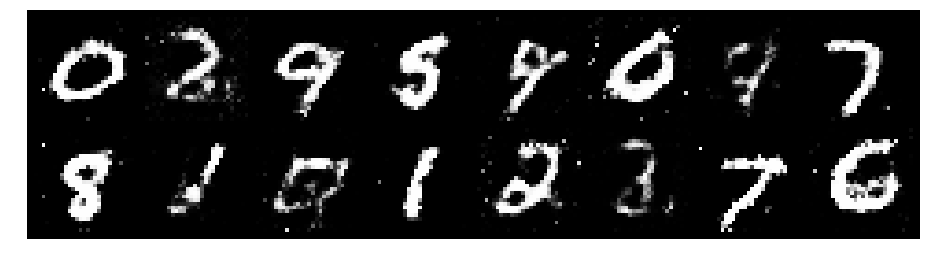

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2126, Generator Loss: 1.0487
D(x): 0.5716, D(G(z)): 0.4209


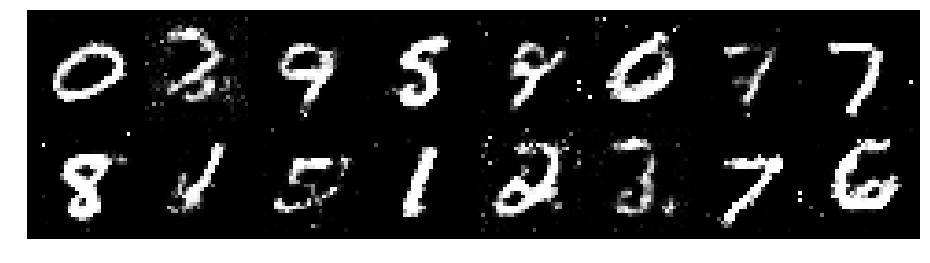

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2034, Generator Loss: 0.9498
D(x): 0.5643, D(G(z)): 0.4144


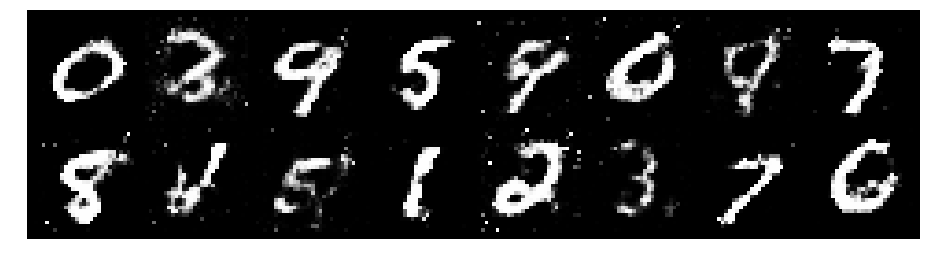

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2155, Generator Loss: 0.9012
D(x): 0.5742, D(G(z)): 0.4135


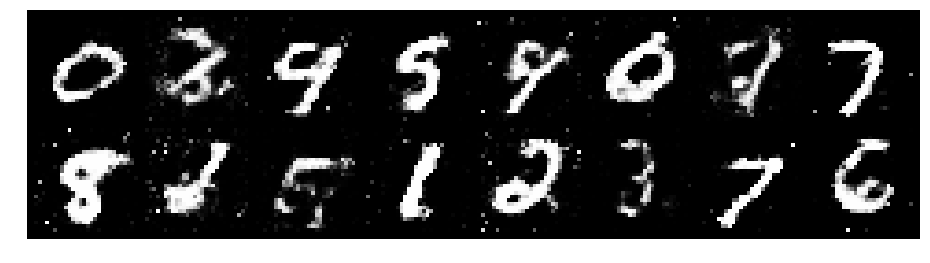

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.2557, Generator Loss: 0.9635
D(x): 0.5241, D(G(z)): 0.3952


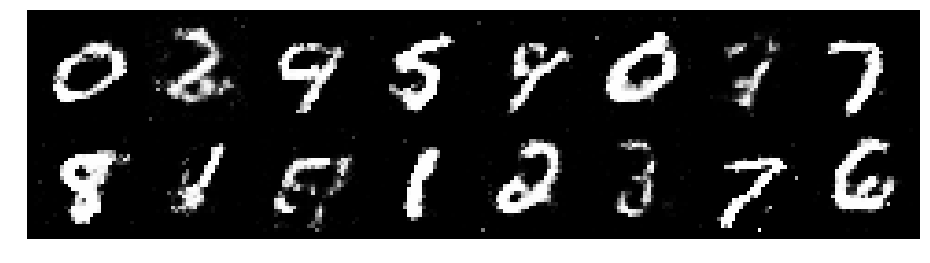

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2066, Generator Loss: 0.9250
D(x): 0.5667, D(G(z)): 0.4113


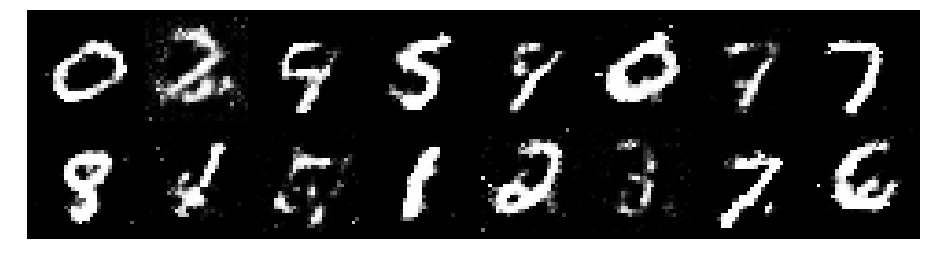

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8848
D(x): 0.5614, D(G(z)): 0.4445


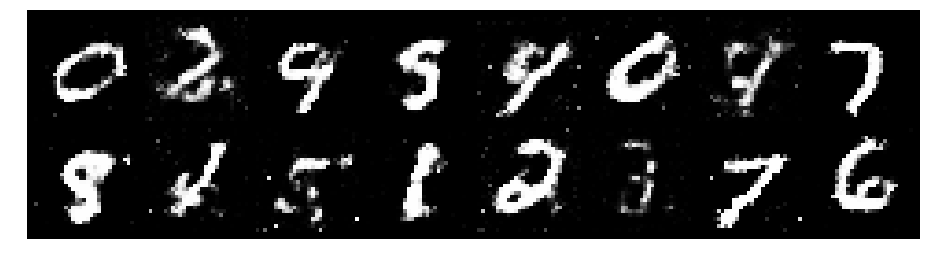

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1680, Generator Loss: 0.9576
D(x): 0.5633, D(G(z)): 0.3992


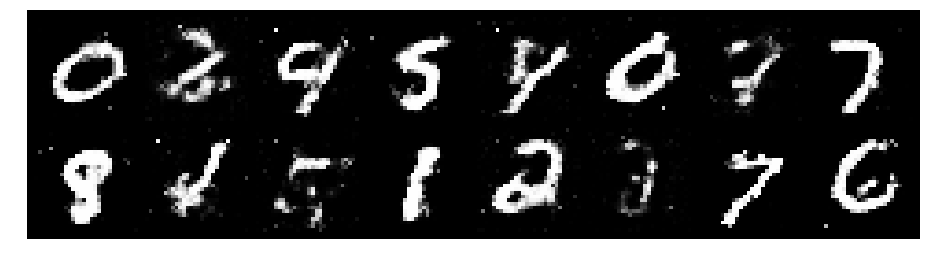

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2346, Generator Loss: 0.9536
D(x): 0.6015, D(G(z)): 0.4396


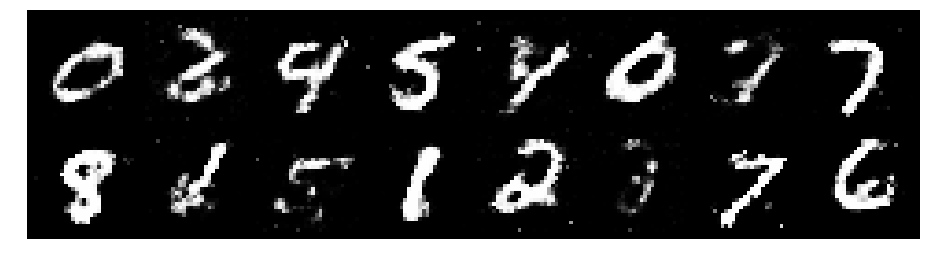

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1864, Generator Loss: 0.9596
D(x): 0.5734, D(G(z)): 0.4234


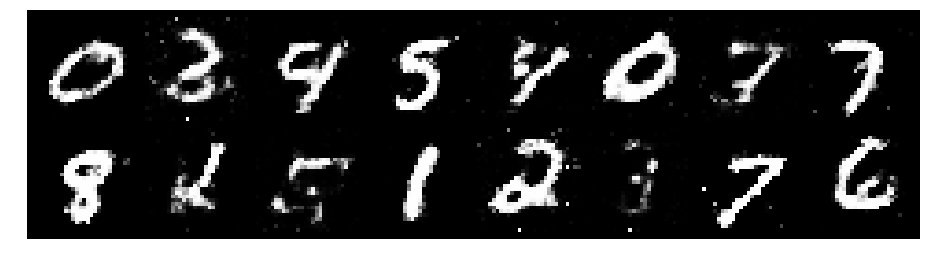

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.3153, Generator Loss: 0.9508
D(x): 0.5409, D(G(z)): 0.4392


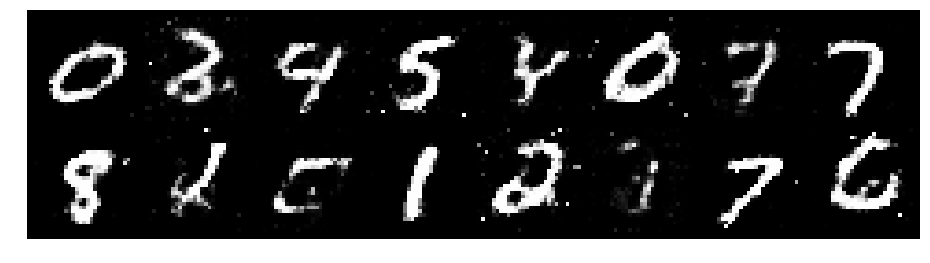

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8895
D(x): 0.5261, D(G(z)): 0.4406


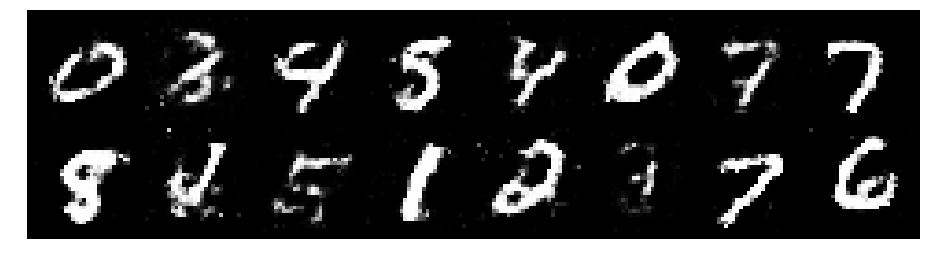

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0094
D(x): 0.5859, D(G(z)): 0.4018


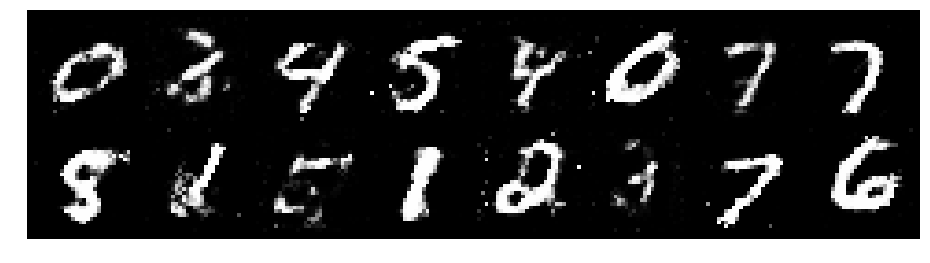

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1503, Generator Loss: 0.9268
D(x): 0.6035, D(G(z)): 0.4350


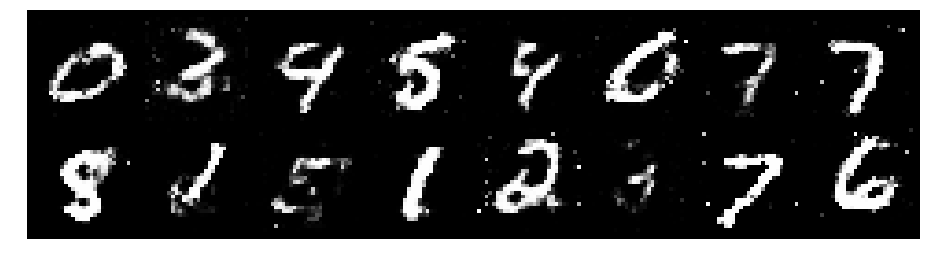

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1221, Generator Loss: 1.0193
D(x): 0.6052, D(G(z)): 0.4003


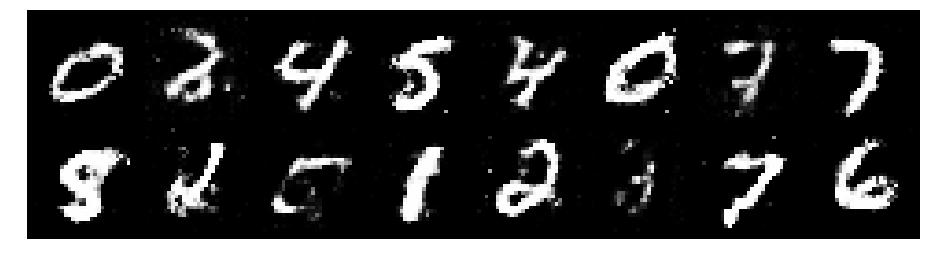

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1459, Generator Loss: 0.9519
D(x): 0.6047, D(G(z)): 0.4117


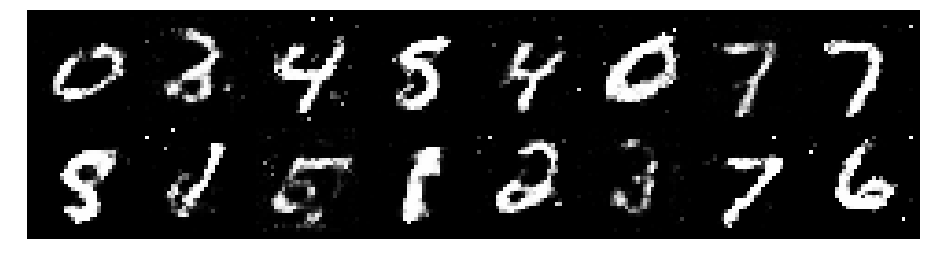

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2705, Generator Loss: 1.0139
D(x): 0.5358, D(G(z)): 0.4043


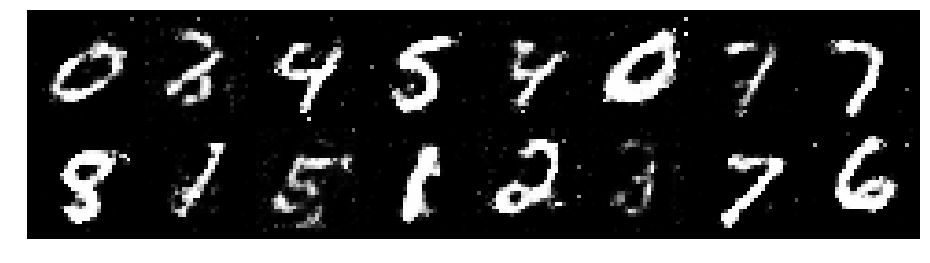

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1736, Generator Loss: 0.9795
D(x): 0.6008, D(G(z)): 0.4032


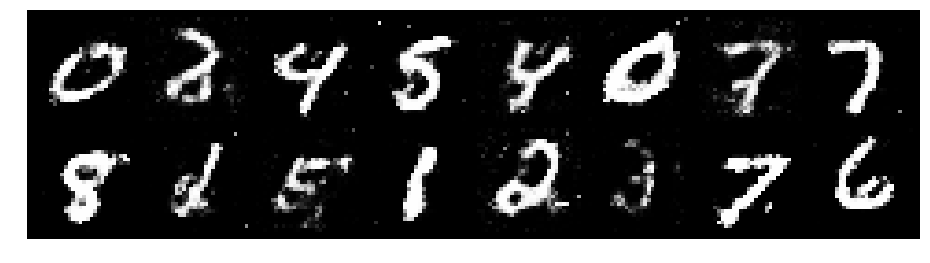

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9218
D(x): 0.5852, D(G(z)): 0.4567


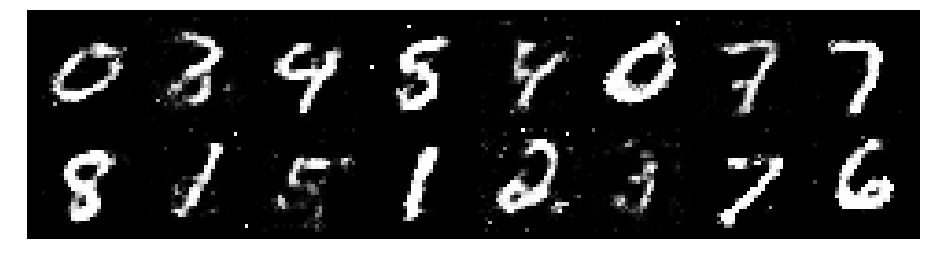

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1952, Generator Loss: 0.9681
D(x): 0.6053, D(G(z)): 0.4493


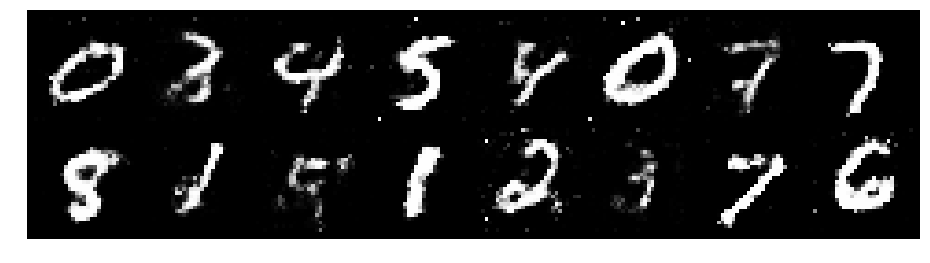

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9858
D(x): 0.5889, D(G(z)): 0.4066


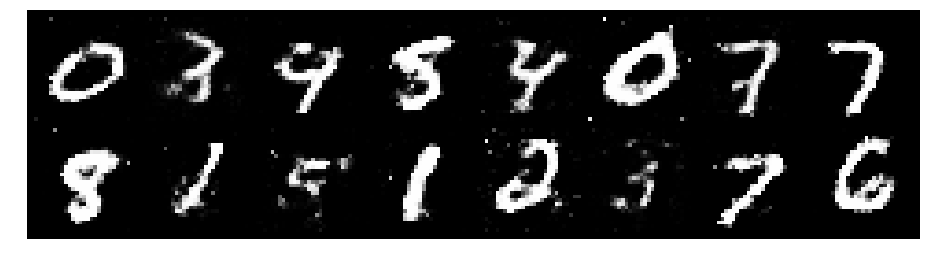

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.0951, Generator Loss: 1.0993
D(x): 0.6080, D(G(z)): 0.3896


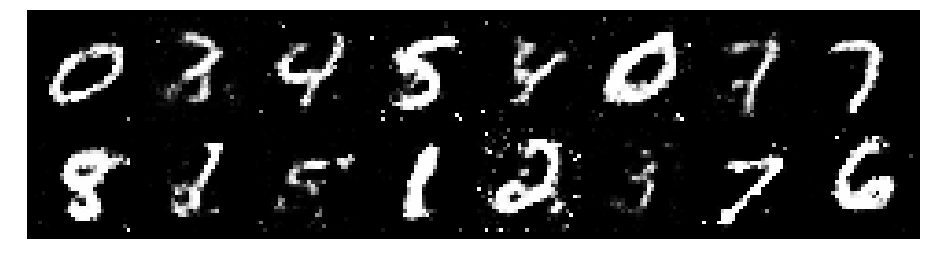

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2470, Generator Loss: 1.0055
D(x): 0.5341, D(G(z)): 0.3962


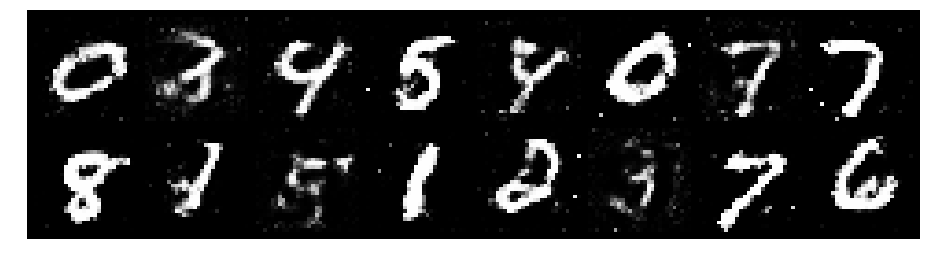

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8624
D(x): 0.5874, D(G(z)): 0.4461


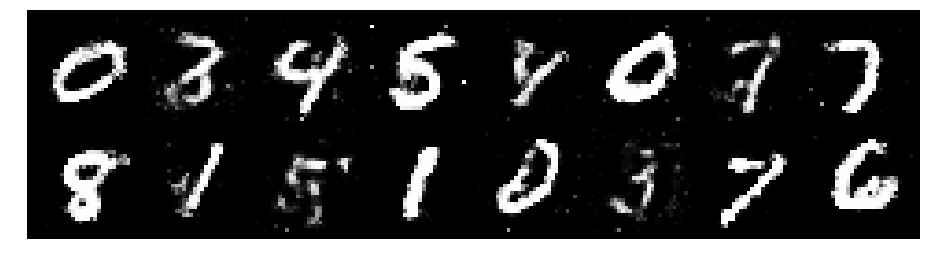

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2087, Generator Loss: 1.0261
D(x): 0.5832, D(G(z)): 0.4332


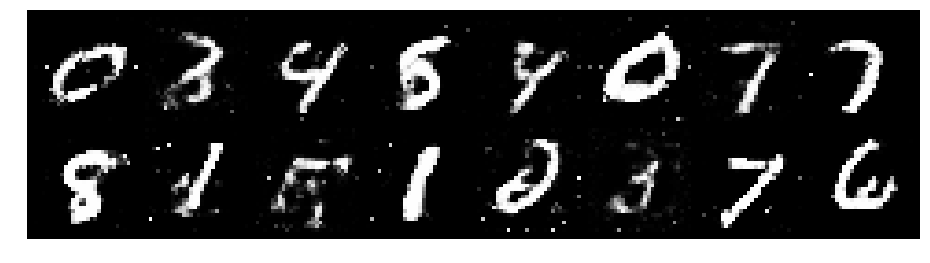

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1199, Generator Loss: 0.9901
D(x): 0.5921, D(G(z)): 0.4057


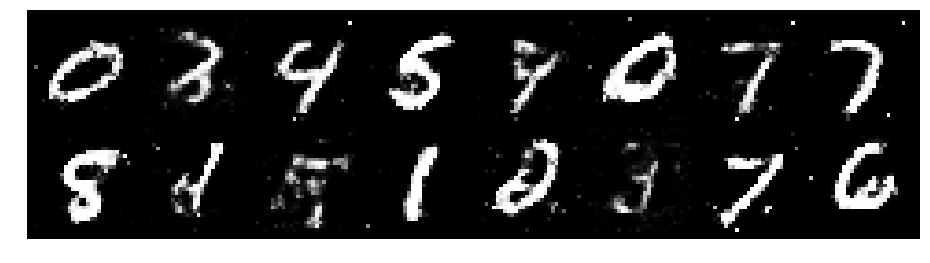

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1986, Generator Loss: 1.0515
D(x): 0.6145, D(G(z)): 0.4343


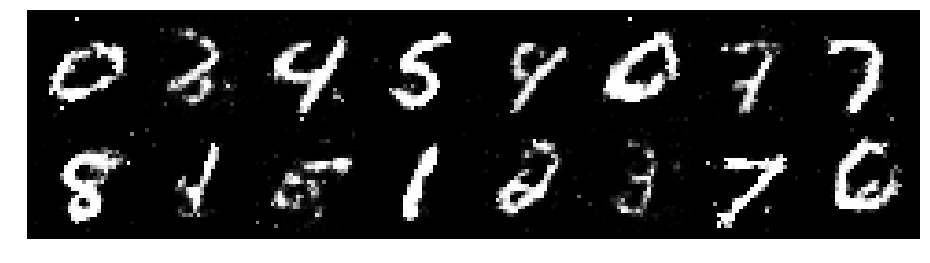

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.1796, Generator Loss: 0.9393
D(x): 0.6046, D(G(z)): 0.4388


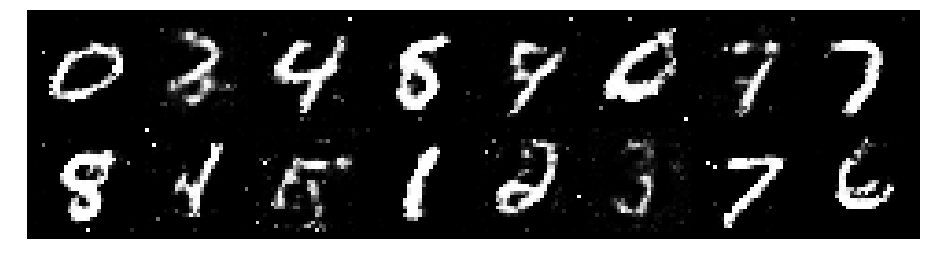

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.3579, Generator Loss: 0.8673
D(x): 0.5334, D(G(z)): 0.4629


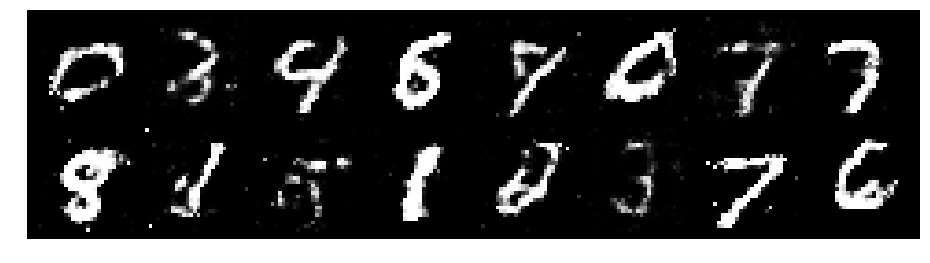

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2652, Generator Loss: 0.9357
D(x): 0.5388, D(G(z)): 0.4260


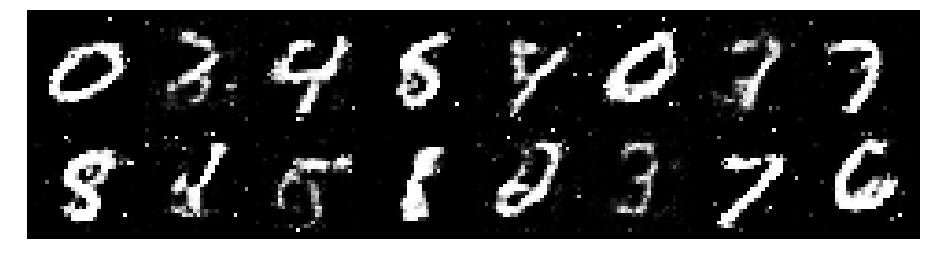

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2453, Generator Loss: 0.9720
D(x): 0.5425, D(G(z)): 0.4135


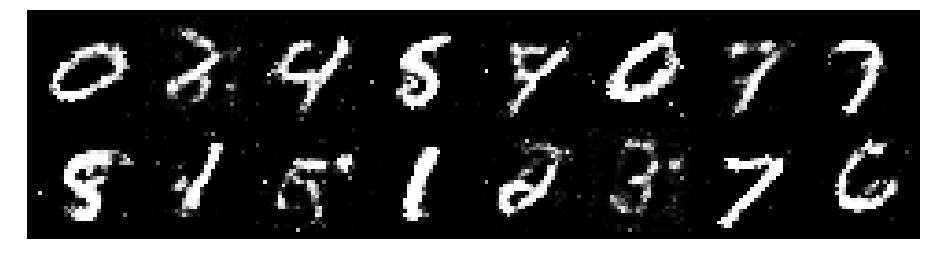

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9785
D(x): 0.5905, D(G(z)): 0.4615


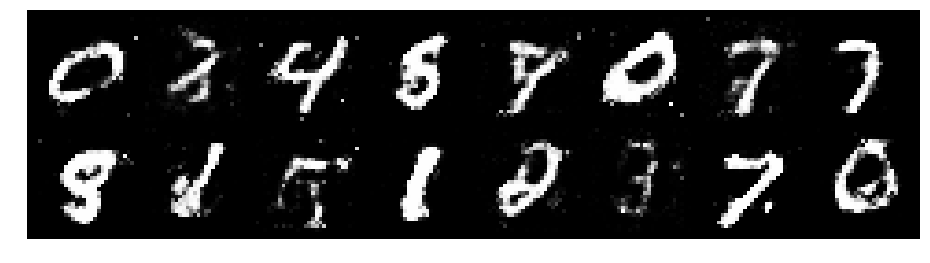

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1938, Generator Loss: 0.9772
D(x): 0.5917, D(G(z)): 0.4283


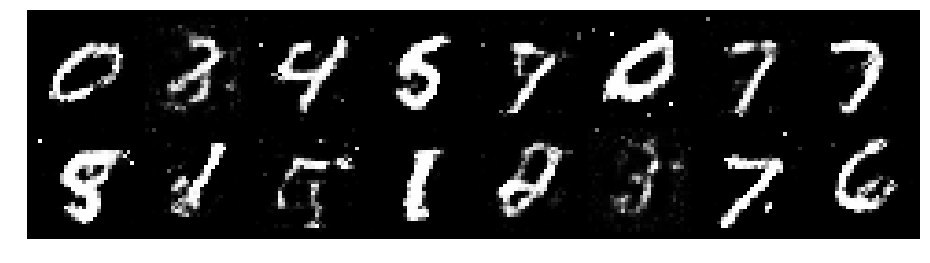

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2142, Generator Loss: 0.9640
D(x): 0.5653, D(G(z)): 0.4339


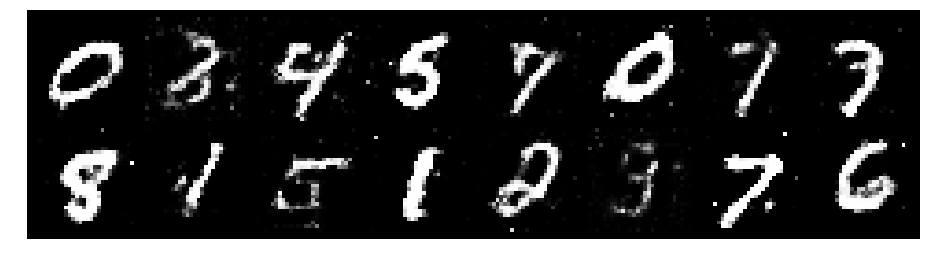

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1354, Generator Loss: 1.1026
D(x): 0.6042, D(G(z)): 0.4143


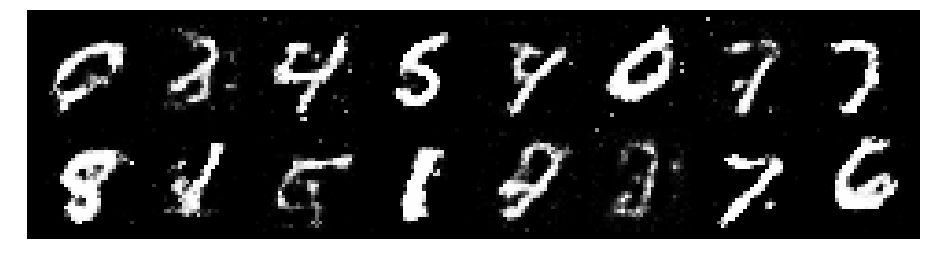

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1975, Generator Loss: 1.1757
D(x): 0.5430, D(G(z)): 0.3451


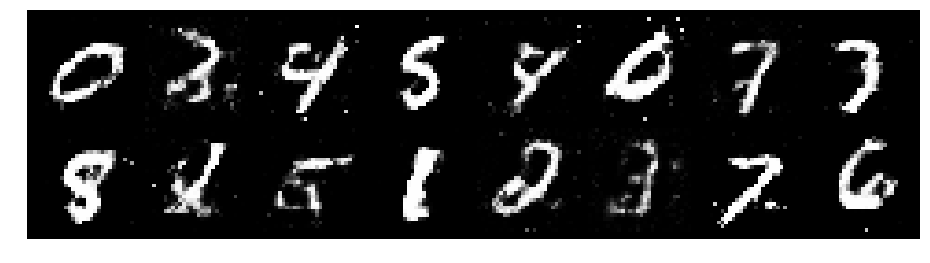

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2081, Generator Loss: 1.0158
D(x): 0.6345, D(G(z)): 0.4475


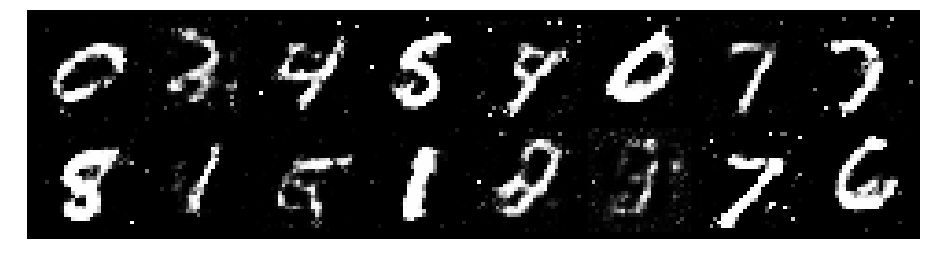

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1985, Generator Loss: 0.9425
D(x): 0.5509, D(G(z)): 0.3998


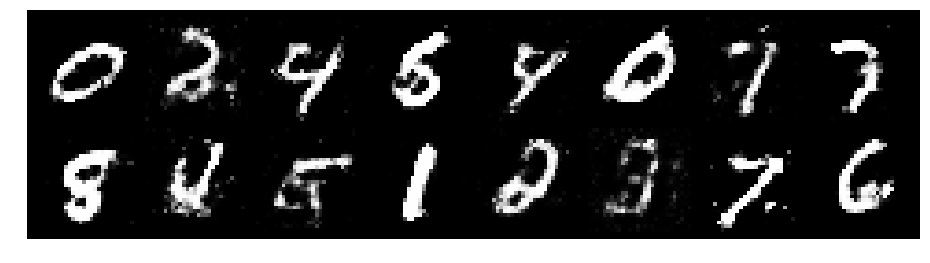

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1853, Generator Loss: 1.0783
D(x): 0.5418, D(G(z)): 0.3483


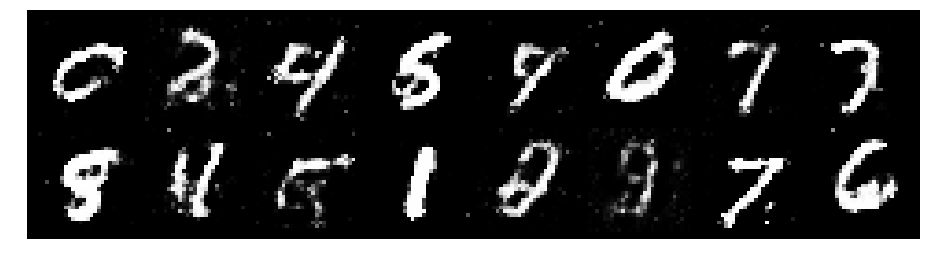

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.3636, Generator Loss: 1.0320
D(x): 0.5301, D(G(z)): 0.4413


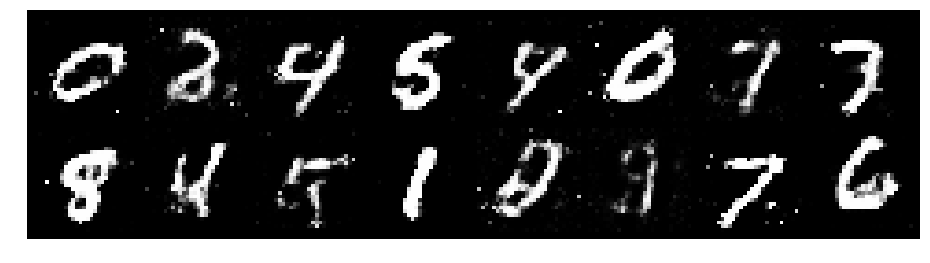

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.3292, Generator Loss: 0.9542
D(x): 0.5406, D(G(z)): 0.4005


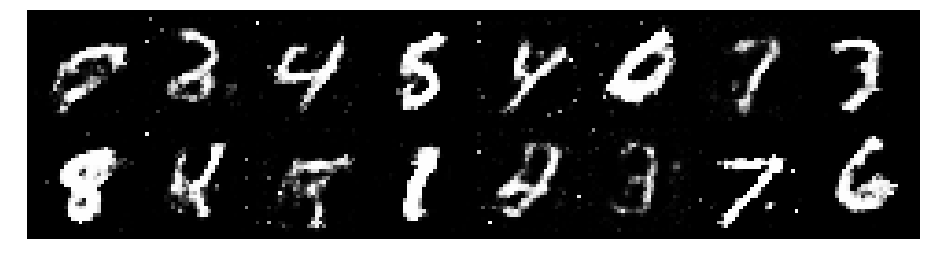

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.3012, Generator Loss: 1.0377
D(x): 0.5532, D(G(z)): 0.4020


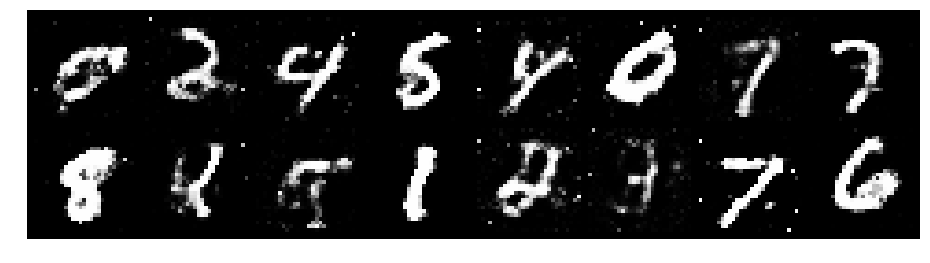

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.4625, Generator Loss: 0.7727
D(x): 0.5537, D(G(z)): 0.4980


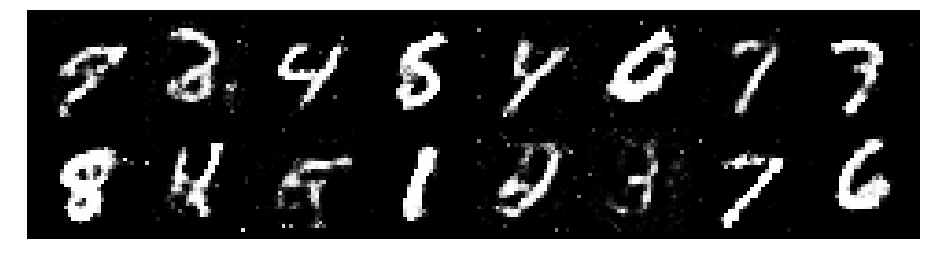

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2098, Generator Loss: 0.9473
D(x): 0.5821, D(G(z)): 0.3924


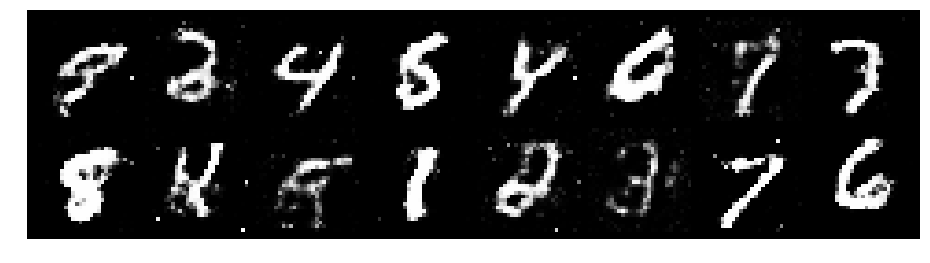

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1636, Generator Loss: 1.0596
D(x): 0.5743, D(G(z)): 0.3828


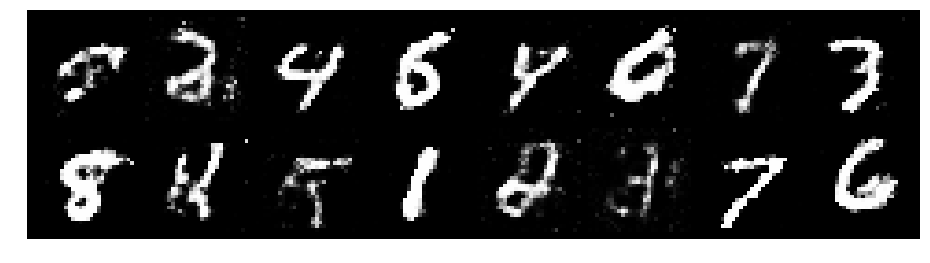

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1577, Generator Loss: 1.0356
D(x): 0.5897, D(G(z)): 0.3933


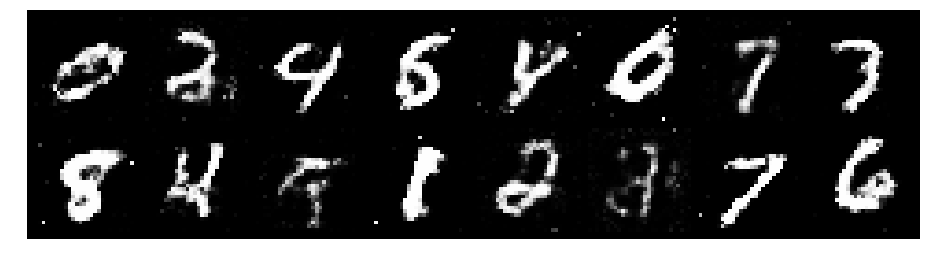

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.3132, Generator Loss: 1.0656
D(x): 0.4908, D(G(z)): 0.3912


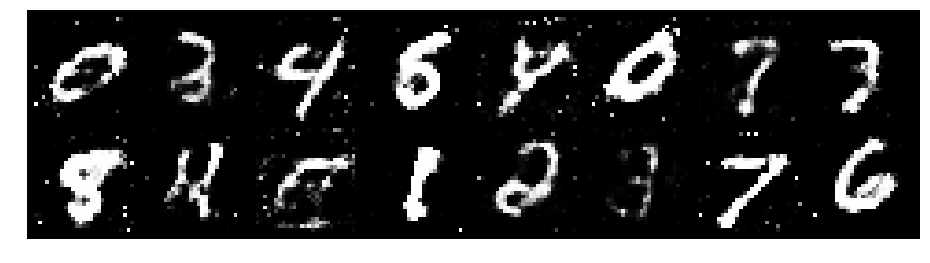

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.1648, Generator Loss: 0.9864
D(x): 0.5684, D(G(z)): 0.3914


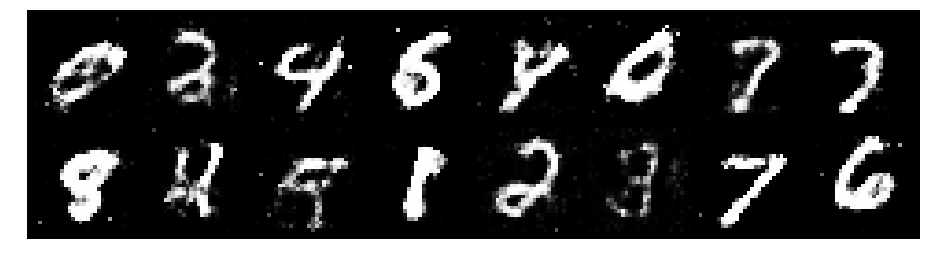

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1425, Generator Loss: 0.9891
D(x): 0.5901, D(G(z)): 0.4085


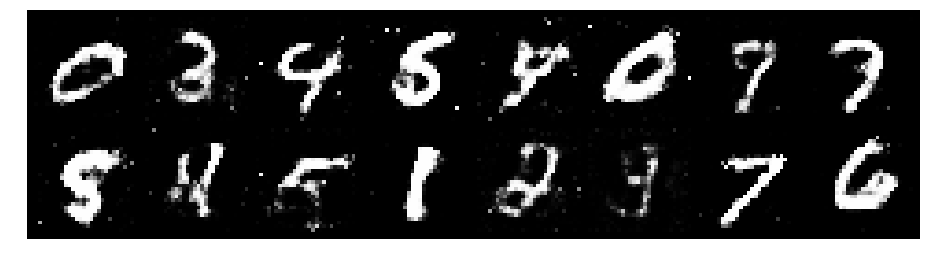

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1374, Generator Loss: 0.9154
D(x): 0.6142, D(G(z)): 0.4291


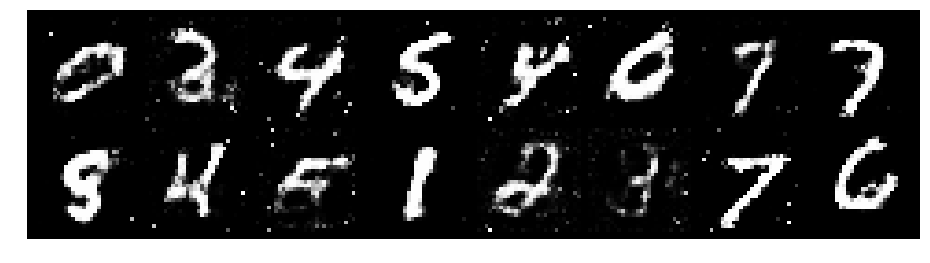

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2398, Generator Loss: 1.0084
D(x): 0.5507, D(G(z)): 0.4265


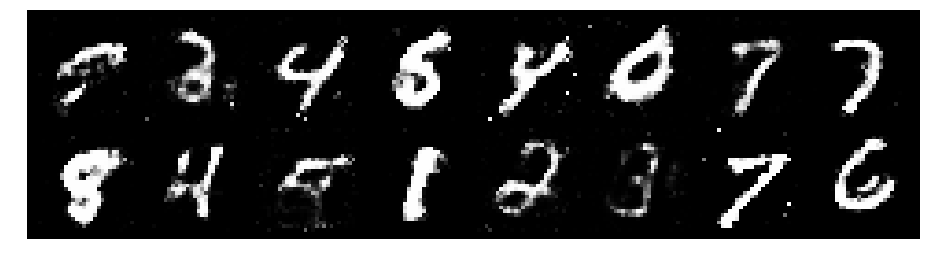

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.0873, Generator Loss: 0.9729
D(x): 0.6096, D(G(z)): 0.3999


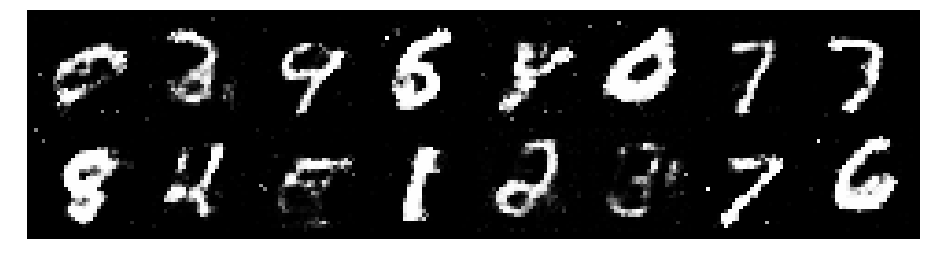

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1559, Generator Loss: 1.1131
D(x): 0.6112, D(G(z)): 0.4280


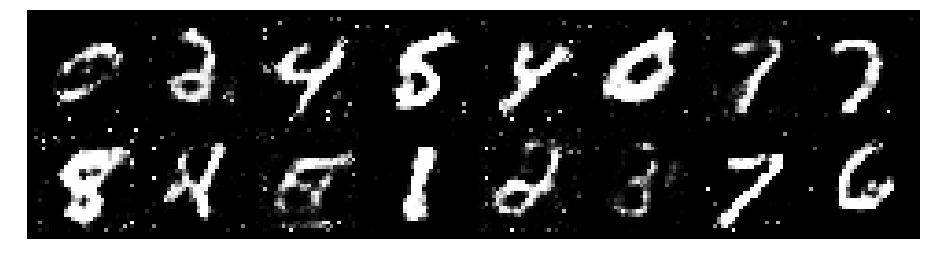

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2343, Generator Loss: 0.9535
D(x): 0.5438, D(G(z)): 0.4196


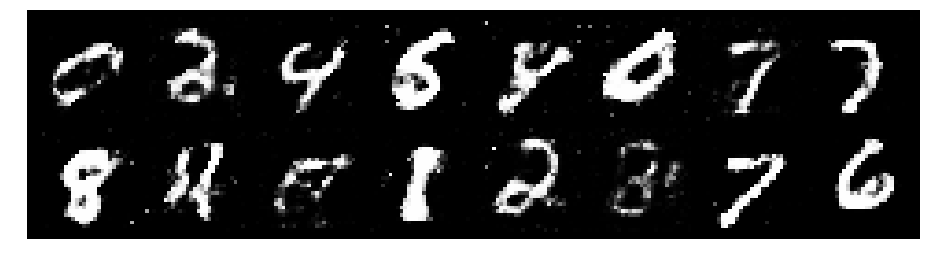

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1167, Generator Loss: 1.0148
D(x): 0.5908, D(G(z)): 0.3758


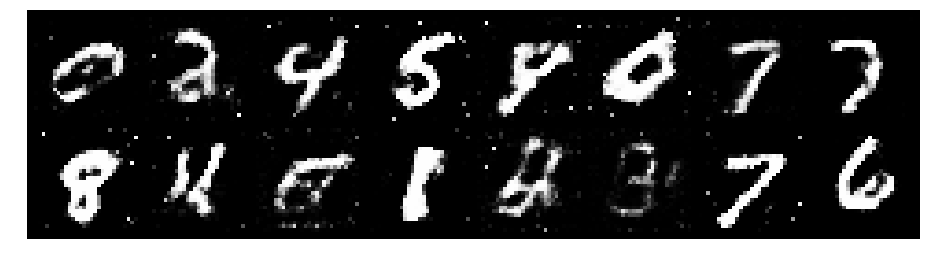

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1681, Generator Loss: 1.2690
D(x): 0.6220, D(G(z)): 0.4203


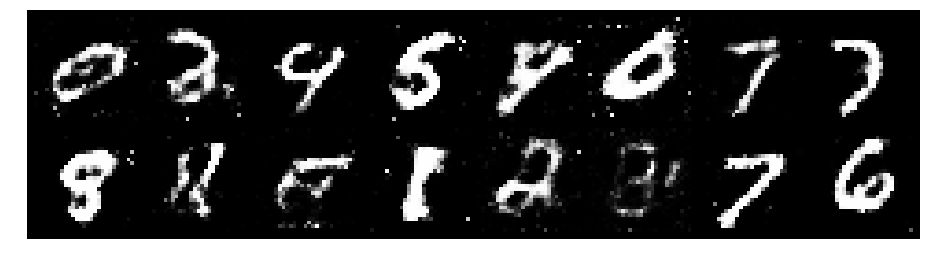

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1924, Generator Loss: 0.9731
D(x): 0.5820, D(G(z)): 0.4201


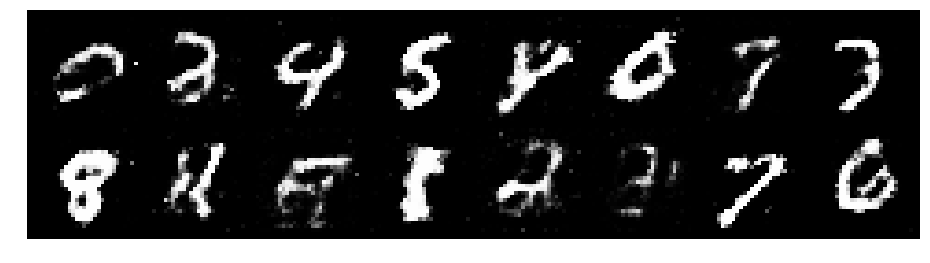

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2017, Generator Loss: 0.9273
D(x): 0.5487, D(G(z)): 0.4104


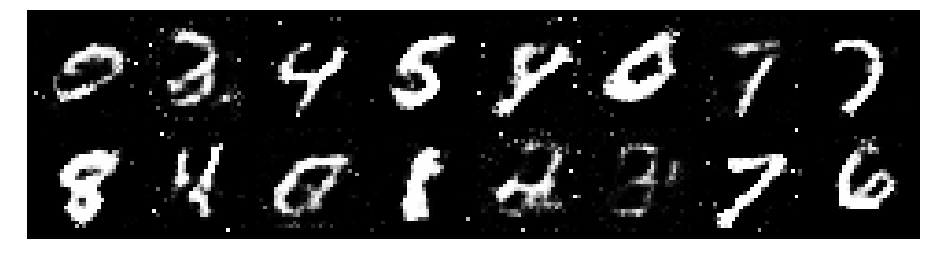

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9846
D(x): 0.6176, D(G(z)): 0.4420


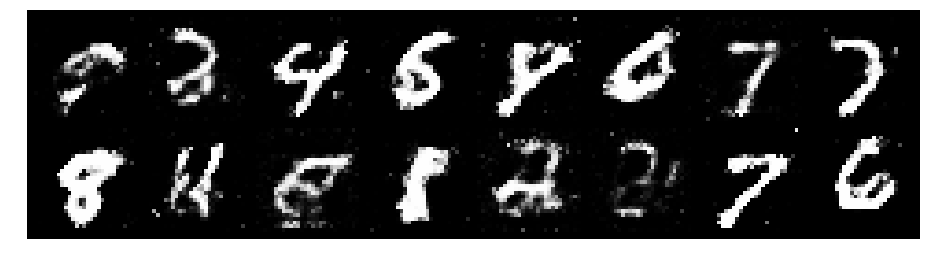

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1645, Generator Loss: 1.0492
D(x): 0.5990, D(G(z)): 0.4099


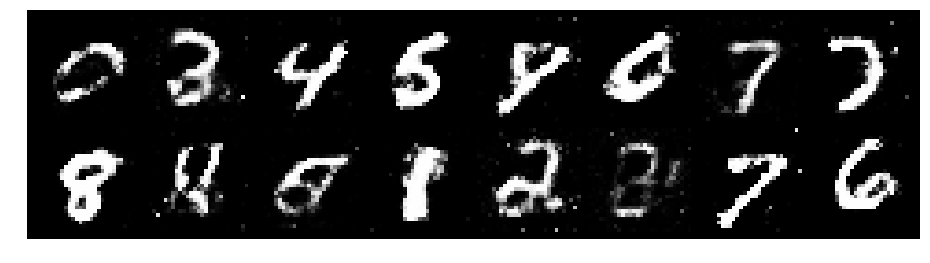

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1582, Generator Loss: 0.9362
D(x): 0.5820, D(G(z)): 0.4192


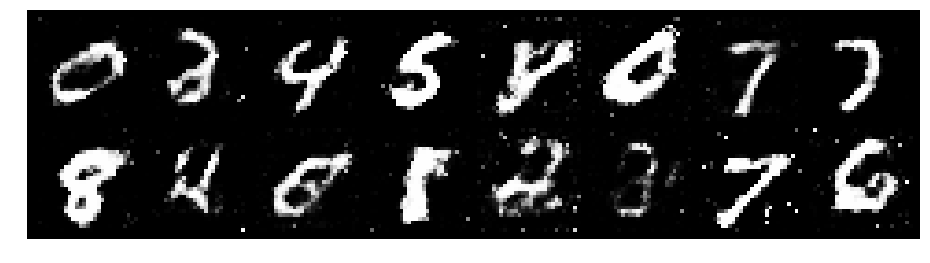

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2022, Generator Loss: 0.8627
D(x): 0.5931, D(G(z)): 0.4644


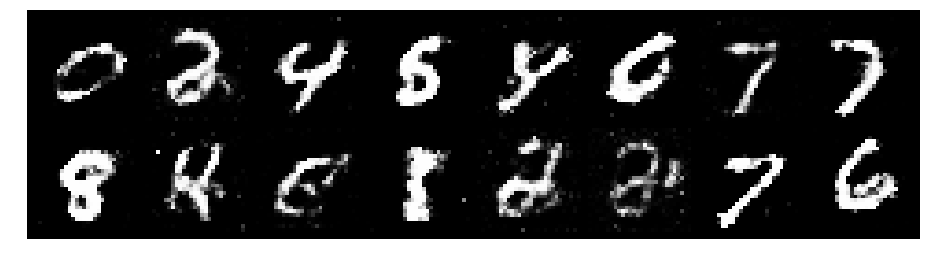

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2927, Generator Loss: 0.9460
D(x): 0.5413, D(G(z)): 0.4462


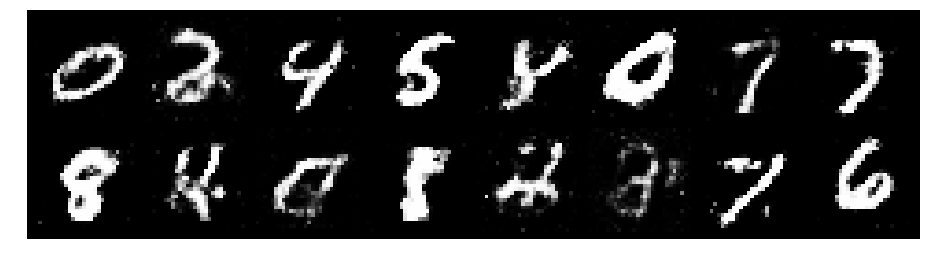

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2978, Generator Loss: 0.8459
D(x): 0.5265, D(G(z)): 0.4402


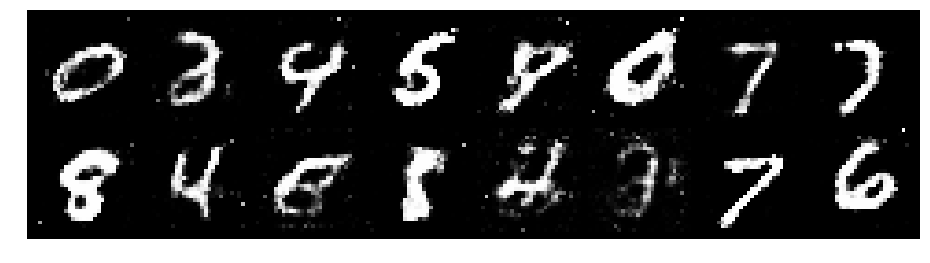

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.3142, Generator Loss: 0.9209
D(x): 0.5349, D(G(z)): 0.4445


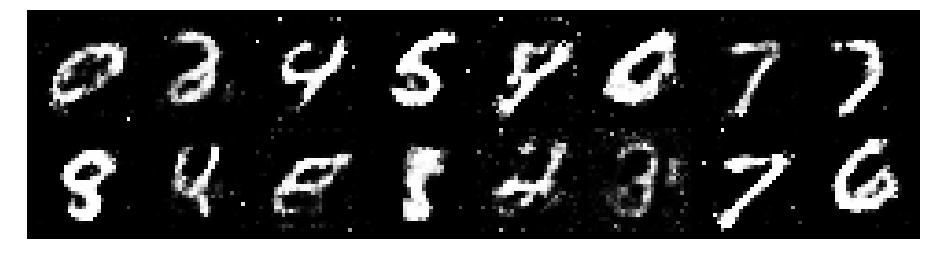

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2640, Generator Loss: 0.9554
D(x): 0.5575, D(G(z)): 0.4320


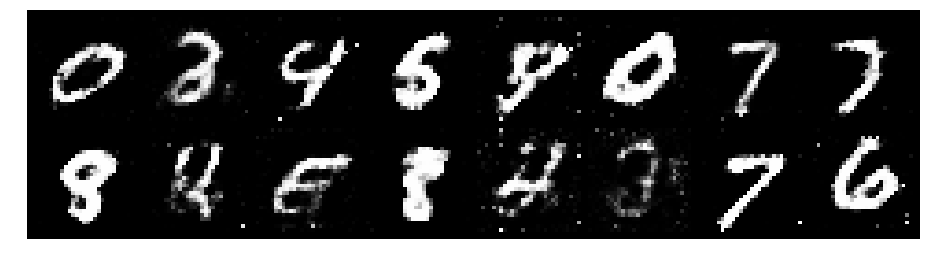

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2690, Generator Loss: 1.0318
D(x): 0.5752, D(G(z)): 0.4512


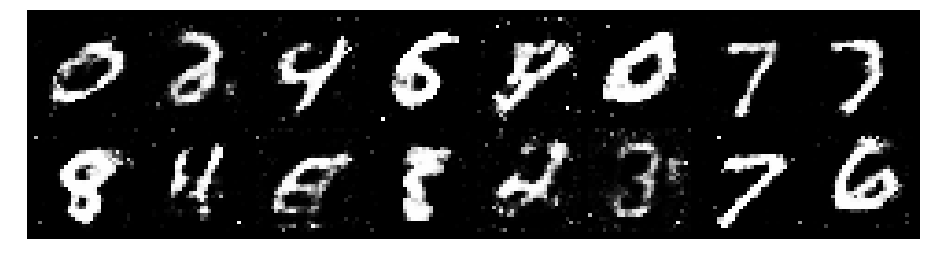

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3301, Generator Loss: 0.9876
D(x): 0.5525, D(G(z)): 0.4626


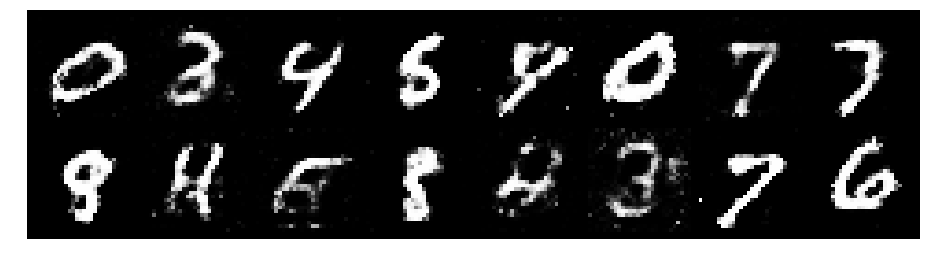

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2883, Generator Loss: 0.9641
D(x): 0.5424, D(G(z)): 0.4151


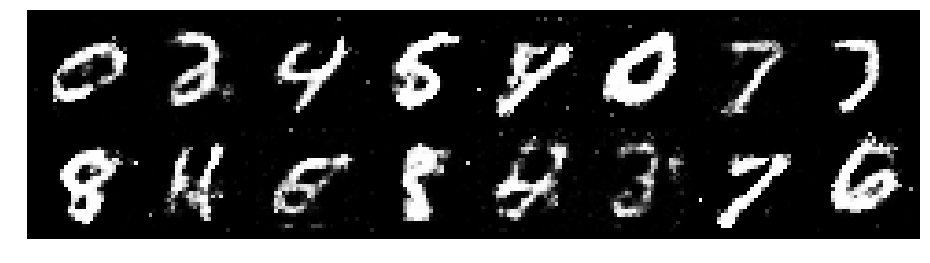

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.3716, Generator Loss: 0.7691
D(x): 0.5497, D(G(z)): 0.4834


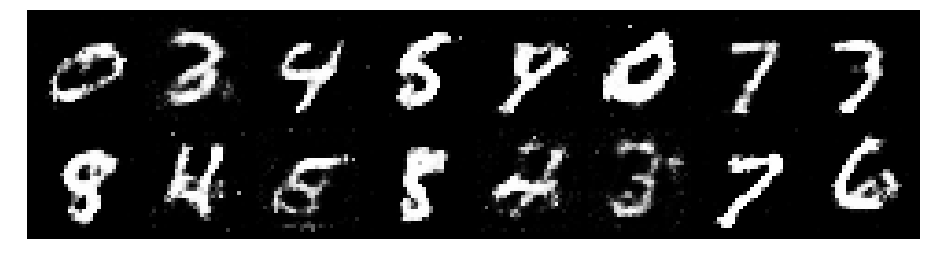

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3346, Generator Loss: 0.9383
D(x): 0.5485, D(G(z)): 0.4415


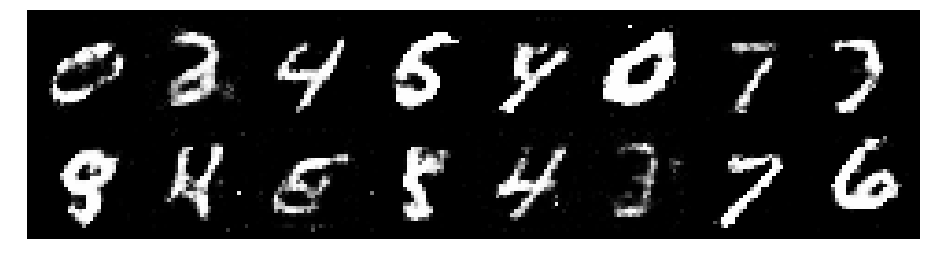

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2560, Generator Loss: 0.9180
D(x): 0.5673, D(G(z)): 0.4613


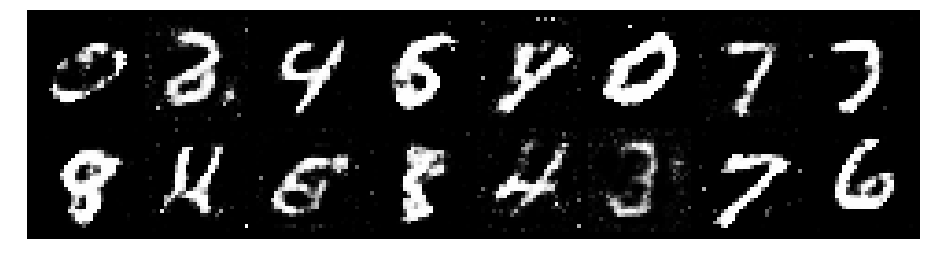

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.1946, Generator Loss: 0.9967
D(x): 0.5603, D(G(z)): 0.4026


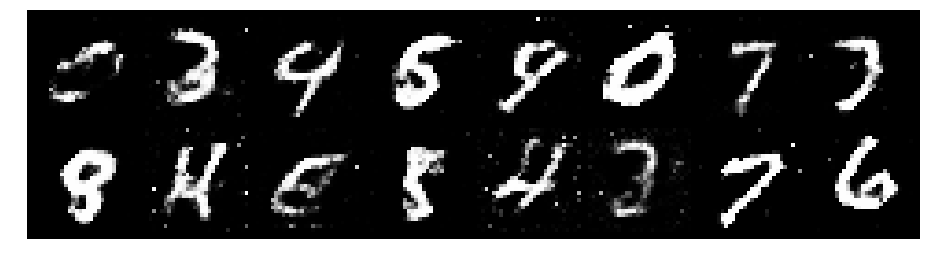

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2174, Generator Loss: 0.9274
D(x): 0.6289, D(G(z)): 0.4869


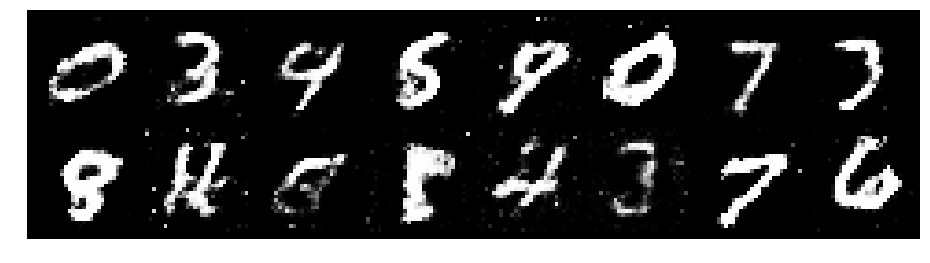

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1086, Generator Loss: 1.0336
D(x): 0.6055, D(G(z)): 0.3917


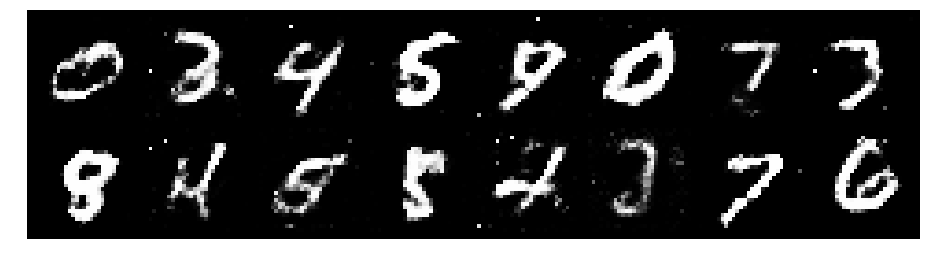

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.3546, Generator Loss: 0.8994
D(x): 0.5785, D(G(z)): 0.4648


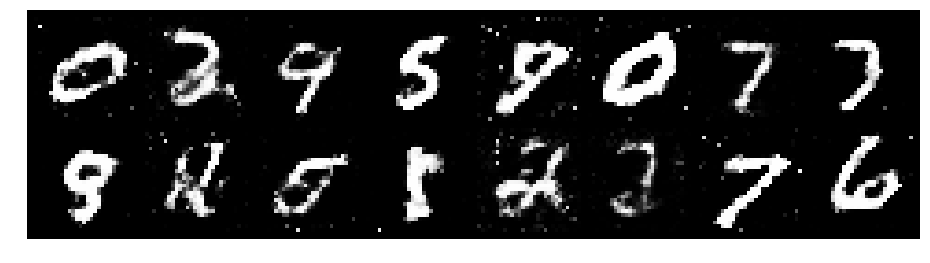

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8645
D(x): 0.5968, D(G(z)): 0.4146


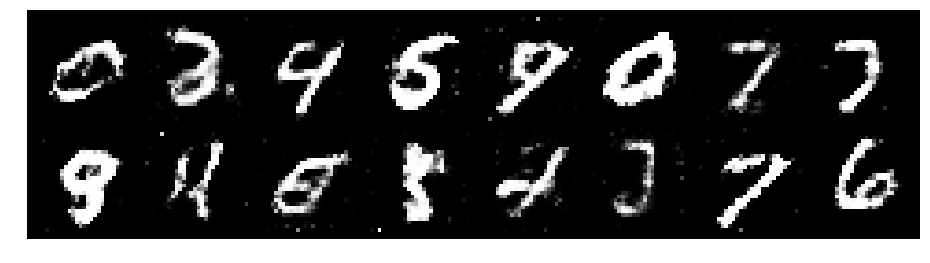

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9309
D(x): 0.5643, D(G(z)): 0.4273


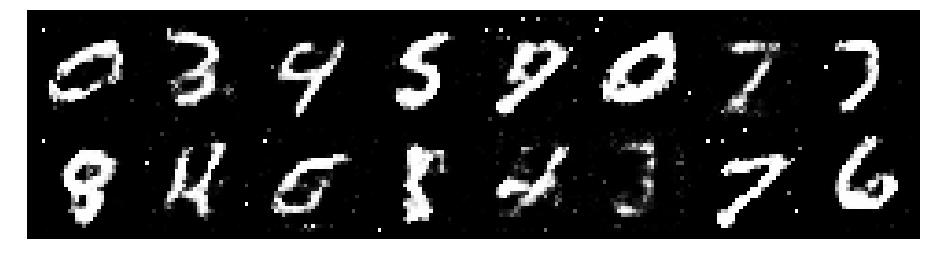

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2313, Generator Loss: 1.1803
D(x): 0.5499, D(G(z)): 0.4003


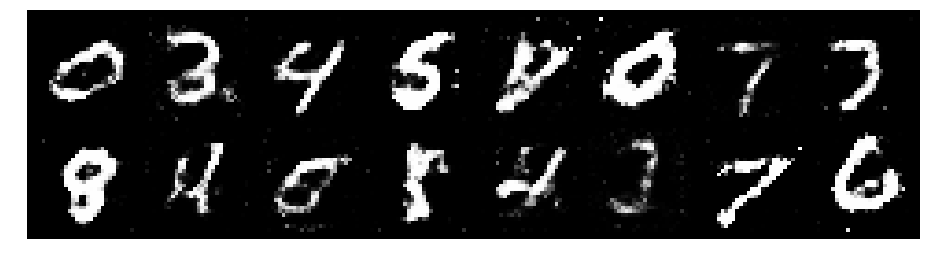

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2252, Generator Loss: 1.1255
D(x): 0.5846, D(G(z)): 0.3925


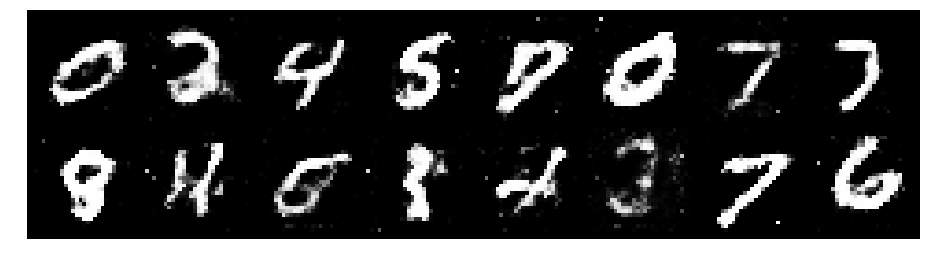

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2095, Generator Loss: 1.2453
D(x): 0.6523, D(G(z)): 0.4519


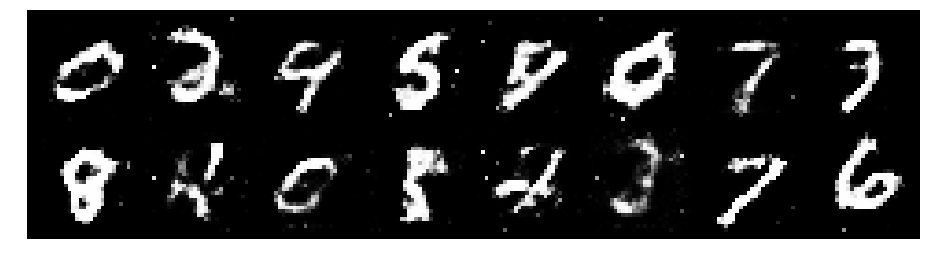

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2838, Generator Loss: 1.0106
D(x): 0.5604, D(G(z)): 0.3928


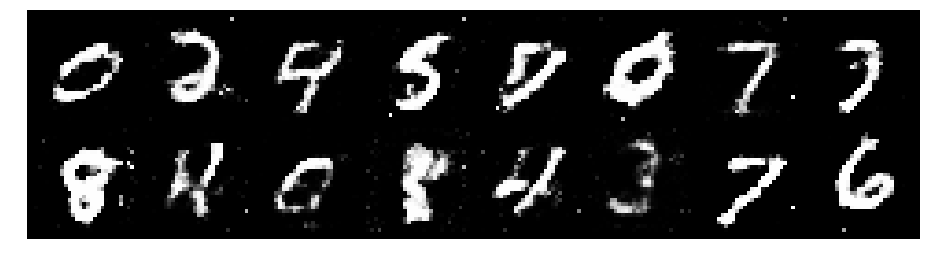

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2679, Generator Loss: 0.9426
D(x): 0.5651, D(G(z)): 0.4356


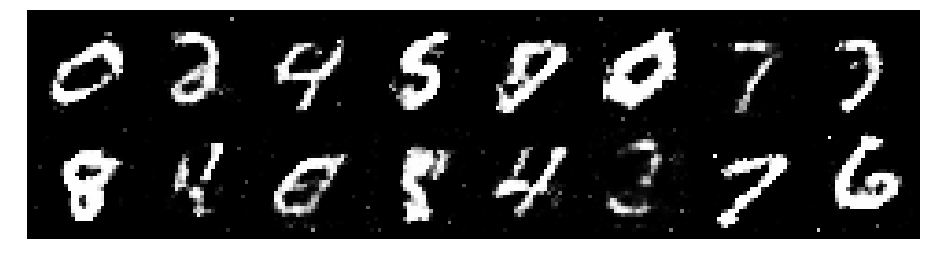

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.1388, Generator Loss: 1.0172
D(x): 0.5788, D(G(z)): 0.3817


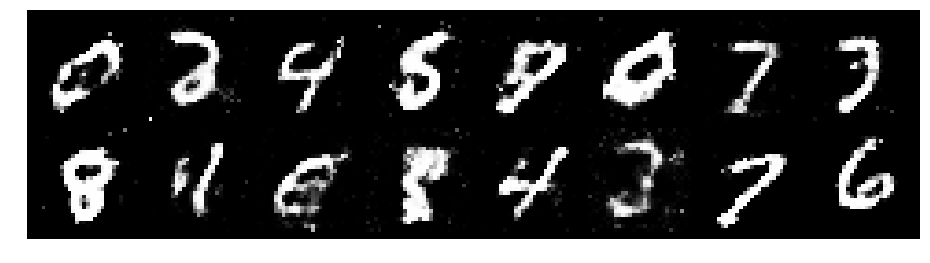

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1409, Generator Loss: 0.9507
D(x): 0.5884, D(G(z)): 0.4109


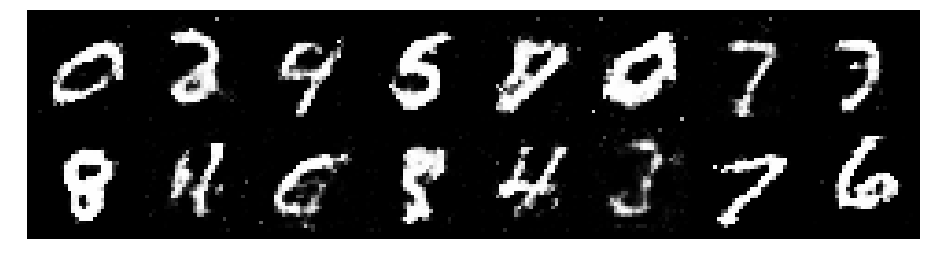

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2152, Generator Loss: 0.8747
D(x): 0.5995, D(G(z)): 0.4596


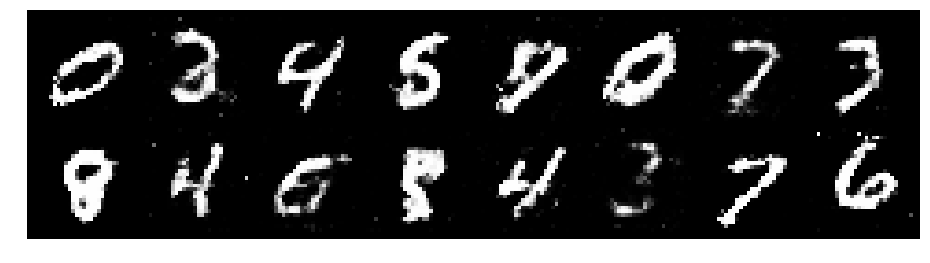

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2534, Generator Loss: 0.8379
D(x): 0.5793, D(G(z)): 0.4615


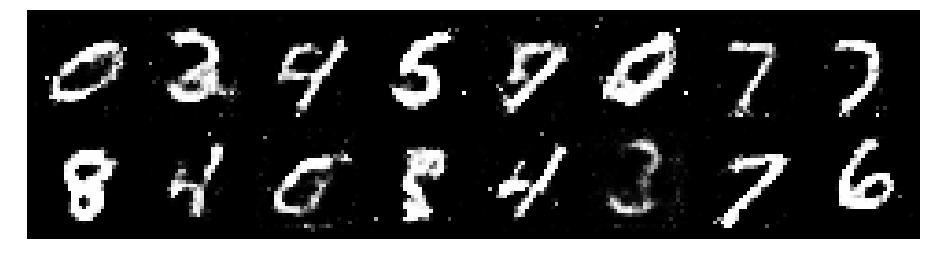

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9414
D(x): 0.5619, D(G(z)): 0.4327


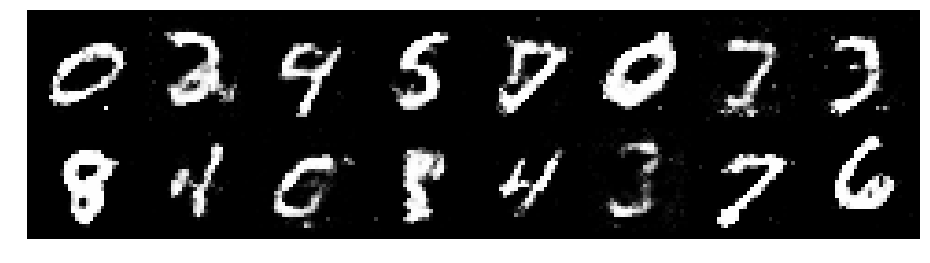

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.1527, Generator Loss: 0.9431
D(x): 0.6180, D(G(z)): 0.4370


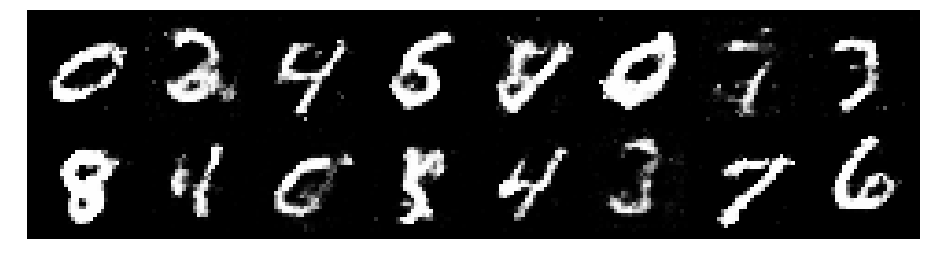

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2304, Generator Loss: 0.9035
D(x): 0.5495, D(G(z)): 0.4318


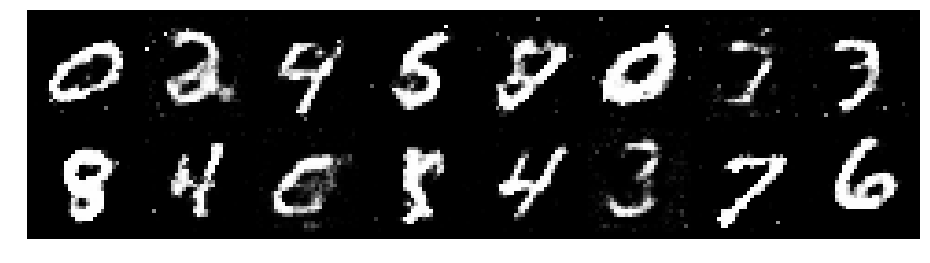

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1603, Generator Loss: 0.9094
D(x): 0.5743, D(G(z)): 0.4089


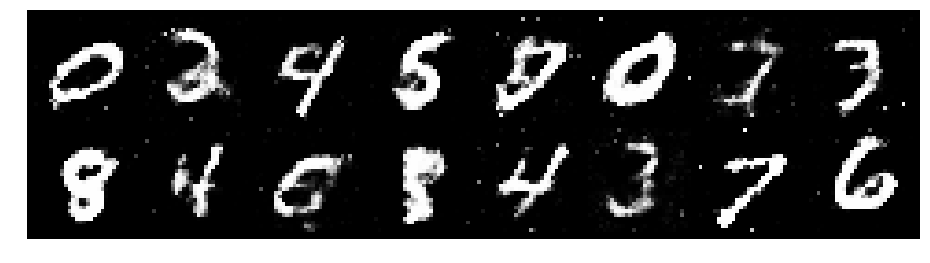

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2646, Generator Loss: 0.9743
D(x): 0.5305, D(G(z)): 0.4147


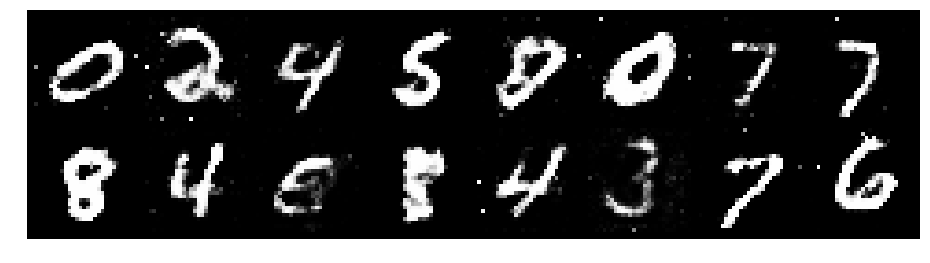

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2590, Generator Loss: 0.7860
D(x): 0.5874, D(G(z)): 0.4688


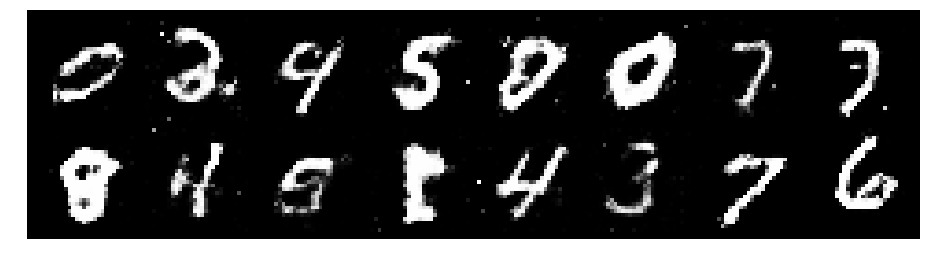

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2736, Generator Loss: 0.9502
D(x): 0.5437, D(G(z)): 0.4406


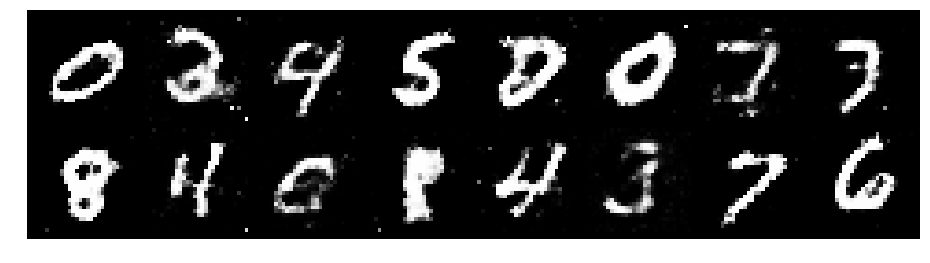

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2170, Generator Loss: 0.8561
D(x): 0.5967, D(G(z)): 0.4497


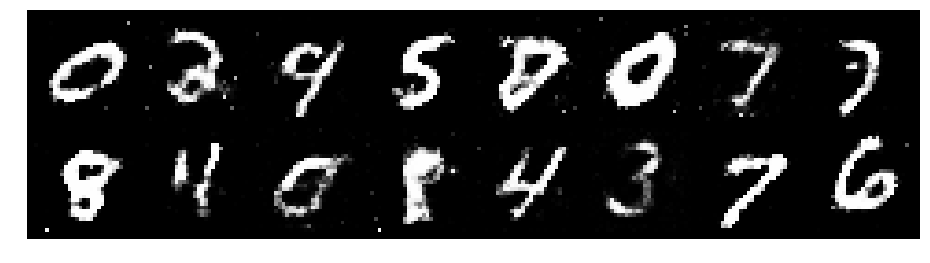

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2255, Generator Loss: 0.8771
D(x): 0.5740, D(G(z)): 0.4262


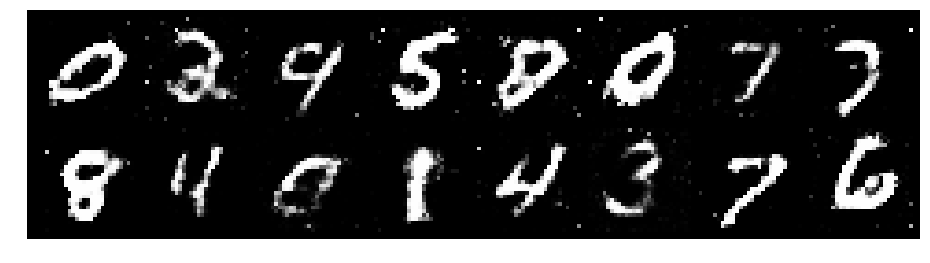

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9099
D(x): 0.5405, D(G(z)): 0.4141


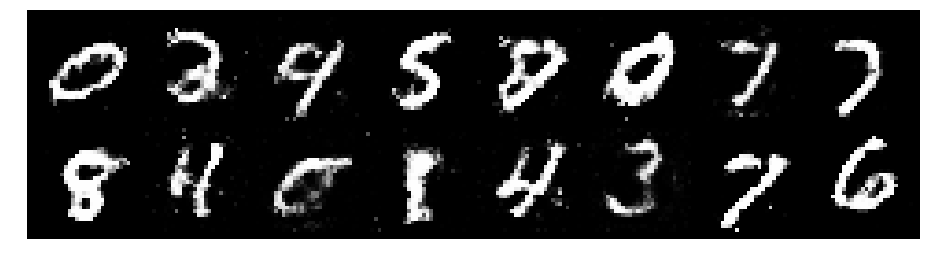

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1806, Generator Loss: 0.9883
D(x): 0.5923, D(G(z)): 0.4250


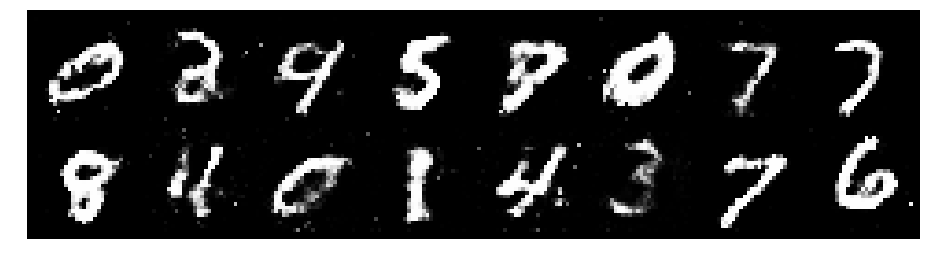

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2516, Generator Loss: 0.9104
D(x): 0.5680, D(G(z)): 0.4634


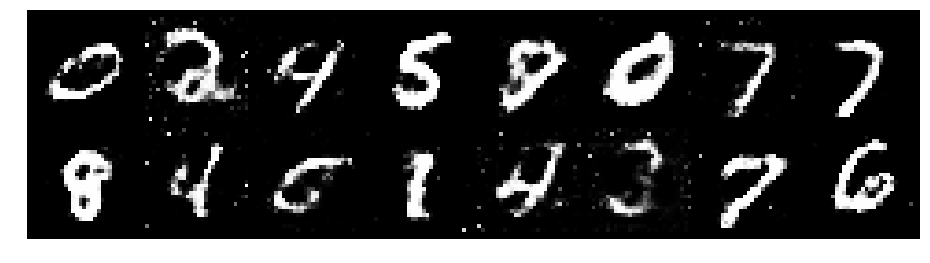

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2736, Generator Loss: 0.9266
D(x): 0.5577, D(G(z)): 0.4448


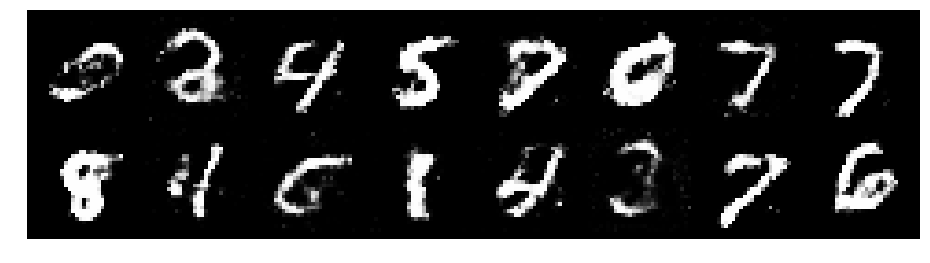

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8502
D(x): 0.5239, D(G(z)): 0.4215


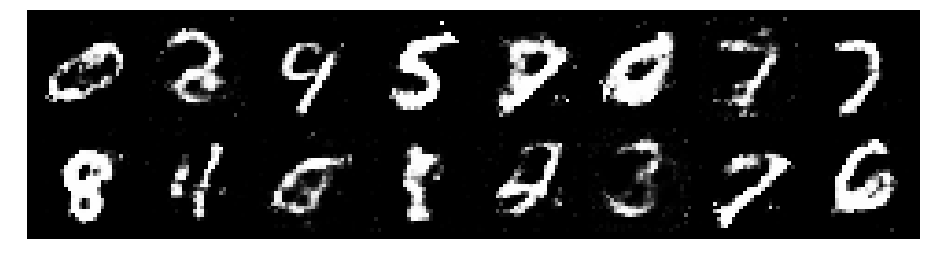

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.3724, Generator Loss: 0.8072
D(x): 0.5175, D(G(z)): 0.4762


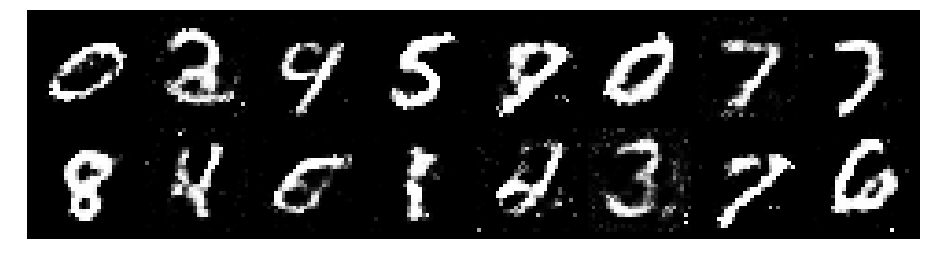

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.3215, Generator Loss: 0.9441
D(x): 0.5169, D(G(z)): 0.4387


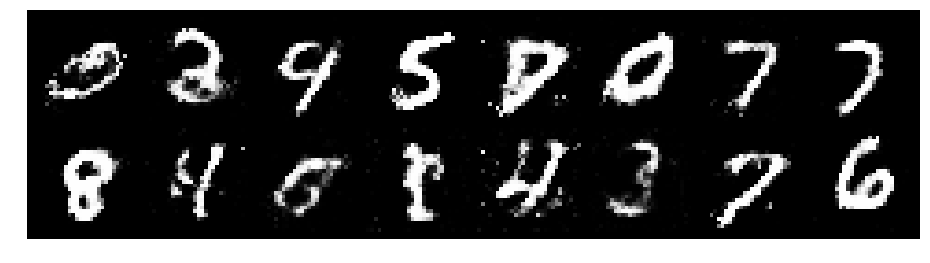

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2125, Generator Loss: 0.9544
D(x): 0.5536, D(G(z)): 0.4151


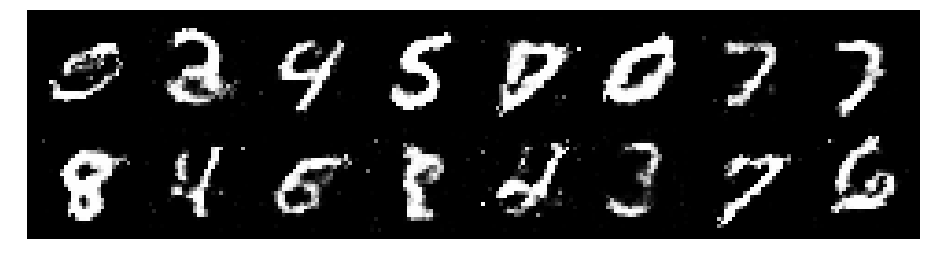

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9255
D(x): 0.5831, D(G(z)): 0.4496


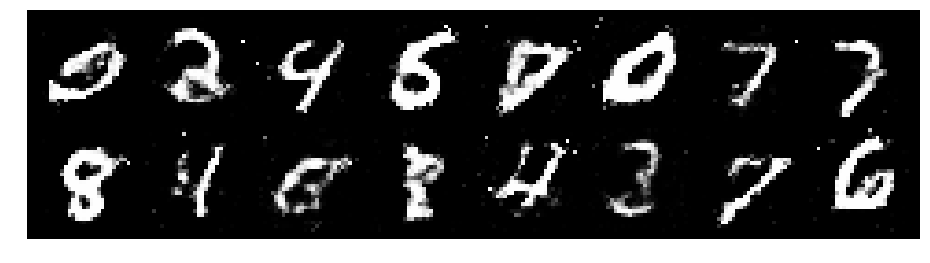

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2827, Generator Loss: 0.9512
D(x): 0.5815, D(G(z)): 0.4713


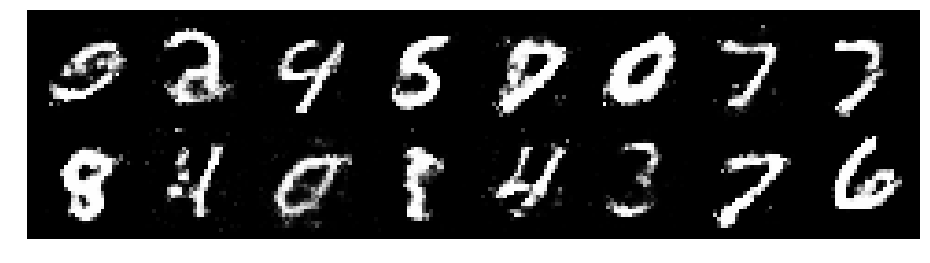

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2402, Generator Loss: 0.8969
D(x): 0.5807, D(G(z)): 0.4526


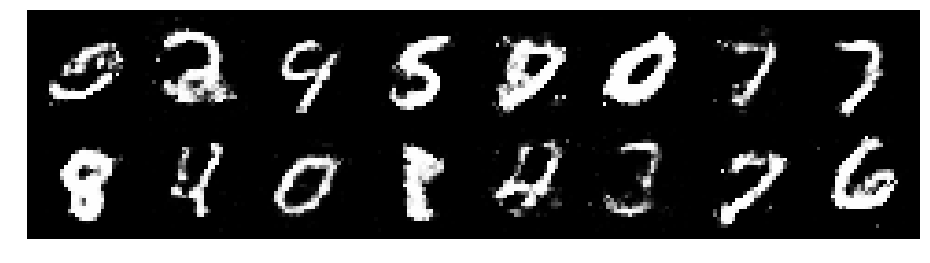

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1860, Generator Loss: 0.9126
D(x): 0.5594, D(G(z)): 0.4232


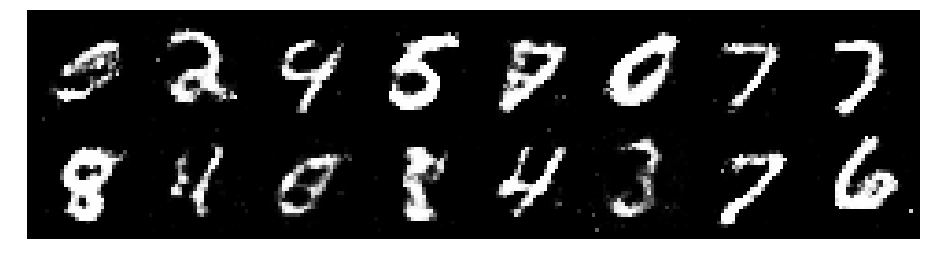

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8301
D(x): 0.5294, D(G(z)): 0.4327


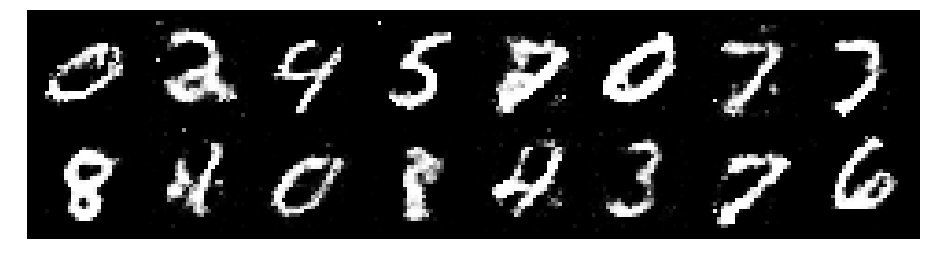

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2403, Generator Loss: 0.8367
D(x): 0.5453, D(G(z)): 0.4386


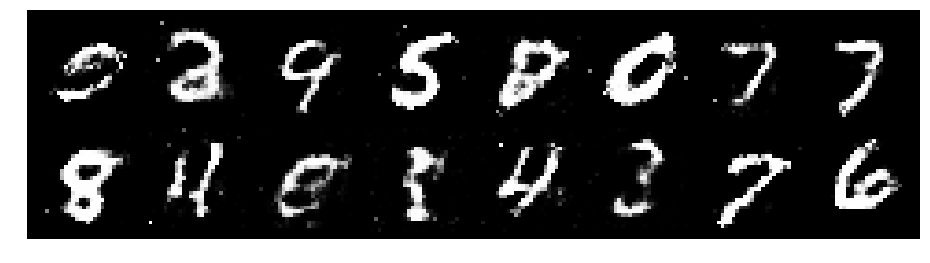

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9793
D(x): 0.5425, D(G(z)): 0.4417


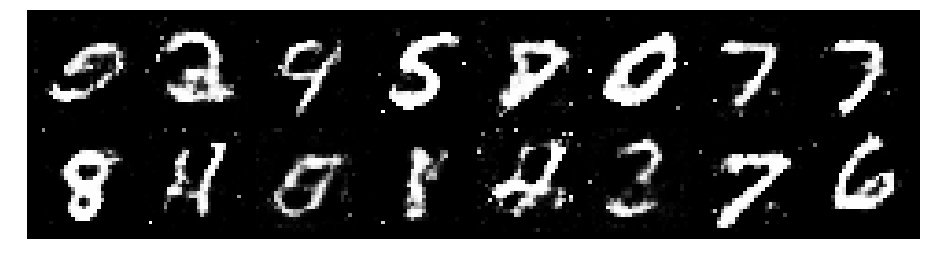

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.3110, Generator Loss: 0.8327
D(x): 0.5652, D(G(z)): 0.4775


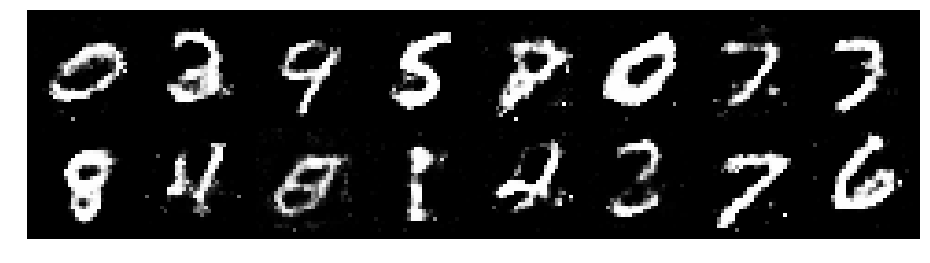

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.1989, Generator Loss: 0.9360
D(x): 0.6412, D(G(z)): 0.4733


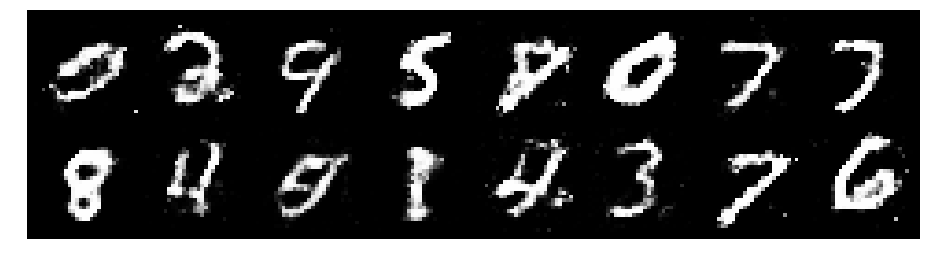

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.1789, Generator Loss: 0.8866
D(x): 0.5689, D(G(z)): 0.4196


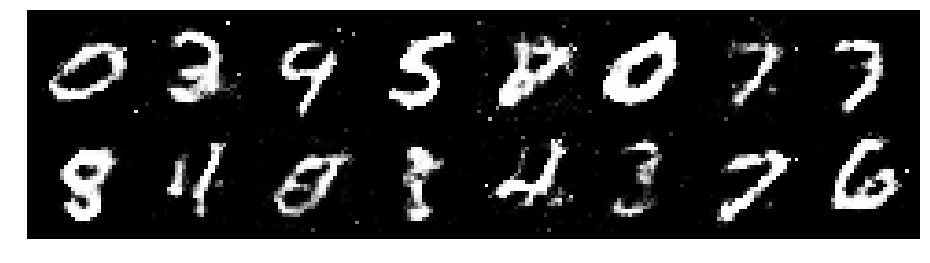

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.3157, Generator Loss: 0.8693
D(x): 0.5313, D(G(z)): 0.4438


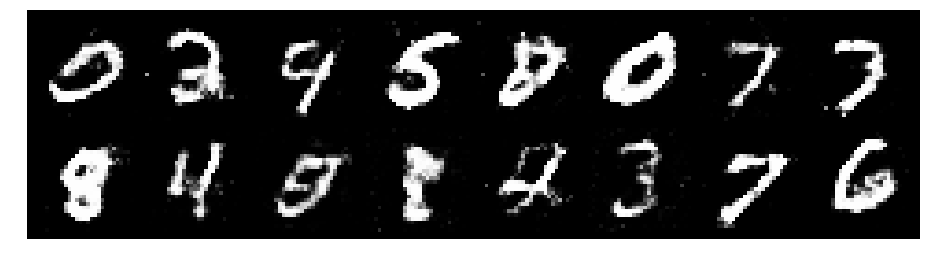

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8893
D(x): 0.5762, D(G(z)): 0.4819


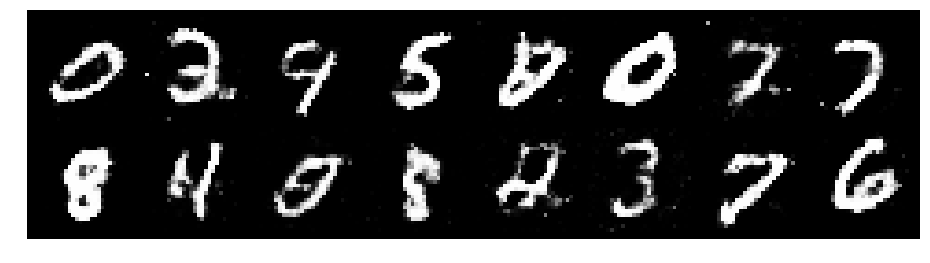

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3905, Generator Loss: 0.9036
D(x): 0.5161, D(G(z)): 0.4507


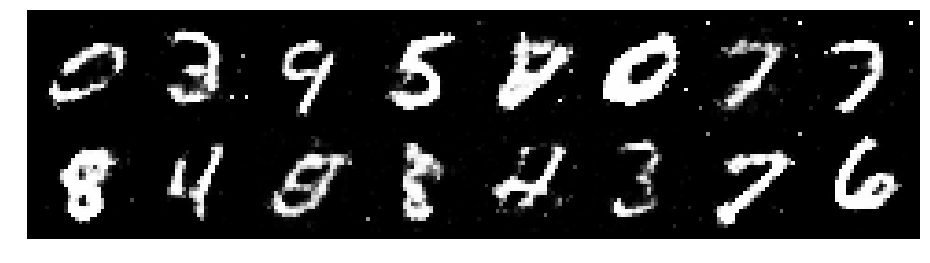

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.3410, Generator Loss: 0.9635
D(x): 0.4904, D(G(z)): 0.4160


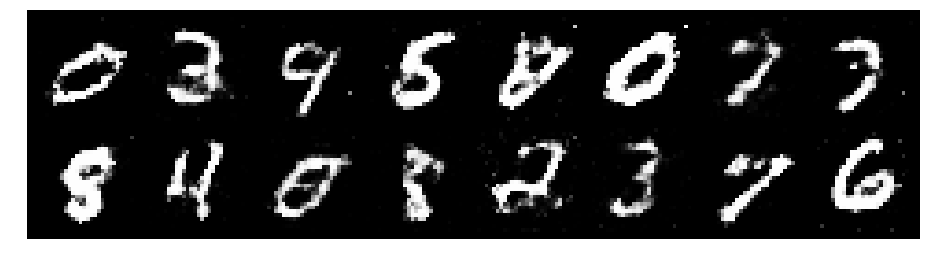

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.3131, Generator Loss: 1.0244
D(x): 0.5577, D(G(z)): 0.4560


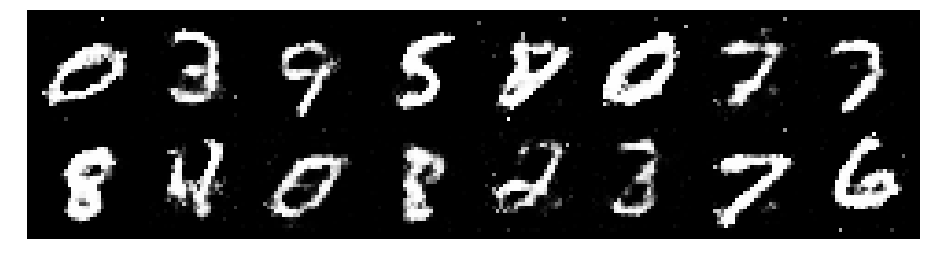

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.1876, Generator Loss: 1.0423
D(x): 0.5988, D(G(z)): 0.4335


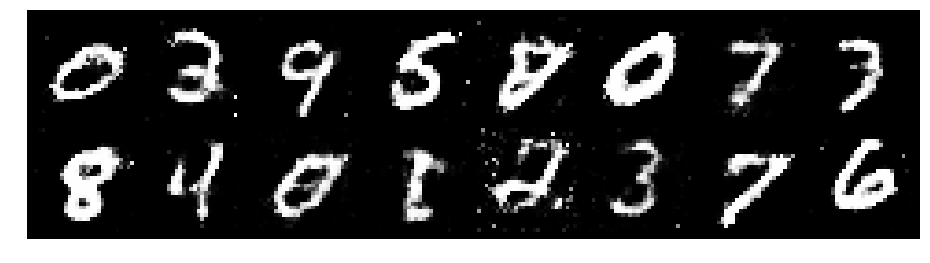

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.1267, Generator Loss: 1.1902
D(x): 0.6171, D(G(z)): 0.3969


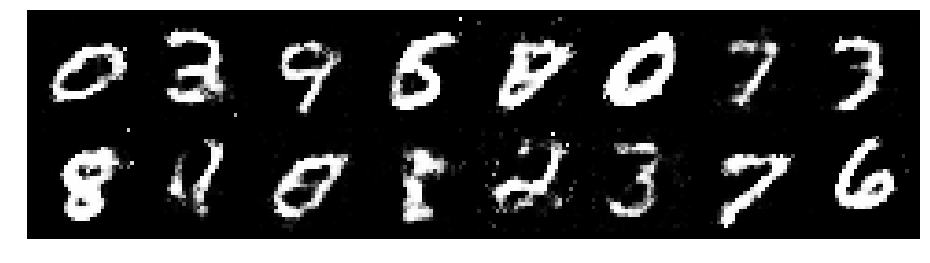

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3786, Generator Loss: 1.0869
D(x): 0.5422, D(G(z)): 0.4320


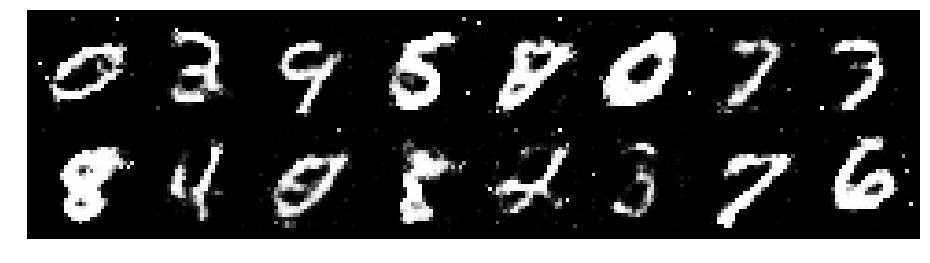

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.3142, Generator Loss: 0.7822
D(x): 0.5810, D(G(z)): 0.4809


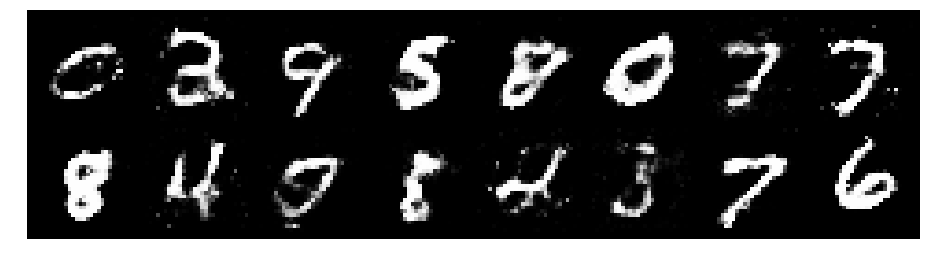

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8608
D(x): 0.5871, D(G(z)): 0.4290


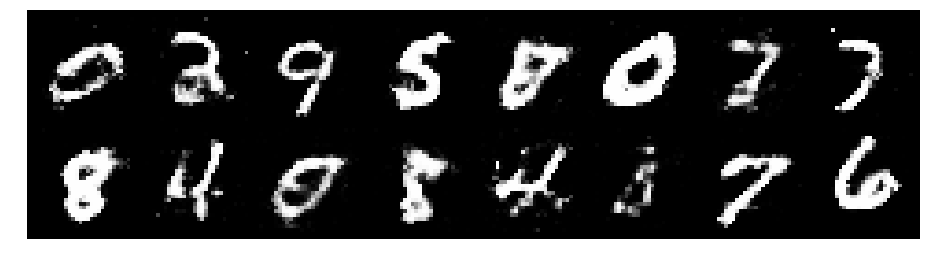

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8535
D(x): 0.5760, D(G(z)): 0.4666


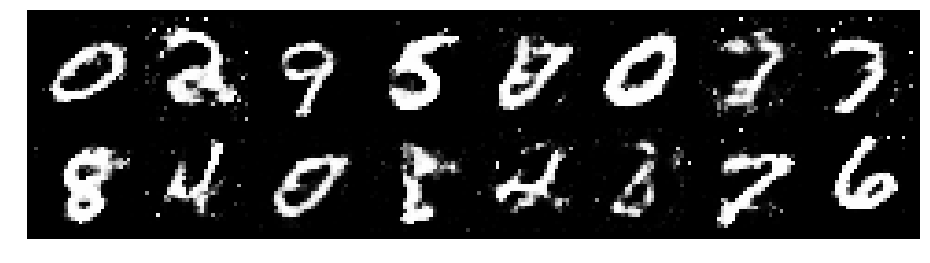

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2101, Generator Loss: 0.9572
D(x): 0.5692, D(G(z)): 0.4342


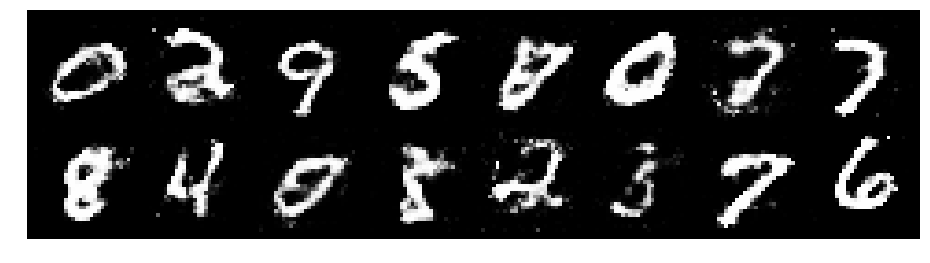

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2603, Generator Loss: 0.7680
D(x): 0.5788, D(G(z)): 0.4628


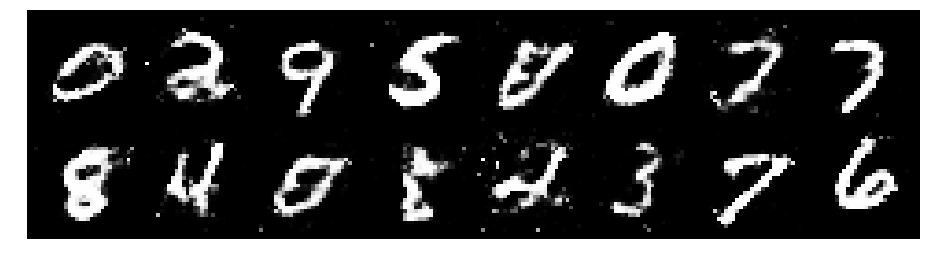

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2513, Generator Loss: 1.0647
D(x): 0.5771, D(G(z)): 0.4262


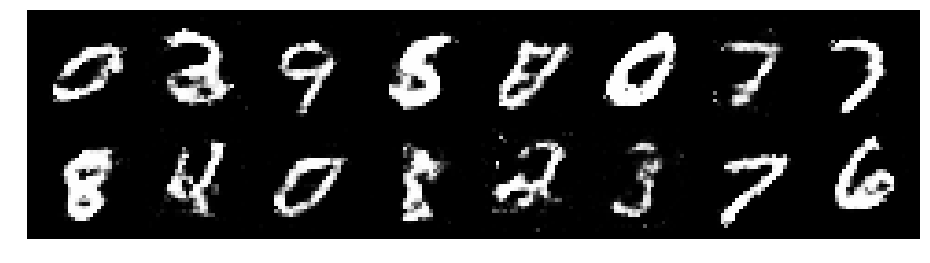

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2397, Generator Loss: 0.9530
D(x): 0.5939, D(G(z)): 0.4627


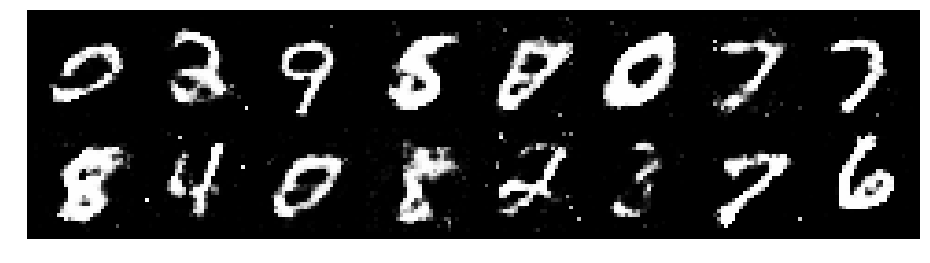

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.1533, Generator Loss: 1.1418
D(x): 0.5765, D(G(z)): 0.3720


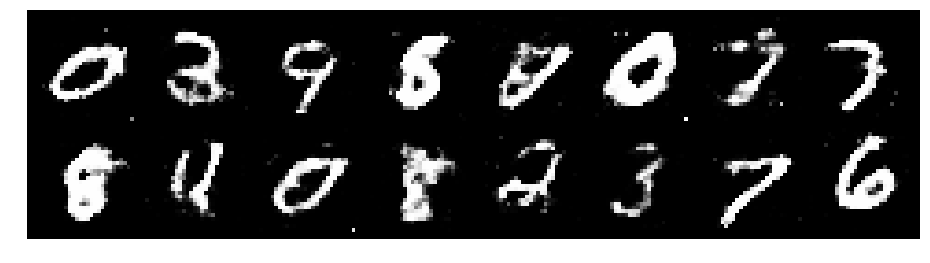

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2766, Generator Loss: 0.9903
D(x): 0.5807, D(G(z)): 0.4437


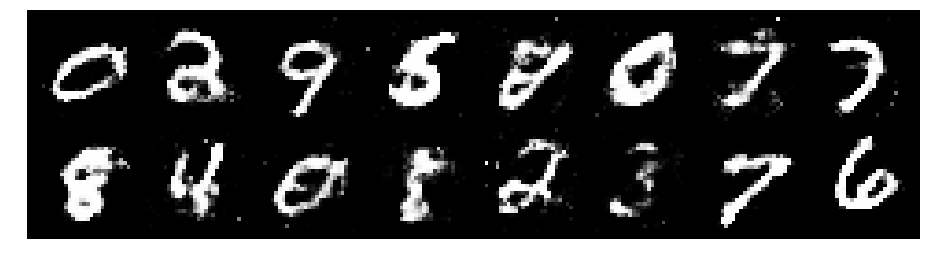

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.3032, Generator Loss: 0.8662
D(x): 0.5211, D(G(z)): 0.4244


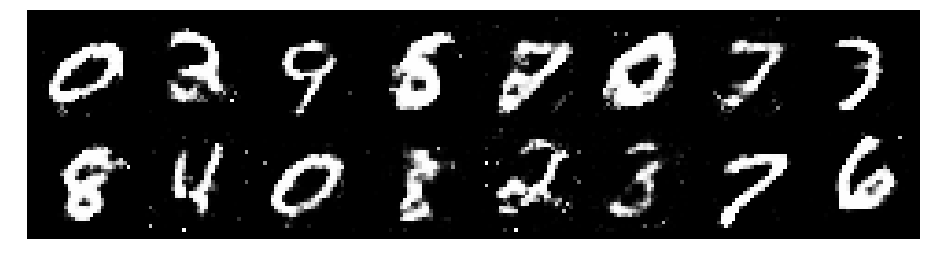

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9455
D(x): 0.5391, D(G(z)): 0.4092


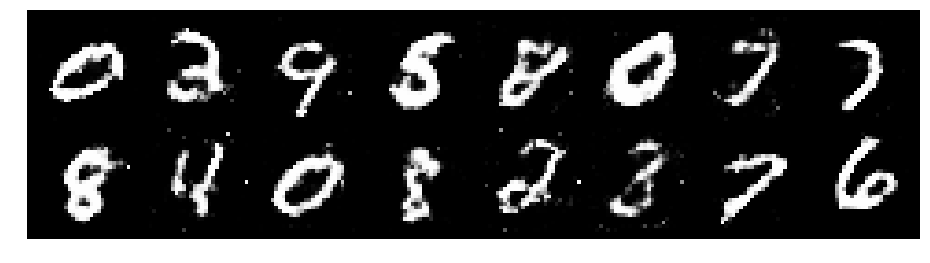

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2887, Generator Loss: 0.9167
D(x): 0.5746, D(G(z)): 0.4416


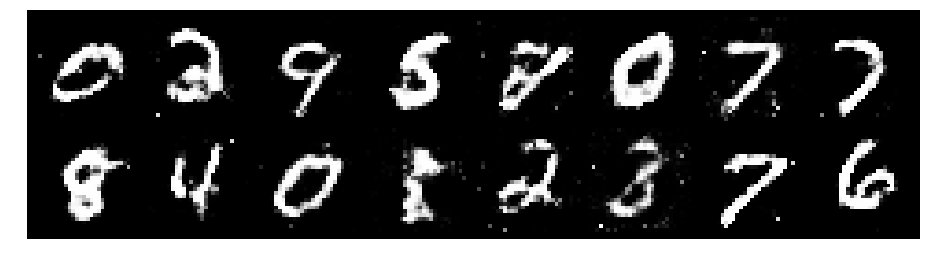

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.3131, Generator Loss: 0.9407
D(x): 0.5947, D(G(z)): 0.4630


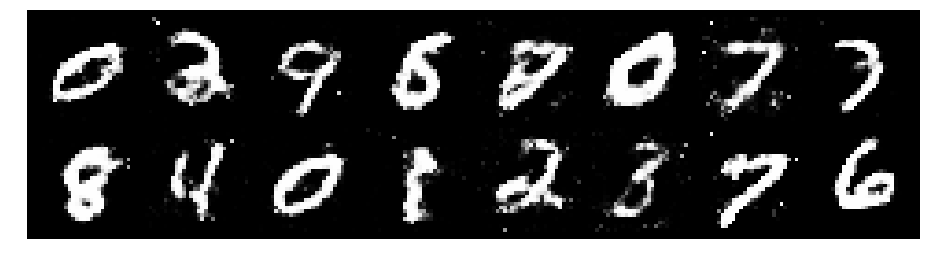

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8200
D(x): 0.5635, D(G(z)): 0.4576


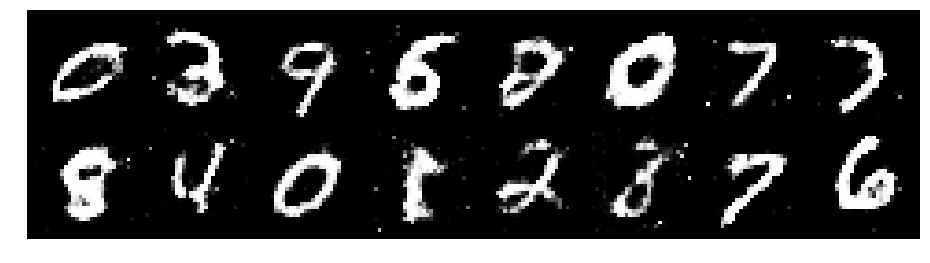

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.3548, Generator Loss: 0.9301
D(x): 0.5330, D(G(z)): 0.4436


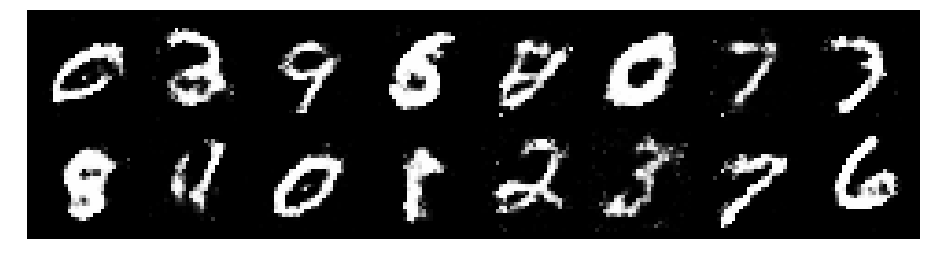

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2465, Generator Loss: 0.9929
D(x): 0.5612, D(G(z)): 0.4341


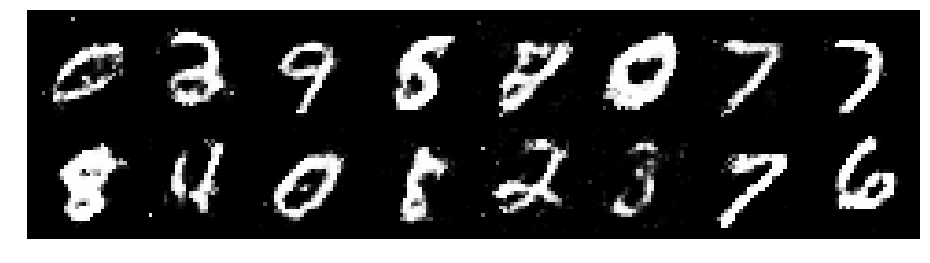

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.3447, Generator Loss: 0.8755
D(x): 0.5797, D(G(z)): 0.4879


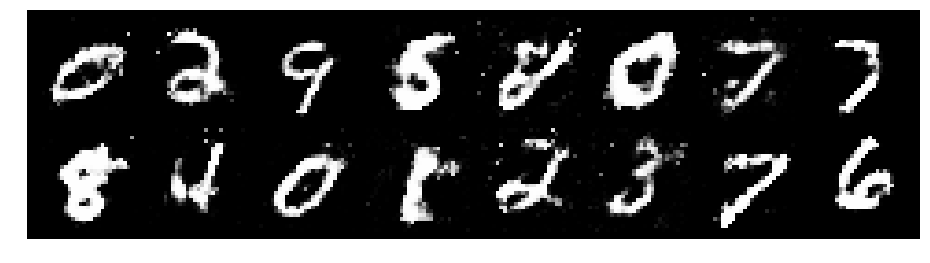

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2314, Generator Loss: 0.8453
D(x): 0.6143, D(G(z)): 0.4588


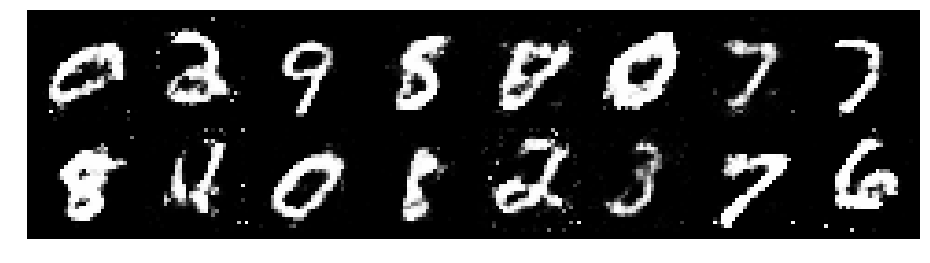

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.1983, Generator Loss: 0.9317
D(x): 0.5941, D(G(z)): 0.4386


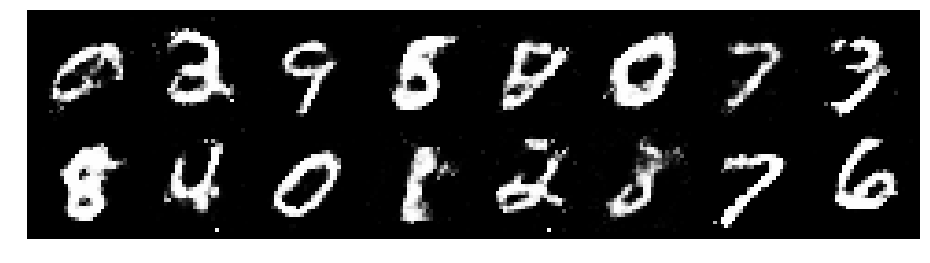

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2034, Generator Loss: 0.9671
D(x): 0.5854, D(G(z)): 0.4174


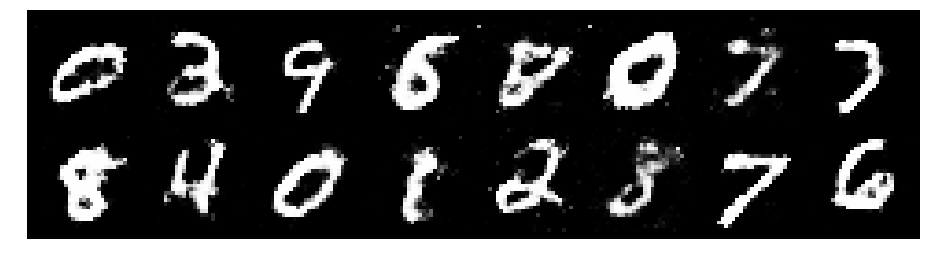

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8758
D(x): 0.5711, D(G(z)): 0.4633


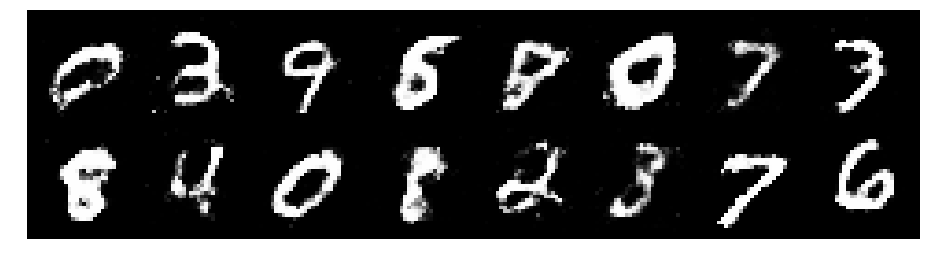

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3161, Generator Loss: 1.0281
D(x): 0.5395, D(G(z)): 0.4469


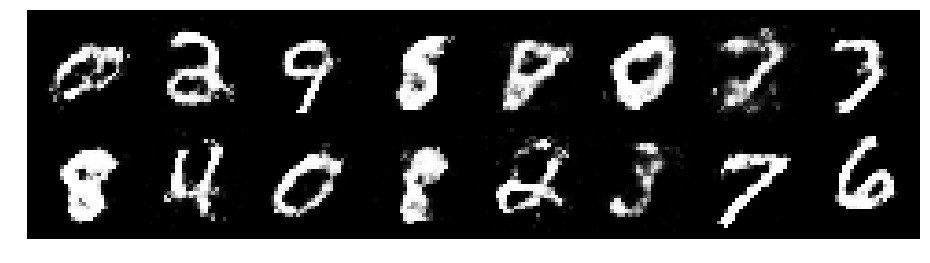

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8265
D(x): 0.5709, D(G(z)): 0.4583


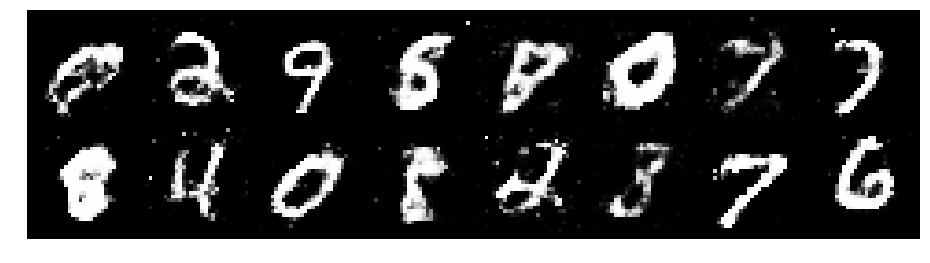

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1087, Generator Loss: 1.0235
D(x): 0.6187, D(G(z)): 0.4120


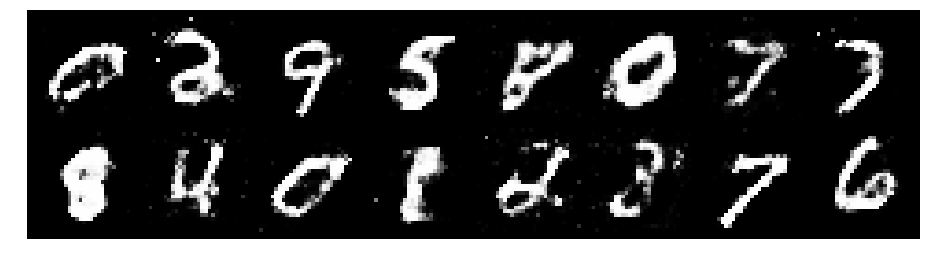

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3528, Generator Loss: 1.0341
D(x): 0.5609, D(G(z)): 0.4265


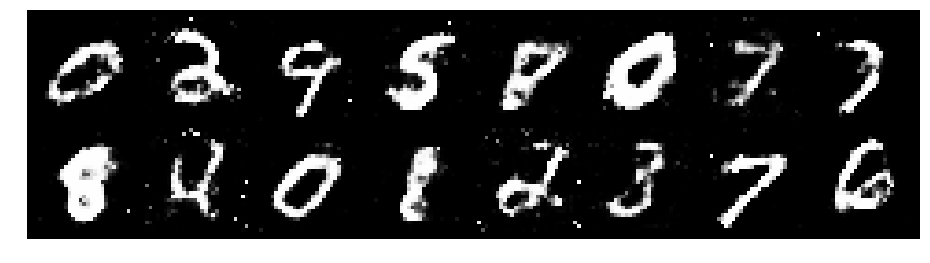

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1184, Generator Loss: 1.0456
D(x): 0.5910, D(G(z)): 0.3666


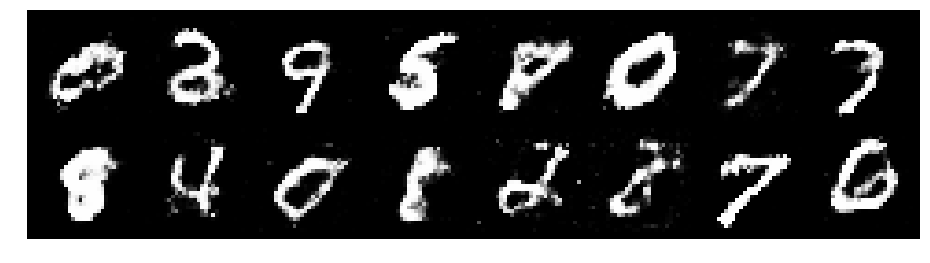

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2409, Generator Loss: 1.0068
D(x): 0.5426, D(G(z)): 0.4160


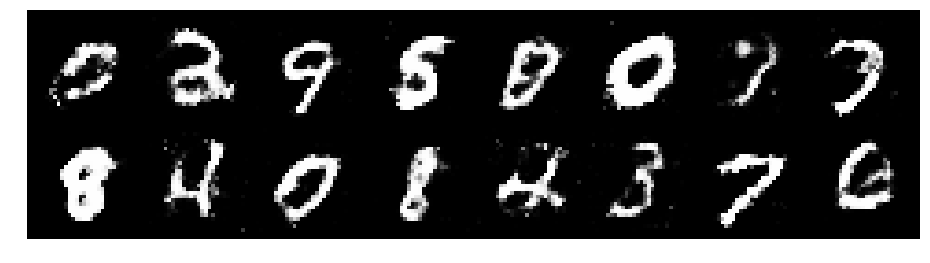

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.3076, Generator Loss: 0.9435
D(x): 0.5318, D(G(z)): 0.4389


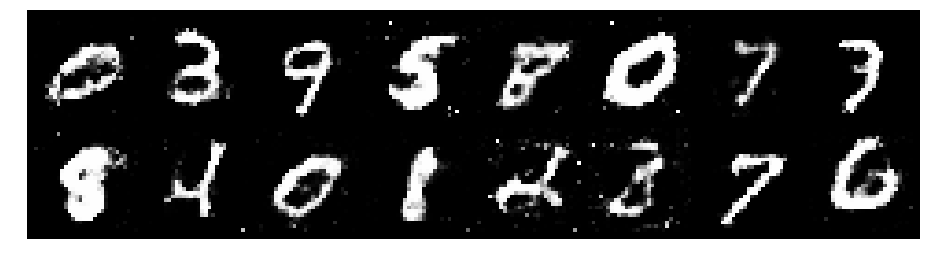

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2614, Generator Loss: 0.9002
D(x): 0.5331, D(G(z)): 0.4135


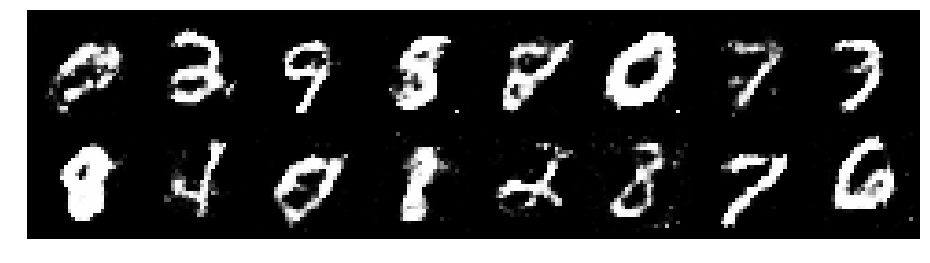

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.1147, Generator Loss: 0.9519
D(x): 0.6090, D(G(z)): 0.4181


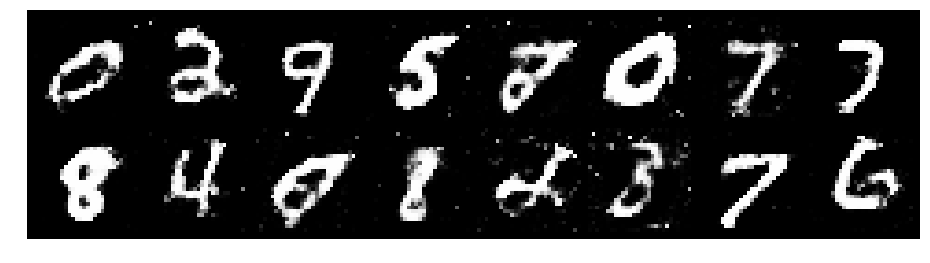

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1701, Generator Loss: 0.9305
D(x): 0.5675, D(G(z)): 0.4163


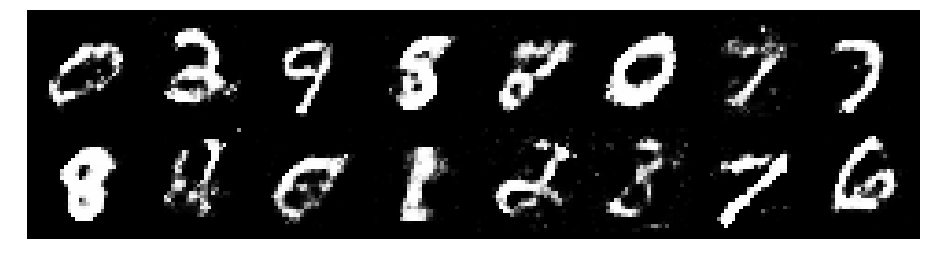

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1288, Generator Loss: 1.0595
D(x): 0.5657, D(G(z)): 0.3614


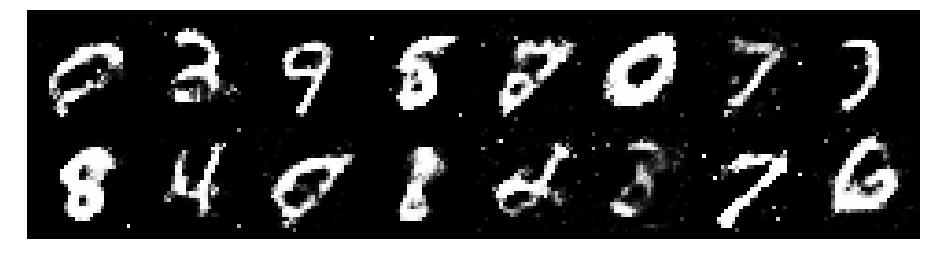

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.1677, Generator Loss: 1.0291
D(x): 0.5994, D(G(z)): 0.4159


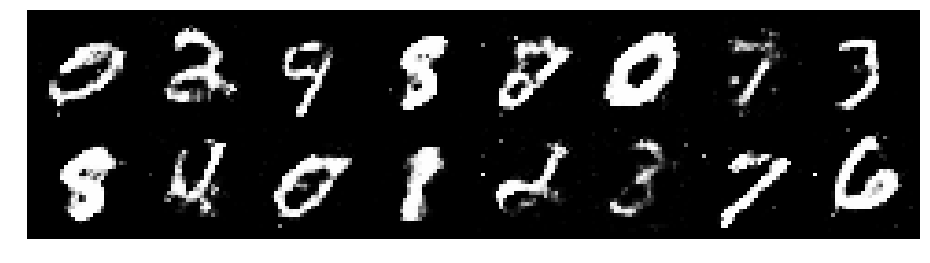

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2753, Generator Loss: 0.9360
D(x): 0.6190, D(G(z)): 0.4684


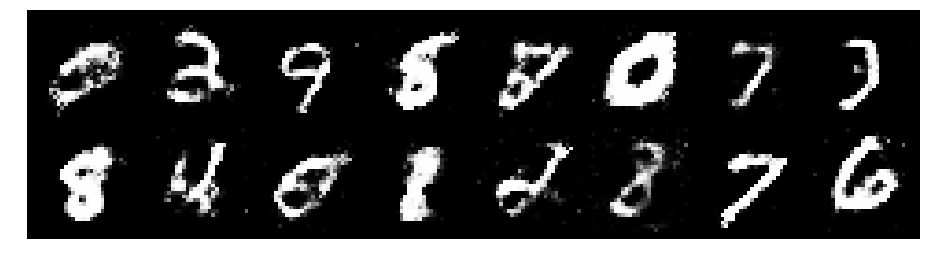

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2475, Generator Loss: 0.9750
D(x): 0.5410, D(G(z)): 0.4119


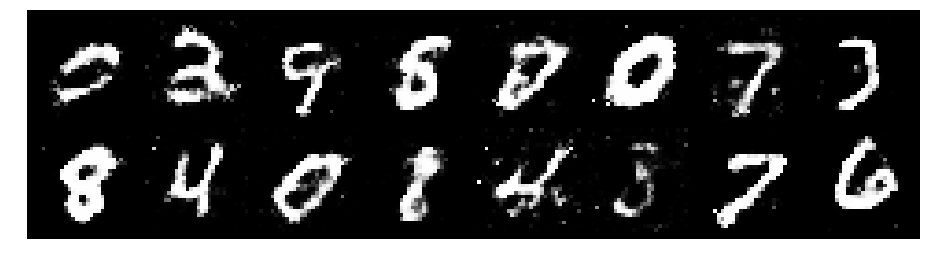

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1714, Generator Loss: 0.9551
D(x): 0.5637, D(G(z)): 0.4158


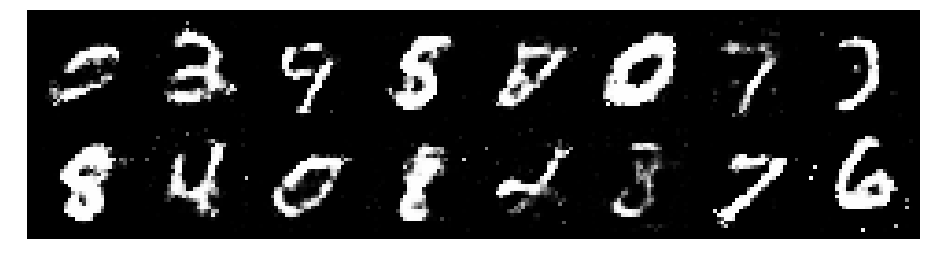

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1834, Generator Loss: 0.9755
D(x): 0.5544, D(G(z)): 0.3969


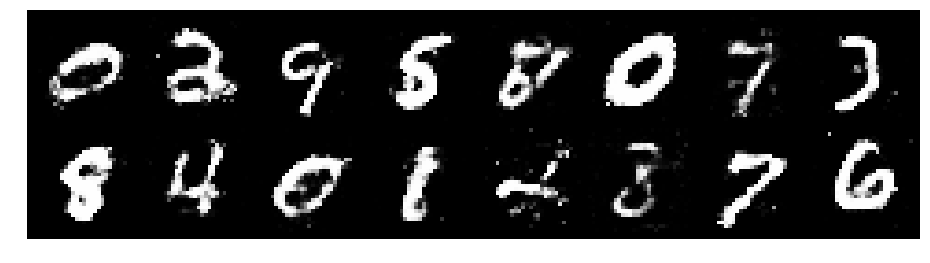

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.1451, Generator Loss: 0.9617
D(x): 0.5679, D(G(z)): 0.3924


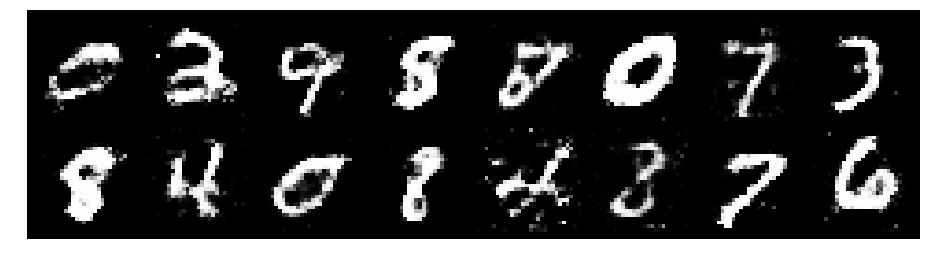

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.4241, Generator Loss: 0.8819
D(x): 0.5535, D(G(z)): 0.4994


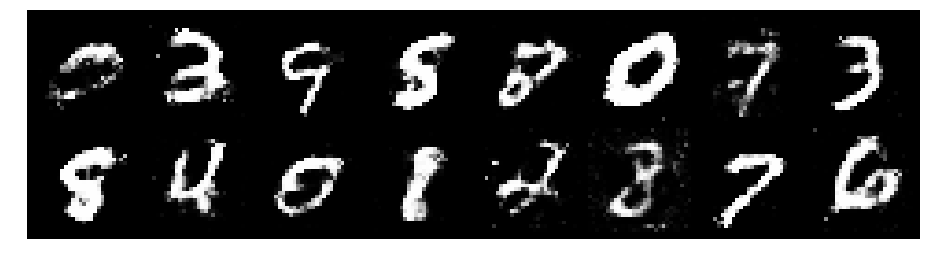

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2988, Generator Loss: 0.8544
D(x): 0.5765, D(G(z)): 0.4808


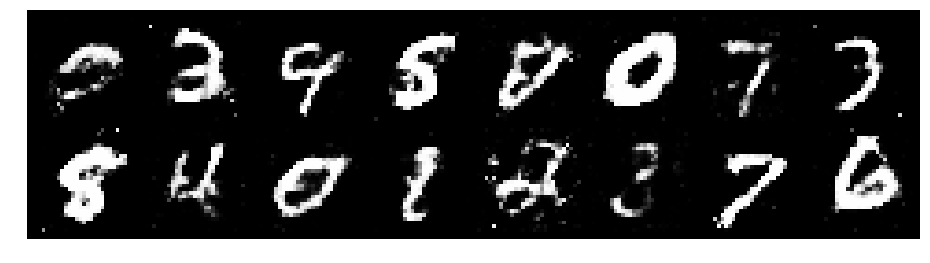

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2752, Generator Loss: 0.9425
D(x): 0.5707, D(G(z)): 0.4640


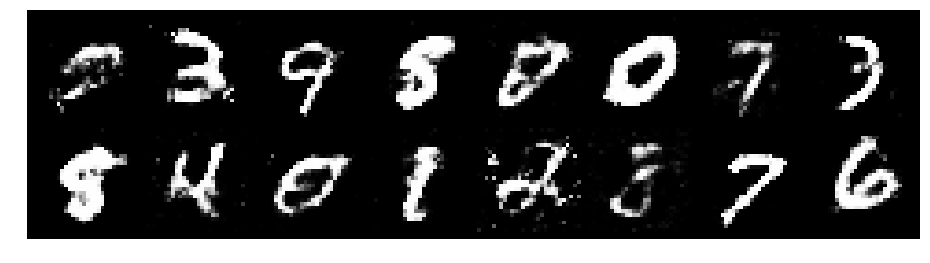

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1977, Generator Loss: 0.8741
D(x): 0.6030, D(G(z)): 0.4503


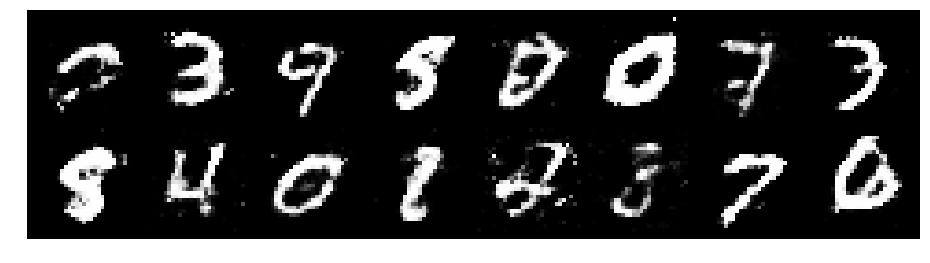

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3305, Generator Loss: 0.7673
D(x): 0.5697, D(G(z)): 0.4878


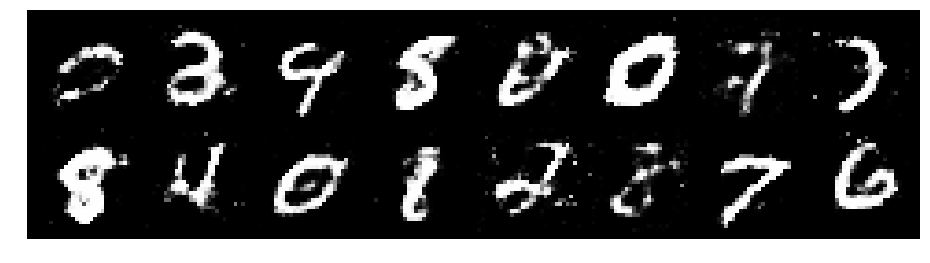

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.1571, Generator Loss: 0.9485
D(x): 0.6033, D(G(z)): 0.4071


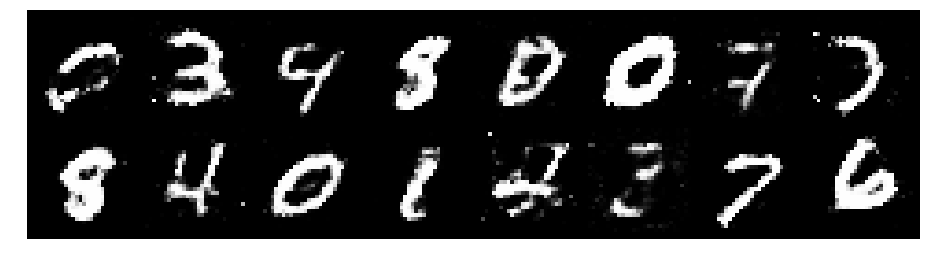

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9900
D(x): 0.5932, D(G(z)): 0.4297


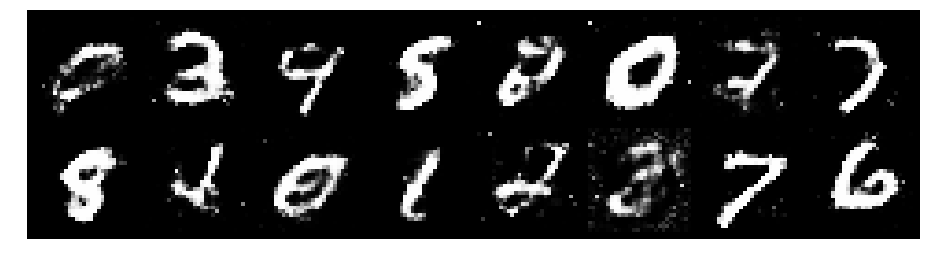

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2624, Generator Loss: 0.8202
D(x): 0.5556, D(G(z)): 0.4415


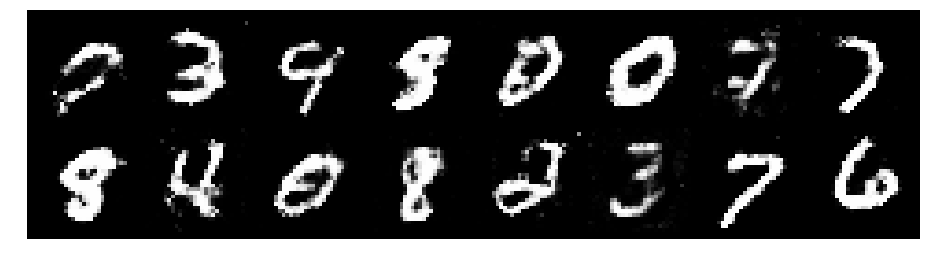

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8386
D(x): 0.5255, D(G(z)): 0.4247


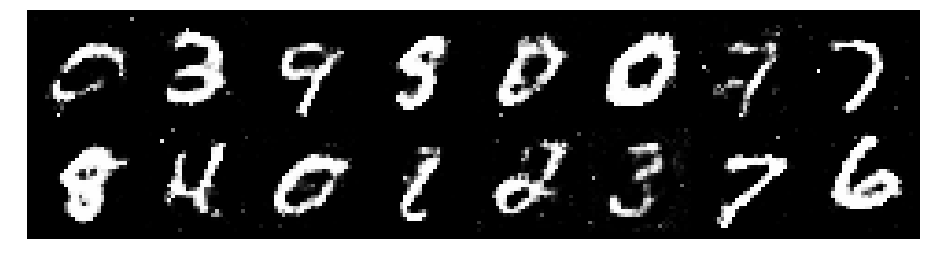

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1399, Generator Loss: 0.9636
D(x): 0.6190, D(G(z)): 0.4390


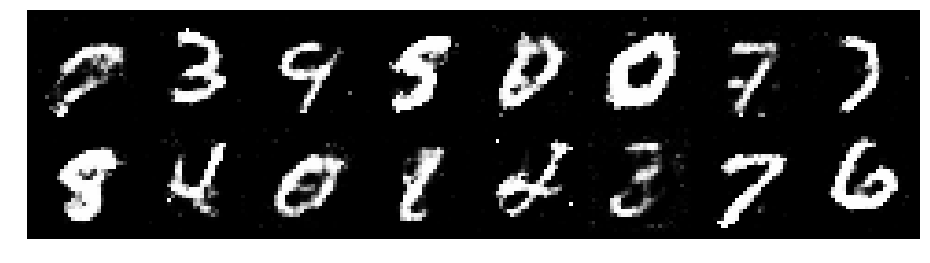

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.1460, Generator Loss: 1.0514
D(x): 0.5831, D(G(z)): 0.3914


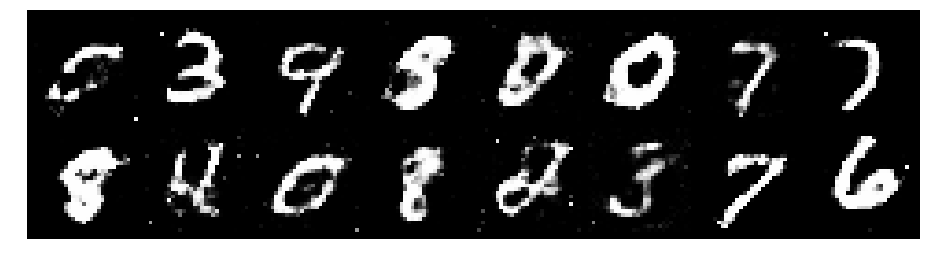

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2012, Generator Loss: 0.9870
D(x): 0.5973, D(G(z)): 0.4379


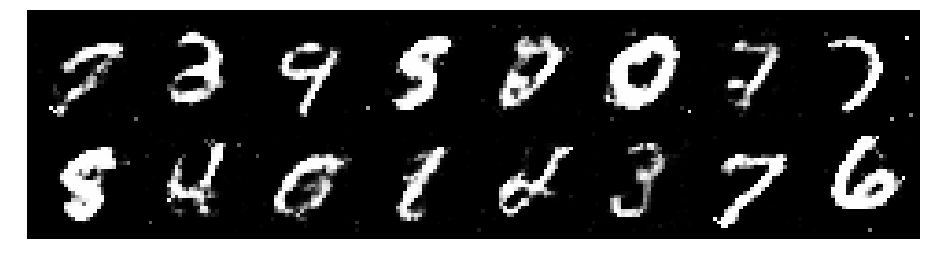

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2246, Generator Loss: 1.0336
D(x): 0.5857, D(G(z)): 0.4401


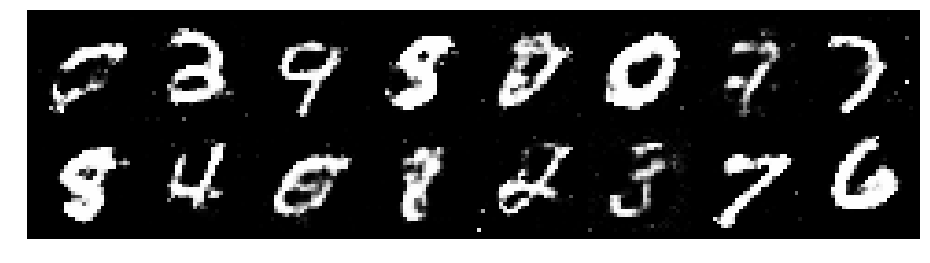

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2614, Generator Loss: 1.0504
D(x): 0.5909, D(G(z)): 0.4376


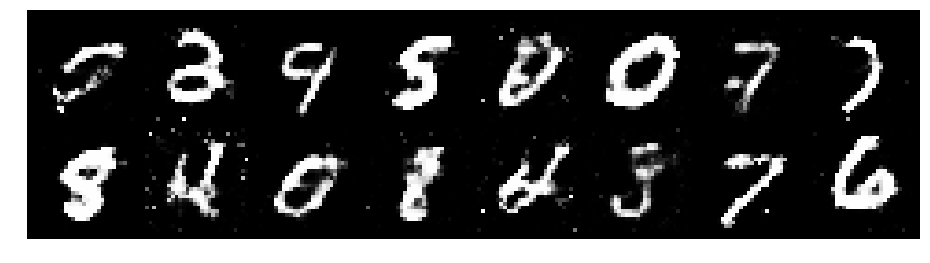

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2960, Generator Loss: 0.9718
D(x): 0.5916, D(G(z)): 0.4735


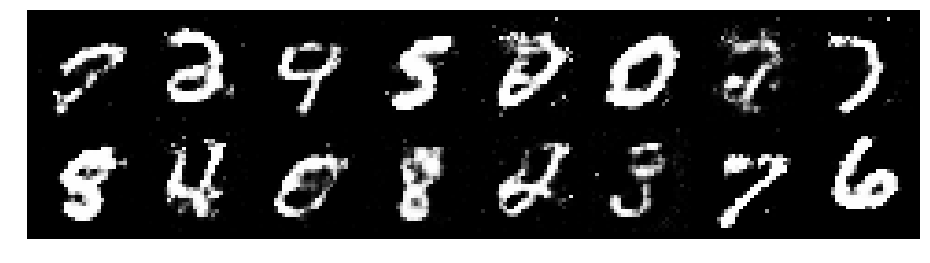

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.1354, Generator Loss: 1.1204
D(x): 0.6067, D(G(z)): 0.3982


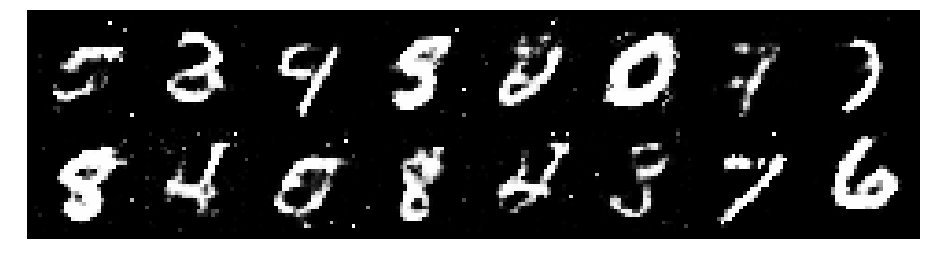

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.0942, Generator Loss: 1.1029
D(x): 0.6463, D(G(z)): 0.3997


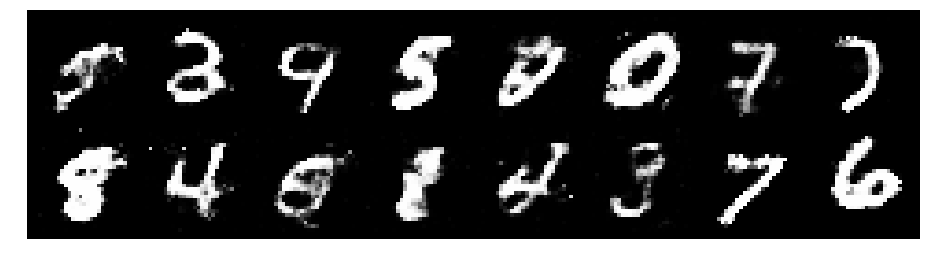

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1633, Generator Loss: 0.9776
D(x): 0.5808, D(G(z)): 0.4048


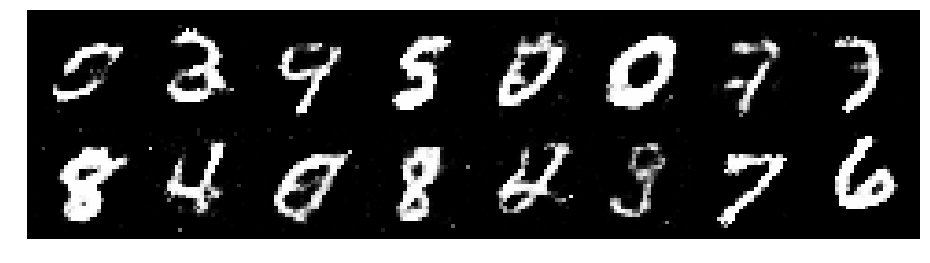

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3053, Generator Loss: 0.9817
D(x): 0.5664, D(G(z)): 0.4486


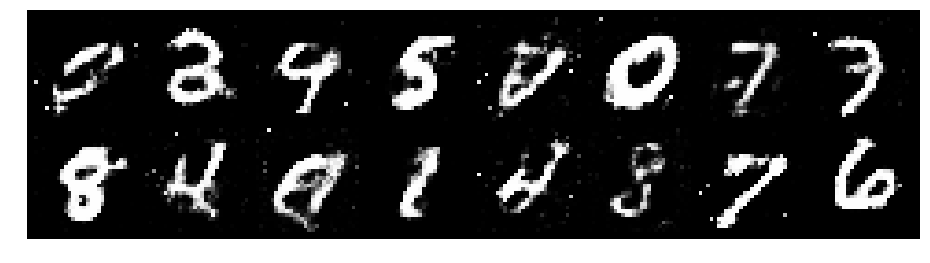

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.1651, Generator Loss: 0.9211
D(x): 0.5764, D(G(z)): 0.4179


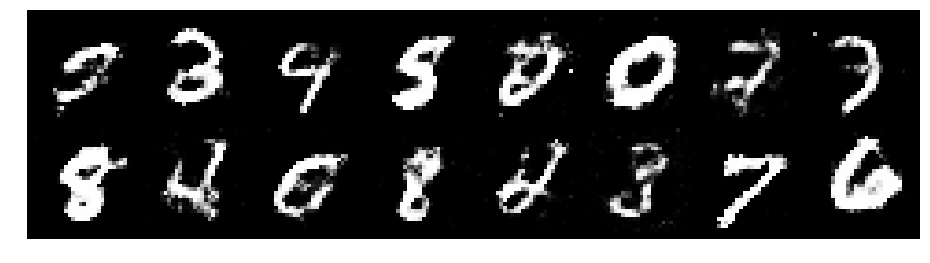

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2503, Generator Loss: 0.9489
D(x): 0.5474, D(G(z)): 0.4156


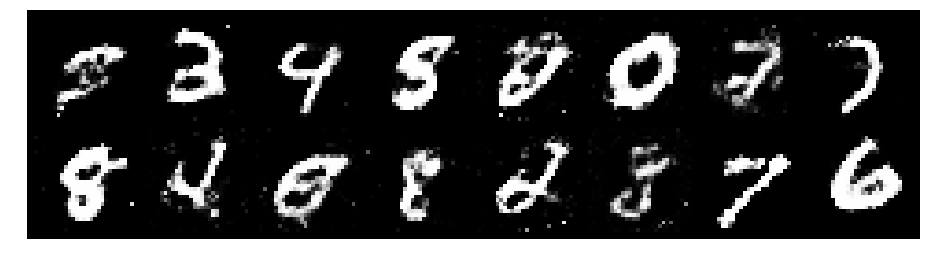

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1999, Generator Loss: 1.0753
D(x): 0.5488, D(G(z)): 0.3939


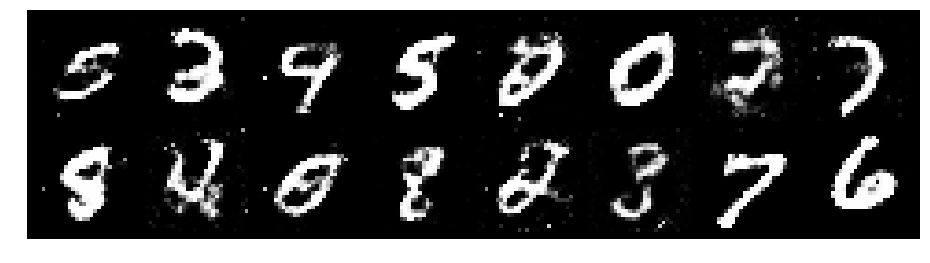

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2489, Generator Loss: 1.0544
D(x): 0.5724, D(G(z)): 0.4355


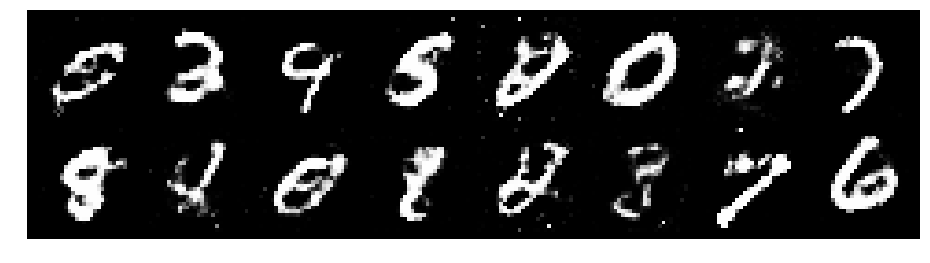

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2601, Generator Loss: 0.8995
D(x): 0.5457, D(G(z)): 0.4194


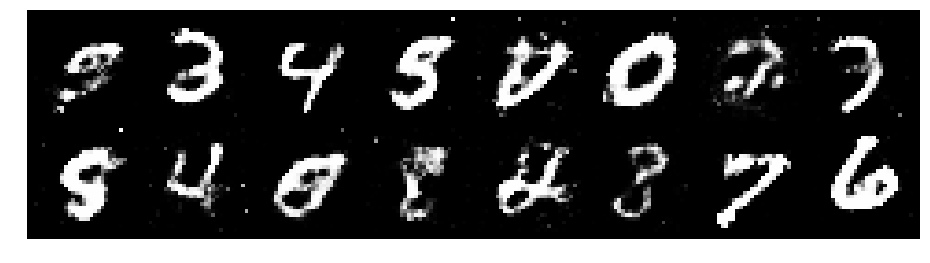

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.4043, Generator Loss: 0.8411
D(x): 0.5070, D(G(z)): 0.4483


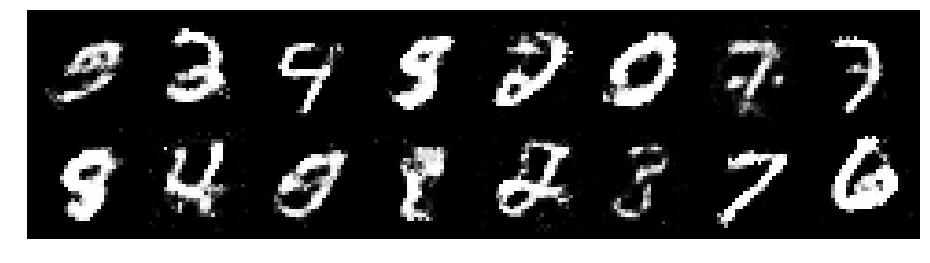

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.3429, Generator Loss: 0.7470
D(x): 0.5443, D(G(z)): 0.4869


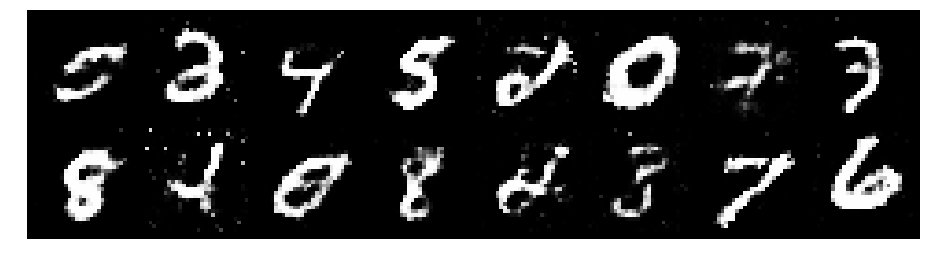

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2121, Generator Loss: 1.0853
D(x): 0.5412, D(G(z)): 0.3933


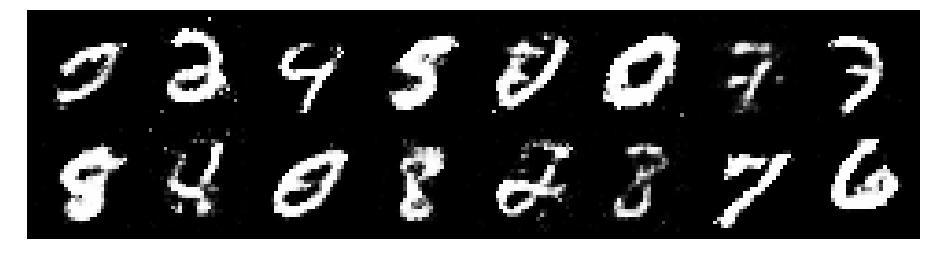

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.1919, Generator Loss: 1.1256
D(x): 0.5735, D(G(z)): 0.3906


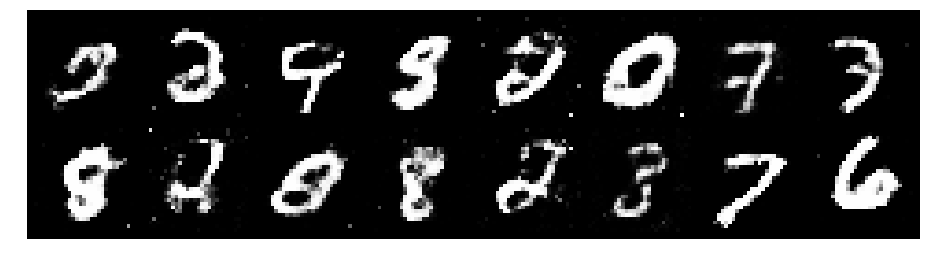

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2382, Generator Loss: 0.9547
D(x): 0.5873, D(G(z)): 0.4539


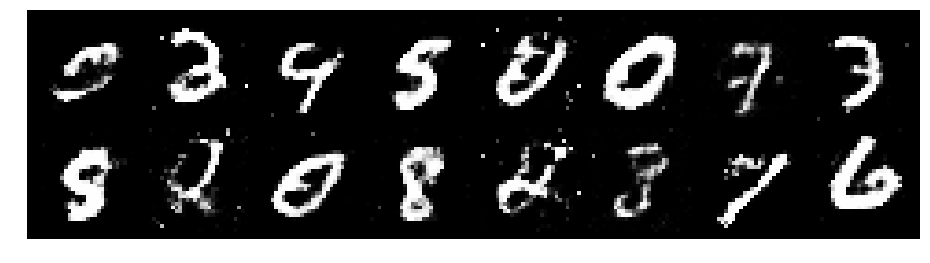

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.1686, Generator Loss: 0.8670
D(x): 0.6202, D(G(z)): 0.4415


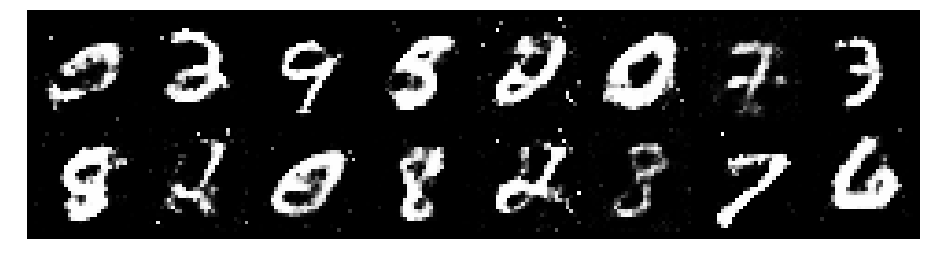

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.1994, Generator Loss: 0.9320
D(x): 0.5805, D(G(z)): 0.4011


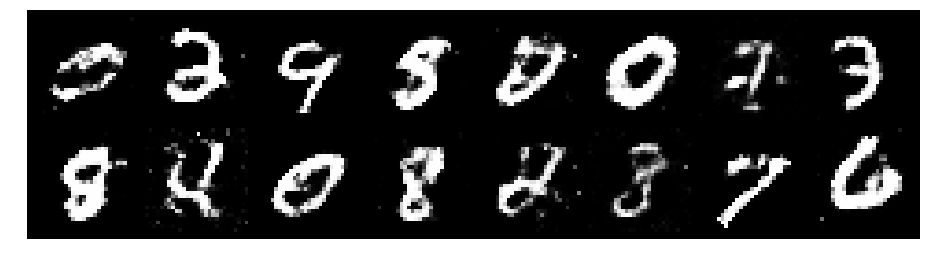

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2319, Generator Loss: 0.9520
D(x): 0.5725, D(G(z)): 0.4157


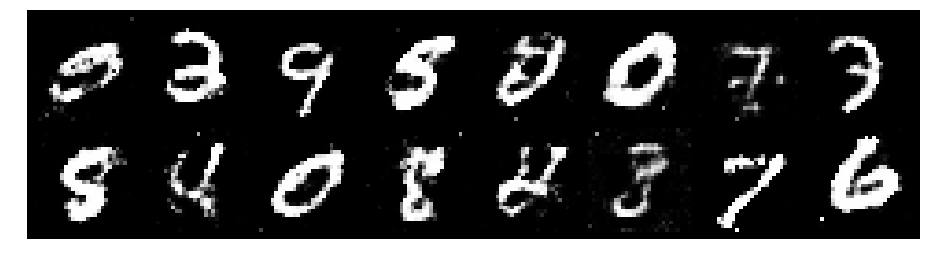

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1588, Generator Loss: 0.9342
D(x): 0.5691, D(G(z)): 0.3969


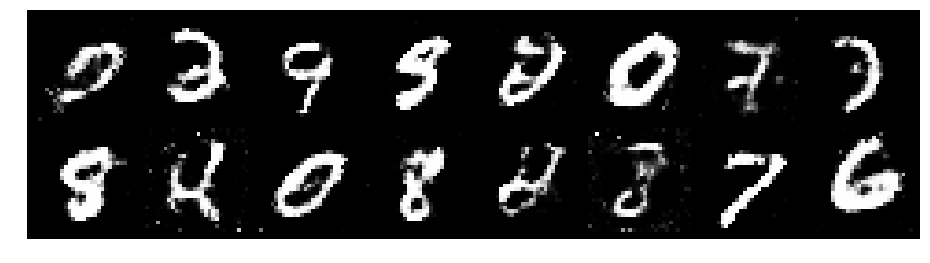

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2910, Generator Loss: 0.8178
D(x): 0.5852, D(G(z)): 0.4780


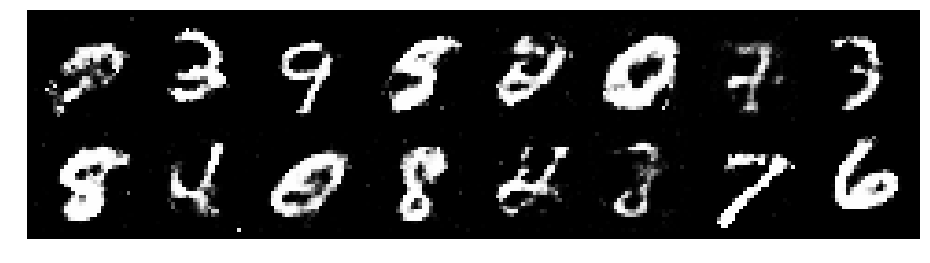

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2047, Generator Loss: 0.9085
D(x): 0.5731, D(G(z)): 0.4287


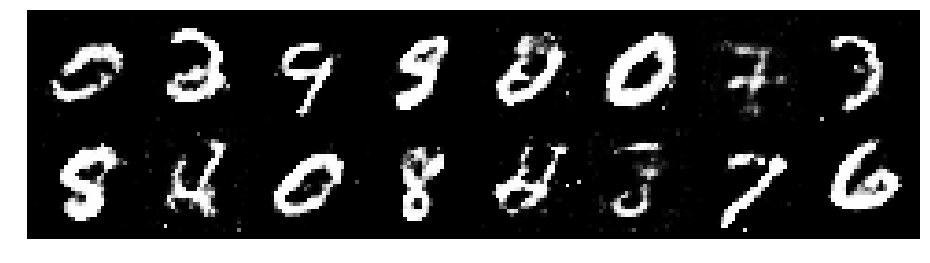

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1167, Generator Loss: 0.8508
D(x): 0.5921, D(G(z)): 0.4130


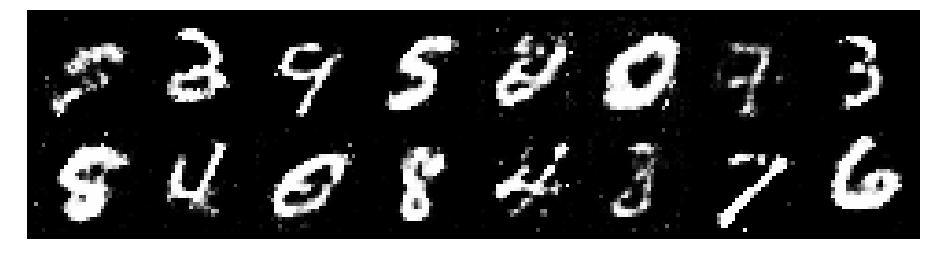

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2010, Generator Loss: 0.8602
D(x): 0.5542, D(G(z)): 0.4319


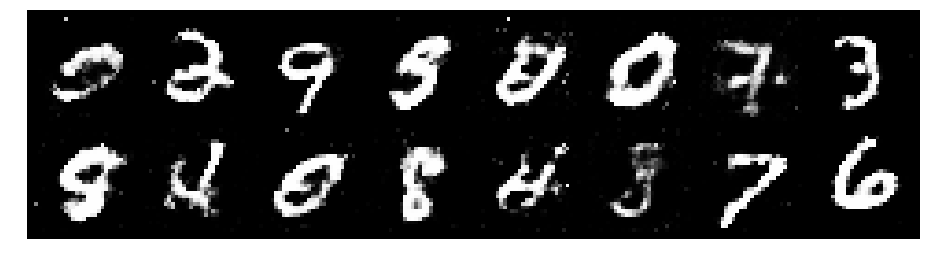

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.1707, Generator Loss: 1.1470
D(x): 0.5767, D(G(z)): 0.3764


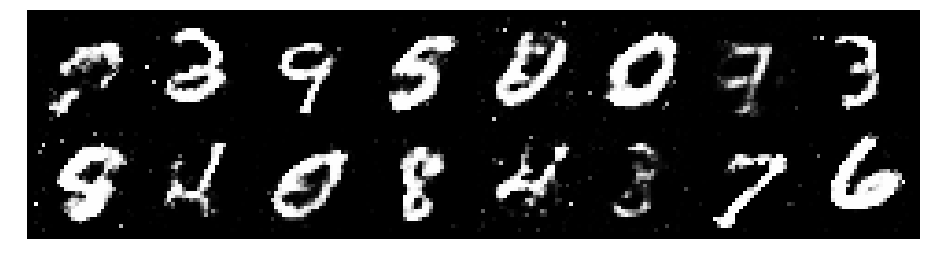

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2578, Generator Loss: 0.9298
D(x): 0.5727, D(G(z)): 0.4437


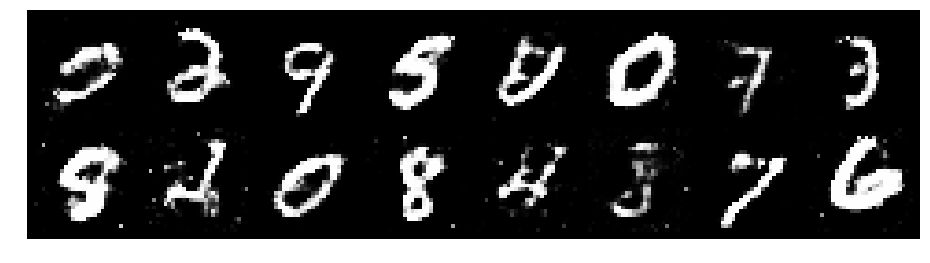

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9535
D(x): 0.5962, D(G(z)): 0.4400


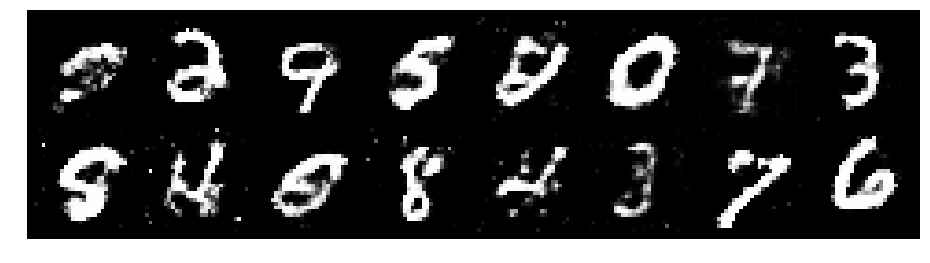

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2667, Generator Loss: 1.0187
D(x): 0.5646, D(G(z)): 0.4273


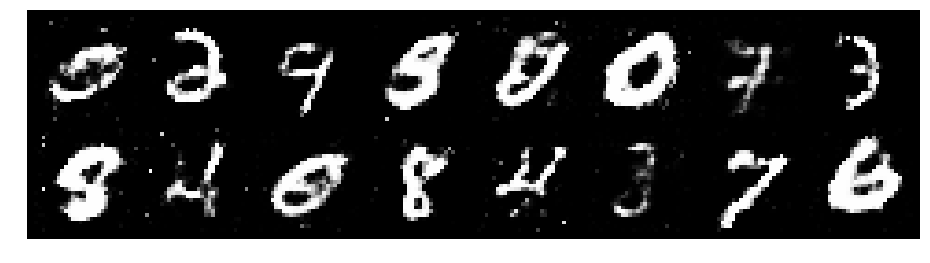

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.4339, Generator Loss: 0.8573
D(x): 0.5811, D(G(z)): 0.5063


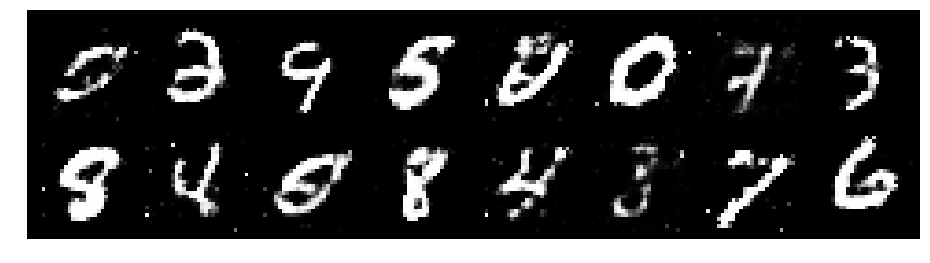

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2821, Generator Loss: 0.8452
D(x): 0.5580, D(G(z)): 0.4507


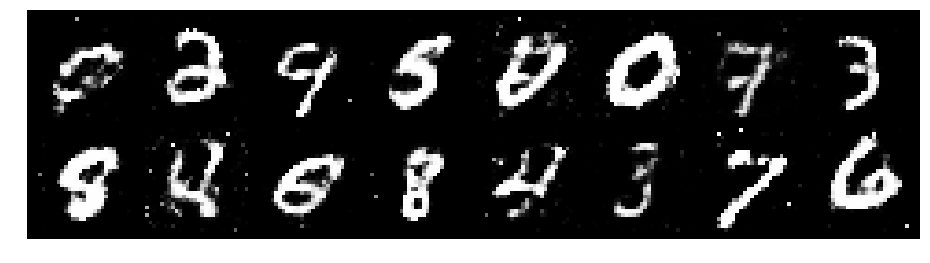

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9485
D(x): 0.5565, D(G(z)): 0.3884


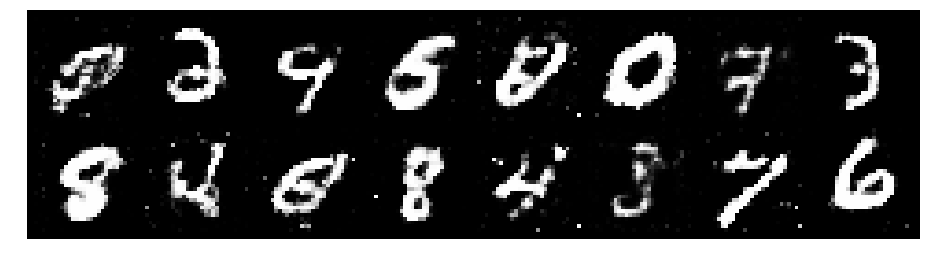

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.3178, Generator Loss: 0.8740
D(x): 0.5211, D(G(z)): 0.4452


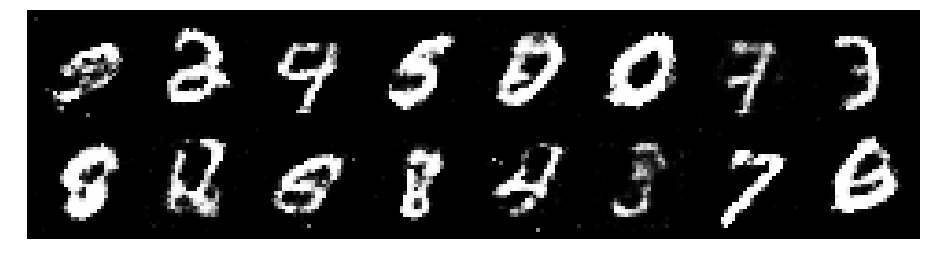

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2227, Generator Loss: 0.9637
D(x): 0.5954, D(G(z)): 0.4543


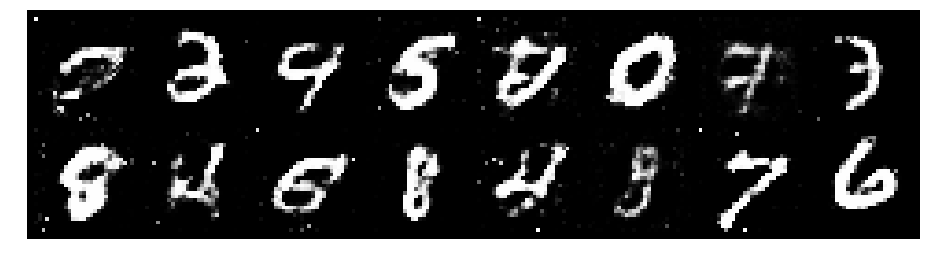

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2282, Generator Loss: 1.2031
D(x): 0.5547, D(G(z)): 0.4042


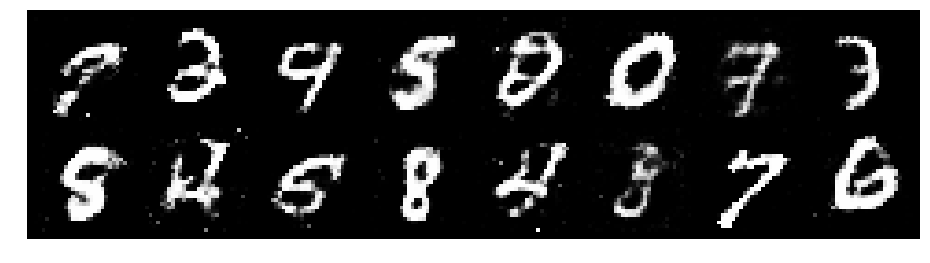

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.1668, Generator Loss: 1.1451
D(x): 0.5841, D(G(z)): 0.3974


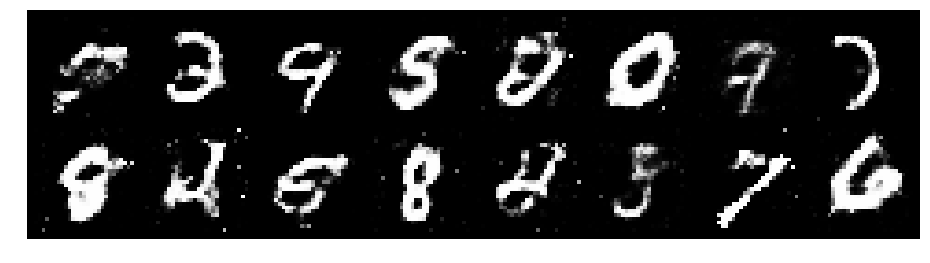

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2406, Generator Loss: 1.0305
D(x): 0.5448, D(G(z)): 0.4057


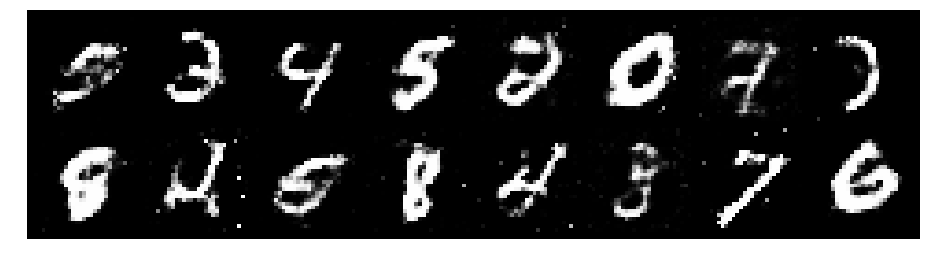

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2111, Generator Loss: 1.0420
D(x): 0.5672, D(G(z)): 0.4069


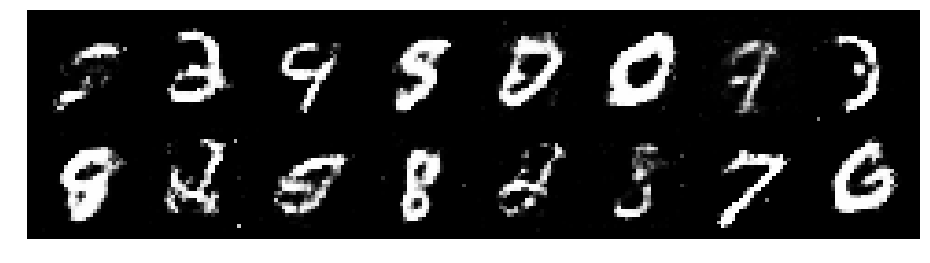

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3563, Generator Loss: 0.8796
D(x): 0.5705, D(G(z)): 0.4765


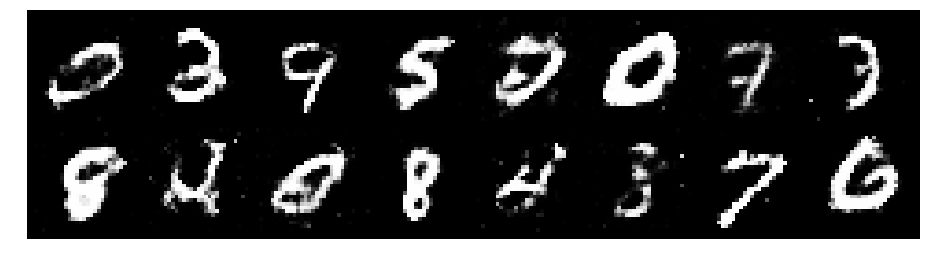

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2456, Generator Loss: 1.1054
D(x): 0.5380, D(G(z)): 0.3984


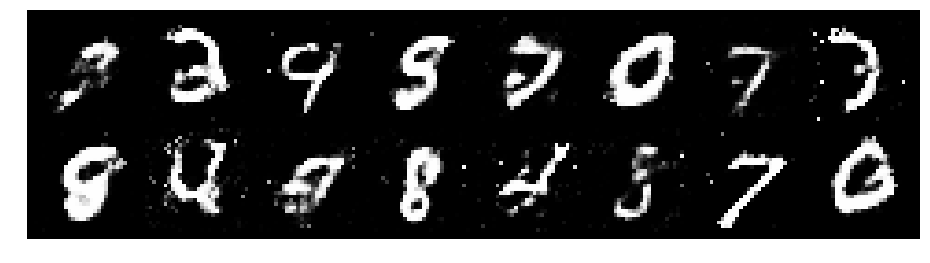

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2555, Generator Loss: 0.8486
D(x): 0.5598, D(G(z)): 0.4557


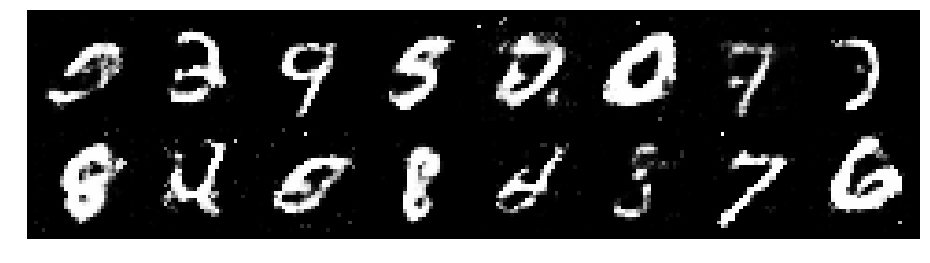

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.3493, Generator Loss: 0.8950
D(x): 0.5506, D(G(z)): 0.4813


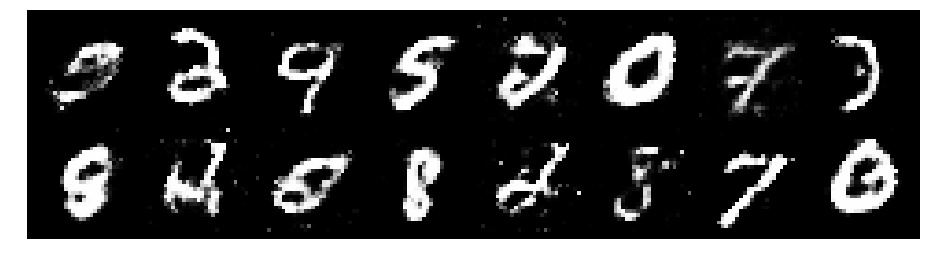

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2635, Generator Loss: 0.9744
D(x): 0.5685, D(G(z)): 0.4463


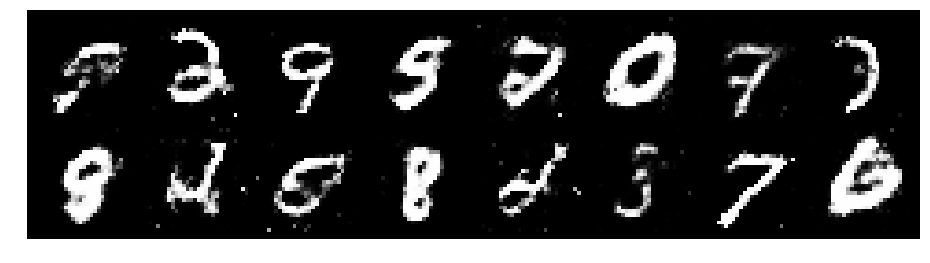

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2180, Generator Loss: 1.0714
D(x): 0.6042, D(G(z)): 0.4400


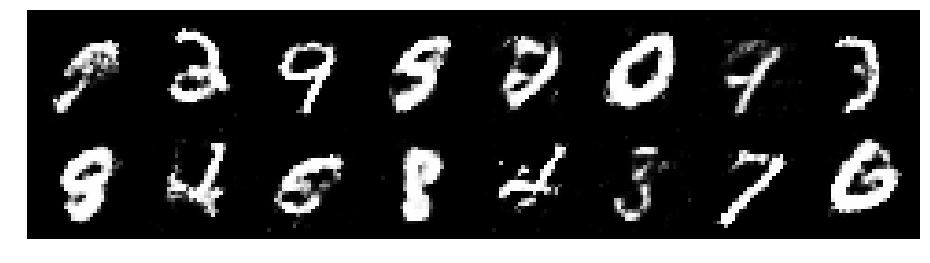

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3879, Generator Loss: 0.8998
D(x): 0.5409, D(G(z)): 0.4725


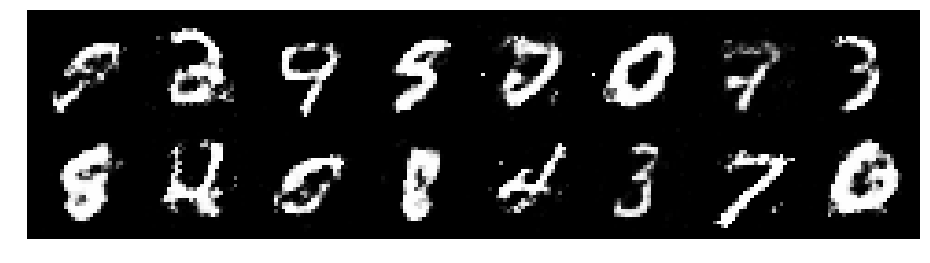

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8777
D(x): 0.5710, D(G(z)): 0.4426


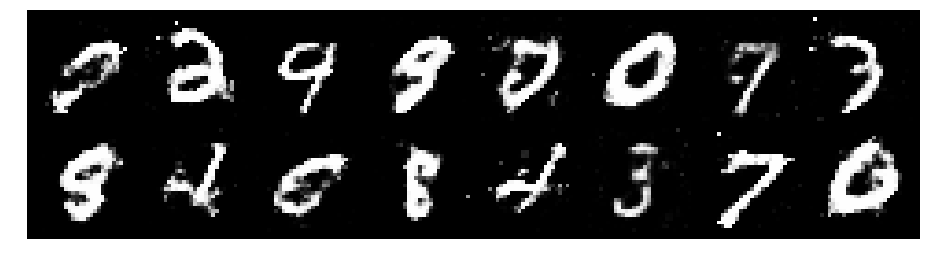

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2353, Generator Loss: 0.9059
D(x): 0.5703, D(G(z)): 0.4381


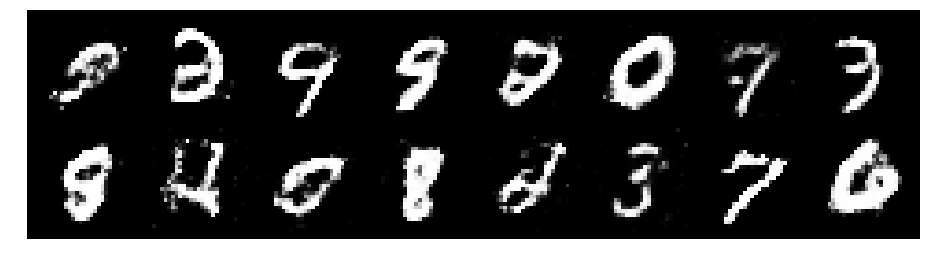

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3644, Generator Loss: 0.8969
D(x): 0.5120, D(G(z)): 0.4450


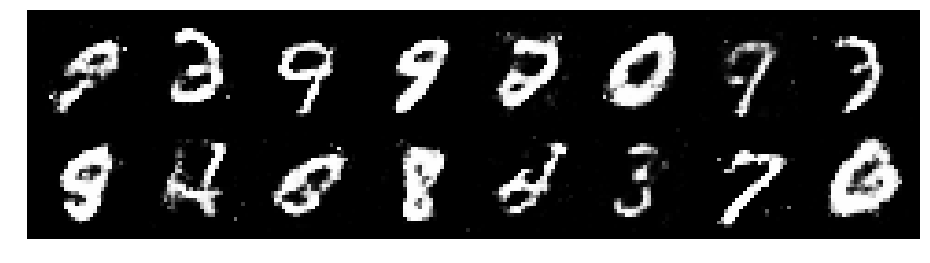

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.9699
D(x): 0.5914, D(G(z)): 0.4548


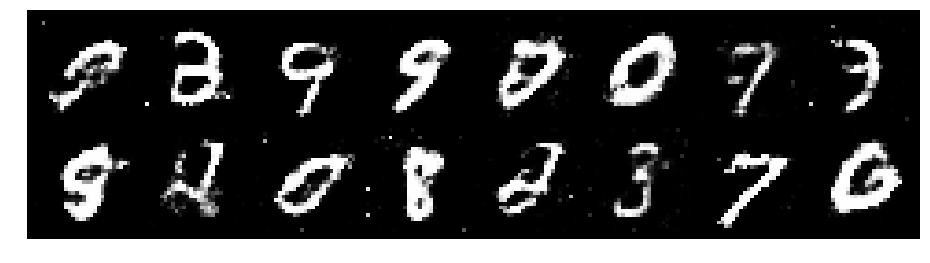

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1373, Generator Loss: 1.0342
D(x): 0.6044, D(G(z)): 0.4123


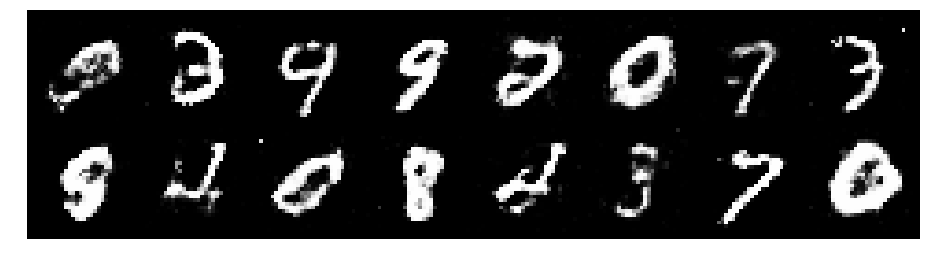

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2437, Generator Loss: 1.0292
D(x): 0.5394, D(G(z)): 0.3915


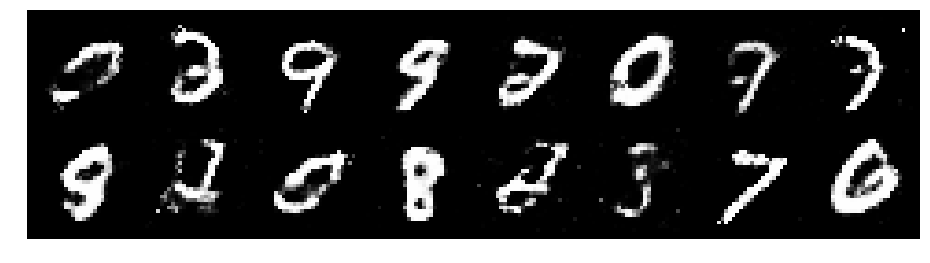

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.4015, Generator Loss: 0.9355
D(x): 0.4976, D(G(z)): 0.4300


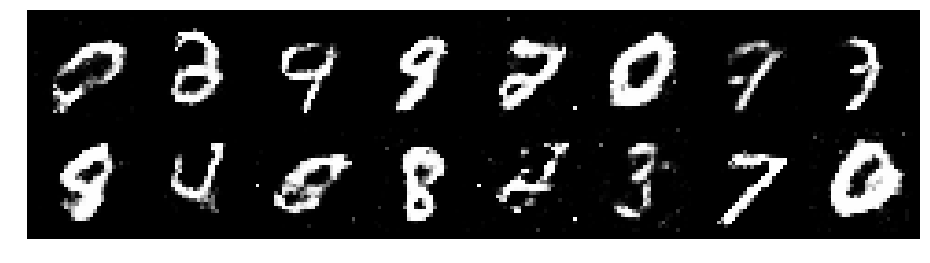

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.3932, Generator Loss: 0.7945
D(x): 0.5347, D(G(z)): 0.5034


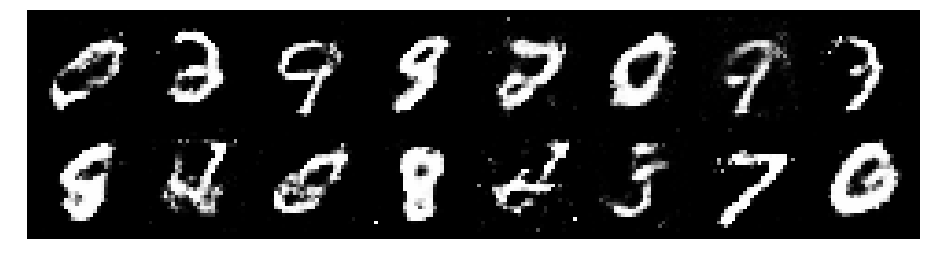

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2065, Generator Loss: 0.8242
D(x): 0.5953, D(G(z)): 0.4361


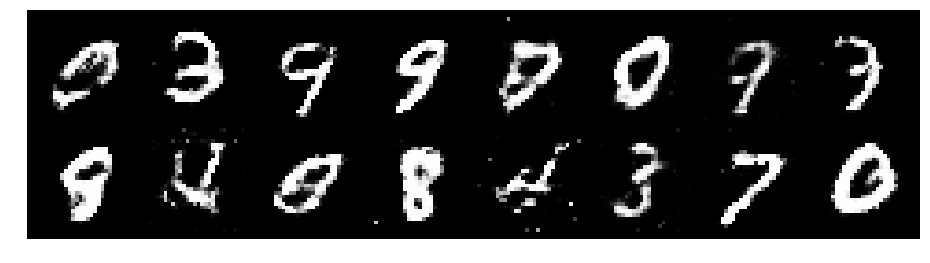

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2990, Generator Loss: 0.9116
D(x): 0.5738, D(G(z)): 0.4735


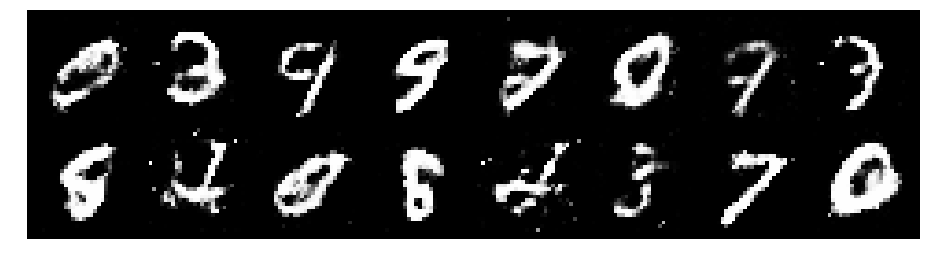

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2058, Generator Loss: 0.8298
D(x): 0.5971, D(G(z)): 0.4543


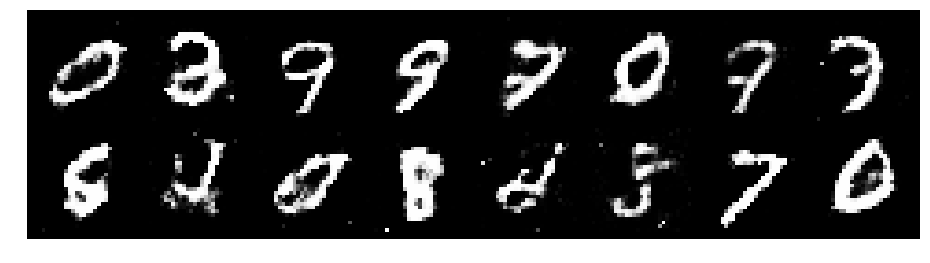

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.3219, Generator Loss: 0.8292
D(x): 0.5849, D(G(z)): 0.4926


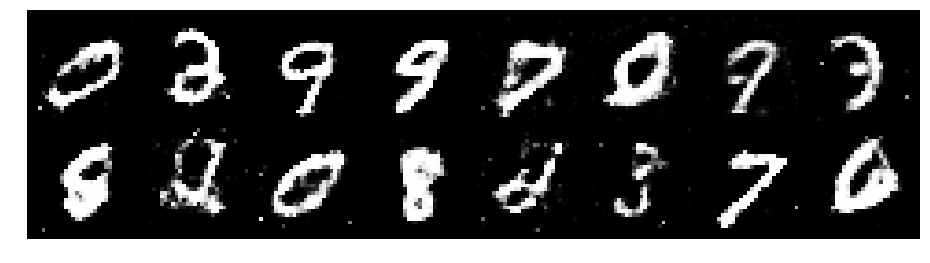

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.1993, Generator Loss: 0.8925
D(x): 0.5626, D(G(z)): 0.4081


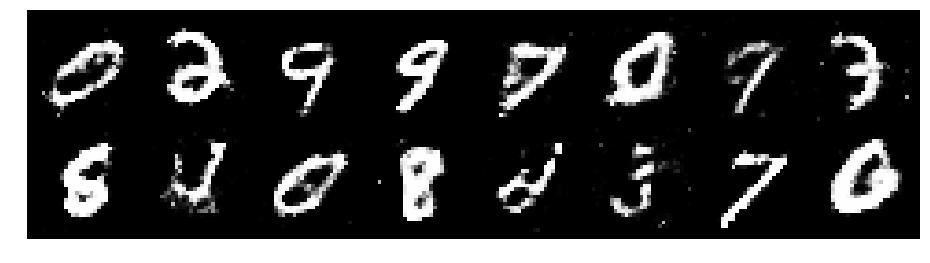

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3288, Generator Loss: 0.9496
D(x): 0.5960, D(G(z)): 0.4822


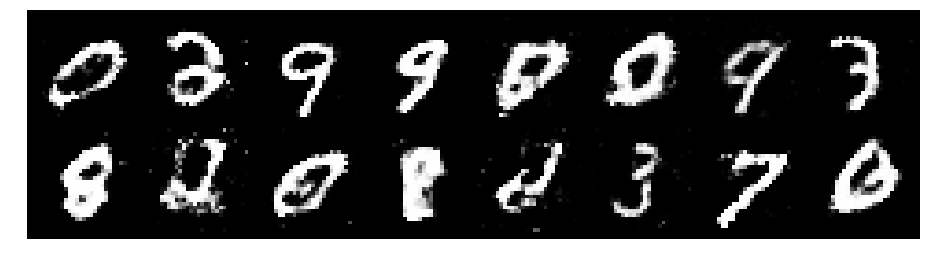

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2026, Generator Loss: 0.8776
D(x): 0.5880, D(G(z)): 0.4432


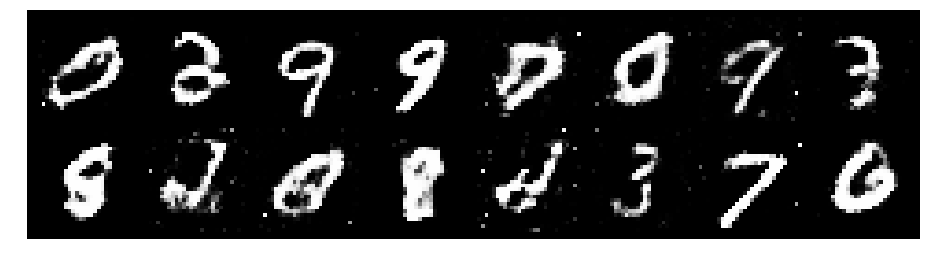

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8938
D(x): 0.5501, D(G(z)): 0.4255


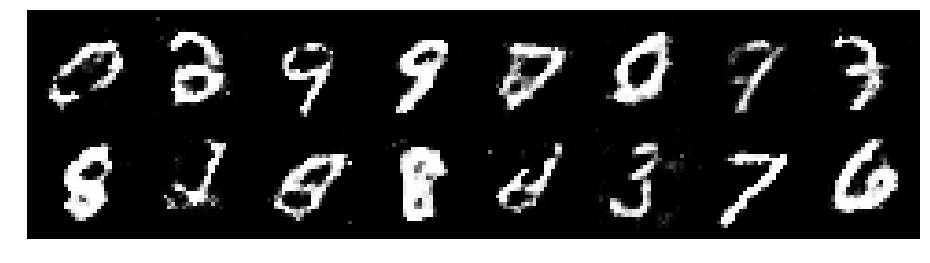

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.1678, Generator Loss: 0.9393
D(x): 0.5665, D(G(z)): 0.4059


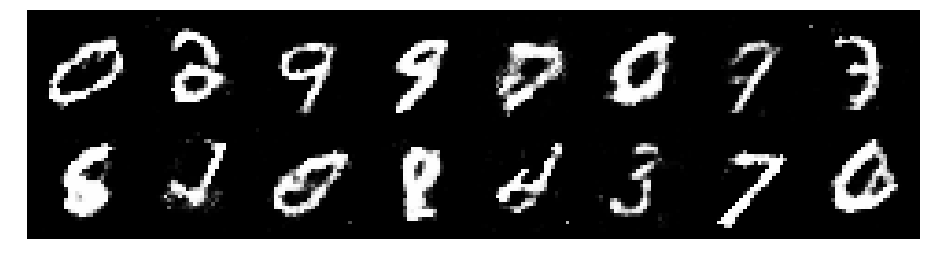

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2320, Generator Loss: 1.0602
D(x): 0.5723, D(G(z)): 0.4128


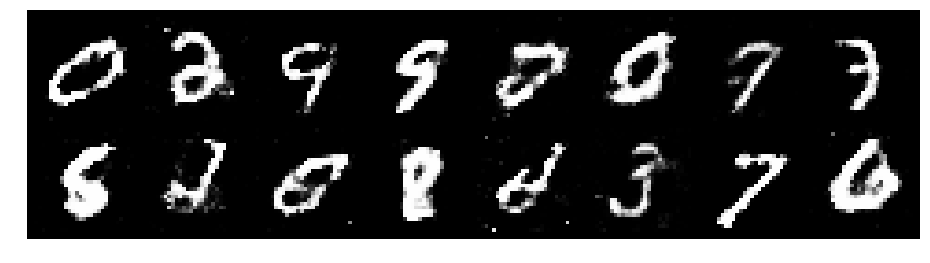

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2368, Generator Loss: 1.0037
D(x): 0.5283, D(G(z)): 0.4011


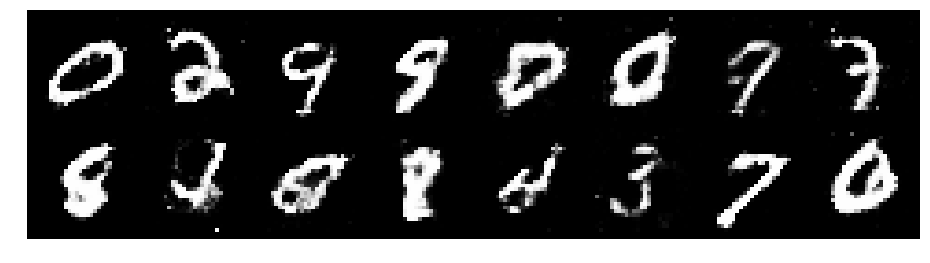

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8908
D(x): 0.5284, D(G(z)): 0.4225


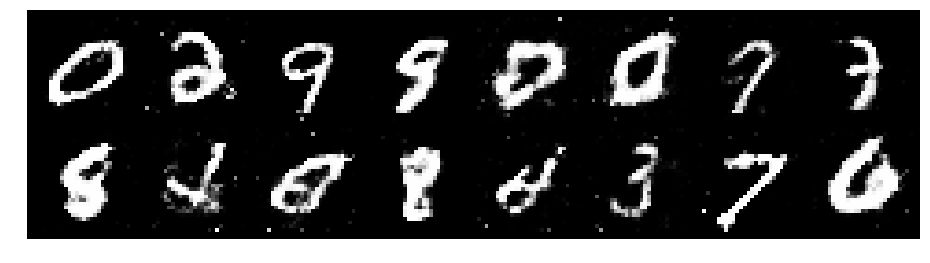

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.1587, Generator Loss: 0.9943
D(x): 0.5657, D(G(z)): 0.3925


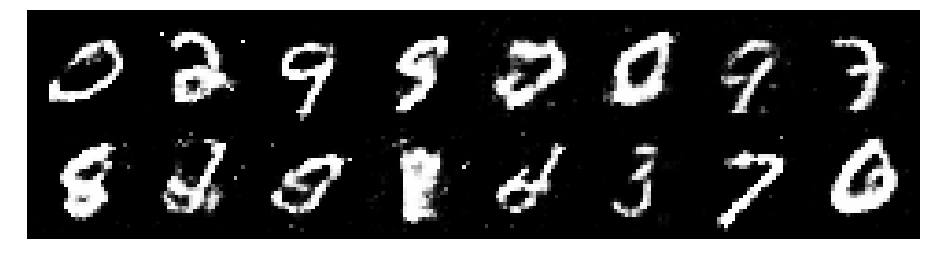

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3235, Generator Loss: 0.9566
D(x): 0.5159, D(G(z)): 0.3968


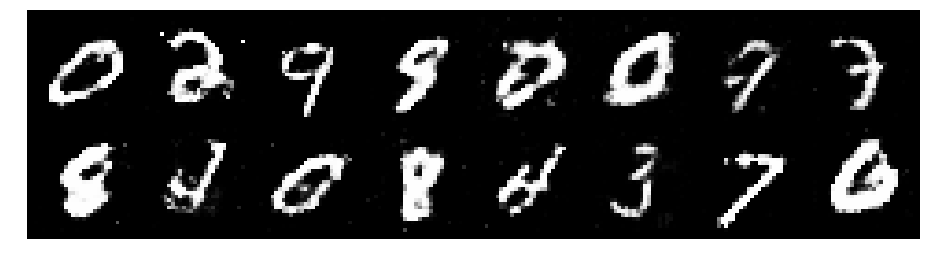

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.3171, Generator Loss: 0.7886
D(x): 0.5618, D(G(z)): 0.4642


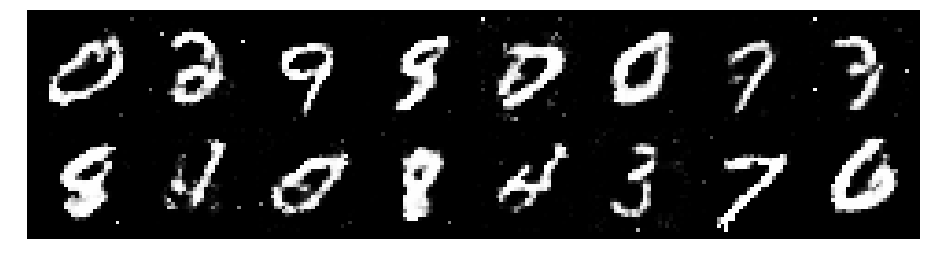

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.3021, Generator Loss: 0.9905
D(x): 0.5251, D(G(z)): 0.4271


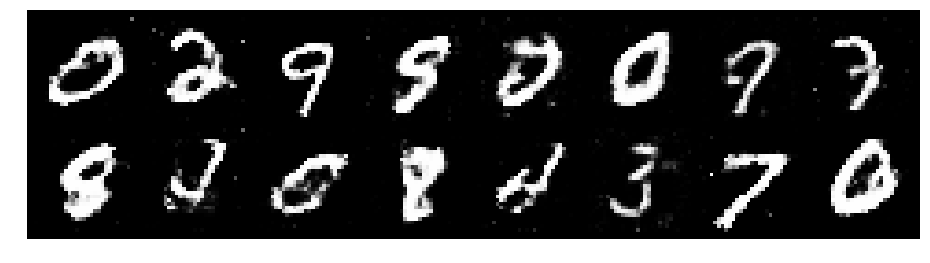

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3184, Generator Loss: 0.8417
D(x): 0.5795, D(G(z)): 0.4639


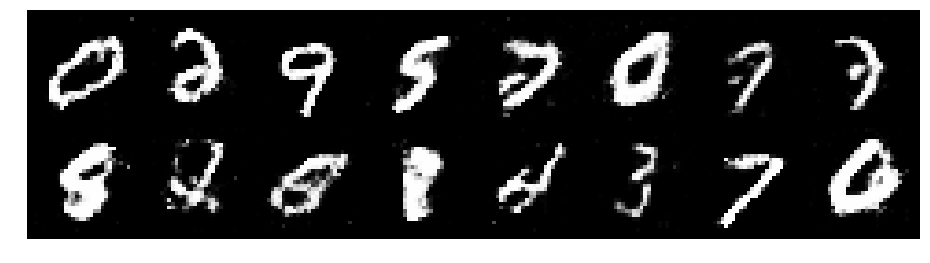

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2817, Generator Loss: 0.8966
D(x): 0.5745, D(G(z)): 0.4442


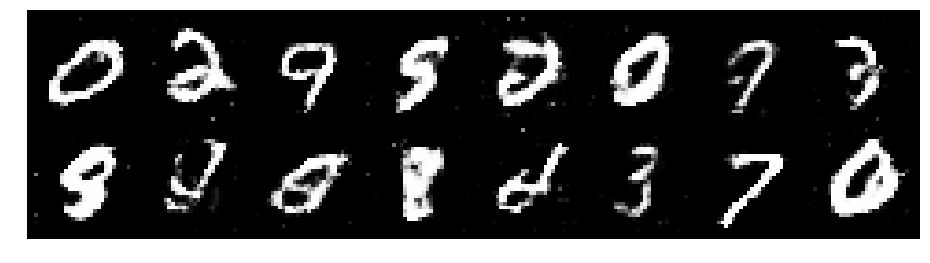

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3713, Generator Loss: 0.9976
D(x): 0.5578, D(G(z)): 0.4823


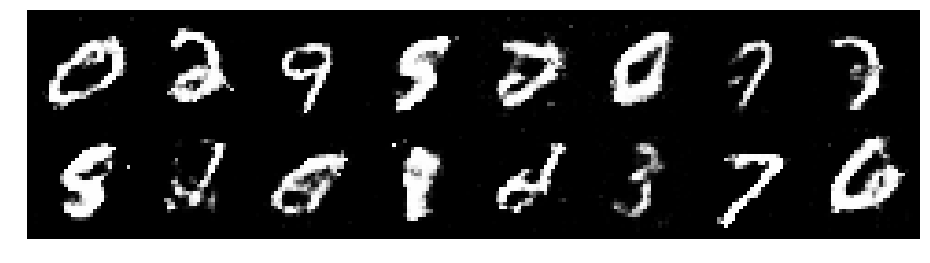

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3353, Generator Loss: 0.7897
D(x): 0.5288, D(G(z)): 0.4577


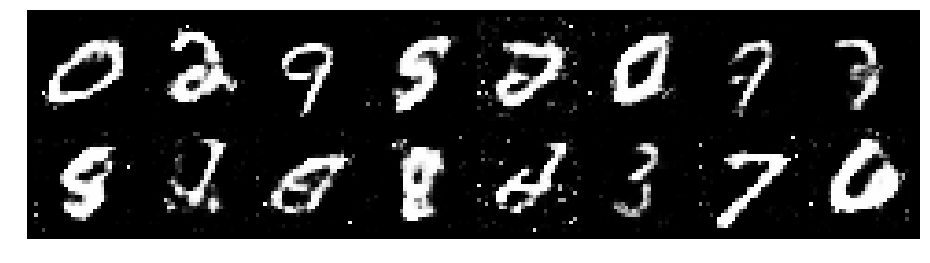

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3625, Generator Loss: 1.0238
D(x): 0.5455, D(G(z)): 0.4436


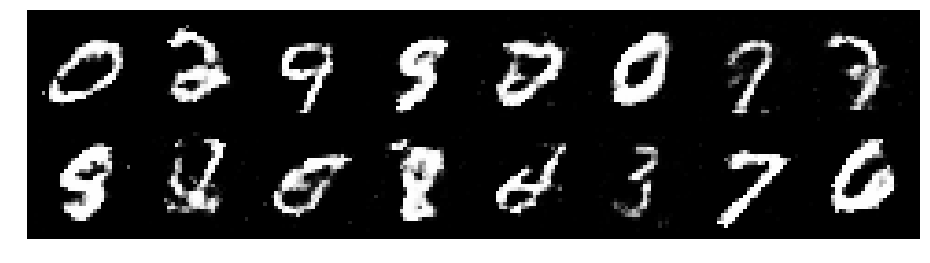

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3169, Generator Loss: 0.8447
D(x): 0.5159, D(G(z)): 0.4502


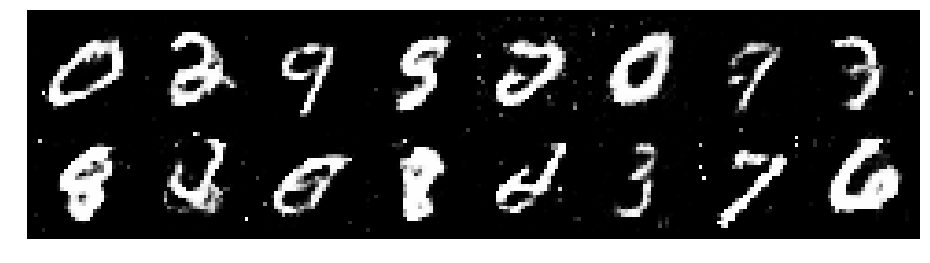

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2652, Generator Loss: 1.0264
D(x): 0.5784, D(G(z)): 0.4483


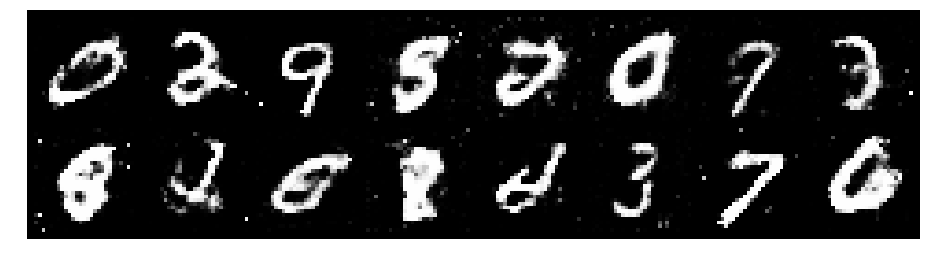

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8335
D(x): 0.5921, D(G(z)): 0.4872


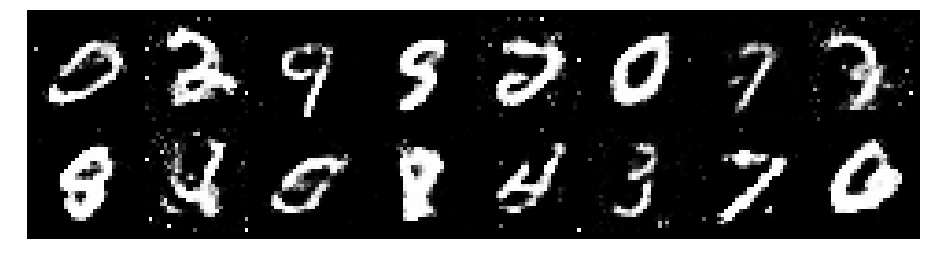

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8833
D(x): 0.5752, D(G(z)): 0.3992


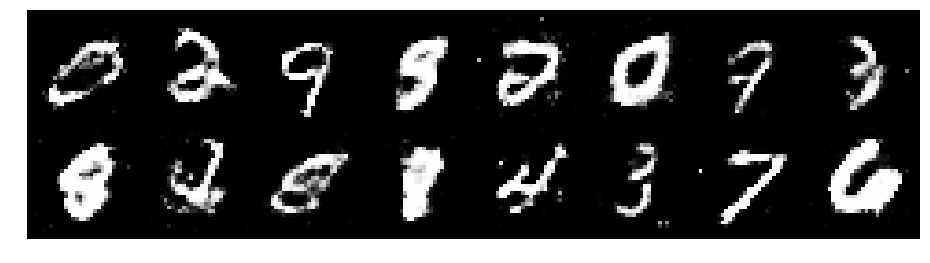

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.3173, Generator Loss: 0.9173
D(x): 0.5545, D(G(z)): 0.4581


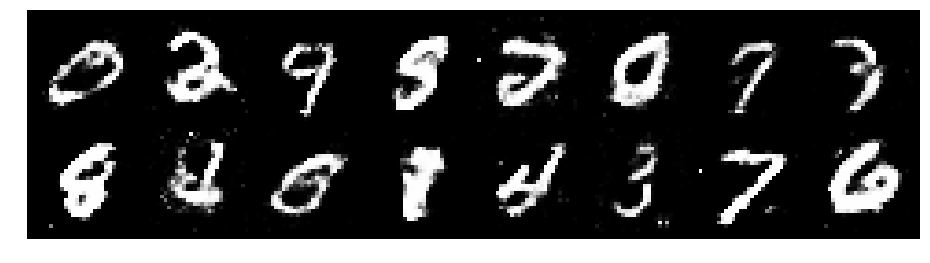

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2525, Generator Loss: 0.8099
D(x): 0.6042, D(G(z)): 0.4903


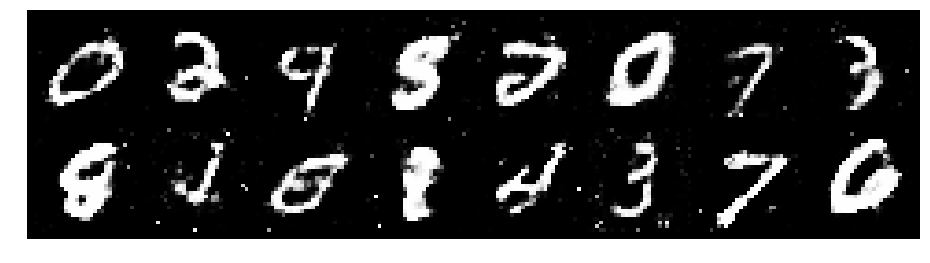

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2639, Generator Loss: 0.8155
D(x): 0.5444, D(G(z)): 0.4515


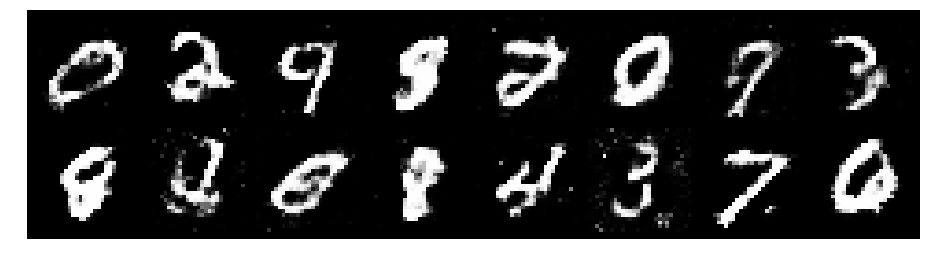

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1811, Generator Loss: 0.8699
D(x): 0.6191, D(G(z)): 0.4606


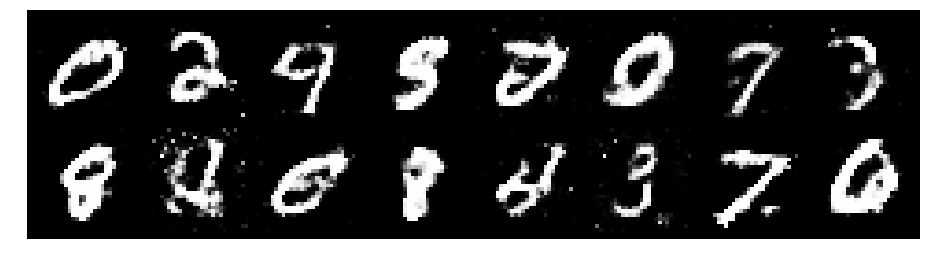

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2185, Generator Loss: 0.9598
D(x): 0.5727, D(G(z)): 0.4404


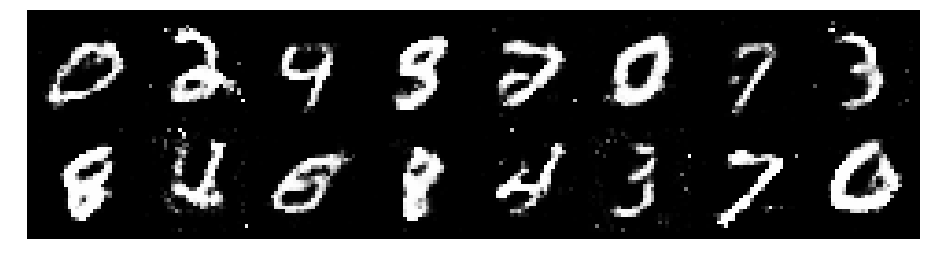

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2086, Generator Loss: 0.9622
D(x): 0.5789, D(G(z)): 0.4329


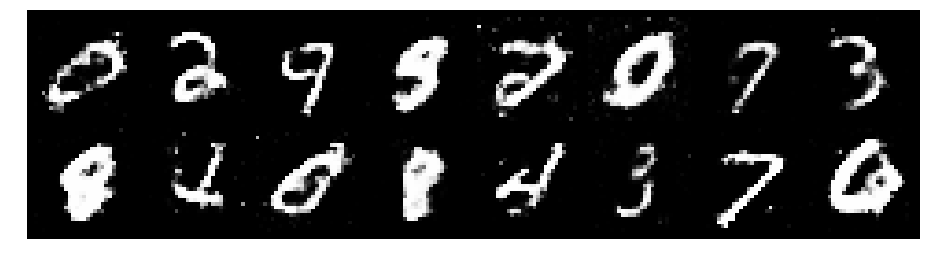

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2204, Generator Loss: 0.8303
D(x): 0.5632, D(G(z)): 0.4270


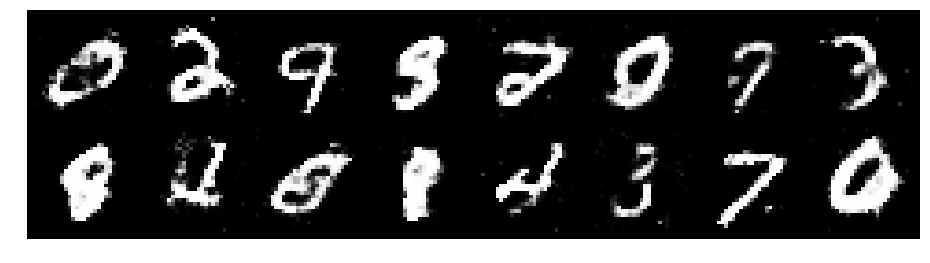

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3100, Generator Loss: 0.9966
D(x): 0.5391, D(G(z)): 0.4199


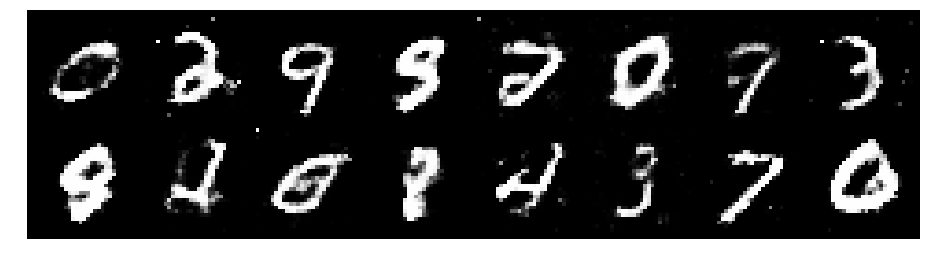

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 1.0445
D(x): 0.6027, D(G(z)): 0.4493


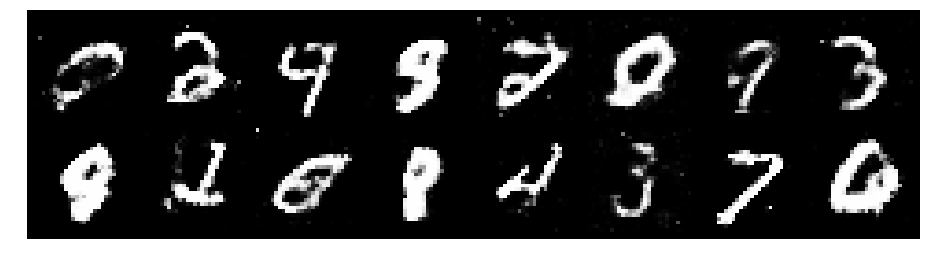

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9236
D(x): 0.5845, D(G(z)): 0.4147


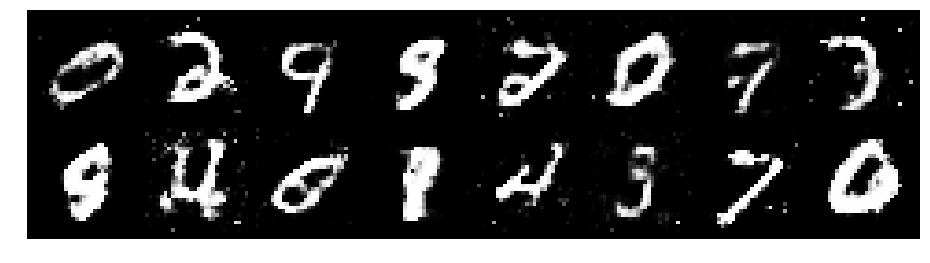

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2519, Generator Loss: 0.8056
D(x): 0.5918, D(G(z)): 0.4744


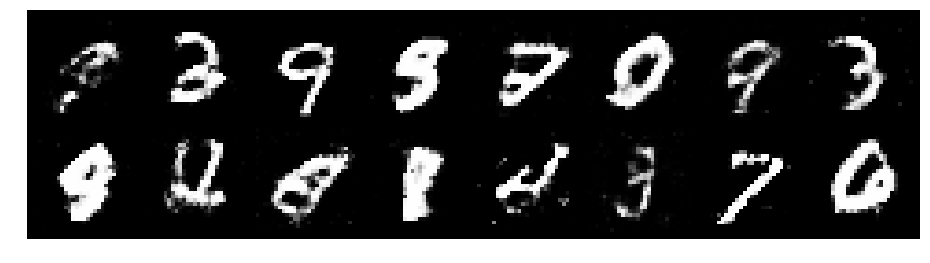

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2493, Generator Loss: 0.7829
D(x): 0.5415, D(G(z)): 0.4350


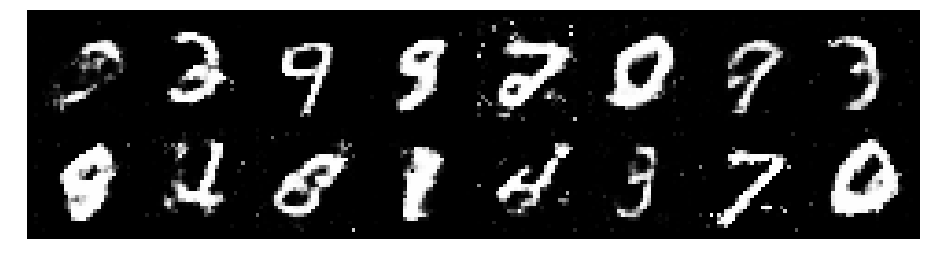

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9567
D(x): 0.5653, D(G(z)): 0.4759


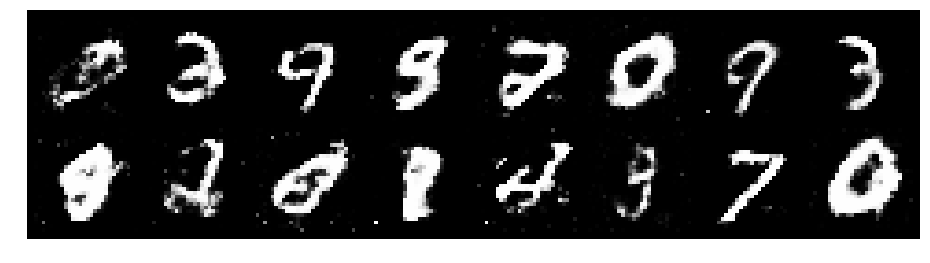

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2690, Generator Loss: 0.8839
D(x): 0.5252, D(G(z)): 0.4220


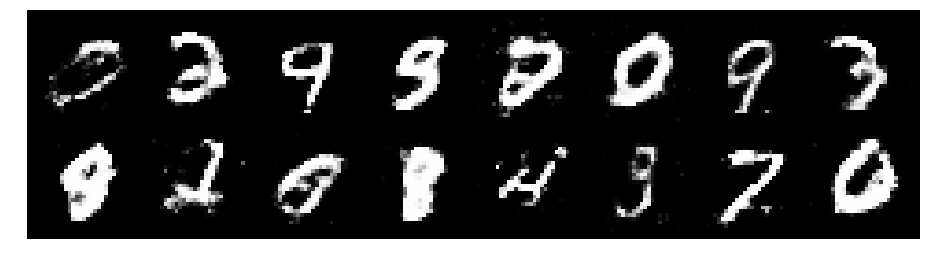

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3269, Generator Loss: 0.7755
D(x): 0.5668, D(G(z)): 0.4868


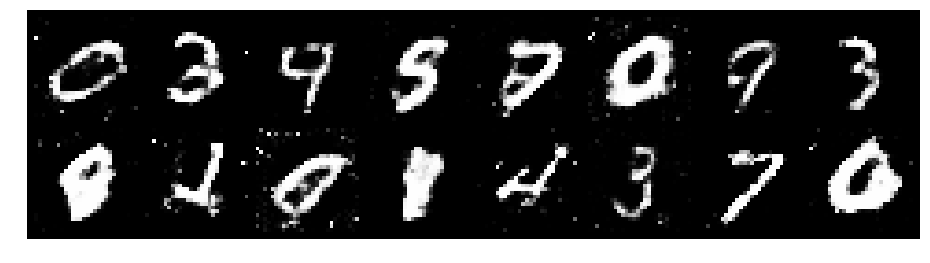

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.3039, Generator Loss: 0.7778
D(x): 0.5471, D(G(z)): 0.4549


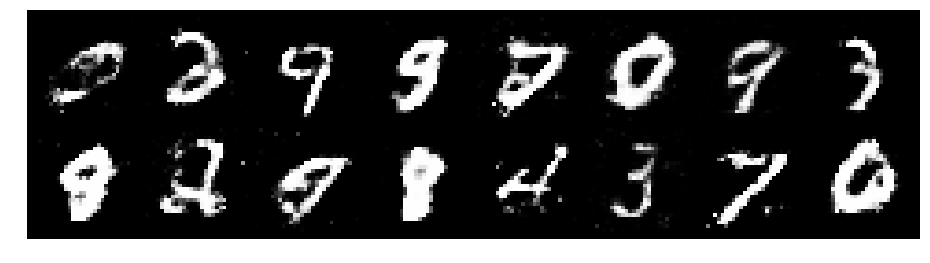

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1010, Generator Loss: 1.1101
D(x): 0.6040, D(G(z)): 0.3995


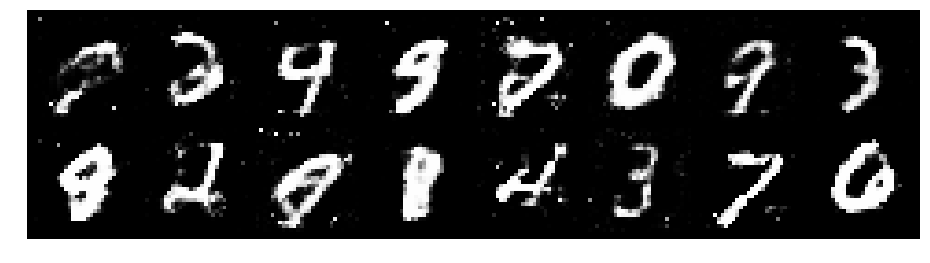

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2817, Generator Loss: 0.8752
D(x): 0.5449, D(G(z)): 0.4519


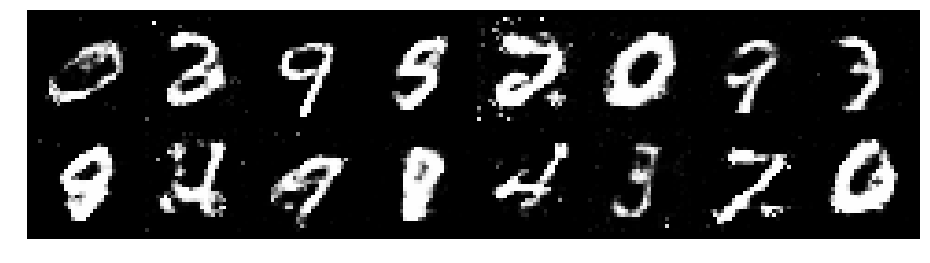

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3702, Generator Loss: 0.7643
D(x): 0.5646, D(G(z)): 0.4842


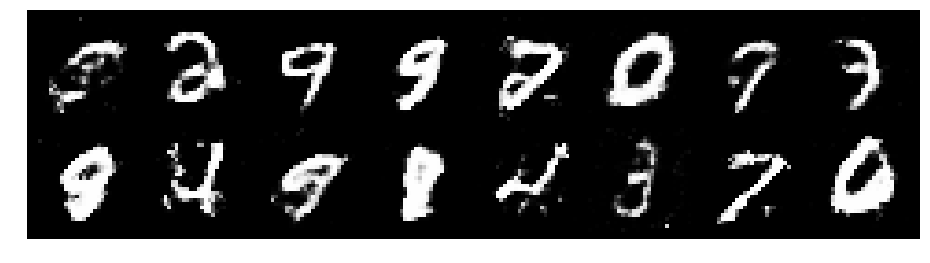

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3548, Generator Loss: 0.9426
D(x): 0.5380, D(G(z)): 0.4491


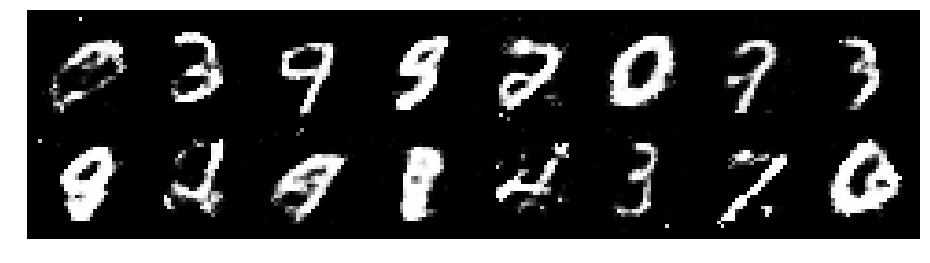

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2541, Generator Loss: 0.9520
D(x): 0.5583, D(G(z)): 0.4451


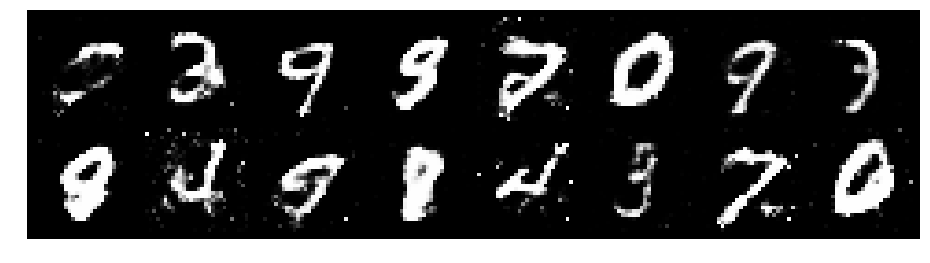

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2421, Generator Loss: 0.9085
D(x): 0.5507, D(G(z)): 0.4383


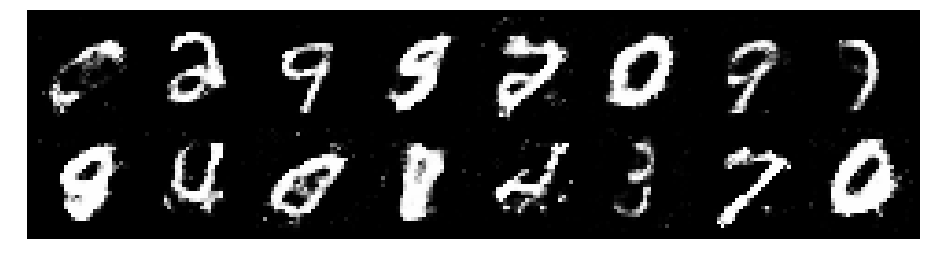

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2690, Generator Loss: 0.8160
D(x): 0.5600, D(G(z)): 0.4605


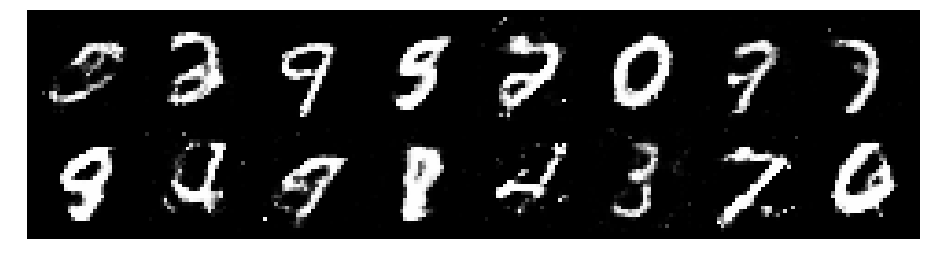

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.3295, Generator Loss: 0.9469
D(x): 0.5251, D(G(z)): 0.4163


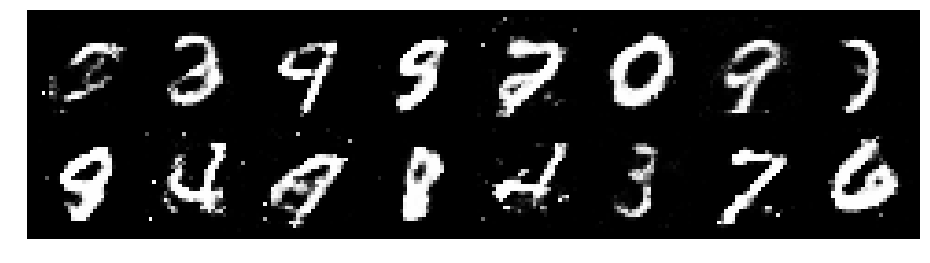

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1642, Generator Loss: 1.0538
D(x): 0.5311, D(G(z)): 0.3687


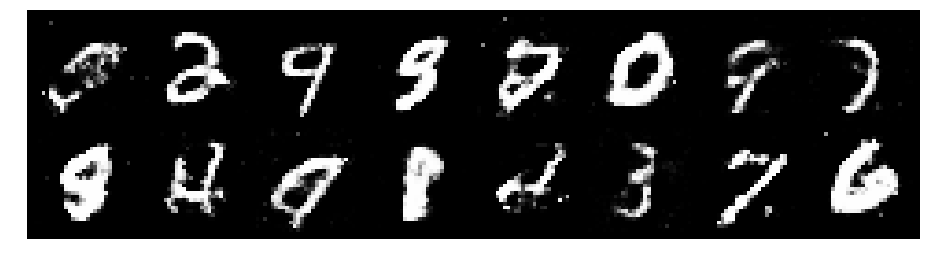

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3033, Generator Loss: 0.8015
D(x): 0.5394, D(G(z)): 0.4634


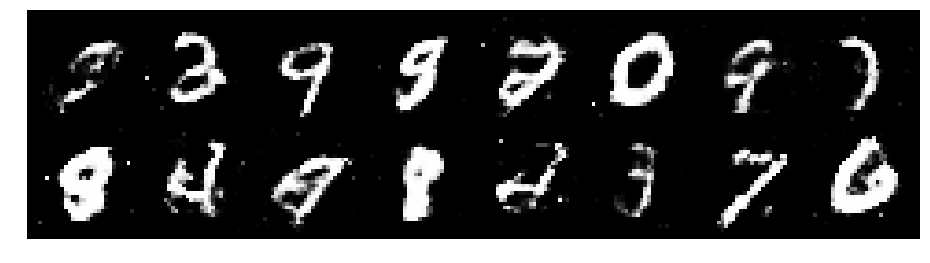

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8199
D(x): 0.5387, D(G(z)): 0.4550


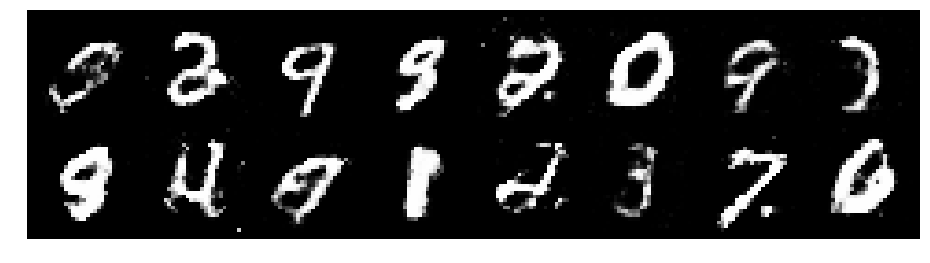

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.3468, Generator Loss: 0.7375
D(x): 0.5887, D(G(z)): 0.5109


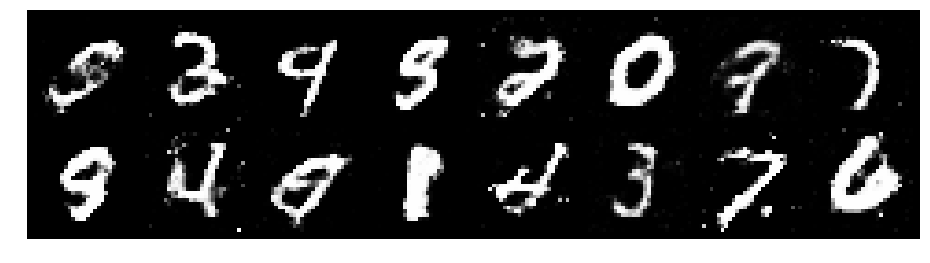

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2640, Generator Loss: 0.8635
D(x): 0.5462, D(G(z)): 0.4396


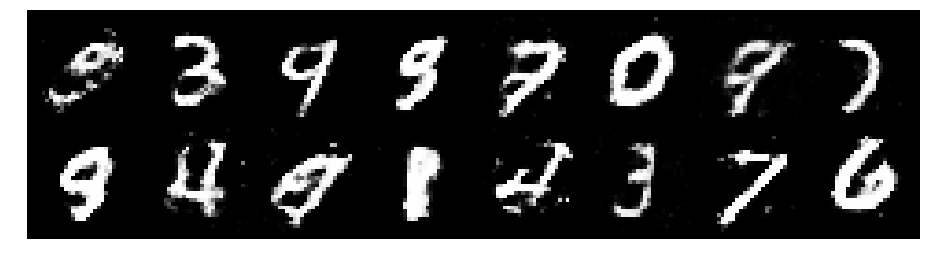

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.1830, Generator Loss: 0.8953
D(x): 0.5645, D(G(z)): 0.4187


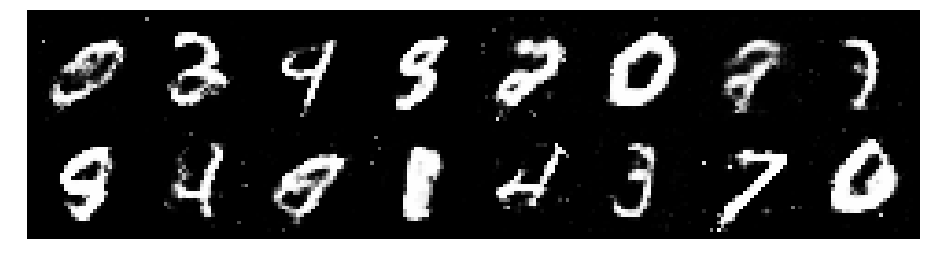

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.1623, Generator Loss: 0.8838
D(x): 0.5911, D(G(z)): 0.4301


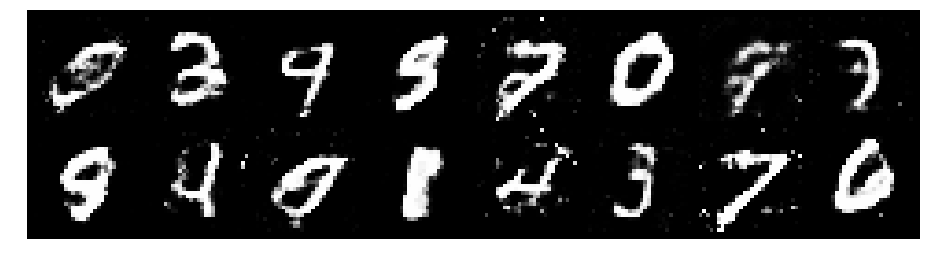

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.3231, Generator Loss: 1.0638
D(x): 0.5776, D(G(z)): 0.4413


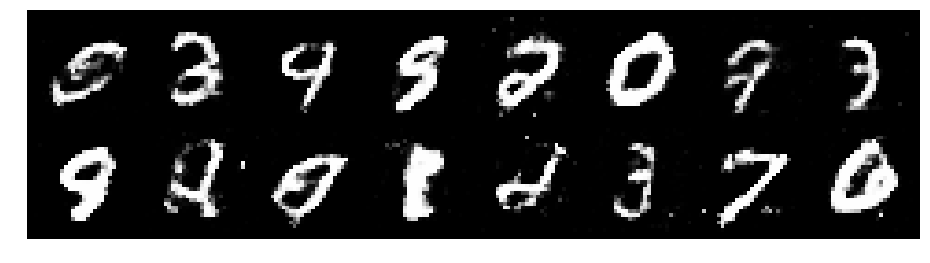

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2744, Generator Loss: 0.8802
D(x): 0.5809, D(G(z)): 0.4564


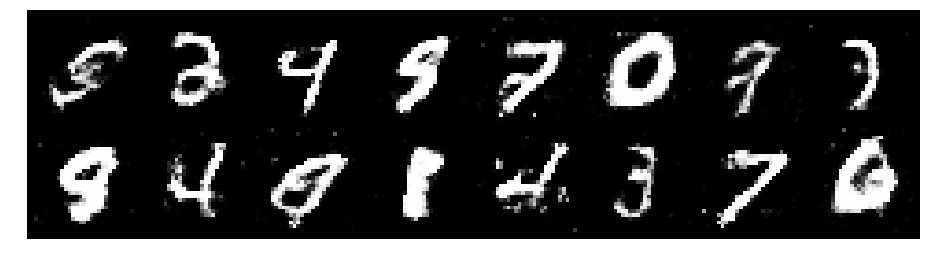

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2629, Generator Loss: 0.9106
D(x): 0.5199, D(G(z)): 0.4088


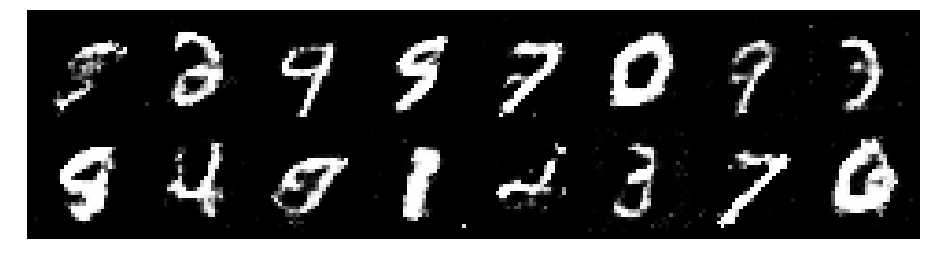

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2519, Generator Loss: 0.9288
D(x): 0.5431, D(G(z)): 0.4226


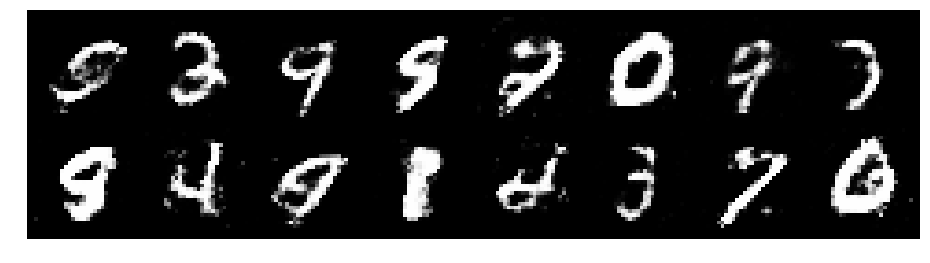

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2037, Generator Loss: 0.7812
D(x): 0.5929, D(G(z)): 0.4570


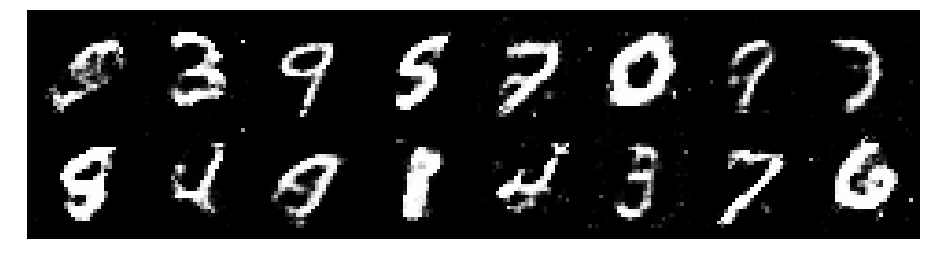

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2728, Generator Loss: 0.7938
D(x): 0.5793, D(G(z)): 0.4717


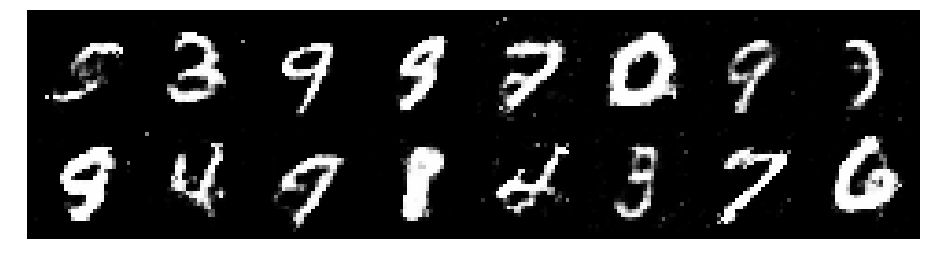

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2575, Generator Loss: 0.8966
D(x): 0.5705, D(G(z)): 0.4453


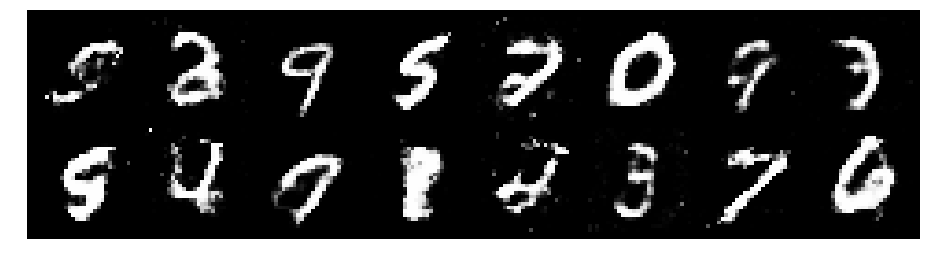

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2468, Generator Loss: 0.9258
D(x): 0.5598, D(G(z)): 0.4520


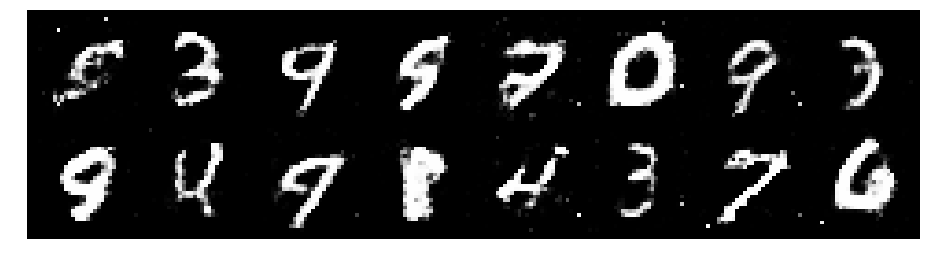

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2263, Generator Loss: 0.8788
D(x): 0.5652, D(G(z)): 0.4409


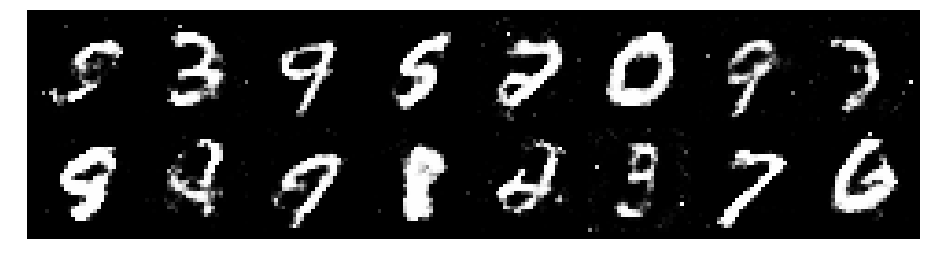

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1068, Generator Loss: 0.9570
D(x): 0.5966, D(G(z)): 0.4078


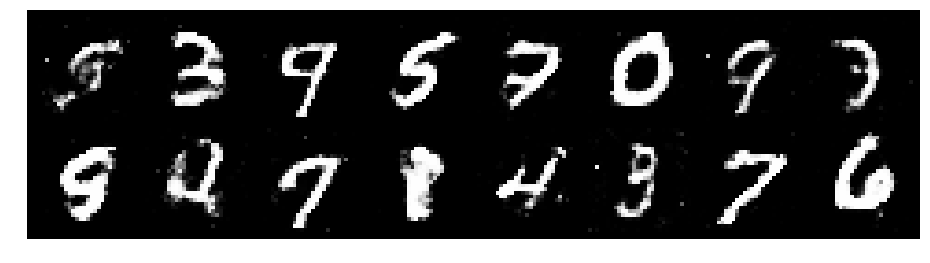

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2476, Generator Loss: 0.9871
D(x): 0.5573, D(G(z)): 0.4046


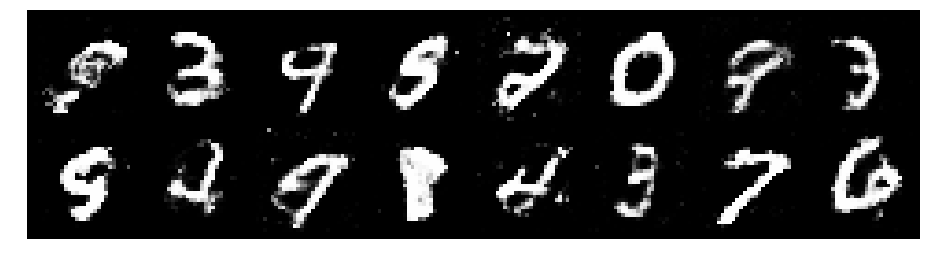

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.1861, Generator Loss: 0.9526
D(x): 0.5668, D(G(z)): 0.4201


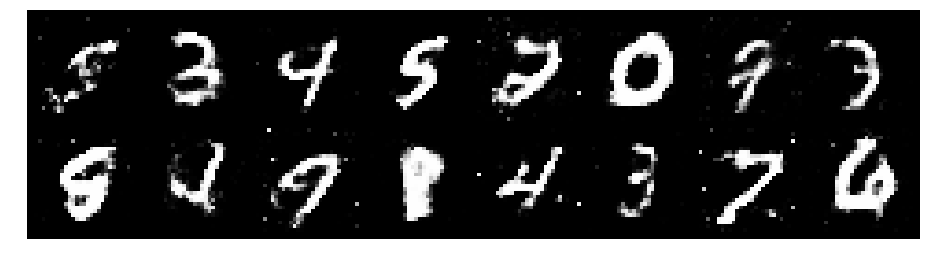

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2200, Generator Loss: 1.0329
D(x): 0.5876, D(G(z)): 0.4539


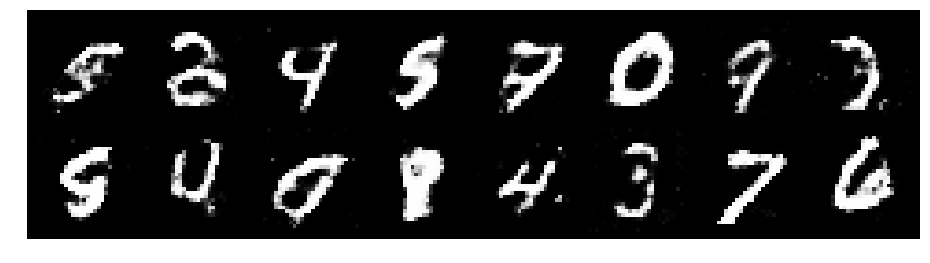

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.1580, Generator Loss: 0.9342
D(x): 0.5634, D(G(z)): 0.3942


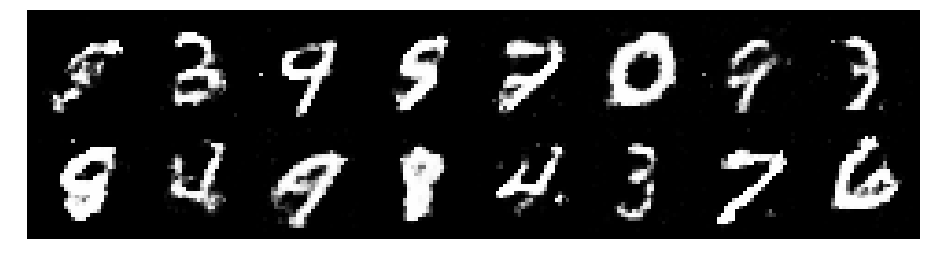

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2475, Generator Loss: 0.9390
D(x): 0.5394, D(G(z)): 0.4006


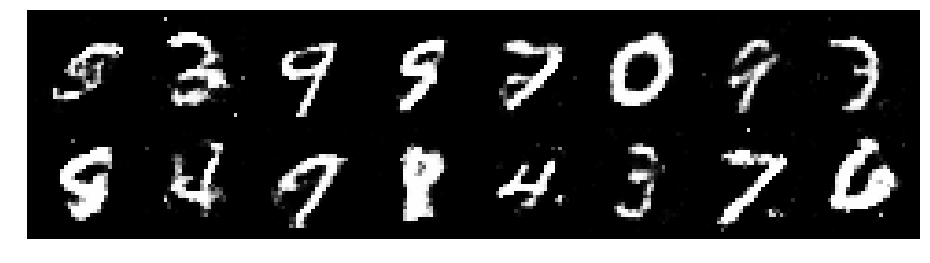

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2591, Generator Loss: 0.8994
D(x): 0.5376, D(G(z)): 0.4293


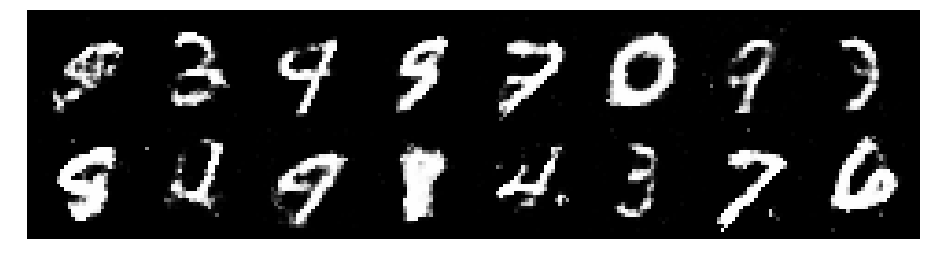

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8555
D(x): 0.5528, D(G(z)): 0.4316


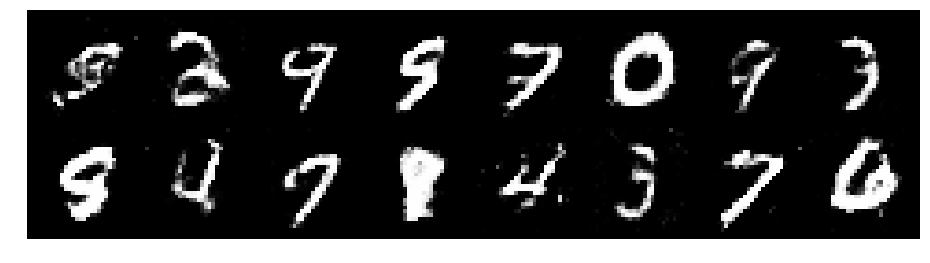

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1447, Generator Loss: 0.8869
D(x): 0.5910, D(G(z)): 0.4085


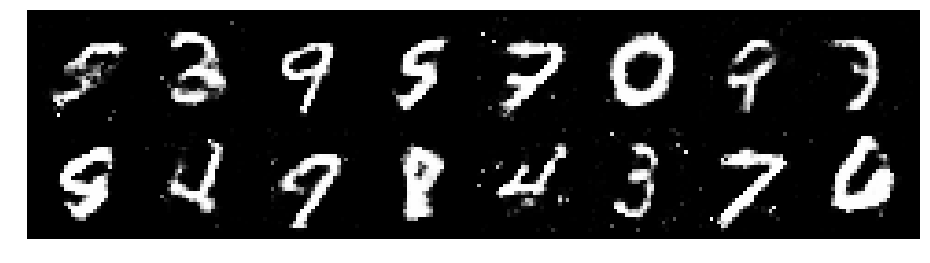

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9353
D(x): 0.5576, D(G(z)): 0.4667


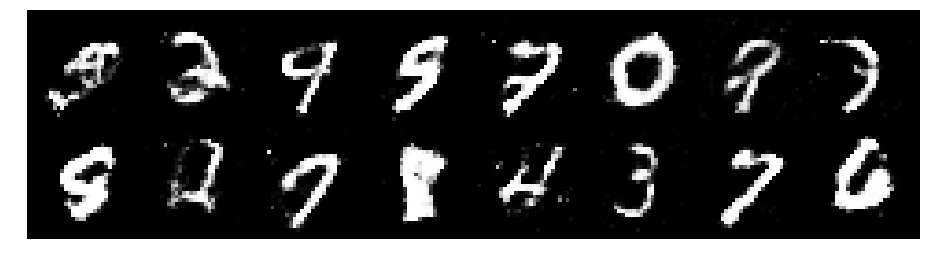

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2821, Generator Loss: 0.8617
D(x): 0.5511, D(G(z)): 0.4274


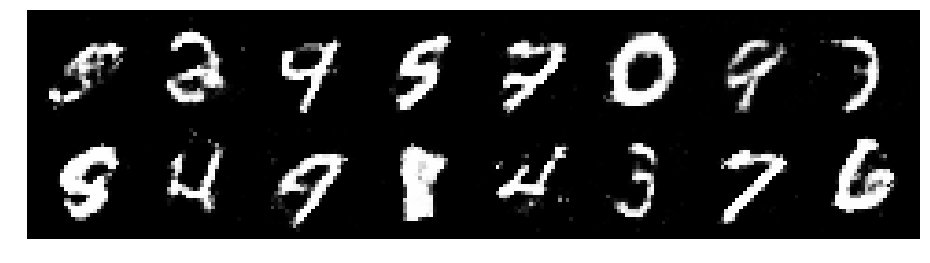

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3012, Generator Loss: 0.7819
D(x): 0.5562, D(G(z)): 0.4784


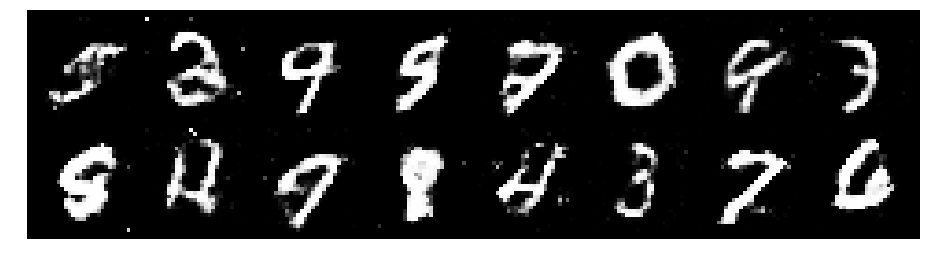

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2393, Generator Loss: 0.8328
D(x): 0.5610, D(G(z)): 0.4411


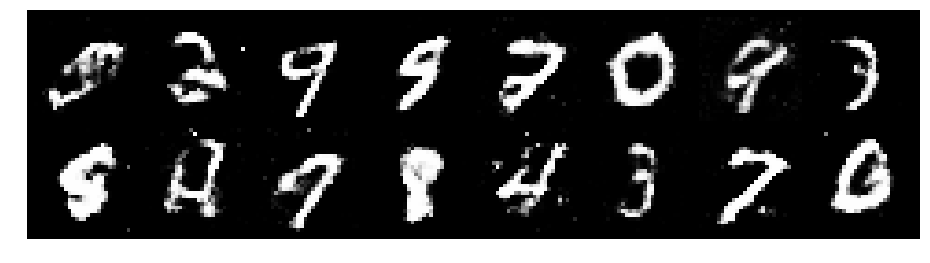

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.1604, Generator Loss: 0.9508
D(x): 0.5617, D(G(z)): 0.4131


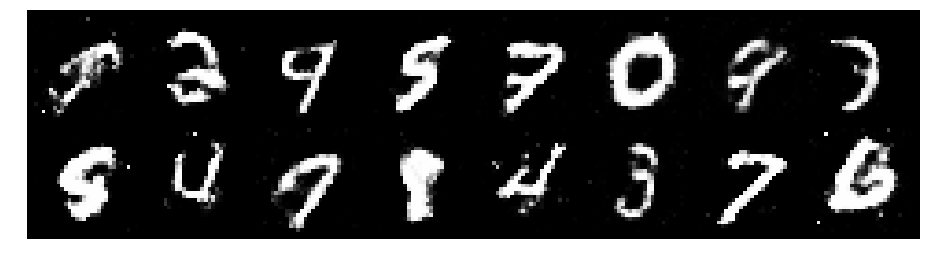

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.1830, Generator Loss: 0.9446
D(x): 0.5588, D(G(z)): 0.4017


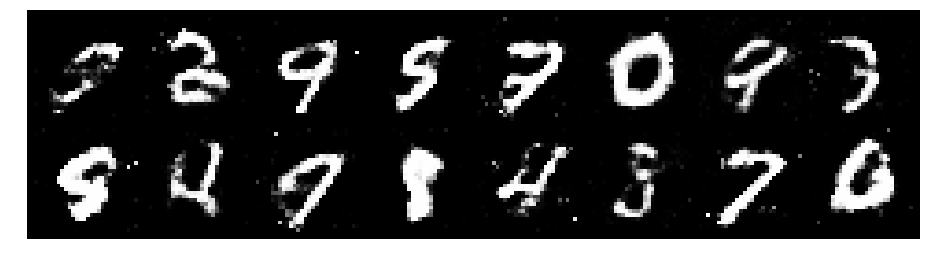

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2316, Generator Loss: 0.8217
D(x): 0.5632, D(G(z)): 0.4390


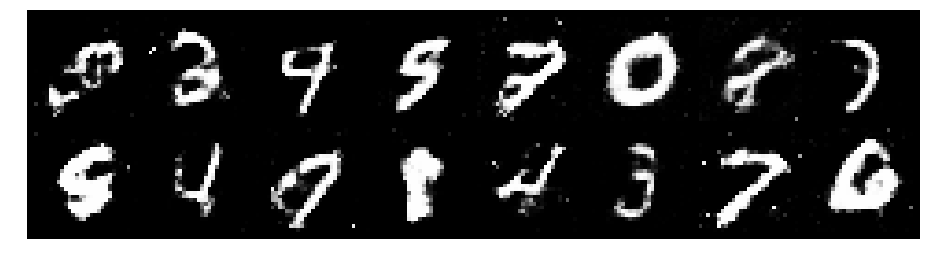

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.4381, Generator Loss: 0.8187
D(x): 0.5593, D(G(z)): 0.4917


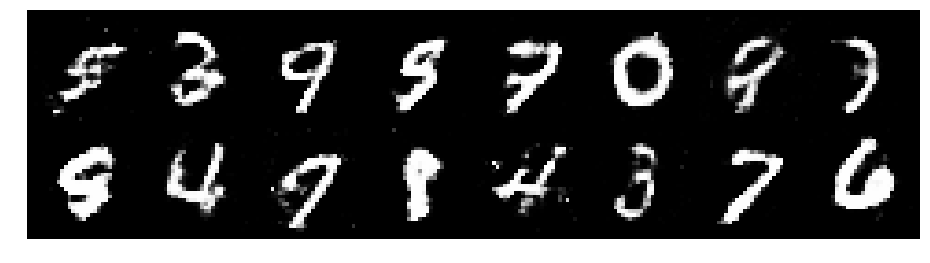

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3409, Generator Loss: 0.8964
D(x): 0.5192, D(G(z)): 0.4479


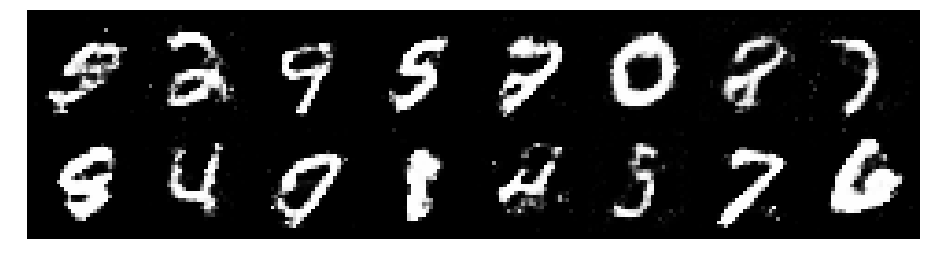

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3108, Generator Loss: 0.8868
D(x): 0.5030, D(G(z)): 0.4218


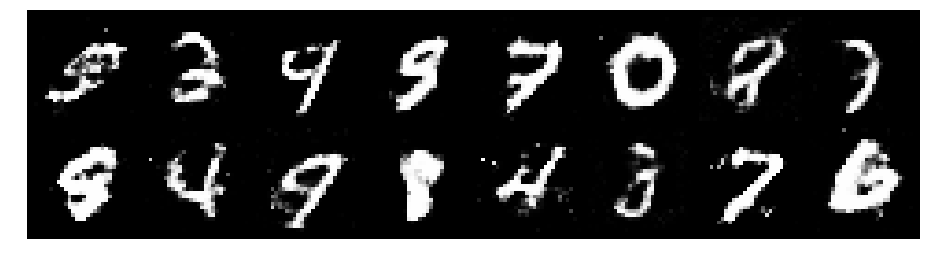

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3275, Generator Loss: 0.8149
D(x): 0.5518, D(G(z)): 0.4564


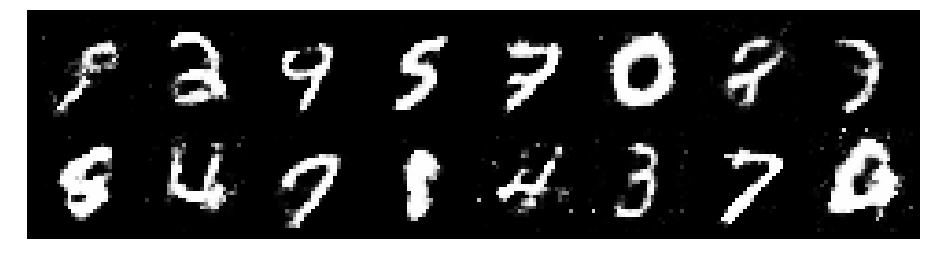

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2891, Generator Loss: 0.8463
D(x): 0.5317, D(G(z)): 0.4460


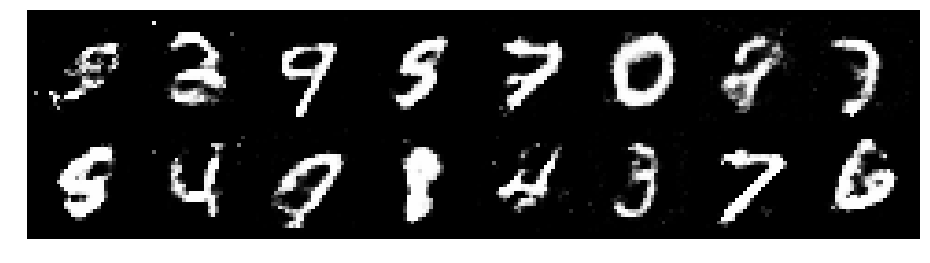

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3887, Generator Loss: 1.0087
D(x): 0.5252, D(G(z)): 0.4541


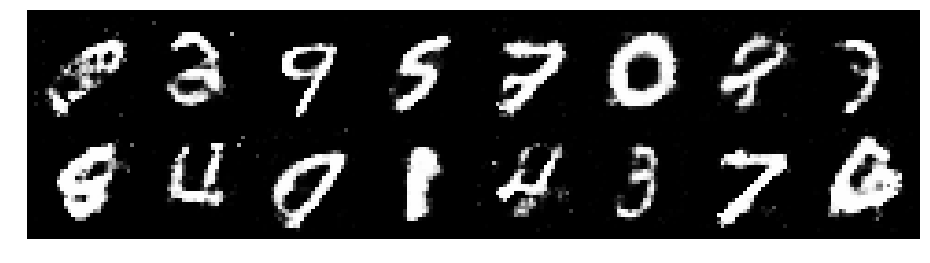

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.1662, Generator Loss: 0.8818
D(x): 0.6218, D(G(z)): 0.4458


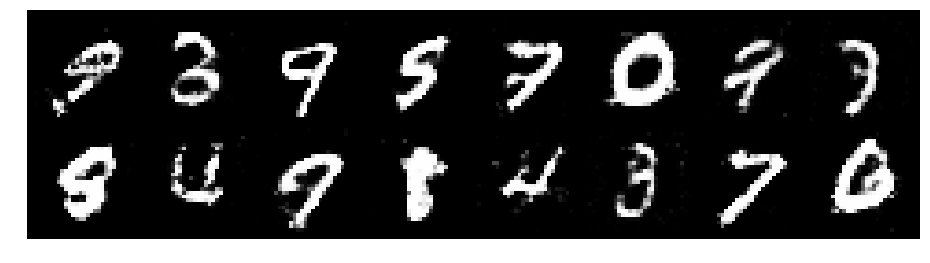

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3847, Generator Loss: 1.0035
D(x): 0.5545, D(G(z)): 0.4651


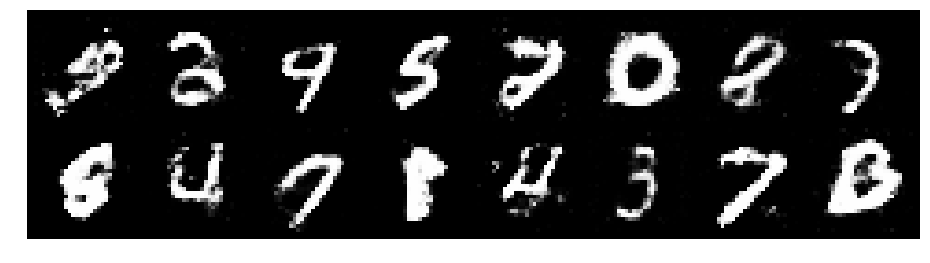

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.4038, Generator Loss: 0.9074
D(x): 0.5032, D(G(z)): 0.4696


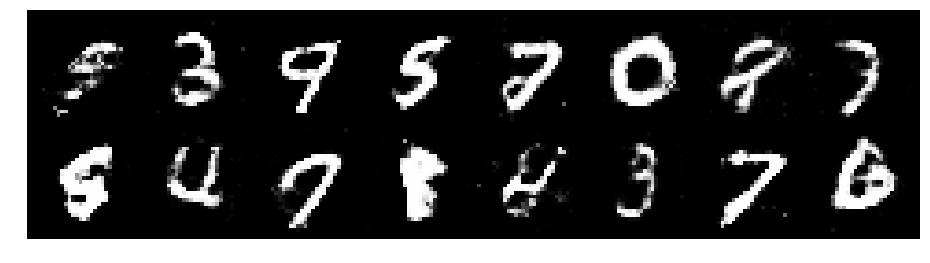

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.3417, Generator Loss: 0.7745
D(x): 0.5474, D(G(z)): 0.4757


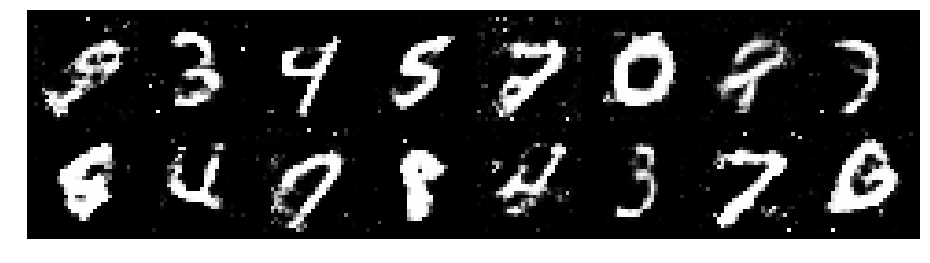

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2848, Generator Loss: 1.0495
D(x): 0.5759, D(G(z)): 0.4534


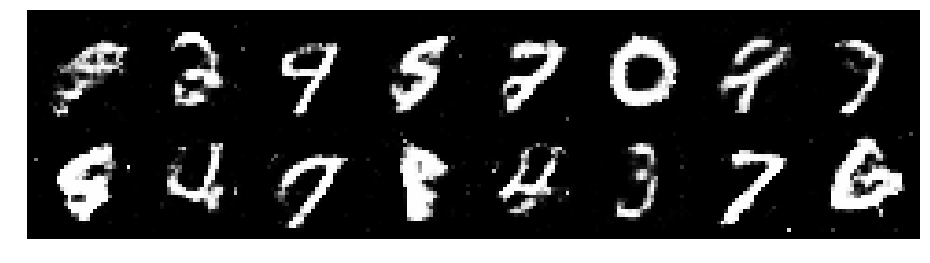

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8539
D(x): 0.5414, D(G(z)): 0.4403


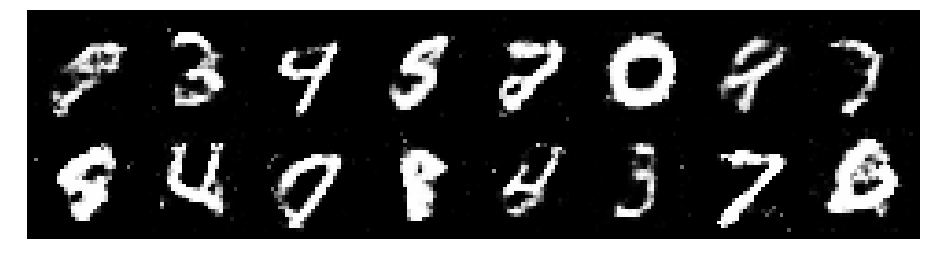

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2860, Generator Loss: 0.8072
D(x): 0.5684, D(G(z)): 0.4522


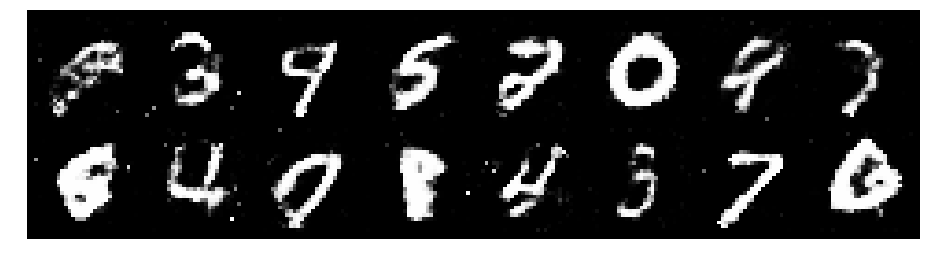

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8481
D(x): 0.5456, D(G(z)): 0.4611


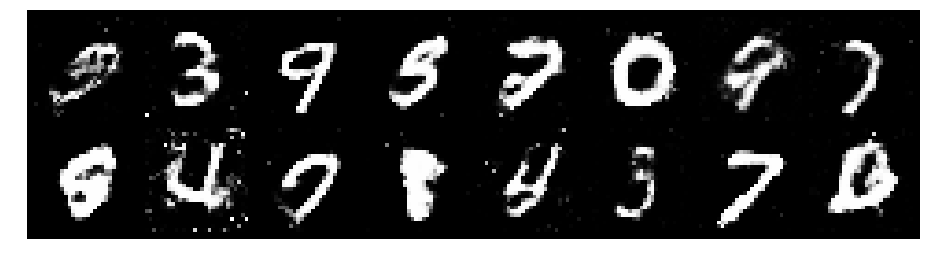

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8316
D(x): 0.5299, D(G(z)): 0.4563


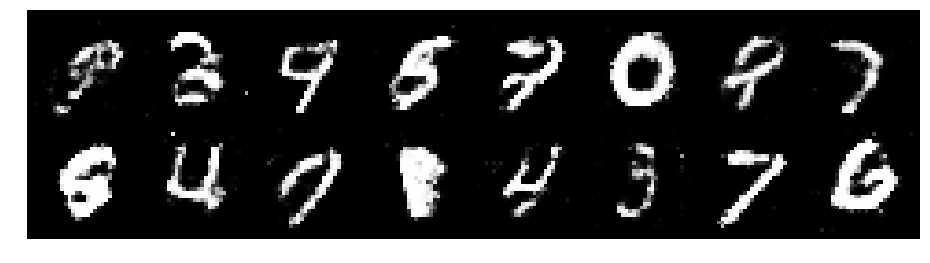

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.1725, Generator Loss: 1.1342
D(x): 0.5566, D(G(z)): 0.3721


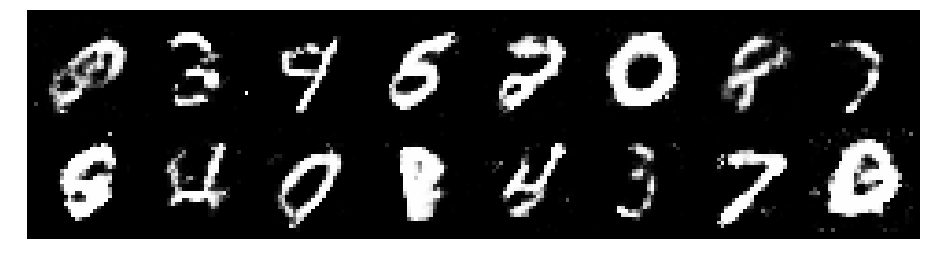

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 0.8990
D(x): 0.5222, D(G(z)): 0.4198


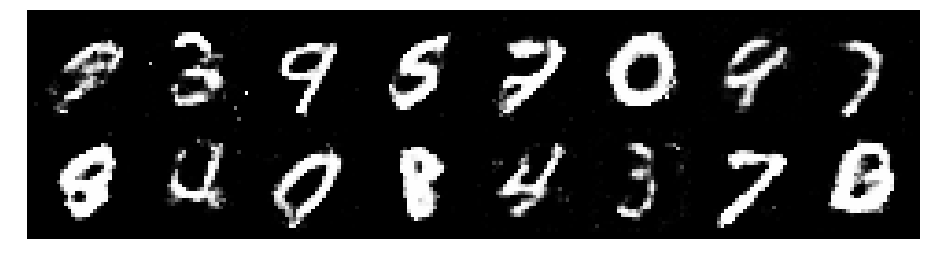

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2063, Generator Loss: 0.9064
D(x): 0.5399, D(G(z)): 0.4017


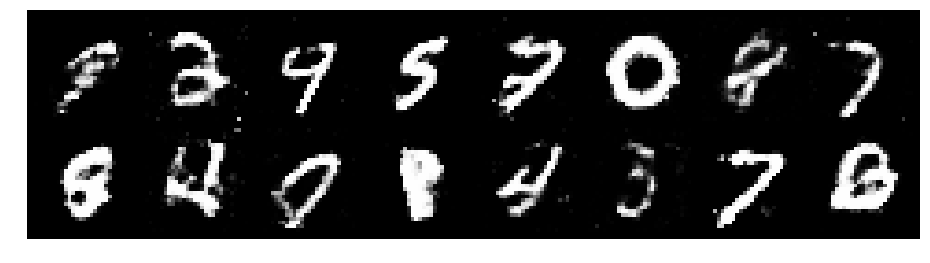

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3346, Generator Loss: 0.7858
D(x): 0.5461, D(G(z)): 0.4634


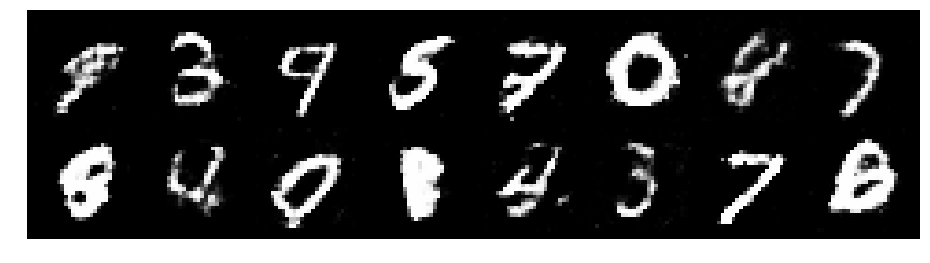

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2824, Generator Loss: 0.8699
D(x): 0.5531, D(G(z)): 0.4578


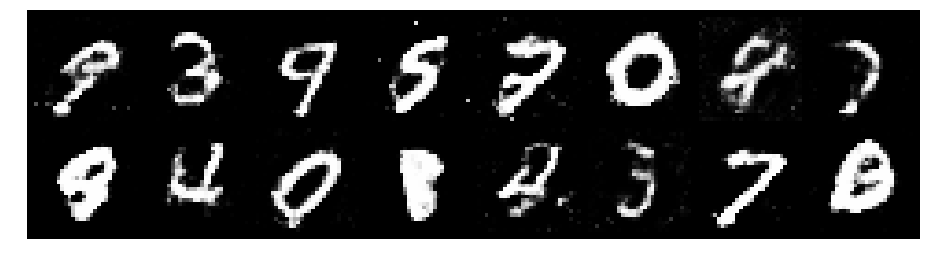

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.1963, Generator Loss: 0.9111
D(x): 0.5406, D(G(z)): 0.3962


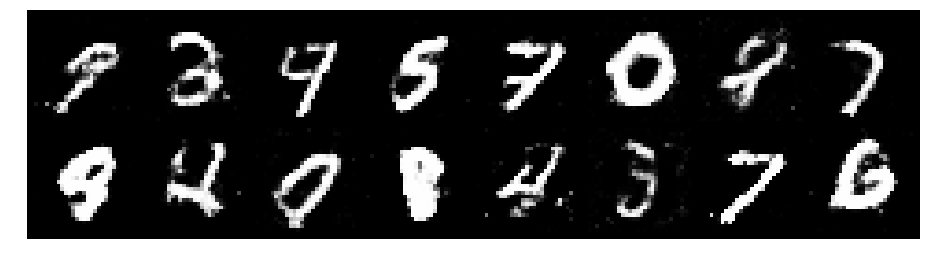

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2861, Generator Loss: 0.9505
D(x): 0.5439, D(G(z)): 0.4279


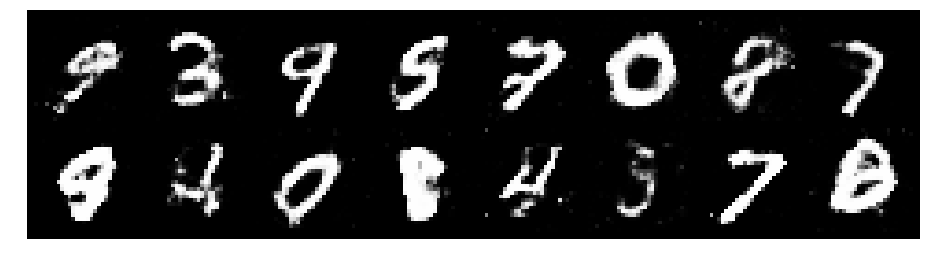

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8982
D(x): 0.5233, D(G(z)): 0.4649


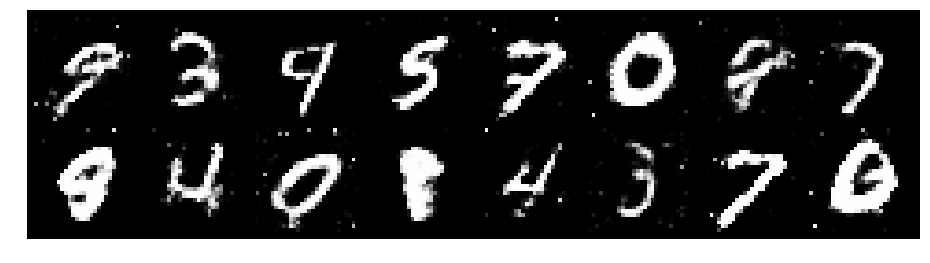

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3511, Generator Loss: 0.8303
D(x): 0.5445, D(G(z)): 0.4706


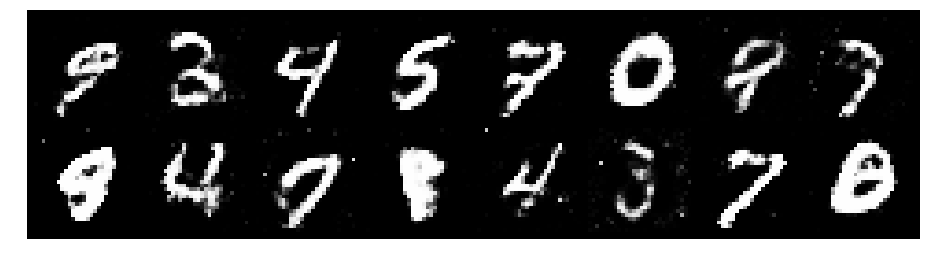

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2432, Generator Loss: 0.8792
D(x): 0.5636, D(G(z)): 0.4394


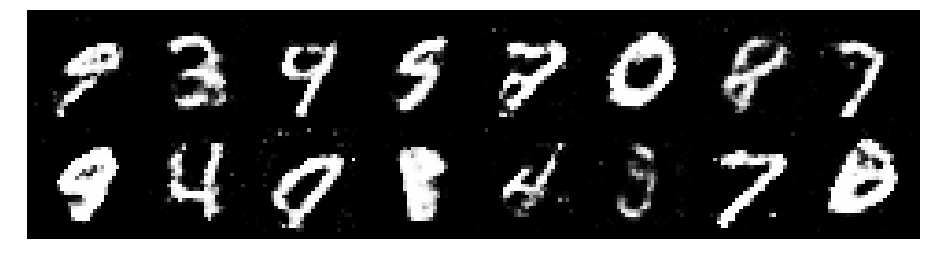

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.3119, Generator Loss: 0.8632
D(x): 0.5238, D(G(z)): 0.4597


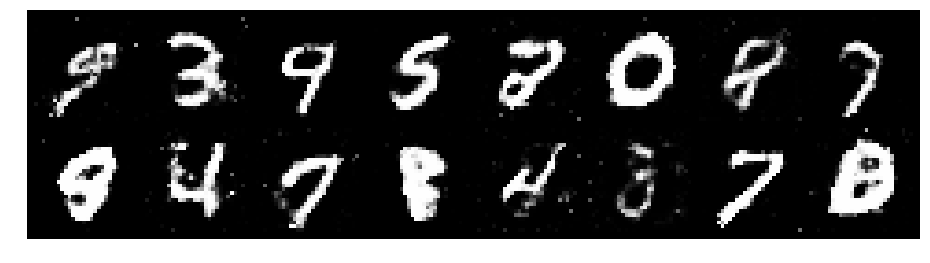

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2847, Generator Loss: 0.9553
D(x): 0.5431, D(G(z)): 0.4196


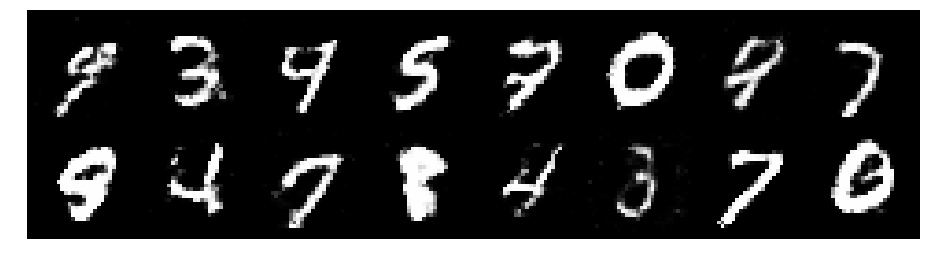

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2881, Generator Loss: 0.8151
D(x): 0.5508, D(G(z)): 0.4588


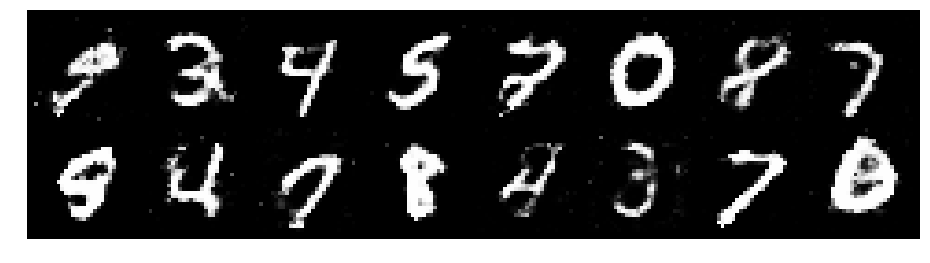

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2455, Generator Loss: 0.9647
D(x): 0.5624, D(G(z)): 0.4239


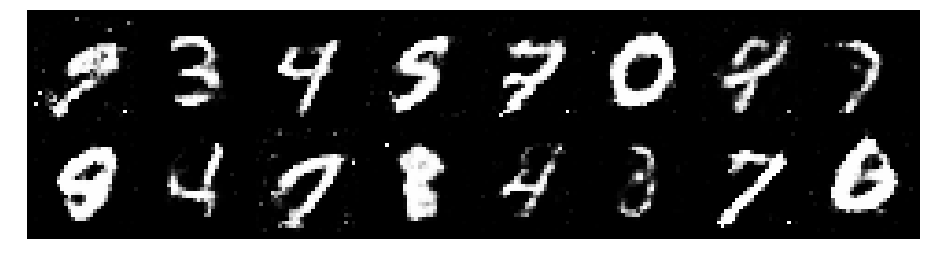

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9181
D(x): 0.5503, D(G(z)): 0.4095


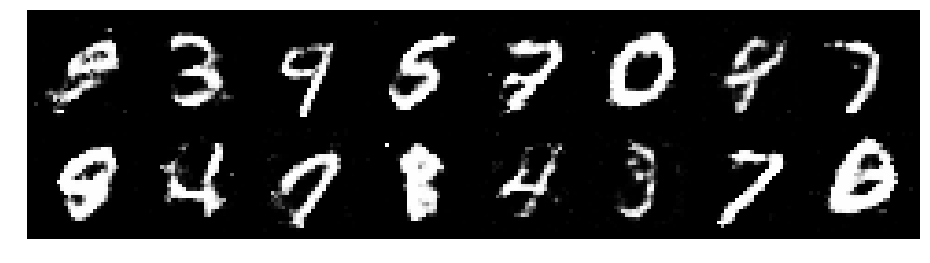

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3009, Generator Loss: 0.7783
D(x): 0.5929, D(G(z)): 0.4778


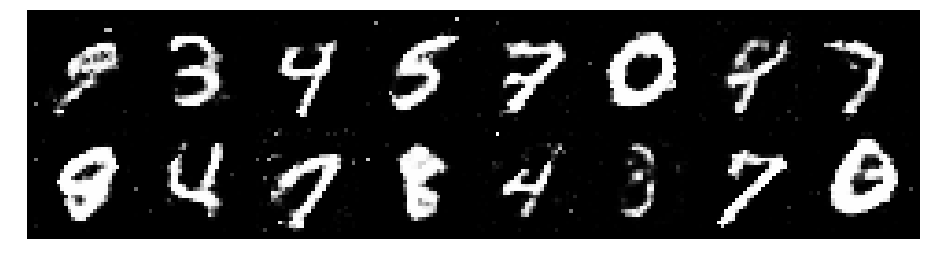

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.3528, Generator Loss: 0.9226
D(x): 0.5296, D(G(z)): 0.4482


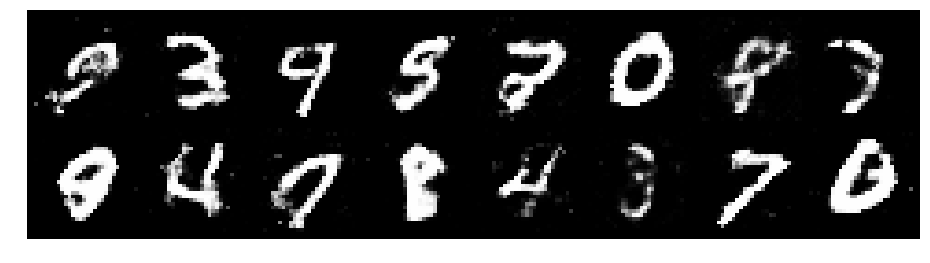

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8963
D(x): 0.5639, D(G(z)): 0.4532


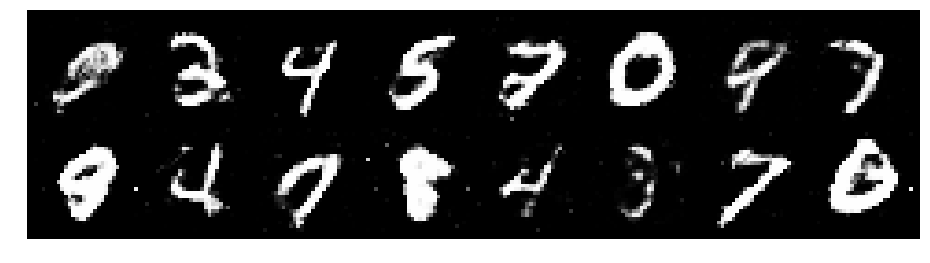

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2087, Generator Loss: 0.9303
D(x): 0.5541, D(G(z)): 0.4045


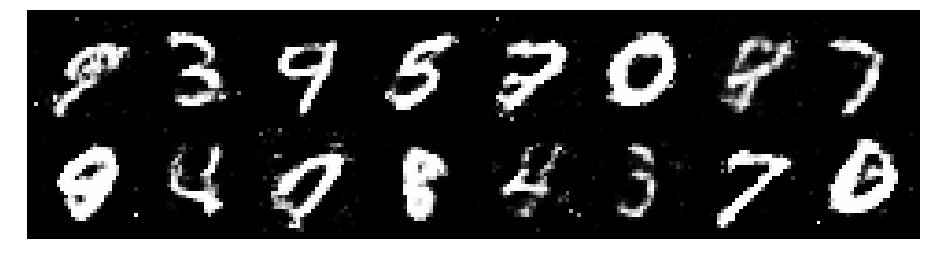

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3336, Generator Loss: 0.8692
D(x): 0.5357, D(G(z)): 0.4584


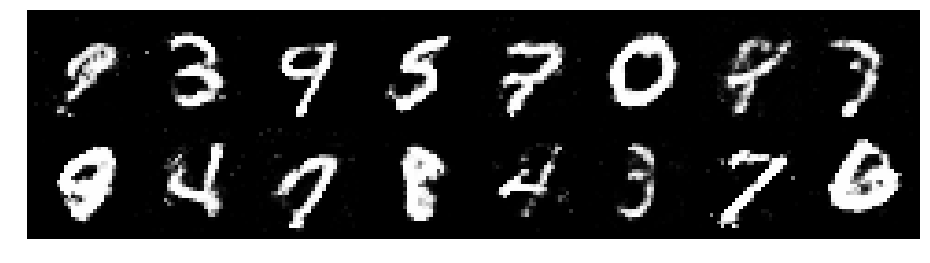

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2607, Generator Loss: 0.9414
D(x): 0.5762, D(G(z)): 0.4644


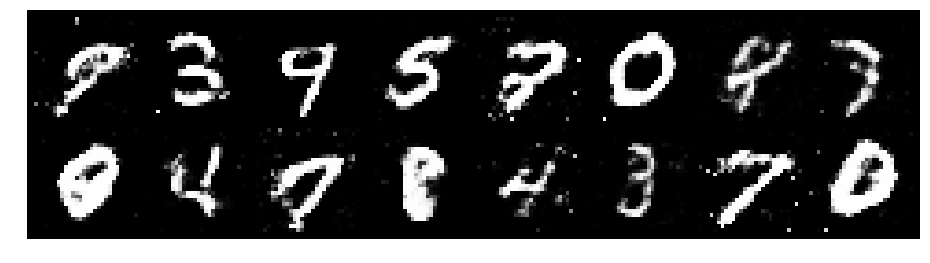

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2741, Generator Loss: 0.8466
D(x): 0.5529, D(G(z)): 0.4641


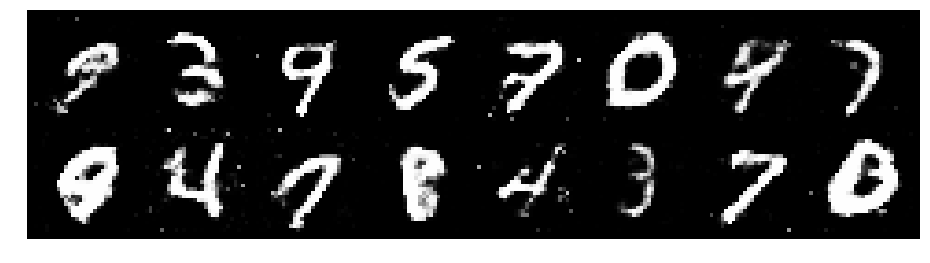

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2616, Generator Loss: 0.7976
D(x): 0.5817, D(G(z)): 0.4556


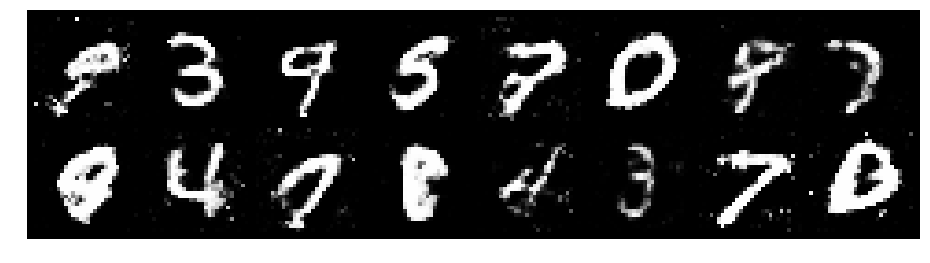

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2361, Generator Loss: 0.8292
D(x): 0.5918, D(G(z)): 0.4492


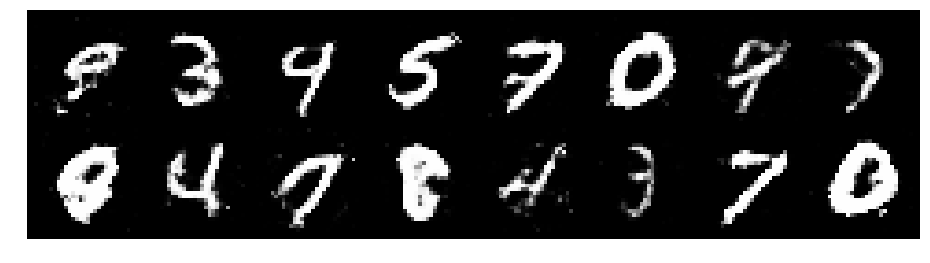

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3218, Generator Loss: 0.7908
D(x): 0.5650, D(G(z)): 0.4812


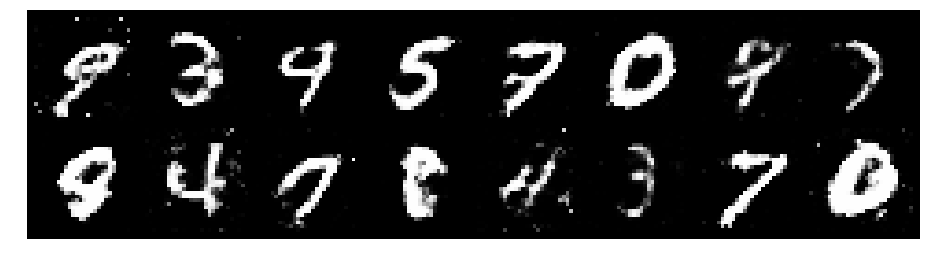

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.3109, Generator Loss: 0.9663
D(x): 0.5193, D(G(z)): 0.4318


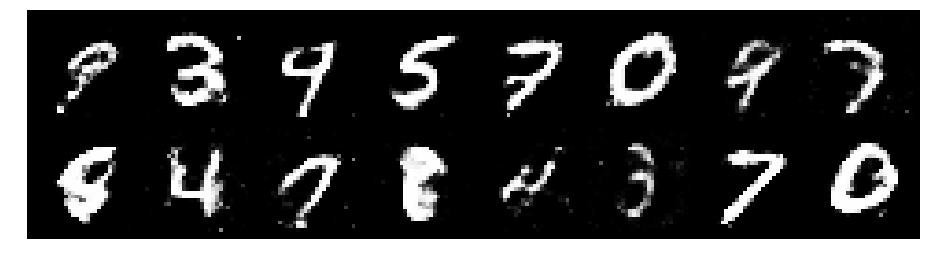

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.1610, Generator Loss: 0.8760
D(x): 0.6041, D(G(z)): 0.4351


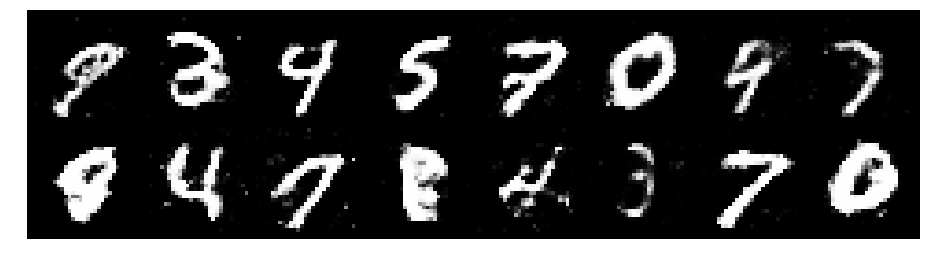

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2802, Generator Loss: 0.9001
D(x): 0.5675, D(G(z)): 0.4594


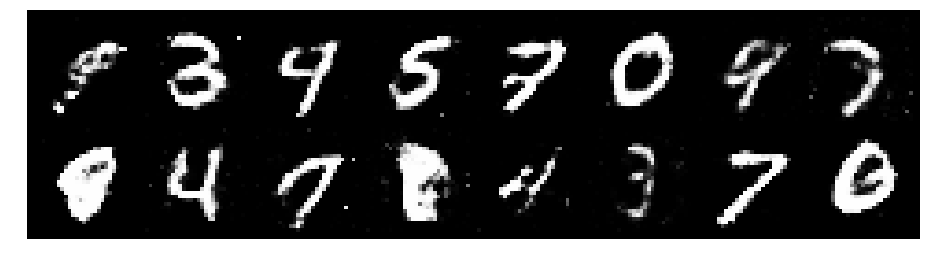

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3006, Generator Loss: 0.8645
D(x): 0.5484, D(G(z)): 0.4697


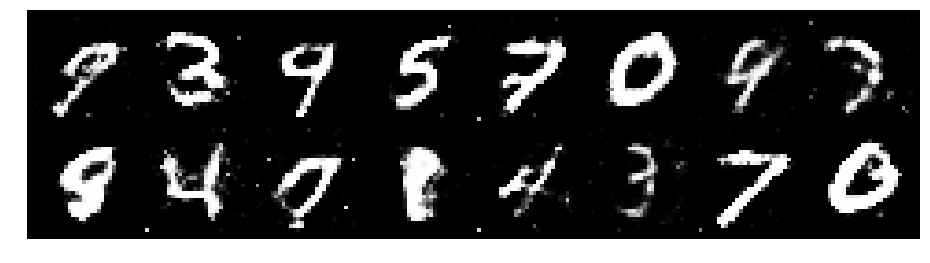

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.3384, Generator Loss: 0.8287
D(x): 0.5436, D(G(z)): 0.4690


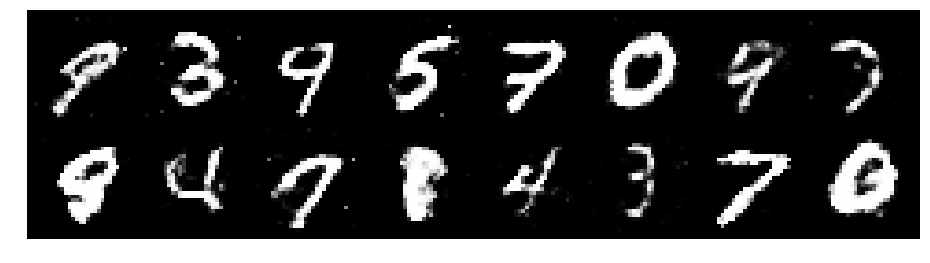

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2648, Generator Loss: 0.9012
D(x): 0.5483, D(G(z)): 0.4252


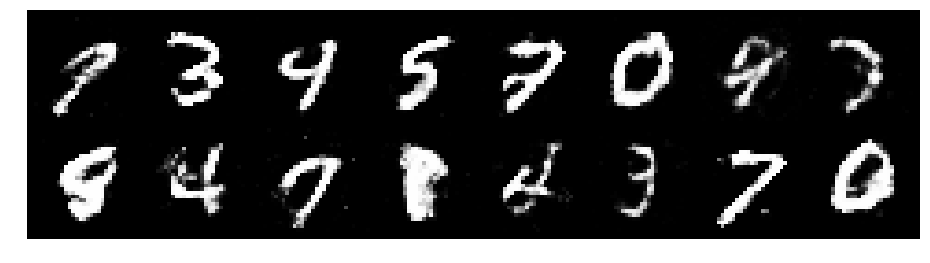

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3377, Generator Loss: 0.9136
D(x): 0.5646, D(G(z)): 0.4828


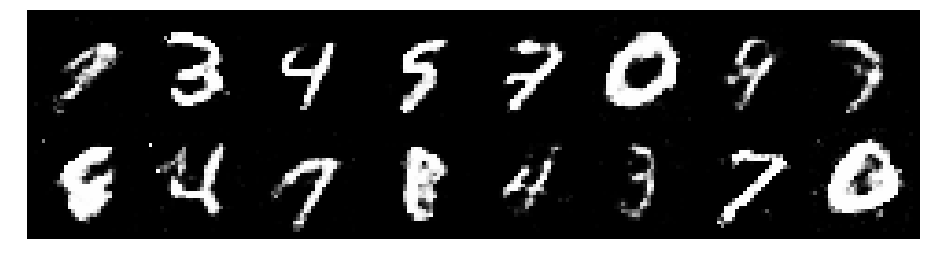

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3775, Generator Loss: 0.8216
D(x): 0.5317, D(G(z)): 0.4602


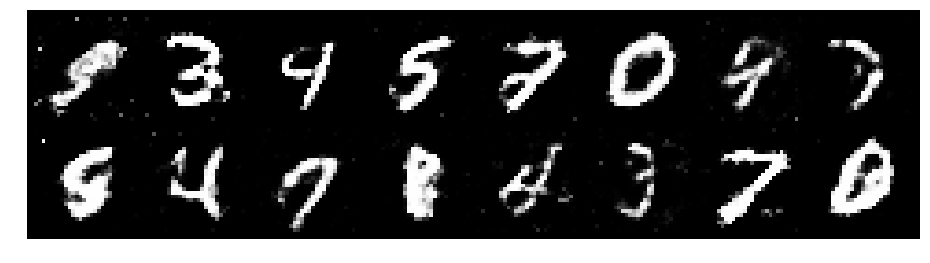

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8984
D(x): 0.5558, D(G(z)): 0.4558


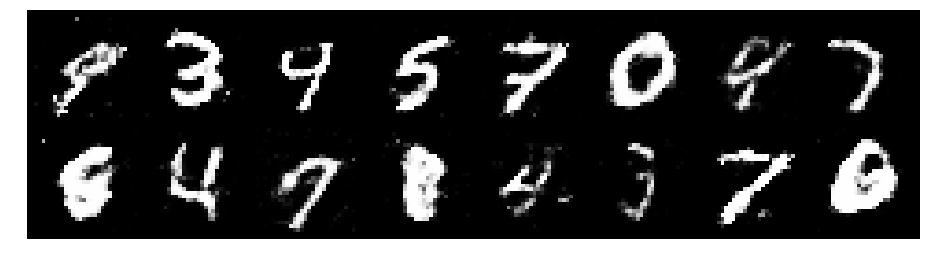

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2469, Generator Loss: 0.9086
D(x): 0.5586, D(G(z)): 0.4412


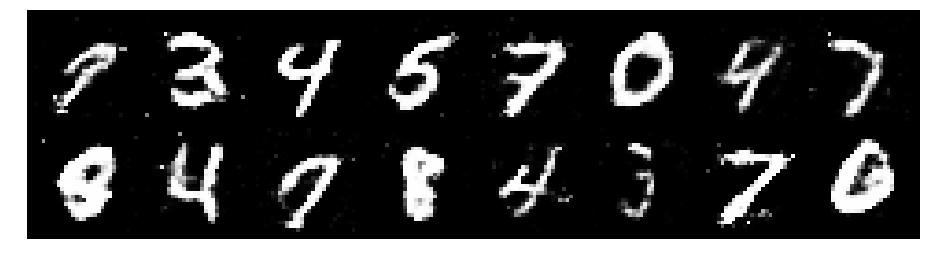

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3205, Generator Loss: 0.7667
D(x): 0.5831, D(G(z)): 0.4969


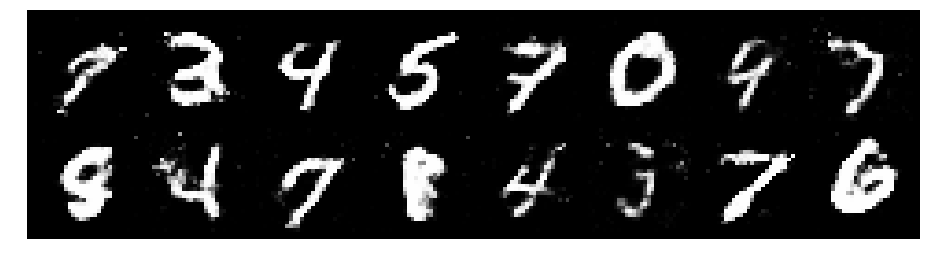

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3247, Generator Loss: 0.8024
D(x): 0.5808, D(G(z)): 0.5003


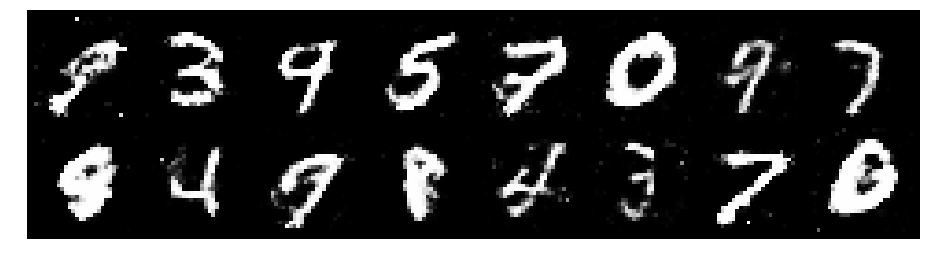

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2501, Generator Loss: 0.9021
D(x): 0.5853, D(G(z)): 0.4566


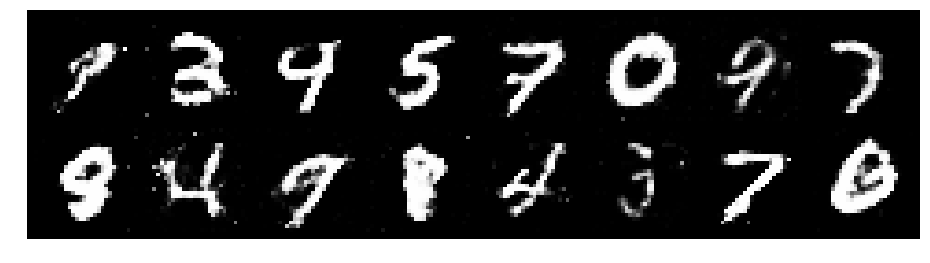

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.3123, Generator Loss: 0.9822
D(x): 0.5685, D(G(z)): 0.4379


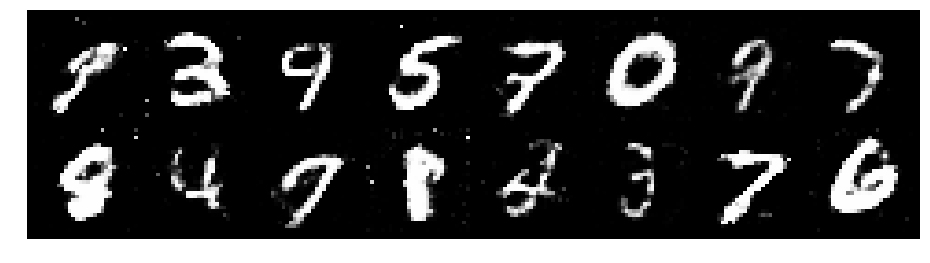

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.1758, Generator Loss: 0.9844
D(x): 0.5888, D(G(z)): 0.4123


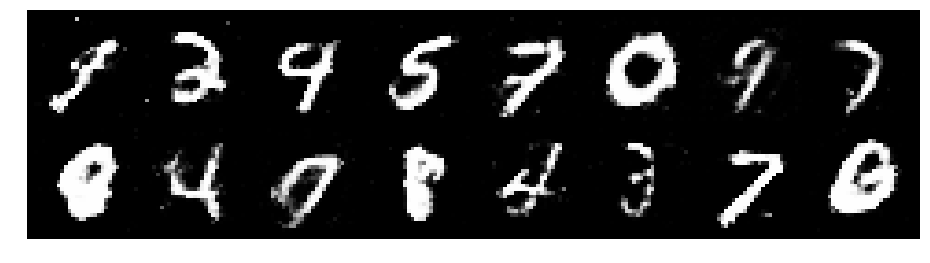

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3059, Generator Loss: 1.0687
D(x): 0.5471, D(G(z)): 0.4121


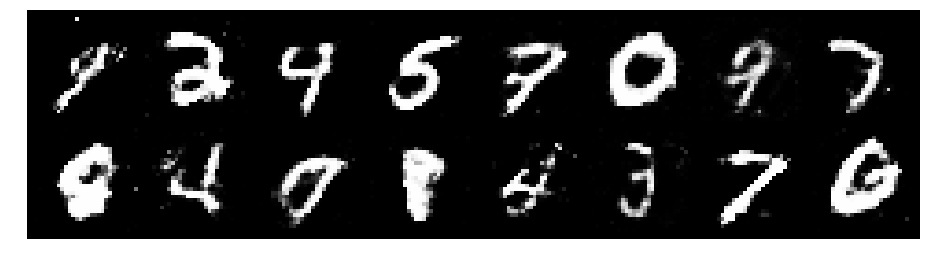

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.1820, Generator Loss: 0.8658
D(x): 0.5760, D(G(z)): 0.4293


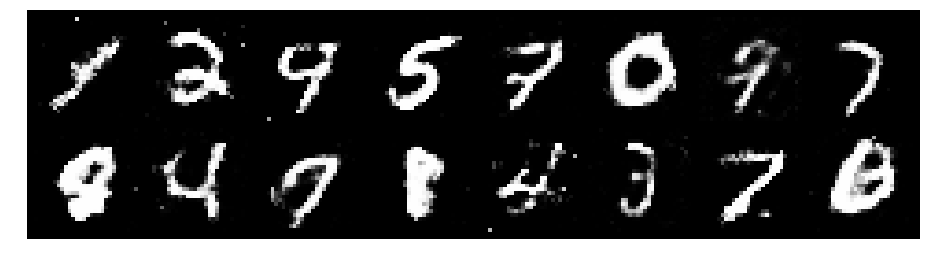

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.4029, Generator Loss: 0.8688
D(x): 0.5013, D(G(z)): 0.4495


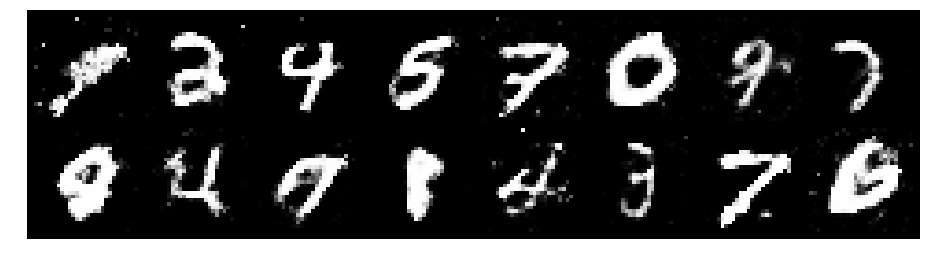

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2415, Generator Loss: 0.8277
D(x): 0.5365, D(G(z)): 0.4195


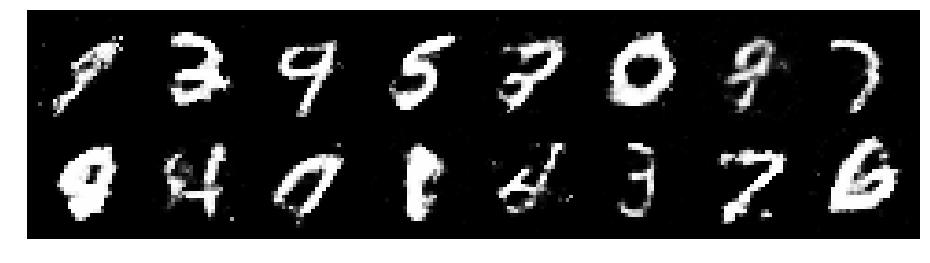

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3051, Generator Loss: 0.8136
D(x): 0.5265, D(G(z)): 0.4512


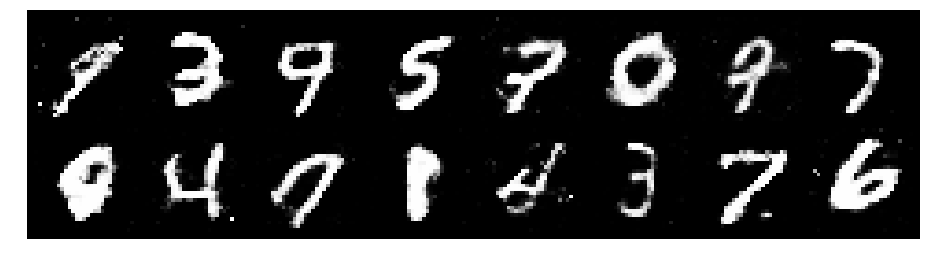

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9219
D(x): 0.5623, D(G(z)): 0.4315


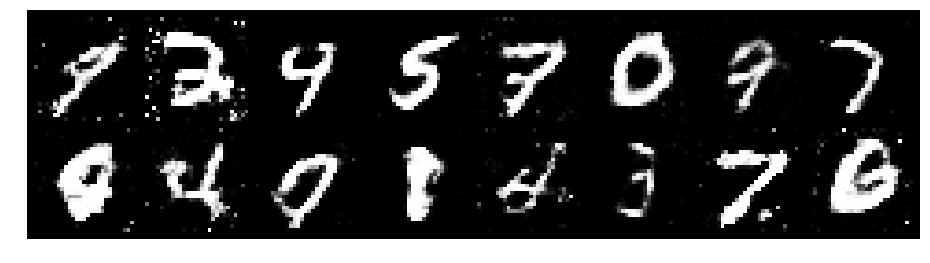

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3087, Generator Loss: 0.9555
D(x): 0.5381, D(G(z)): 0.4363


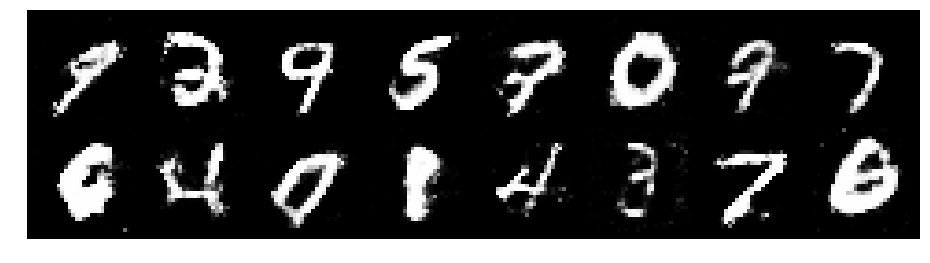

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8922
D(x): 0.5404, D(G(z)): 0.4098


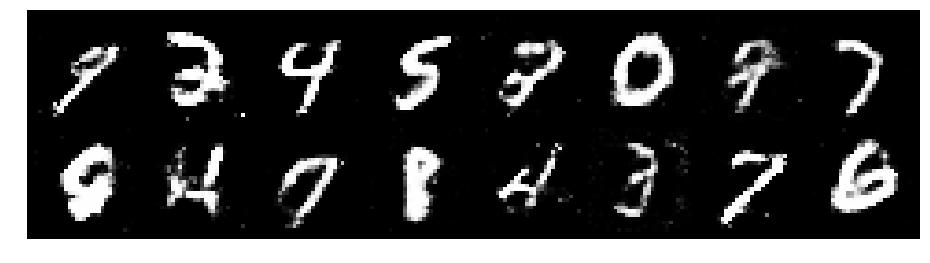

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2838, Generator Loss: 0.9359
D(x): 0.5462, D(G(z)): 0.4455


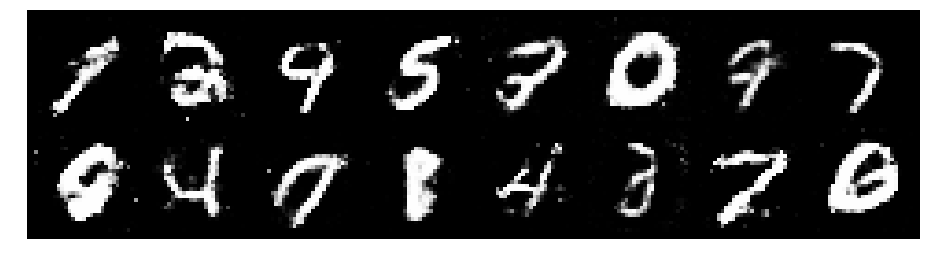

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2341, Generator Loss: 0.8977
D(x): 0.5533, D(G(z)): 0.4349


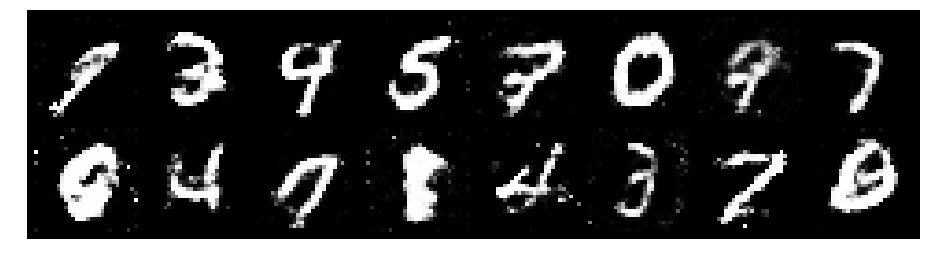

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2339, Generator Loss: 1.0229
D(x): 0.5334, D(G(z)): 0.4158


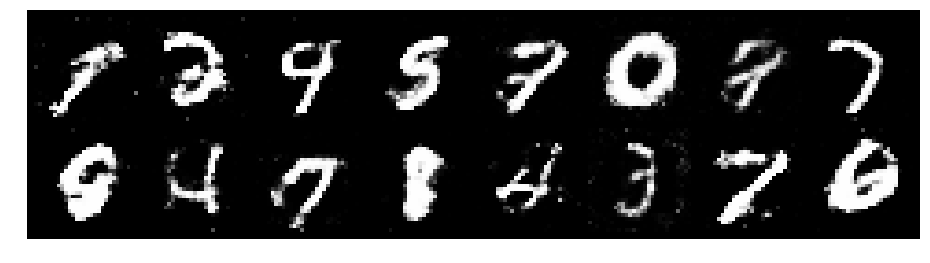

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2584, Generator Loss: 0.8486
D(x): 0.5778, D(G(z)): 0.4531


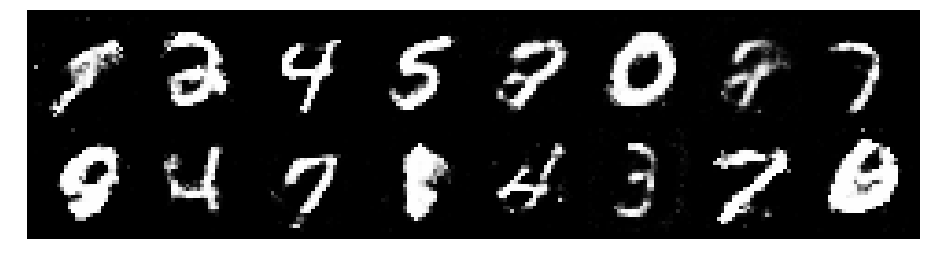

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.3633, Generator Loss: 0.7545
D(x): 0.5046, D(G(z)): 0.4631


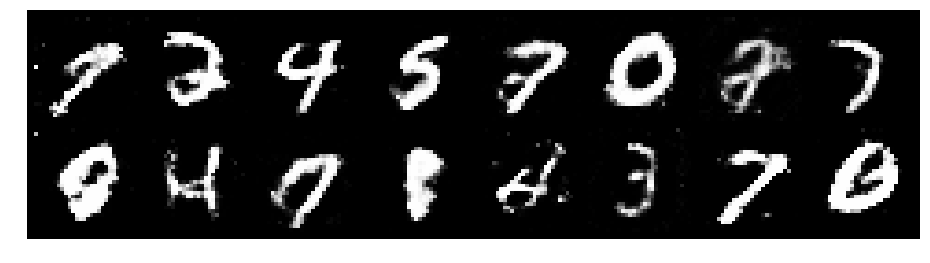

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 0.8196
D(x): 0.5534, D(G(z)): 0.4503


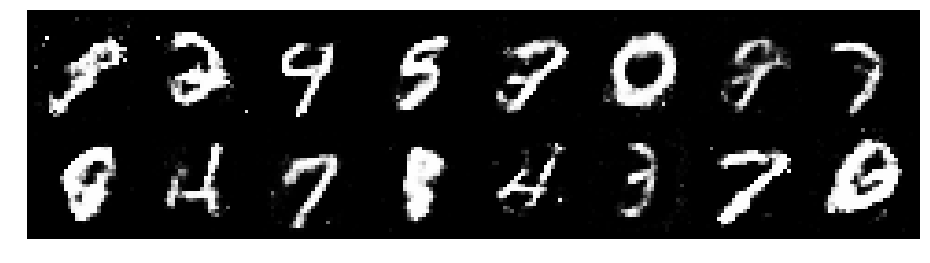

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2398, Generator Loss: 0.8479
D(x): 0.5363, D(G(z)): 0.4306


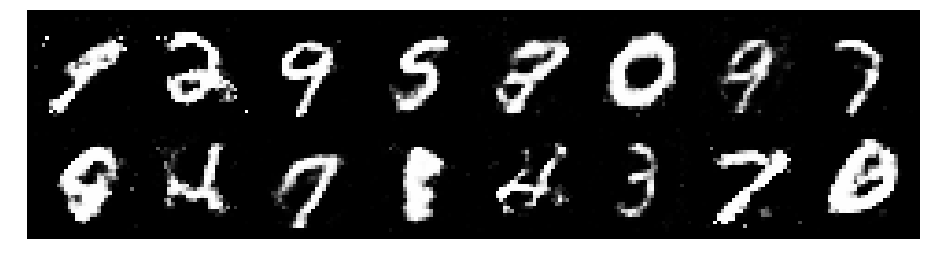

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2950, Generator Loss: 0.7910
D(x): 0.5820, D(G(z)): 0.4788


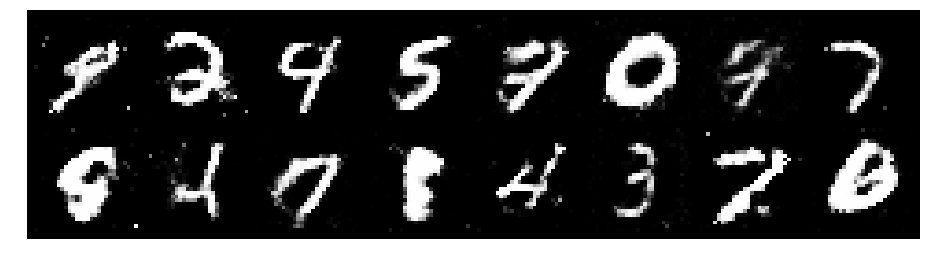

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.3989, Generator Loss: 0.9015
D(x): 0.5212, D(G(z)): 0.4751


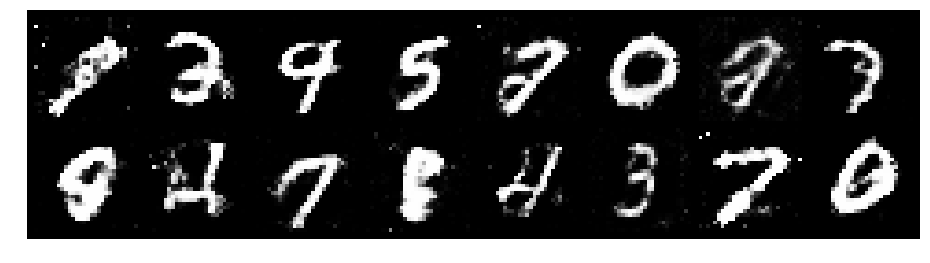

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9057
D(x): 0.5290, D(G(z)): 0.4245


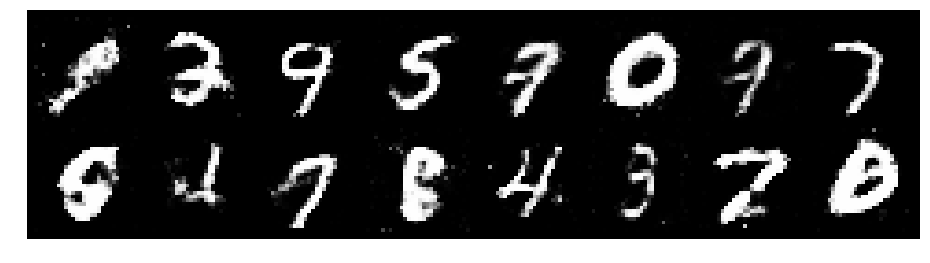

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2304, Generator Loss: 0.9480
D(x): 0.5723, D(G(z)): 0.4456


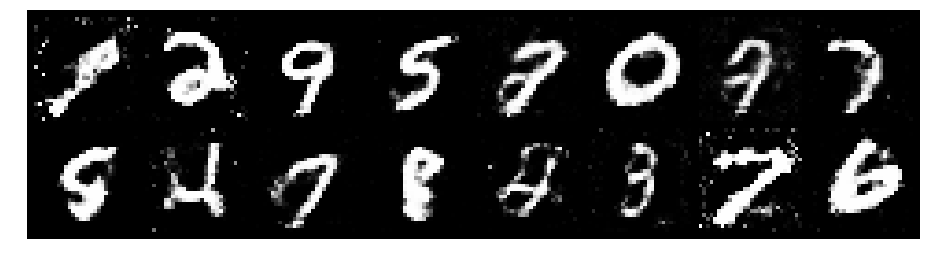

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2323, Generator Loss: 0.9777
D(x): 0.5662, D(G(z)): 0.4134


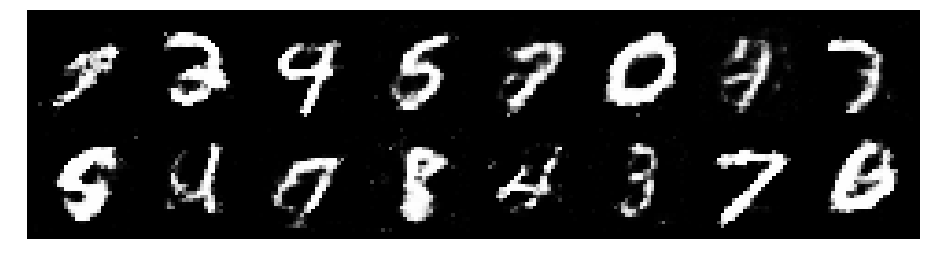

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.1867, Generator Loss: 1.0513
D(x): 0.5681, D(G(z)): 0.4194


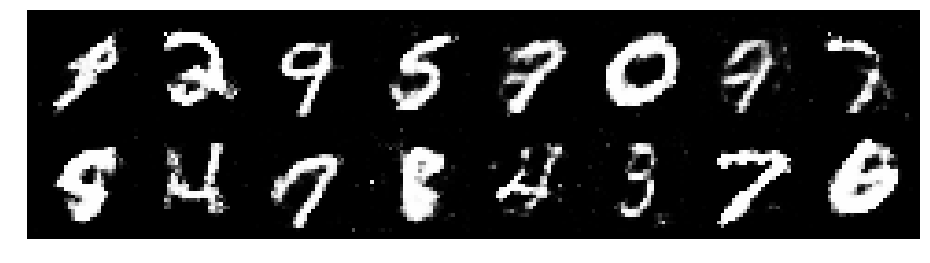

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2256, Generator Loss: 0.8154
D(x): 0.6270, D(G(z)): 0.4743


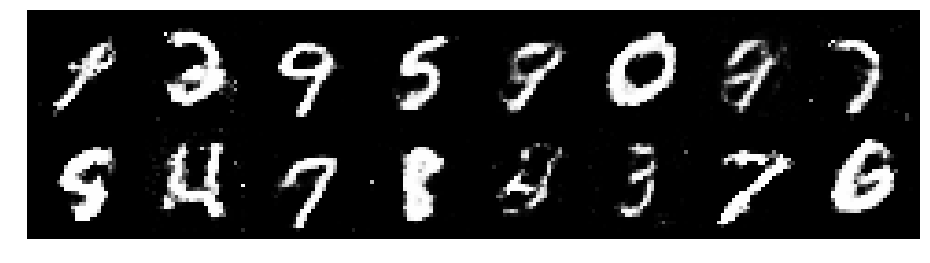

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2131, Generator Loss: 0.8685
D(x): 0.6048, D(G(z)): 0.4512


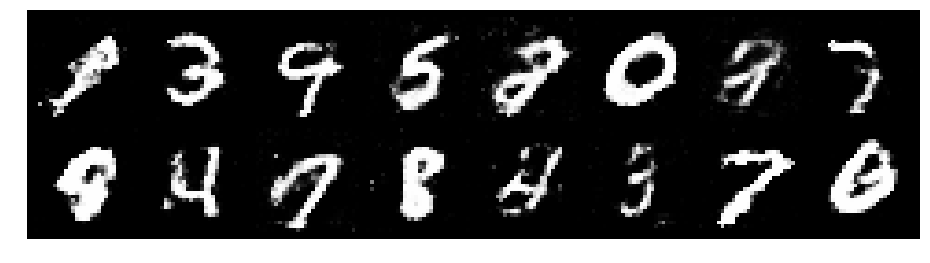

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2625, Generator Loss: 0.9298
D(x): 0.5550, D(G(z)): 0.4340


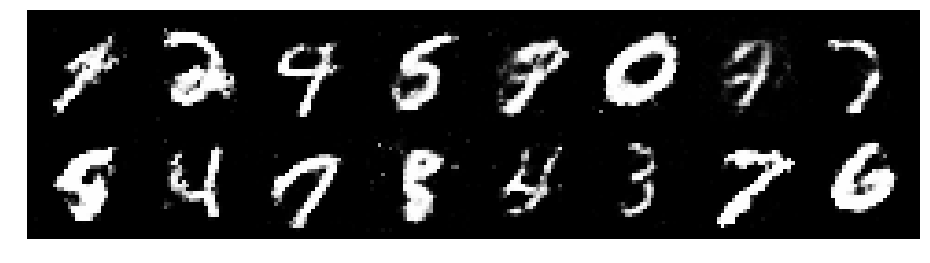

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2076, Generator Loss: 1.0297
D(x): 0.5614, D(G(z)): 0.4281


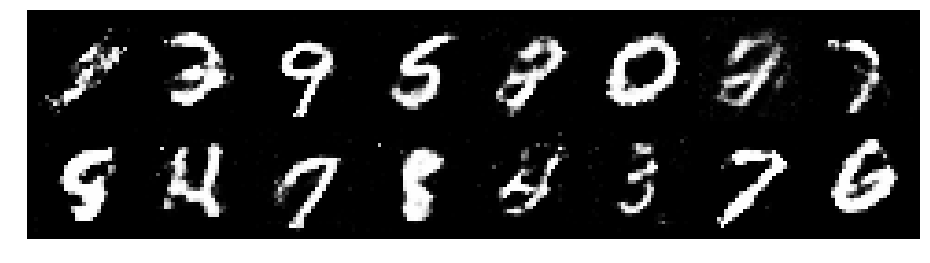

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3748, Generator Loss: 0.7582
D(x): 0.5293, D(G(z)): 0.4851


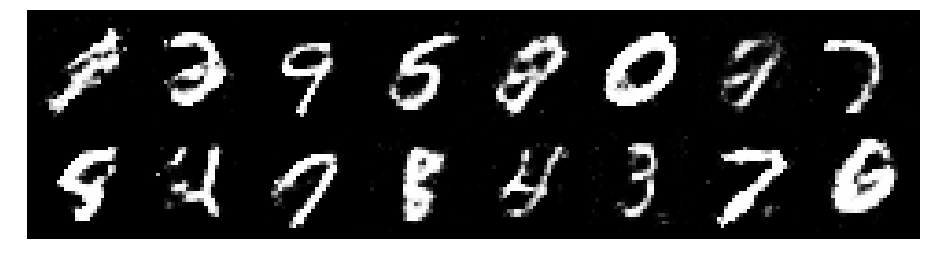

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.1033, Generator Loss: 0.9939
D(x): 0.5773, D(G(z)): 0.3776


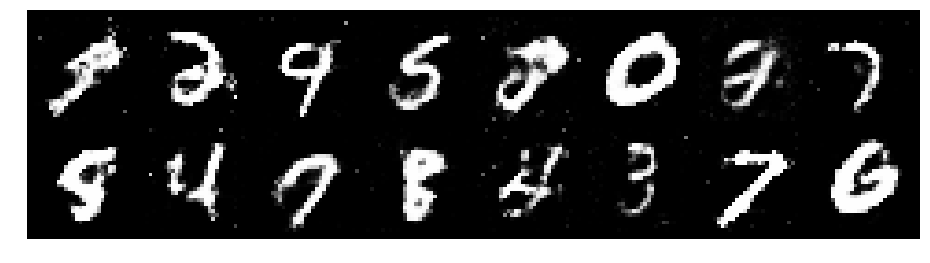

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2255, Generator Loss: 0.8839
D(x): 0.5441, D(G(z)): 0.4194


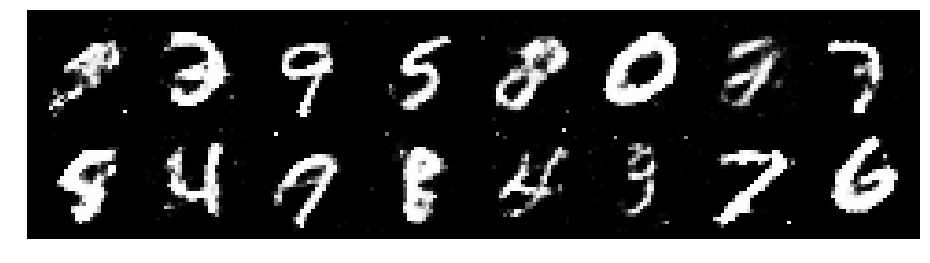

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2851, Generator Loss: 0.8368
D(x): 0.5303, D(G(z)): 0.4348


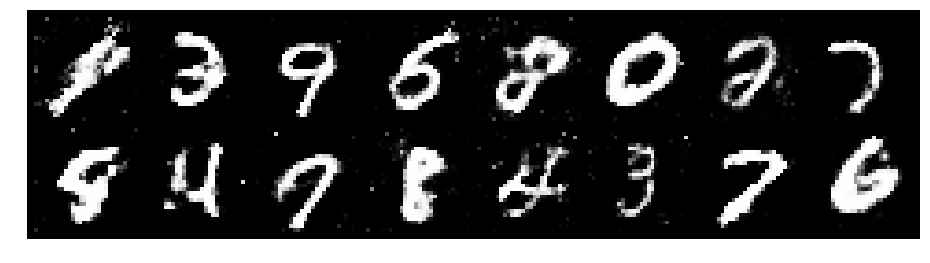

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2364, Generator Loss: 0.8885
D(x): 0.5354, D(G(z)): 0.4134


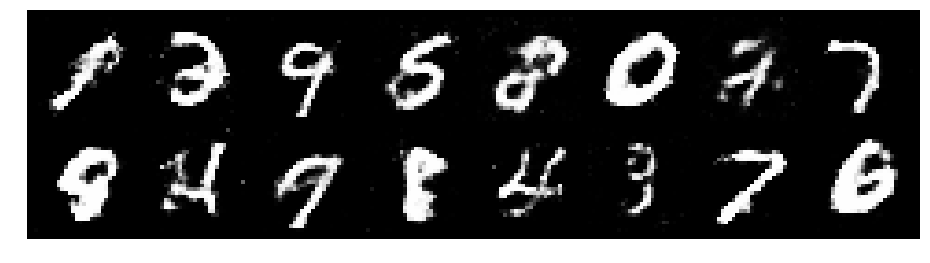

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2472, Generator Loss: 0.7821
D(x): 0.5840, D(G(z)): 0.4667


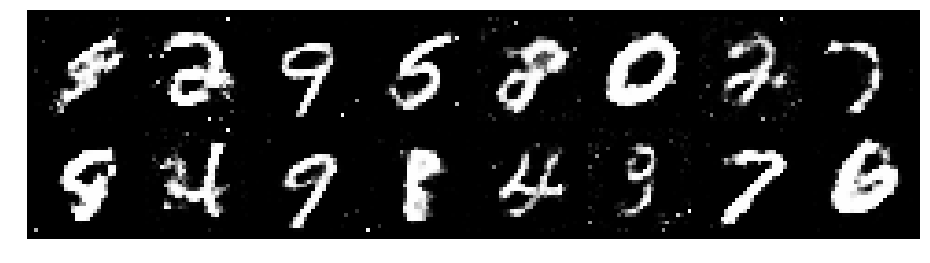

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8021
D(x): 0.5406, D(G(z)): 0.4706


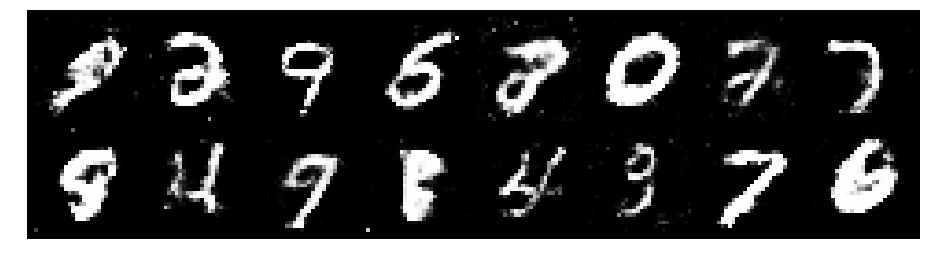

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.1877, Generator Loss: 0.9007
D(x): 0.5969, D(G(z)): 0.4450


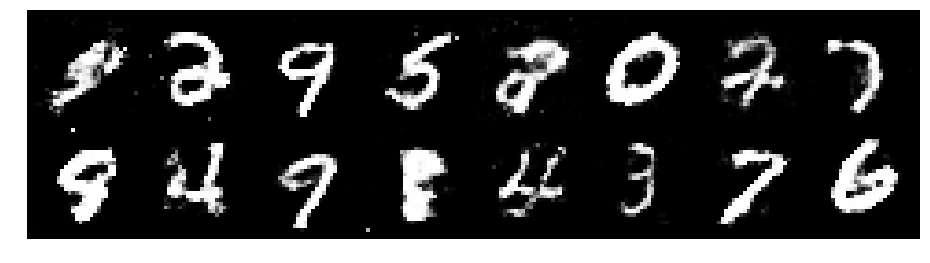

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3447, Generator Loss: 0.8286
D(x): 0.5451, D(G(z)): 0.4709


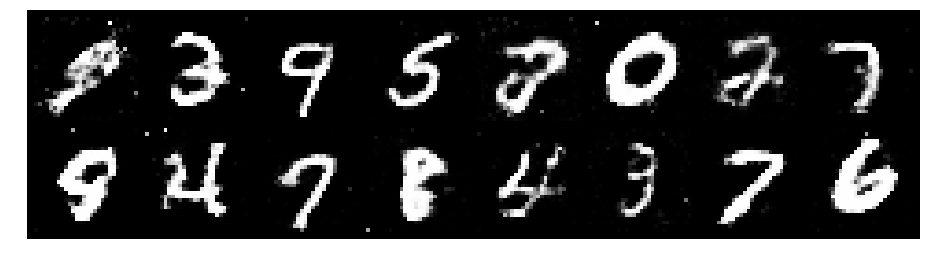

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2631, Generator Loss: 0.8397
D(x): 0.5614, D(G(z)): 0.4432


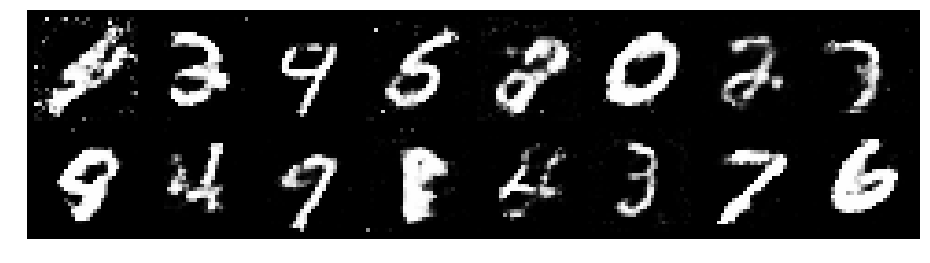

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2247, Generator Loss: 0.9150
D(x): 0.5481, D(G(z)): 0.4097


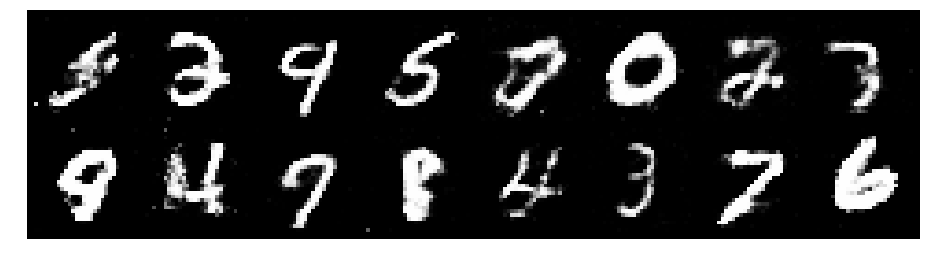

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2502, Generator Loss: 1.0129
D(x): 0.5698, D(G(z)): 0.4365


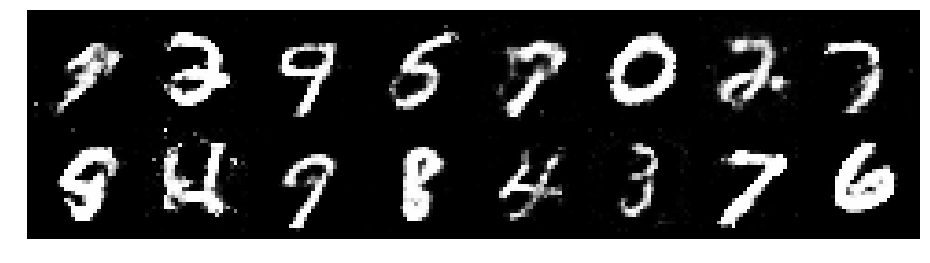

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2431, Generator Loss: 0.7992
D(x): 0.5405, D(G(z)): 0.4146


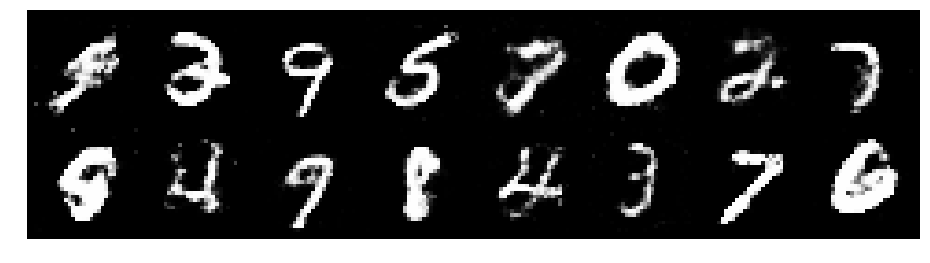

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2541, Generator Loss: 0.8693
D(x): 0.5522, D(G(z)): 0.4411


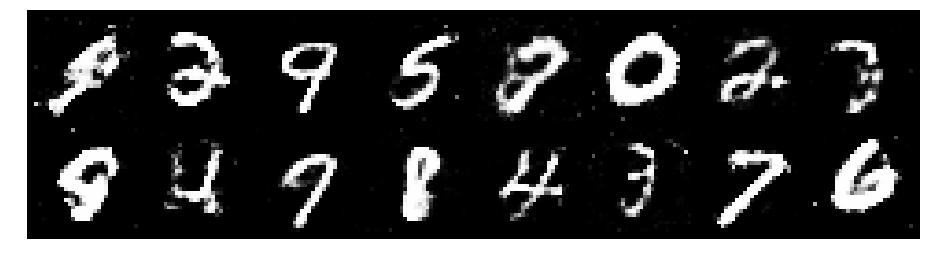

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2069, Generator Loss: 0.7911
D(x): 0.5972, D(G(z)): 0.4685


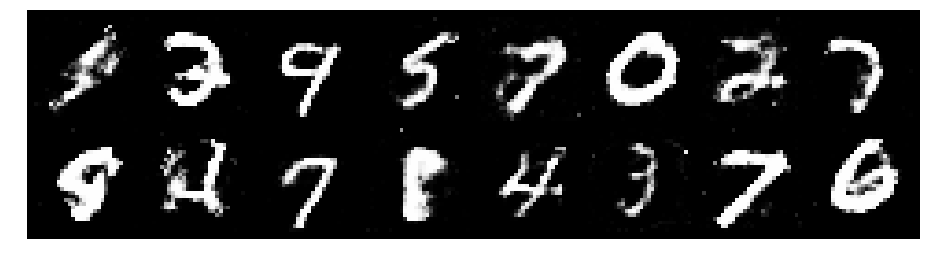

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9243
D(x): 0.5772, D(G(z)): 0.4395


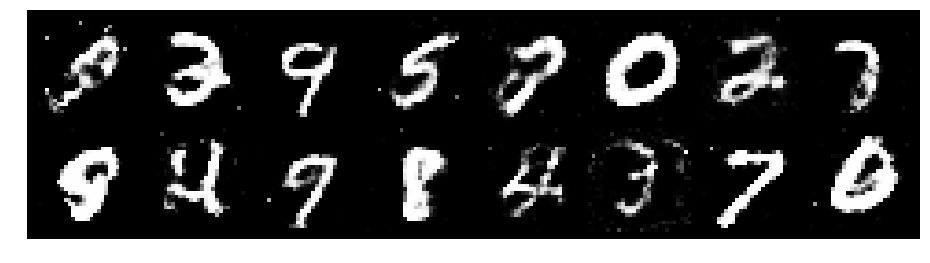

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.1800, Generator Loss: 0.9114
D(x): 0.5784, D(G(z)): 0.4116


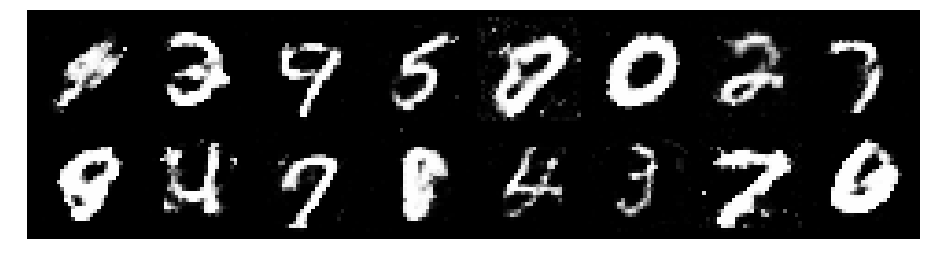

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3323, Generator Loss: 0.9777
D(x): 0.5151, D(G(z)): 0.4371


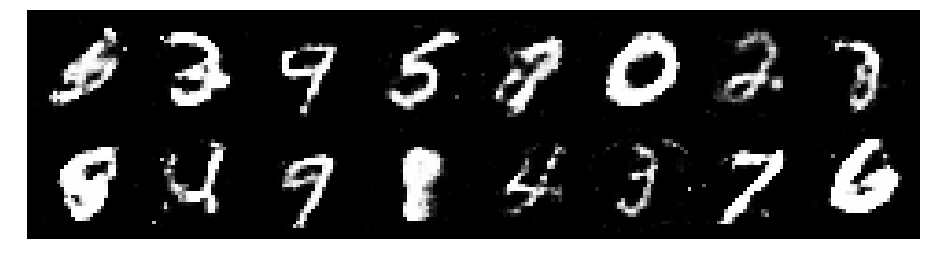

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3589, Generator Loss: 0.9677
D(x): 0.5397, D(G(z)): 0.4824


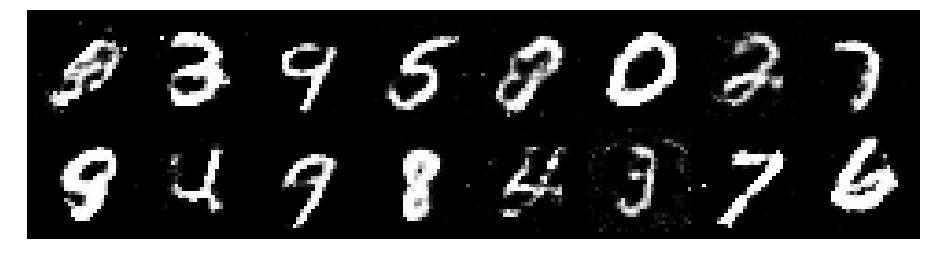

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1622, Generator Loss: 0.8284
D(x): 0.5796, D(G(z)): 0.4178


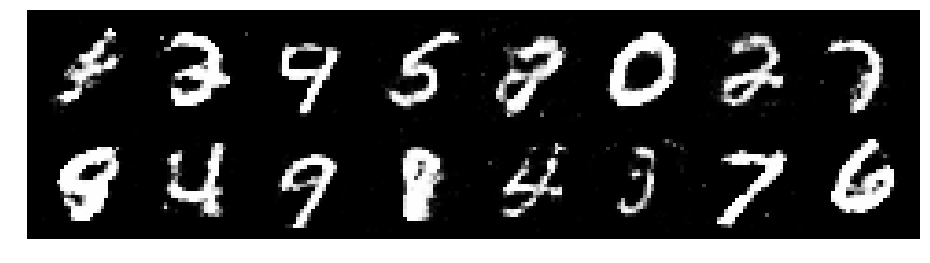

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2533, Generator Loss: 1.0067
D(x): 0.5272, D(G(z)): 0.4044


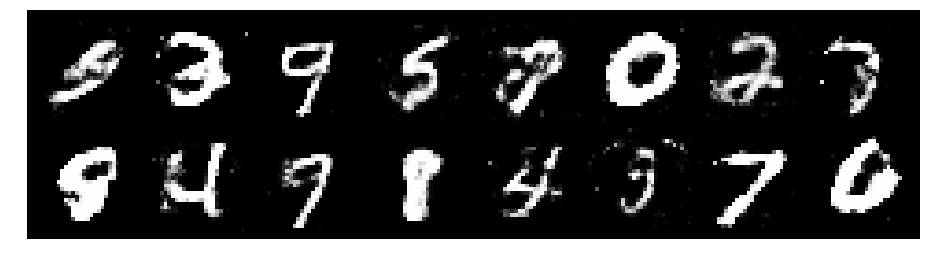

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8489
D(x): 0.5699, D(G(z)): 0.4652


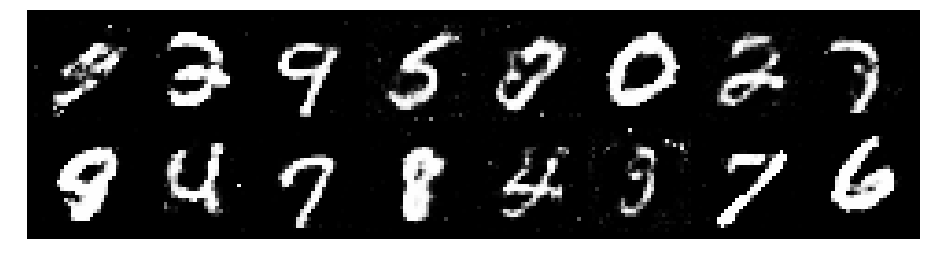

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3134, Generator Loss: 0.8230
D(x): 0.5226, D(G(z)): 0.4564


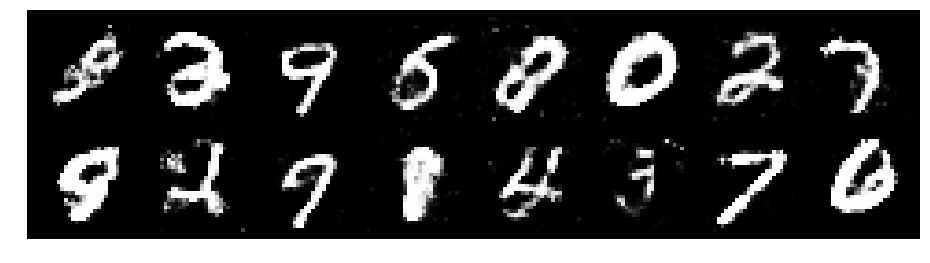

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2526, Generator Loss: 1.0019
D(x): 0.5440, D(G(z)): 0.4186


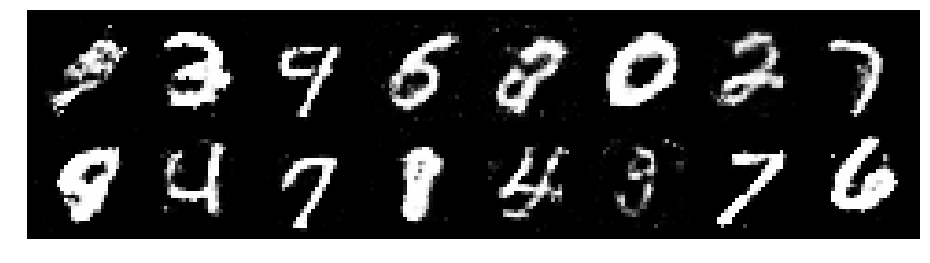

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.1622, Generator Loss: 0.9342
D(x): 0.5731, D(G(z)): 0.4106


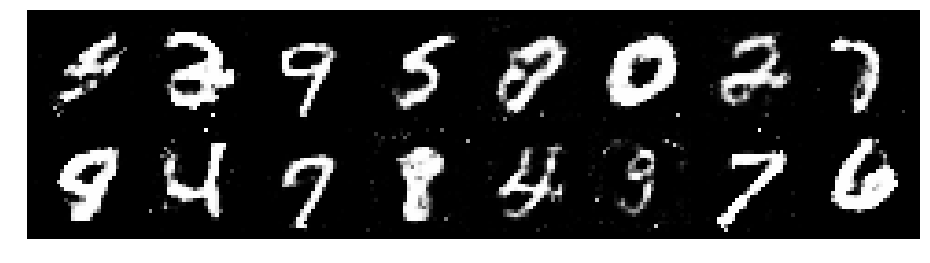

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.4183, Generator Loss: 0.8011
D(x): 0.4914, D(G(z)): 0.4499


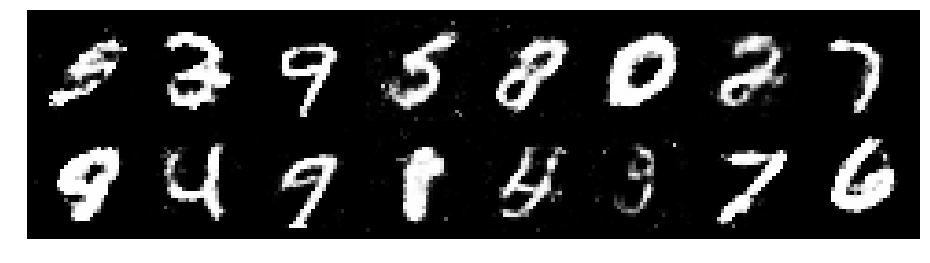

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8204
D(x): 0.5625, D(G(z)): 0.4513


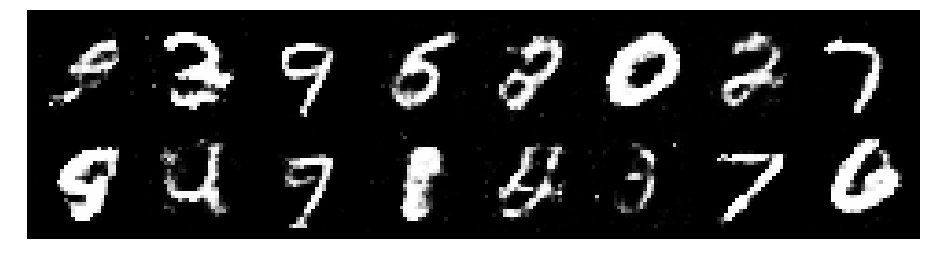

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2141, Generator Loss: 0.8161
D(x): 0.5655, D(G(z)): 0.4479


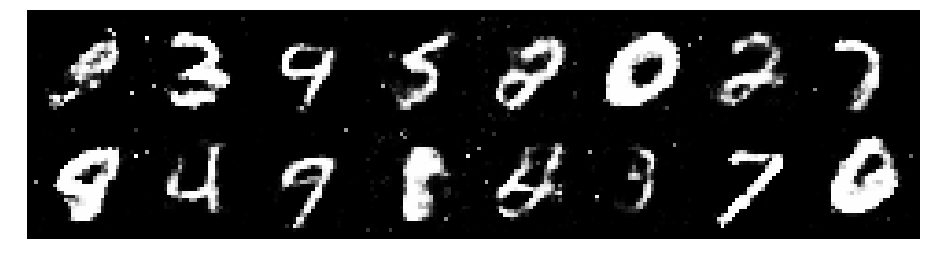

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2840, Generator Loss: 0.9245
D(x): 0.5345, D(G(z)): 0.4323


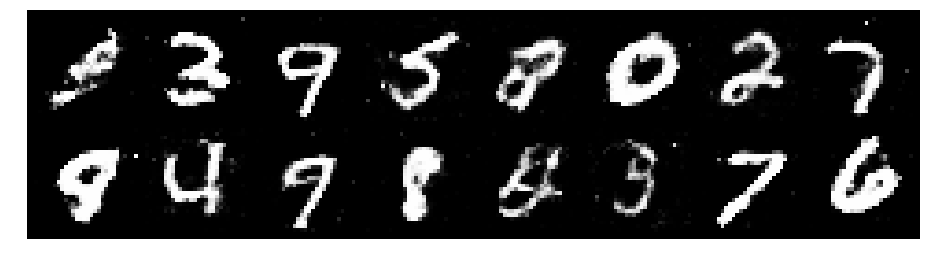

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2214, Generator Loss: 0.9210
D(x): 0.5200, D(G(z)): 0.3799


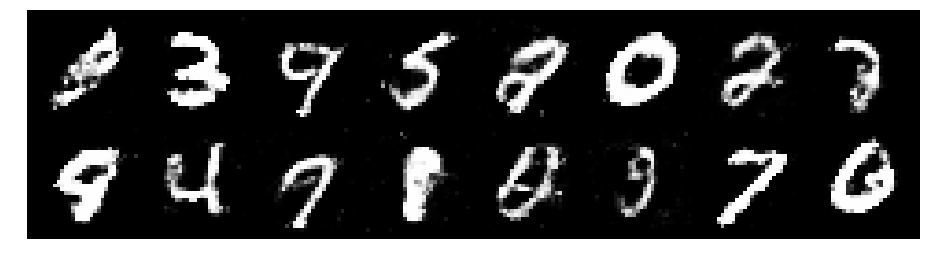

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.3518, Generator Loss: 0.7568
D(x): 0.5537, D(G(z)): 0.4881


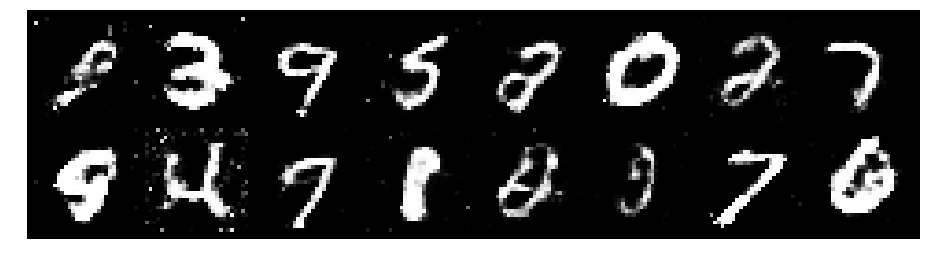

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2330, Generator Loss: 0.7839
D(x): 0.5679, D(G(z)): 0.4452


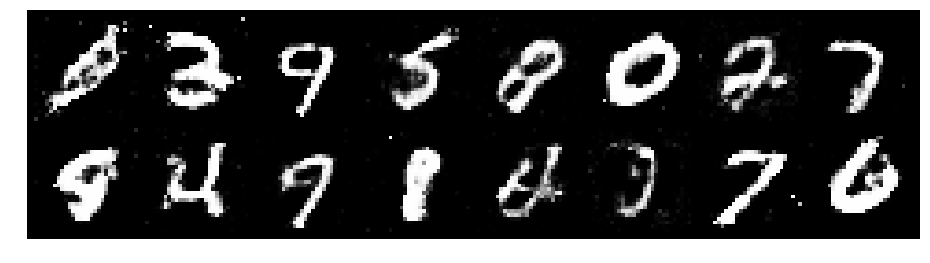

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3202, Generator Loss: 0.8438
D(x): 0.5192, D(G(z)): 0.4616


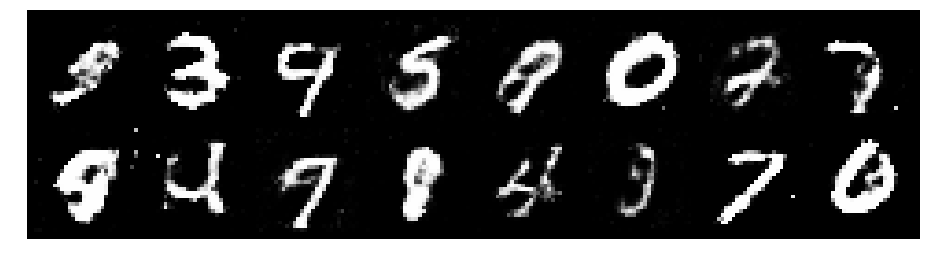

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2143, Generator Loss: 0.8368
D(x): 0.5995, D(G(z)): 0.4700


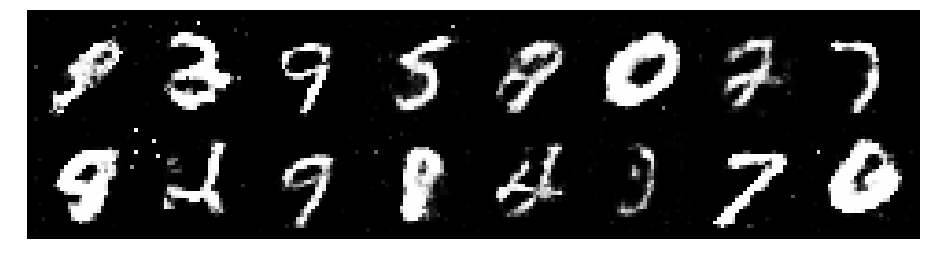

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2145, Generator Loss: 0.8295
D(x): 0.5811, D(G(z)): 0.4459


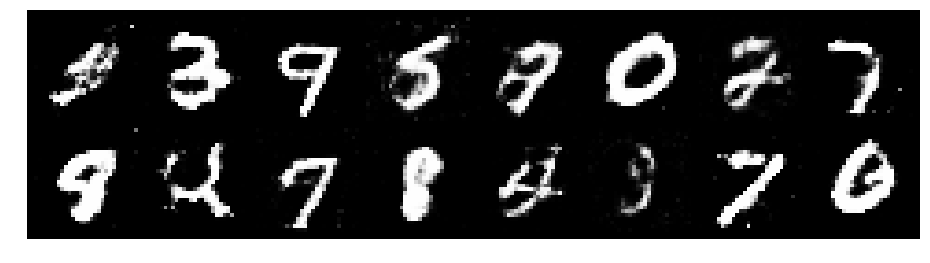

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2983, Generator Loss: 0.7787
D(x): 0.5828, D(G(z)): 0.4905


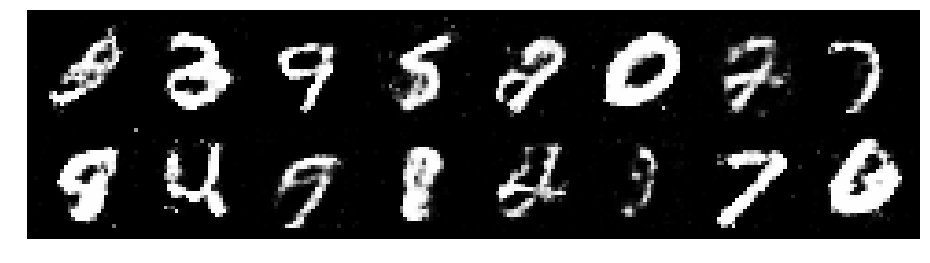

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.3590, Generator Loss: 0.7524
D(x): 0.5135, D(G(z)): 0.4768


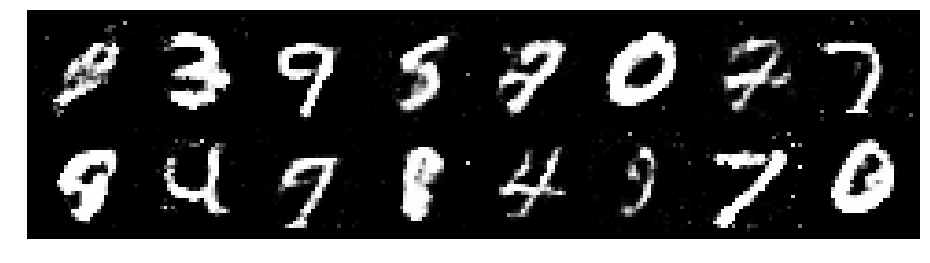

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8583
D(x): 0.5818, D(G(z)): 0.4808


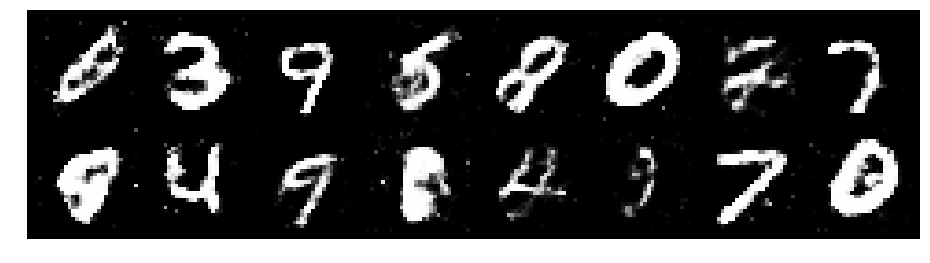

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.4025, Generator Loss: 0.7822
D(x): 0.5200, D(G(z)): 0.4942


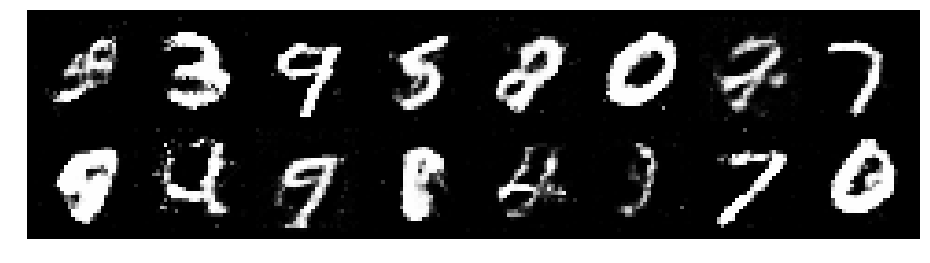

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.3261, Generator Loss: 0.7439
D(x): 0.5420, D(G(z)): 0.4841


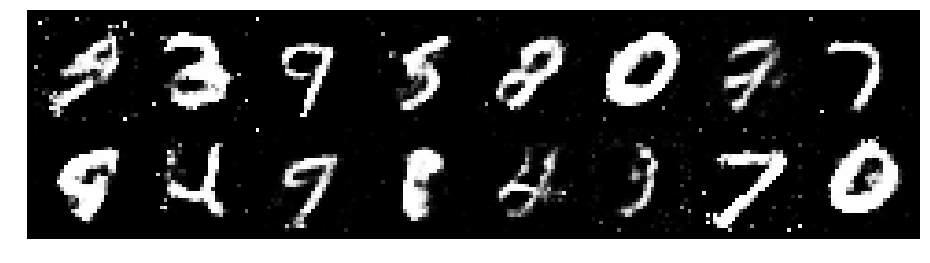

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2972, Generator Loss: 0.8521
D(x): 0.5292, D(G(z)): 0.4556


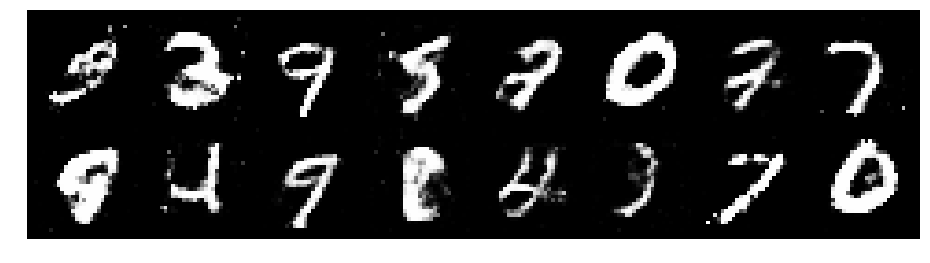

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2757, Generator Loss: 0.7762
D(x): 0.5779, D(G(z)): 0.4840


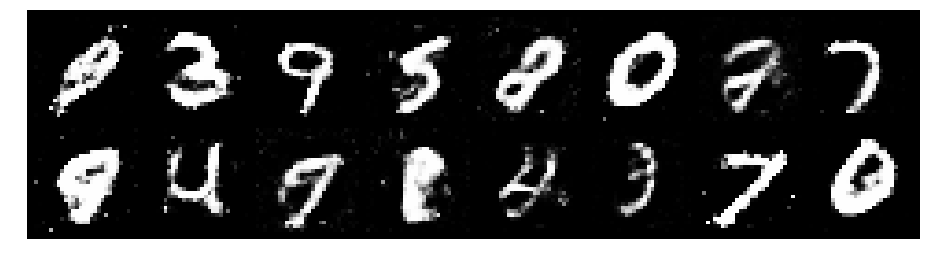

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3299, Generator Loss: 0.9350
D(x): 0.5733, D(G(z)): 0.4720


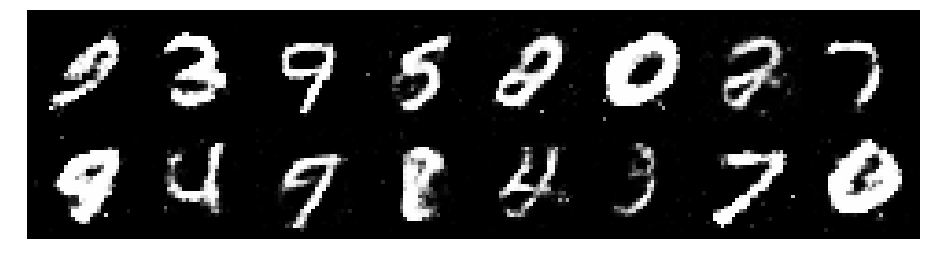

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.3864, Generator Loss: 0.7808
D(x): 0.5221, D(G(z)): 0.4856


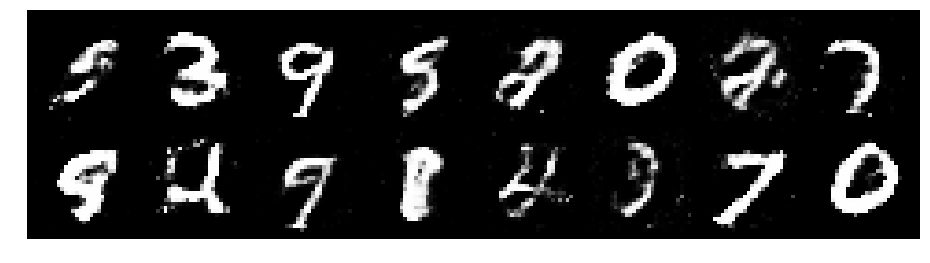

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2534, Generator Loss: 0.8272
D(x): 0.5712, D(G(z)): 0.4595


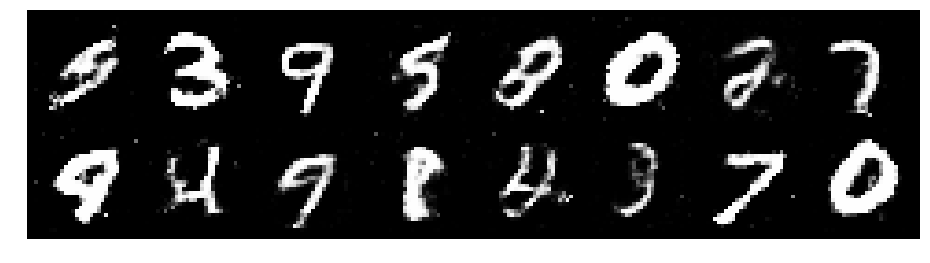

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.3520, Generator Loss: 1.0222
D(x): 0.5165, D(G(z)): 0.4234


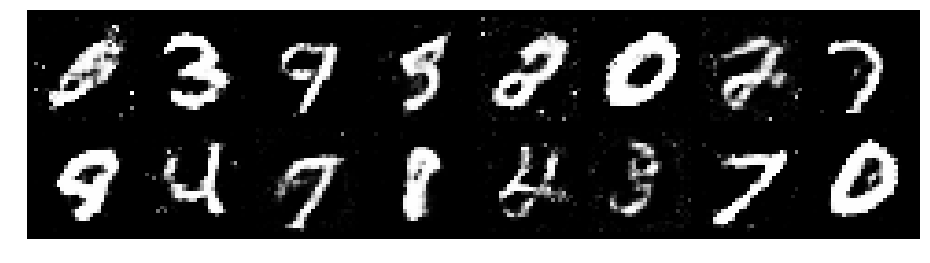

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2404, Generator Loss: 0.8930
D(x): 0.5983, D(G(z)): 0.4616


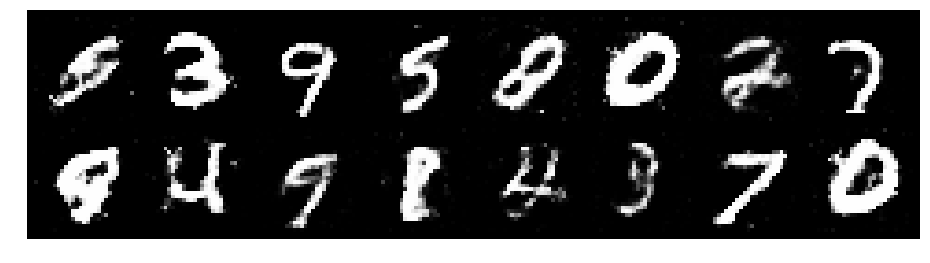

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2951, Generator Loss: 0.8706
D(x): 0.5993, D(G(z)): 0.4748


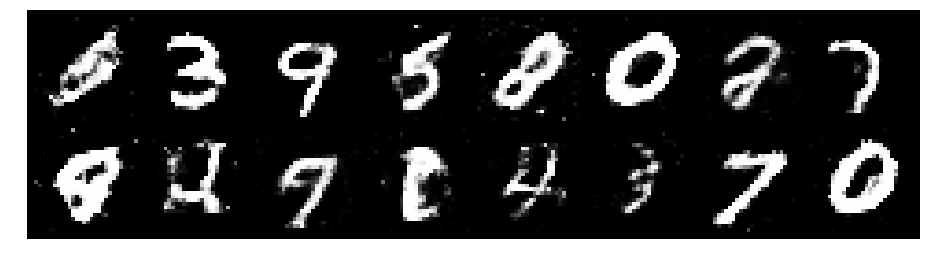

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2956, Generator Loss: 0.7965
D(x): 0.5101, D(G(z)): 0.4352


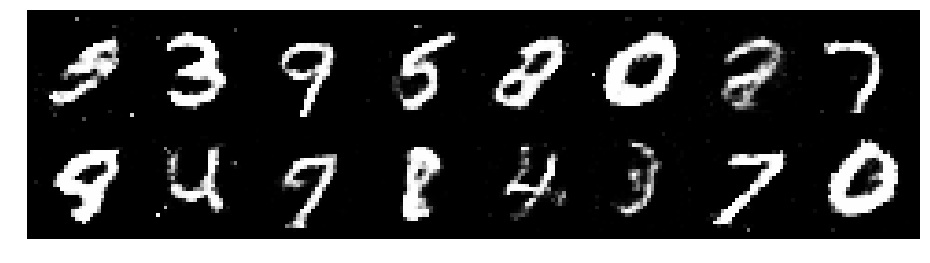

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2843, Generator Loss: 1.0611
D(x): 0.5378, D(G(z)): 0.4177


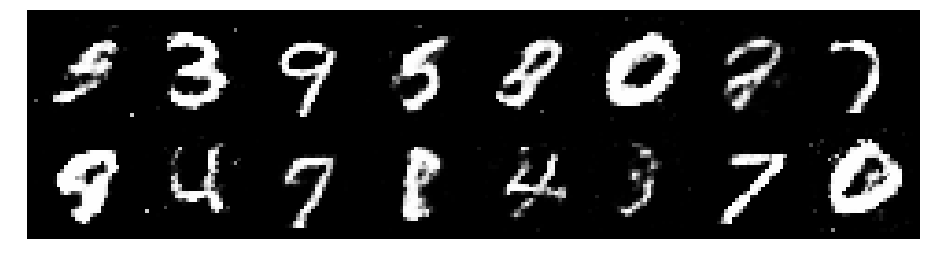

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3156, Generator Loss: 0.8540
D(x): 0.5526, D(G(z)): 0.4610


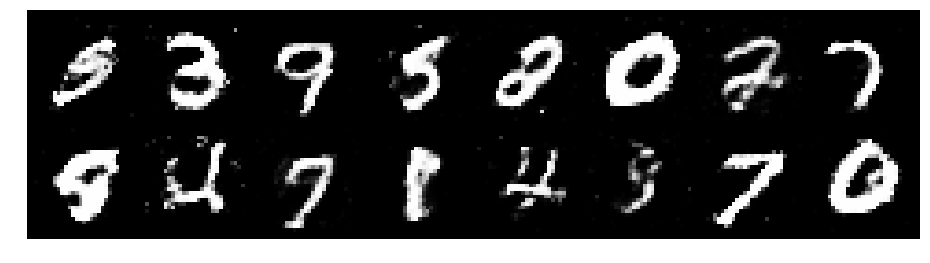

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3743, Generator Loss: 0.7759
D(x): 0.5259, D(G(z)): 0.4703


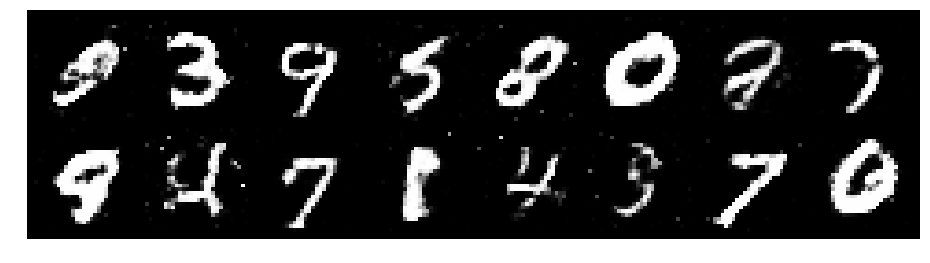

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.3408, Generator Loss: 0.9087
D(x): 0.5114, D(G(z)): 0.4404


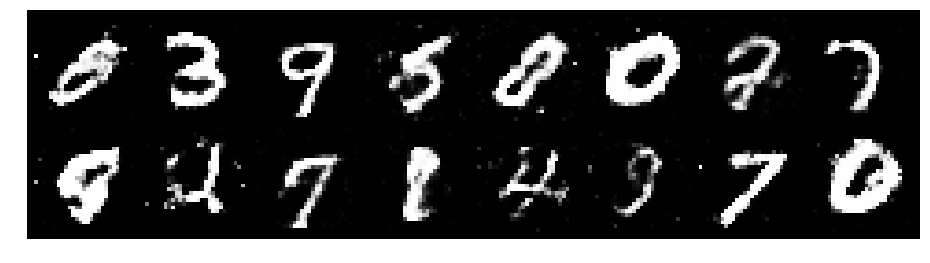

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2653, Generator Loss: 0.8807
D(x): 0.5707, D(G(z)): 0.4609


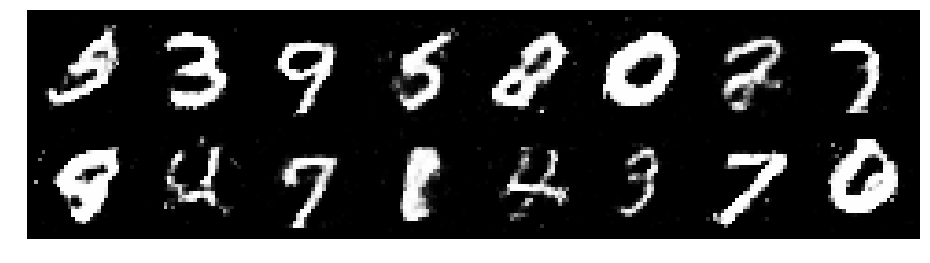

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3190, Generator Loss: 0.8560
D(x): 0.5608, D(G(z)): 0.4690


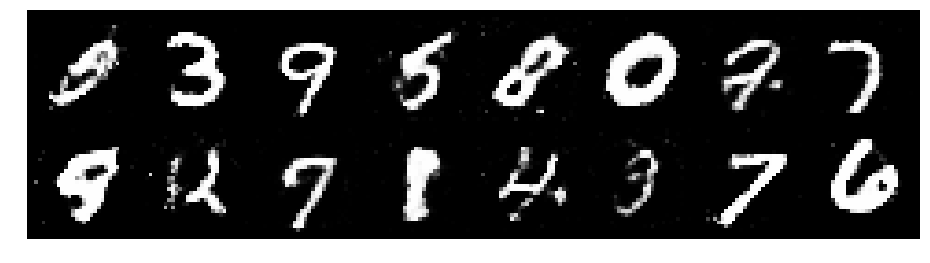

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8450
D(x): 0.5500, D(G(z)): 0.4440


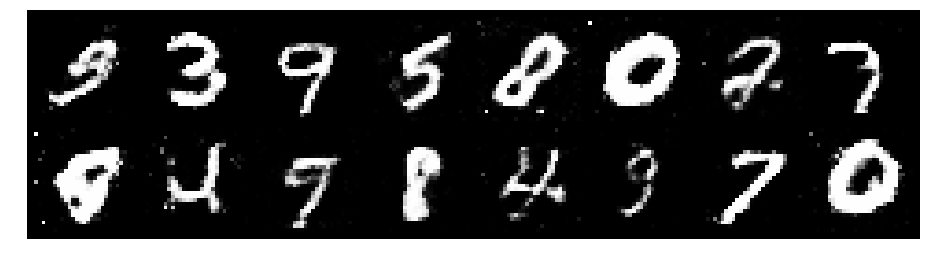

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9329
D(x): 0.5462, D(G(z)): 0.4418


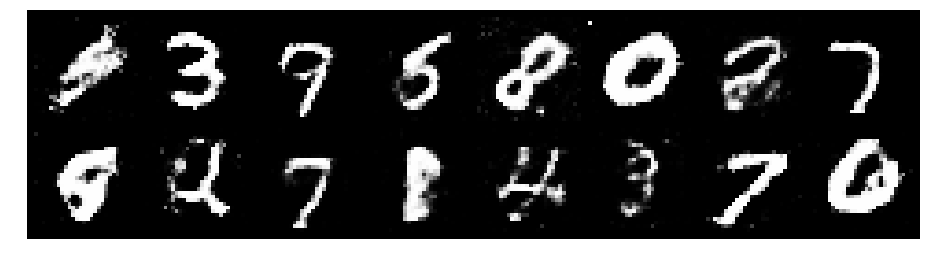

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2748, Generator Loss: 0.7870
D(x): 0.5484, D(G(z)): 0.4620


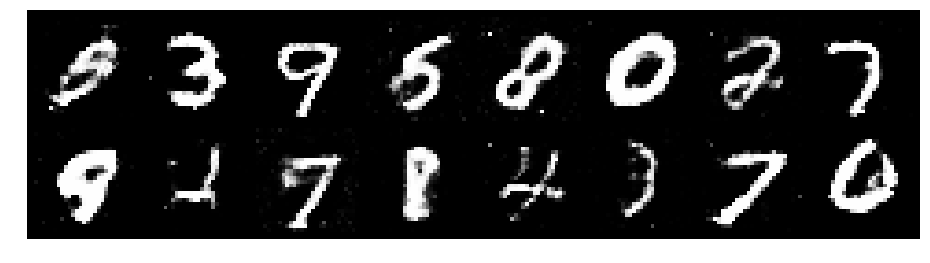

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3118, Generator Loss: 0.8389
D(x): 0.5238, D(G(z)): 0.4528


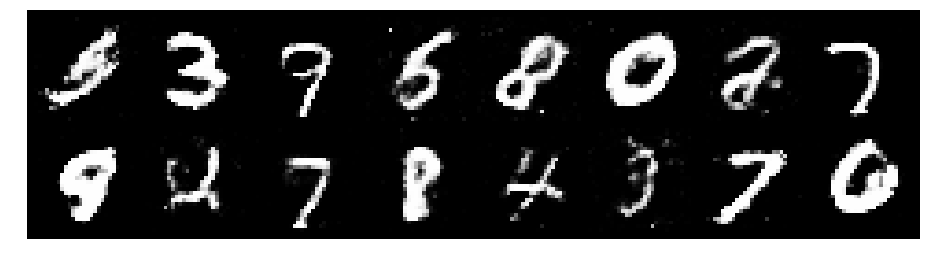

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2572, Generator Loss: 0.7892
D(x): 0.5501, D(G(z)): 0.4573


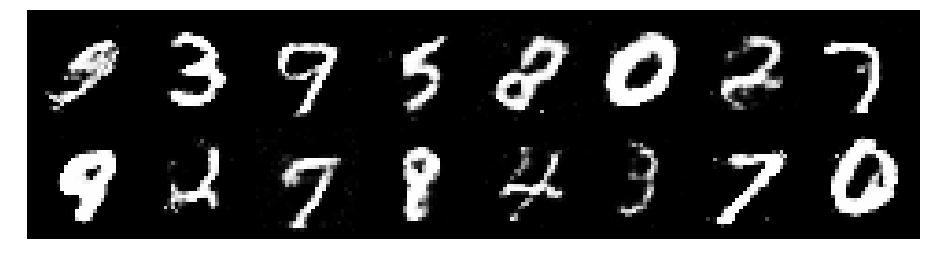

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2672, Generator Loss: 0.8351
D(x): 0.5295, D(G(z)): 0.4333


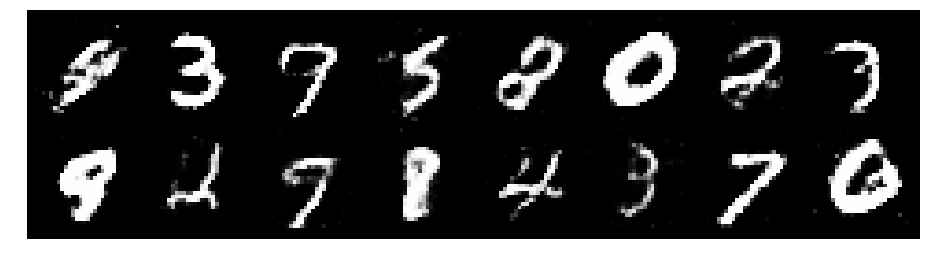

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2573, Generator Loss: 0.7086
D(x): 0.5982, D(G(z)): 0.4857


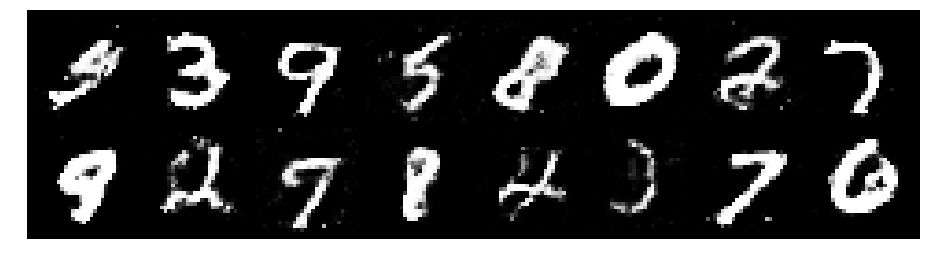

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2892, Generator Loss: 0.8406
D(x): 0.5541, D(G(z)): 0.4568


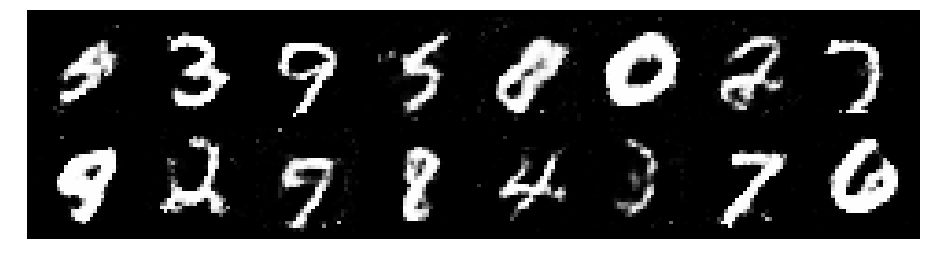

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2512, Generator Loss: 0.9938
D(x): 0.5474, D(G(z)): 0.4258


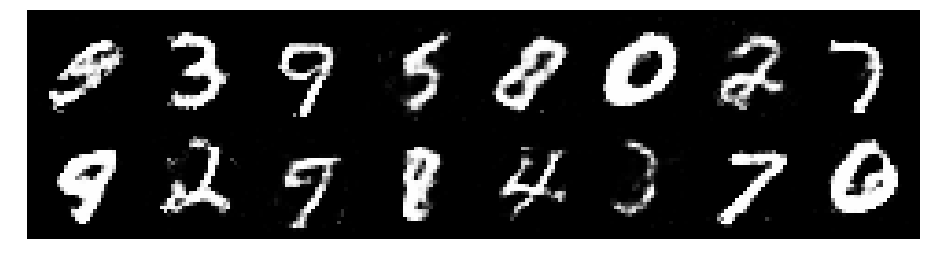

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3211, Generator Loss: 1.0219
D(x): 0.5178, D(G(z)): 0.3996


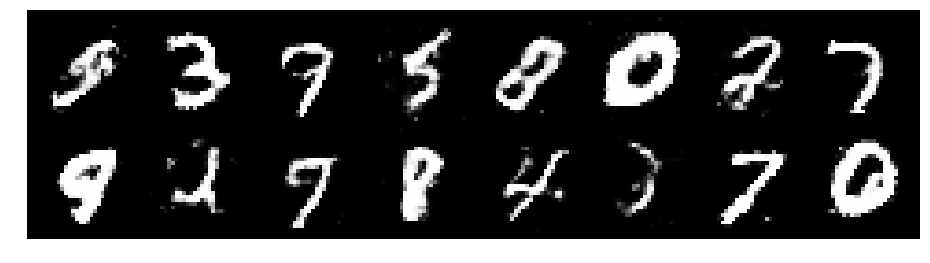

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2819, Generator Loss: 0.8413
D(x): 0.5677, D(G(z)): 0.4770


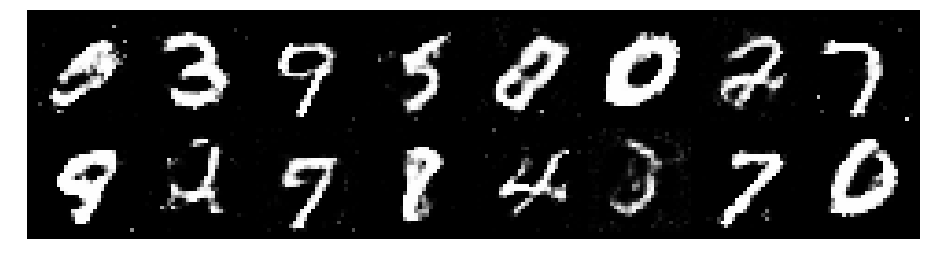

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.4399, Generator Loss: 0.8169
D(x): 0.5611, D(G(z)): 0.5294


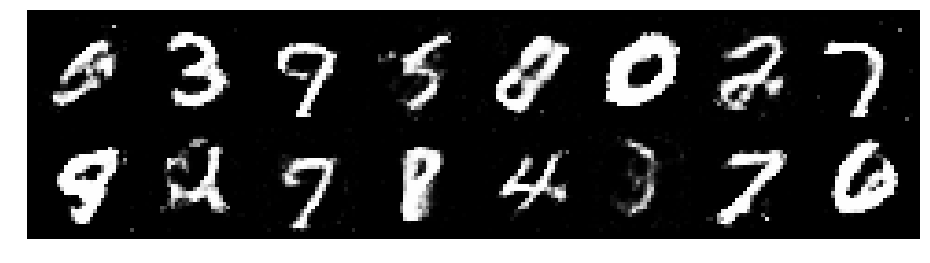

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8876
D(x): 0.5541, D(G(z)): 0.4281


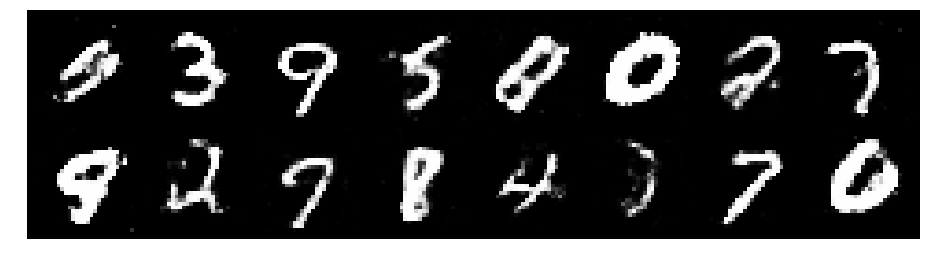

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2202, Generator Loss: 0.8241
D(x): 0.5850, D(G(z)): 0.4562


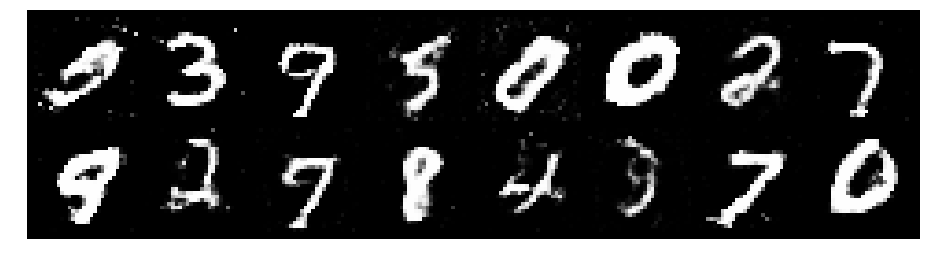

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3770, Generator Loss: 0.8478
D(x): 0.5367, D(G(z)): 0.4606


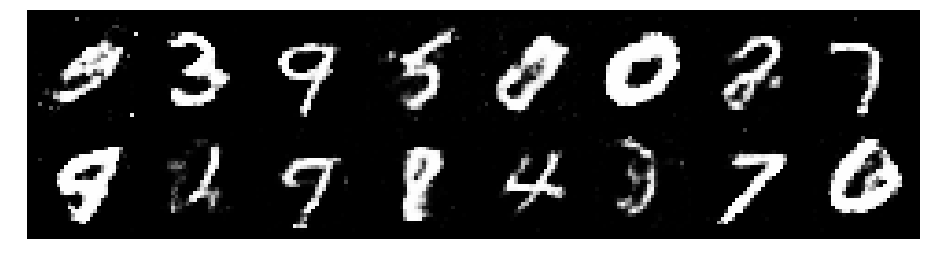

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3038, Generator Loss: 0.8654
D(x): 0.5274, D(G(z)): 0.4327


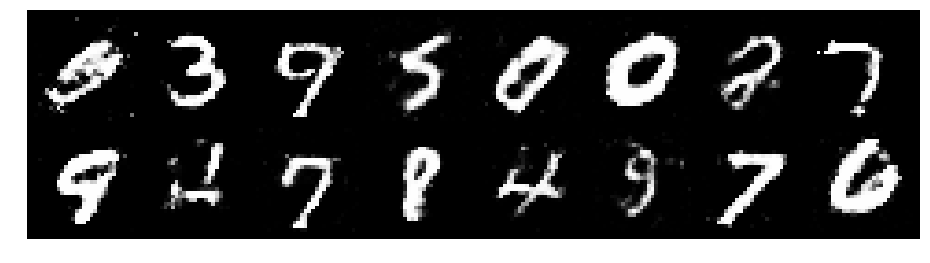

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8145
D(x): 0.5259, D(G(z)): 0.4376


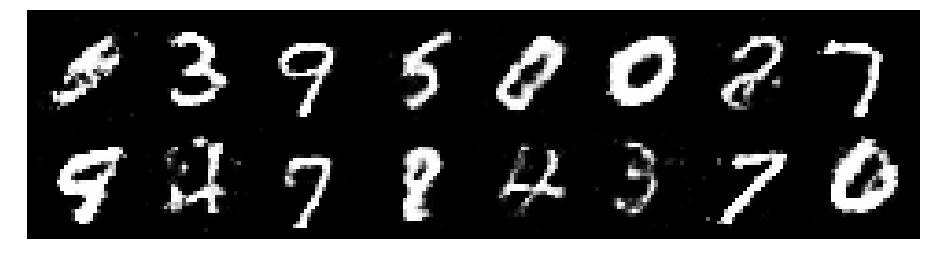

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.3016, Generator Loss: 0.9148
D(x): 0.5443, D(G(z)): 0.4722


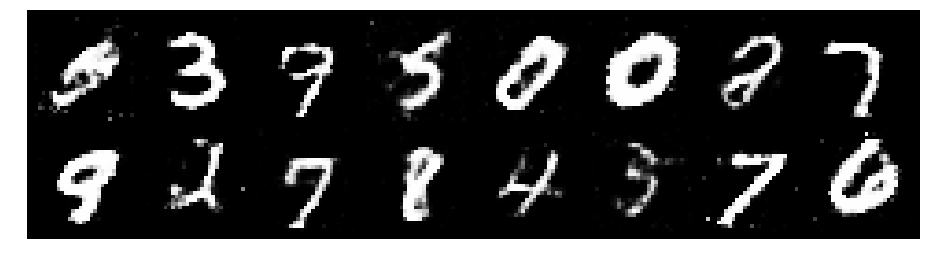

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.3067, Generator Loss: 0.8802
D(x): 0.5675, D(G(z)): 0.4611


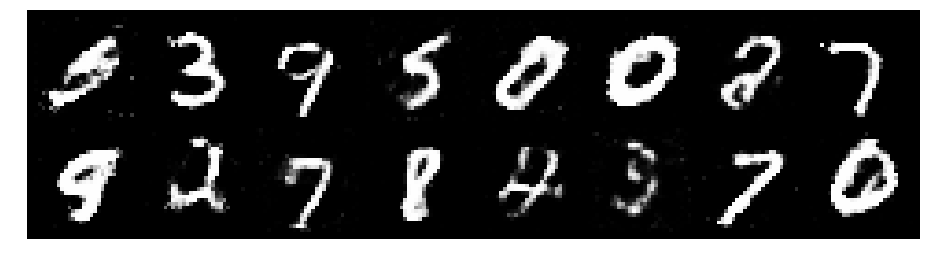

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.1779, Generator Loss: 0.9593
D(x): 0.5579, D(G(z)): 0.4018


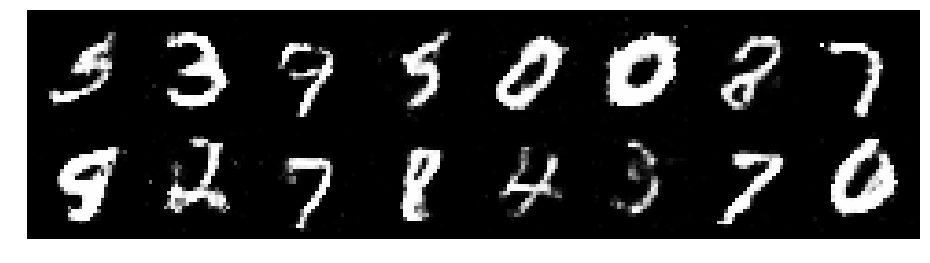

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.3447, Generator Loss: 0.7893
D(x): 0.5350, D(G(z)): 0.4719


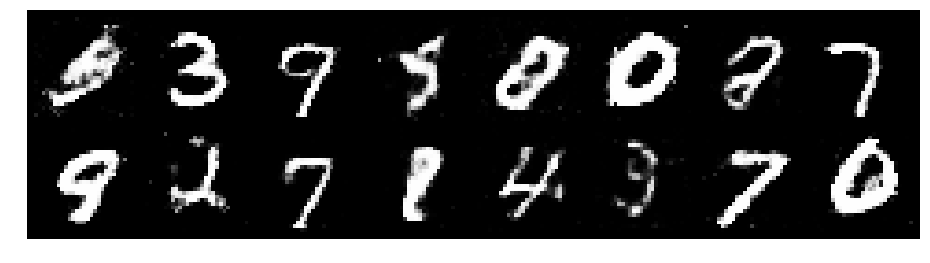

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2021, Generator Loss: 0.9285
D(x): 0.5709, D(G(z)): 0.4412


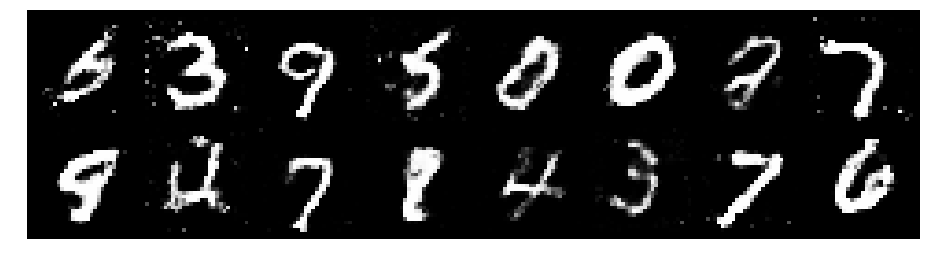

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9562
D(x): 0.5247, D(G(z)): 0.4032


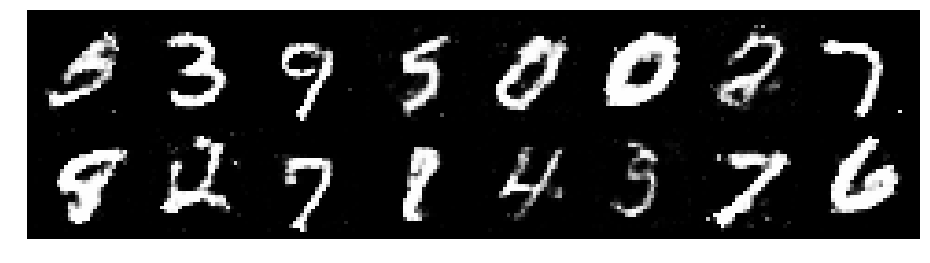

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.4030, Generator Loss: 0.8514
D(x): 0.4825, D(G(z)): 0.4499


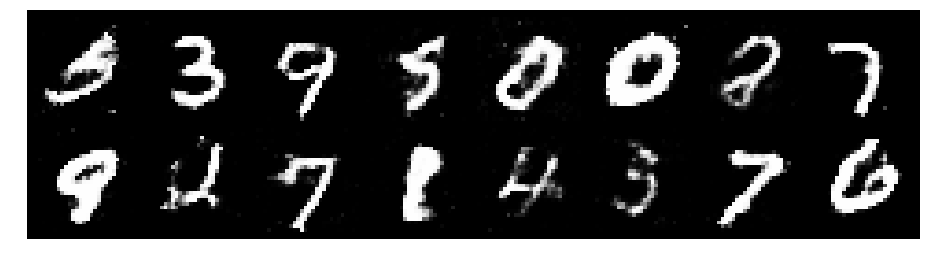

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.1909, Generator Loss: 0.8774
D(x): 0.5417, D(G(z)): 0.3936


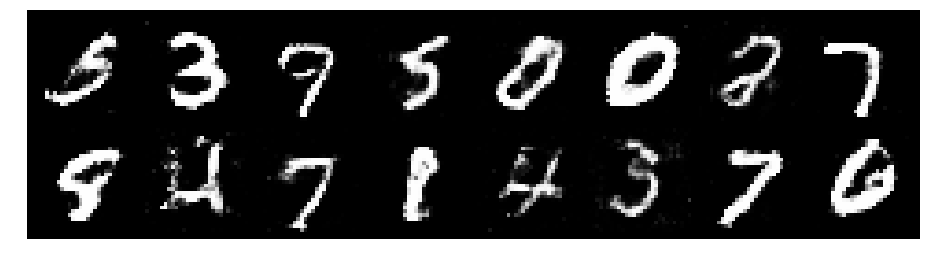

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9787
D(x): 0.5293, D(G(z)): 0.4257


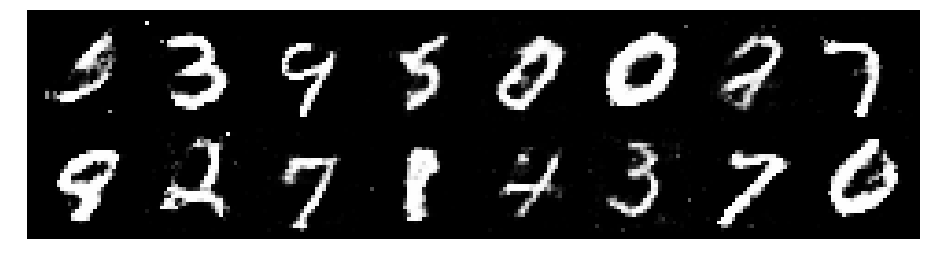

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.1534, Generator Loss: 0.9162
D(x): 0.5727, D(G(z)): 0.4117


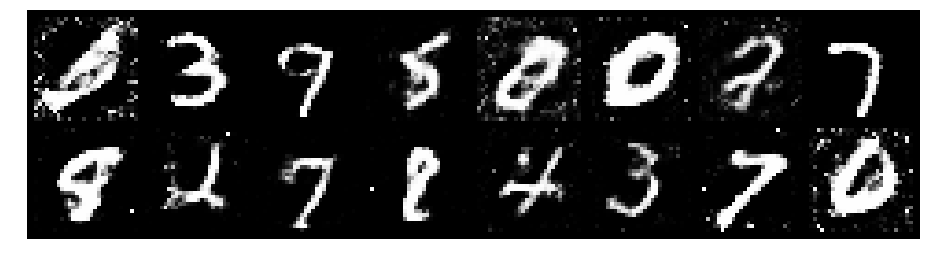

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.1621, Generator Loss: 0.8707
D(x): 0.5961, D(G(z)): 0.4379


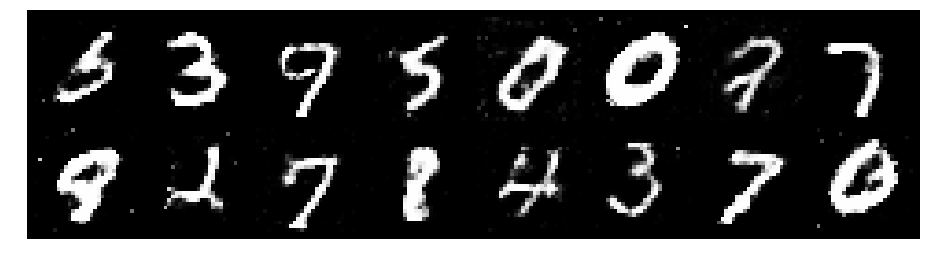

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.3219, Generator Loss: 0.8647
D(x): 0.5862, D(G(z)): 0.4626


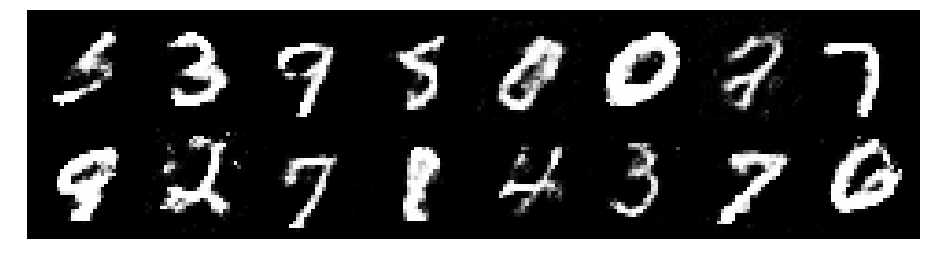

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.1598, Generator Loss: 1.0035
D(x): 0.5610, D(G(z)): 0.3756


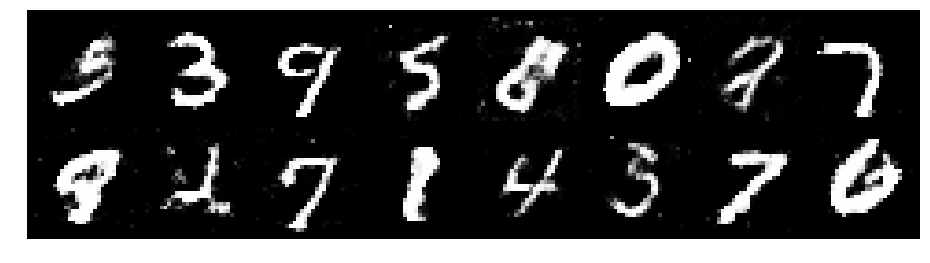

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1928, Generator Loss: 0.9959
D(x): 0.5813, D(G(z)): 0.4135


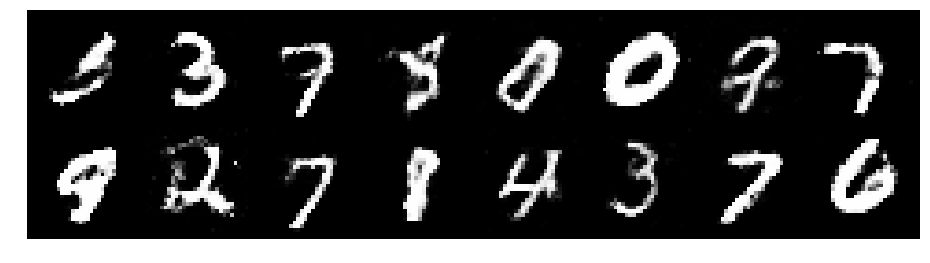

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2890, Generator Loss: 0.8512
D(x): 0.5550, D(G(z)): 0.4741


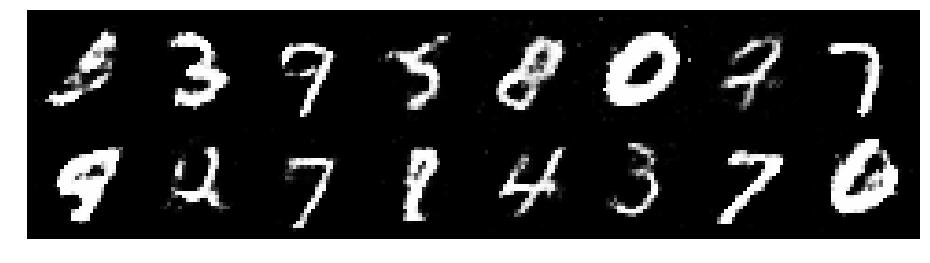

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2359, Generator Loss: 0.8279
D(x): 0.5582, D(G(z)): 0.4398


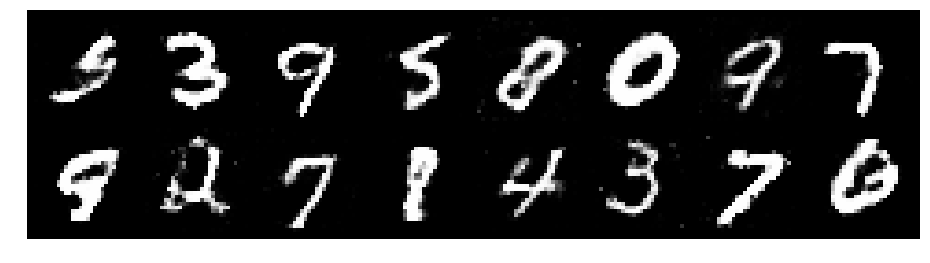

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2479, Generator Loss: 0.9137
D(x): 0.5476, D(G(z)): 0.4406


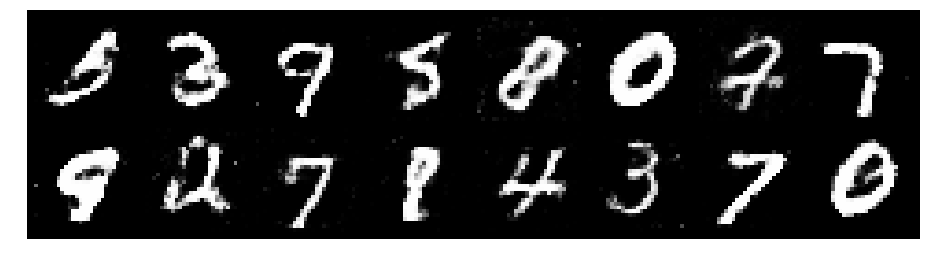

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2649, Generator Loss: 0.9220
D(x): 0.5655, D(G(z)): 0.4569


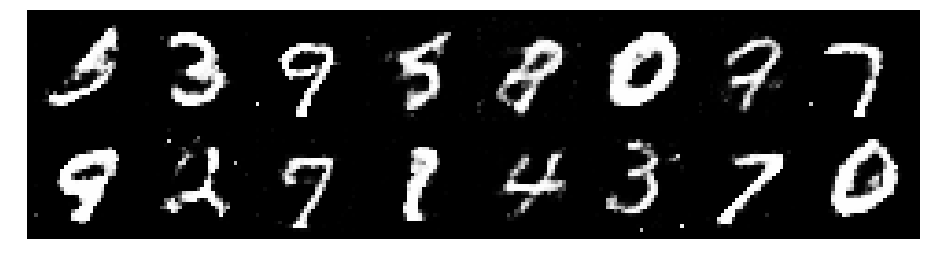

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8123
D(x): 0.5397, D(G(z)): 0.4591


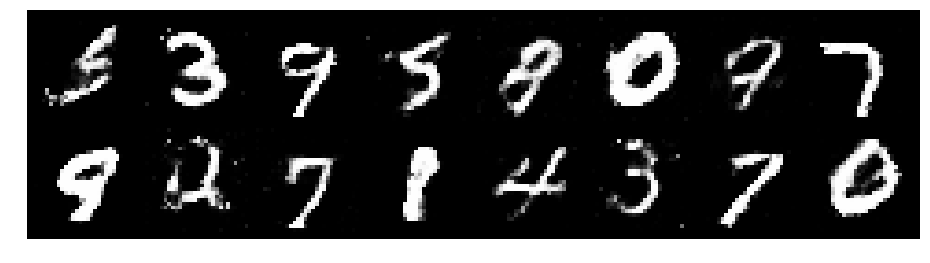

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2028, Generator Loss: 0.8598
D(x): 0.5809, D(G(z)): 0.4387


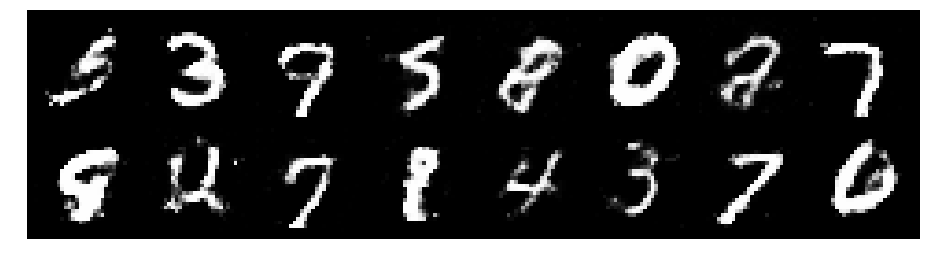

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8963
D(x): 0.5344, D(G(z)): 0.4267


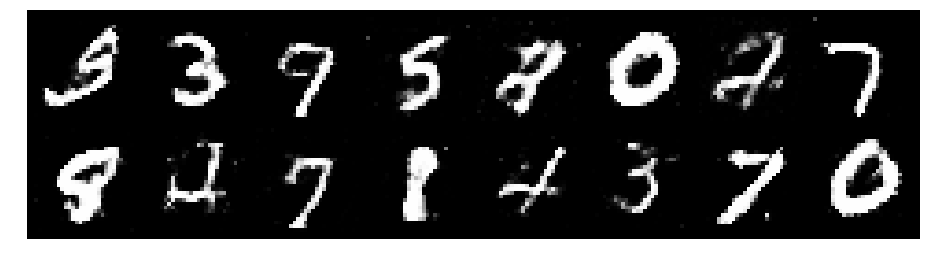

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2096, Generator Loss: 0.9317
D(x): 0.5735, D(G(z)): 0.4287


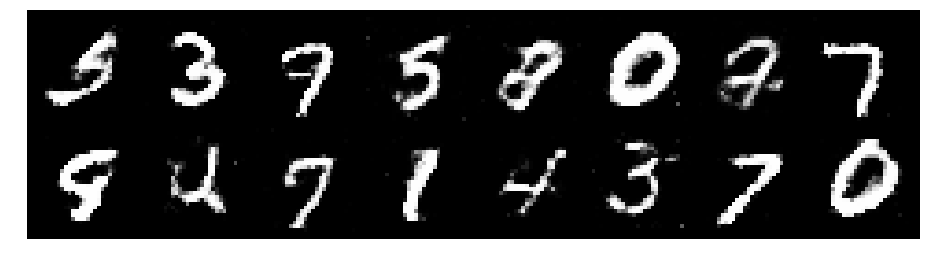

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3345, Generator Loss: 0.8014
D(x): 0.5292, D(G(z)): 0.4699


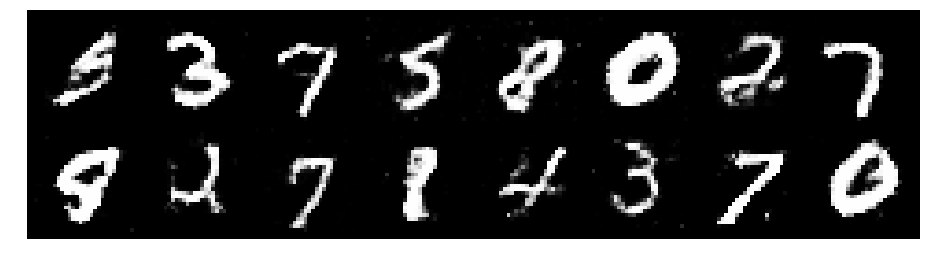

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8709
D(x): 0.5121, D(G(z)): 0.4246


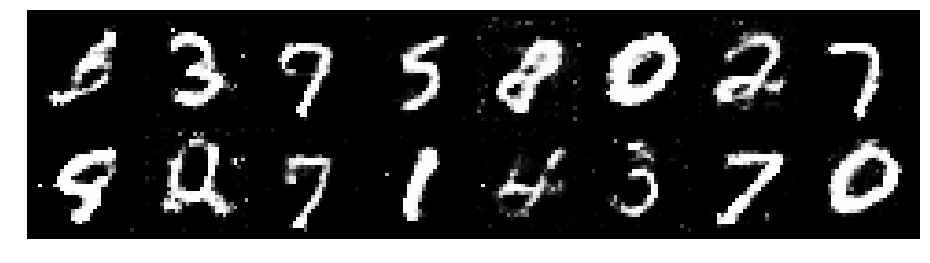

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2583, Generator Loss: 0.8246
D(x): 0.5445, D(G(z)): 0.4495


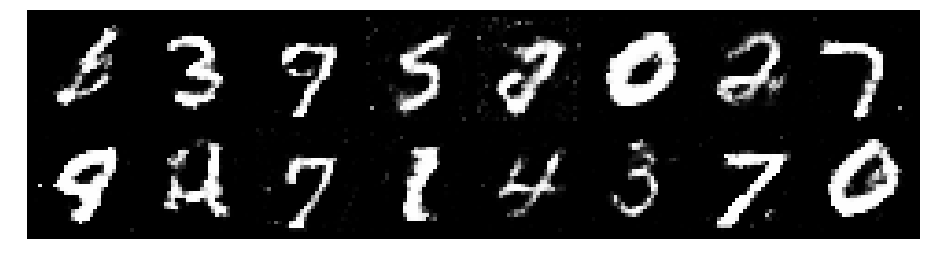

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3091, Generator Loss: 0.8937
D(x): 0.5227, D(G(z)): 0.4371


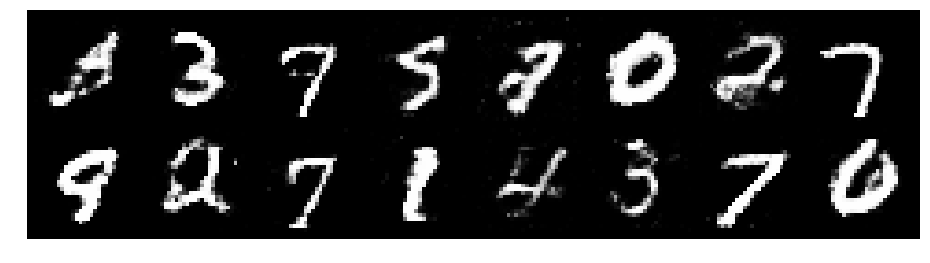

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8959
D(x): 0.5847, D(G(z)): 0.4641


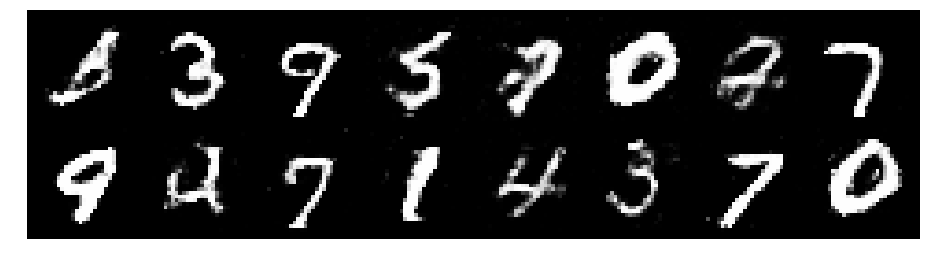

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.4337, Generator Loss: 0.8663
D(x): 0.5027, D(G(z)): 0.4636


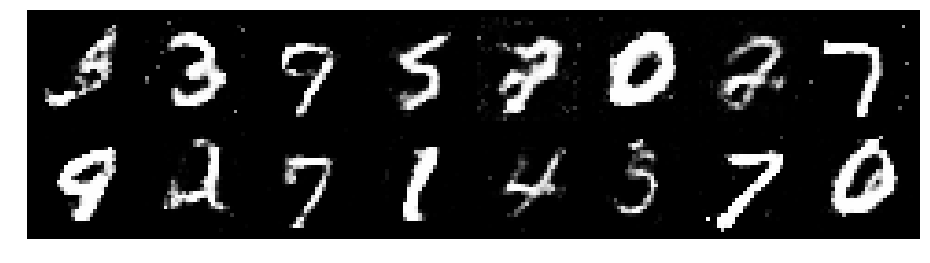

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3100, Generator Loss: 0.9757
D(x): 0.5326, D(G(z)): 0.4387


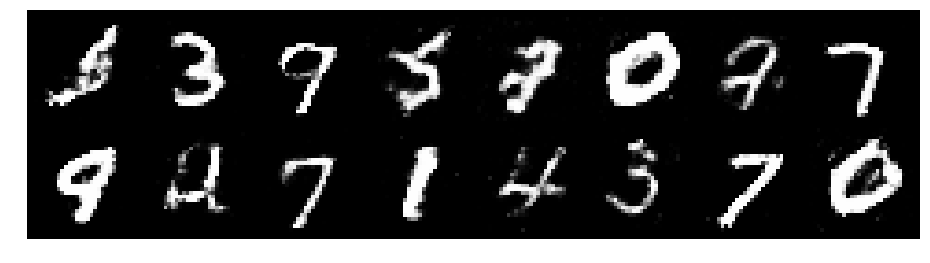

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2596, Generator Loss: 0.9571
D(x): 0.5522, D(G(z)): 0.4334


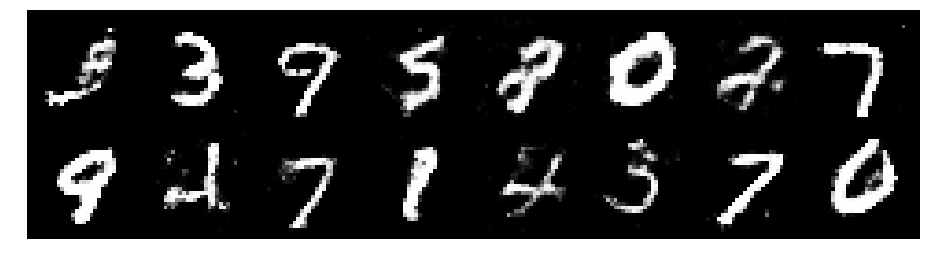

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2179, Generator Loss: 0.9986
D(x): 0.5480, D(G(z)): 0.4078


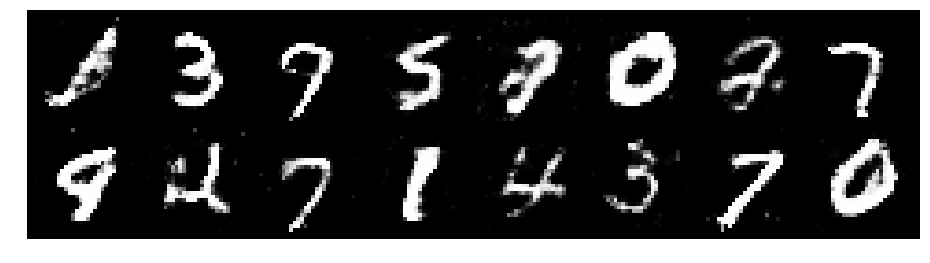

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2345, Generator Loss: 0.8959
D(x): 0.5894, D(G(z)): 0.4469


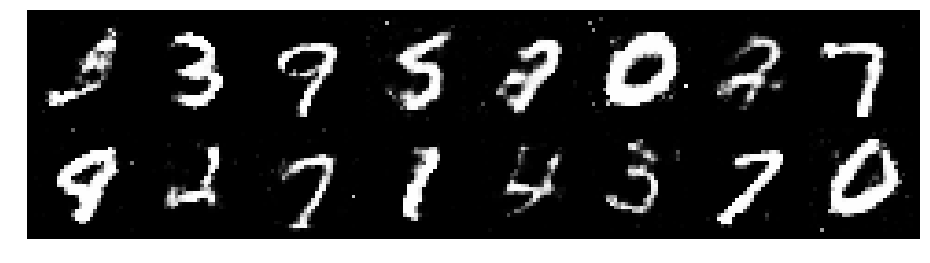

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3203, Generator Loss: 0.8721
D(x): 0.5600, D(G(z)): 0.4453


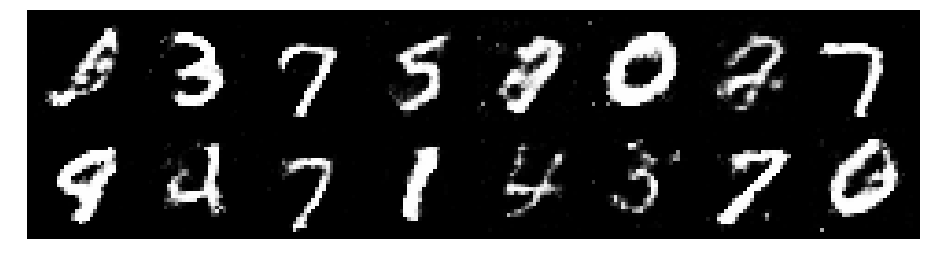

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3623, Generator Loss: 0.7618
D(x): 0.5271, D(G(z)): 0.4700


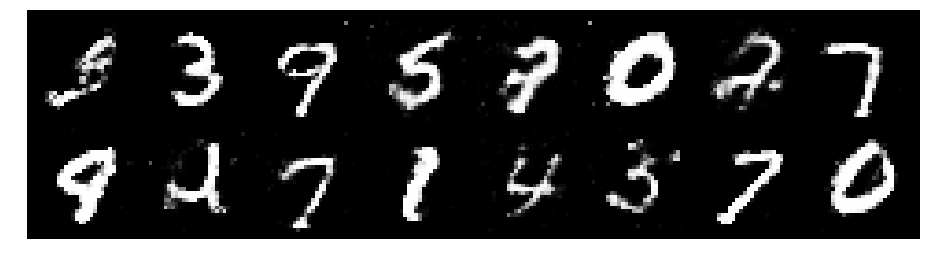

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3349, Generator Loss: 0.8333
D(x): 0.5526, D(G(z)): 0.4888


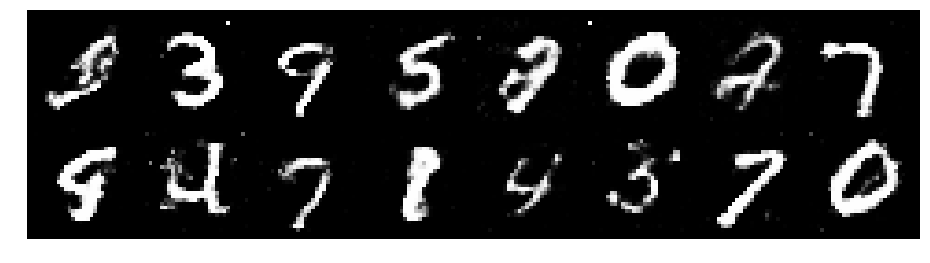

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2301, Generator Loss: 0.8765
D(x): 0.5717, D(G(z)): 0.4400


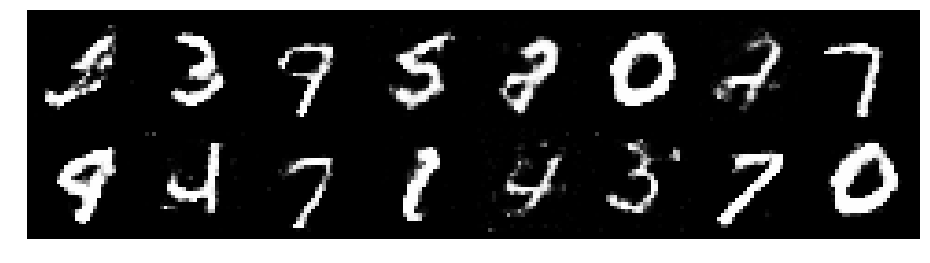

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3219, Generator Loss: 0.7780
D(x): 0.5694, D(G(z)): 0.4855


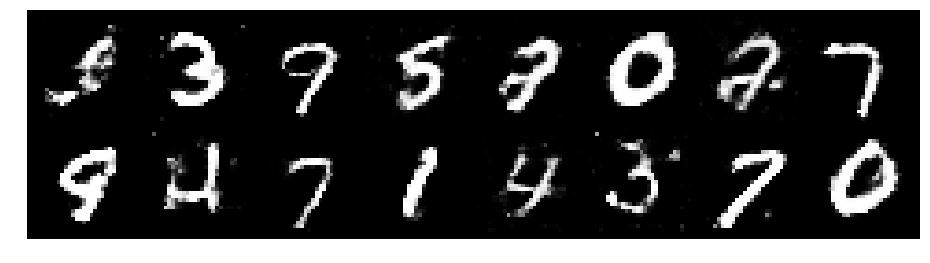

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3398, Generator Loss: 0.8021
D(x): 0.5109, D(G(z)): 0.4577


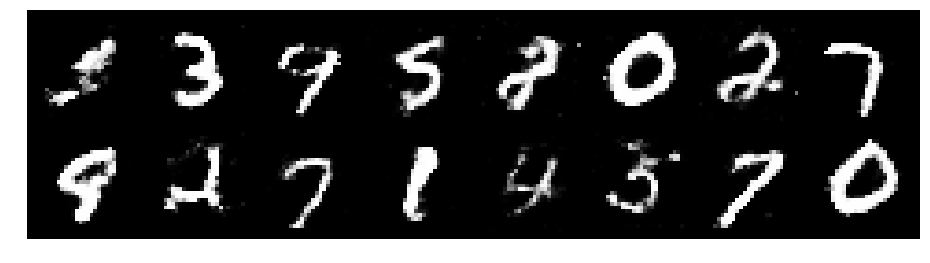

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3066, Generator Loss: 0.7897
D(x): 0.5358, D(G(z)): 0.4606


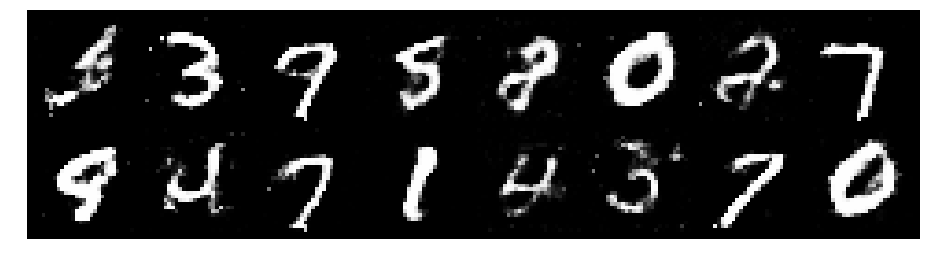

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.3445, Generator Loss: 0.8035
D(x): 0.5200, D(G(z)): 0.4755


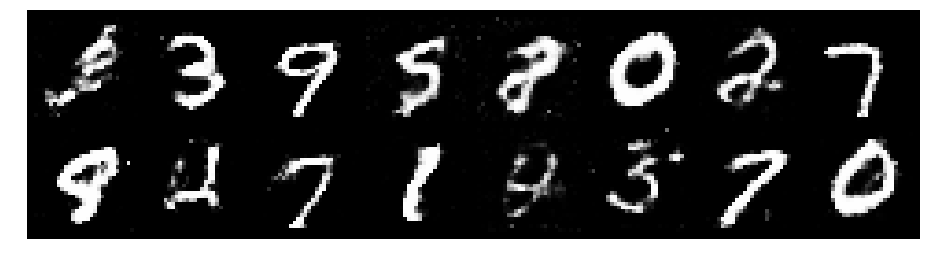

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3328, Generator Loss: 0.8795
D(x): 0.5192, D(G(z)): 0.4542


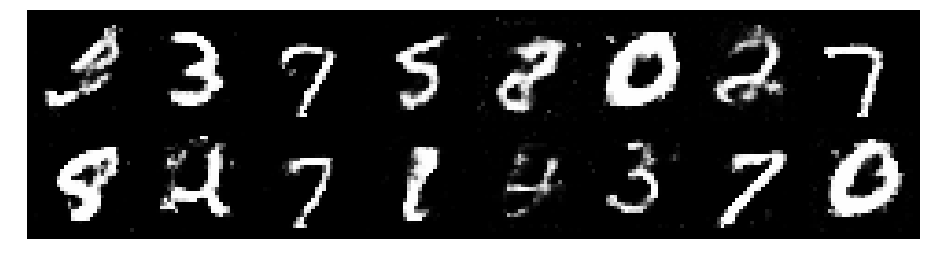

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2363, Generator Loss: 0.8789
D(x): 0.5702, D(G(z)): 0.4373


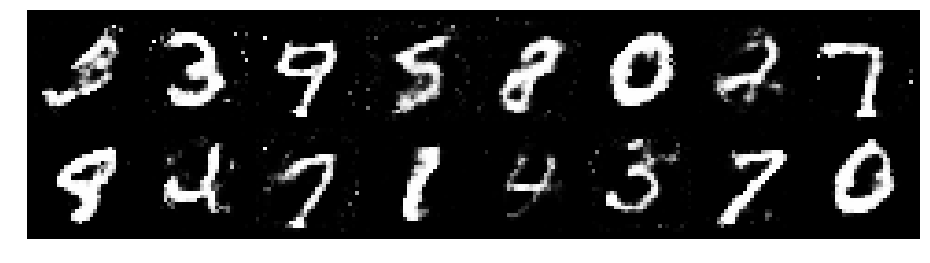

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3532, Generator Loss: 0.7411
D(x): 0.5589, D(G(z)): 0.5039


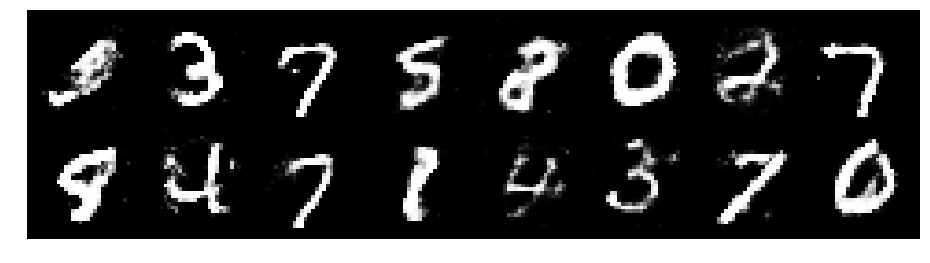

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.3197, Generator Loss: 0.8465
D(x): 0.5630, D(G(z)): 0.4787


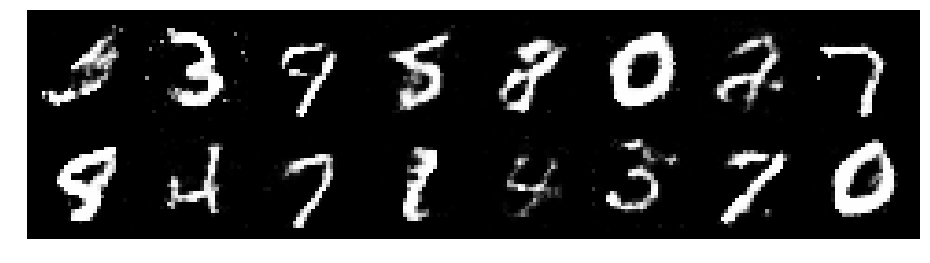

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2912, Generator Loss: 0.8466
D(x): 0.5579, D(G(z)): 0.4605


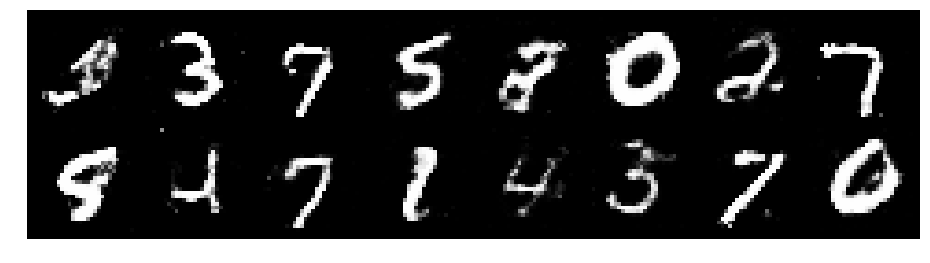

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8554
D(x): 0.5227, D(G(z)): 0.4555


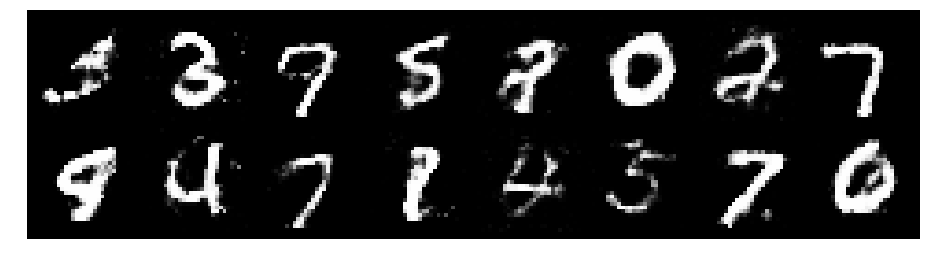

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3120, Generator Loss: 0.7937
D(x): 0.5712, D(G(z)): 0.4807


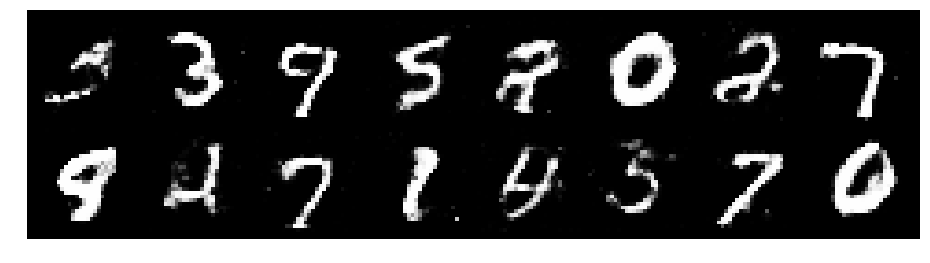

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8242
D(x): 0.5346, D(G(z)): 0.4236


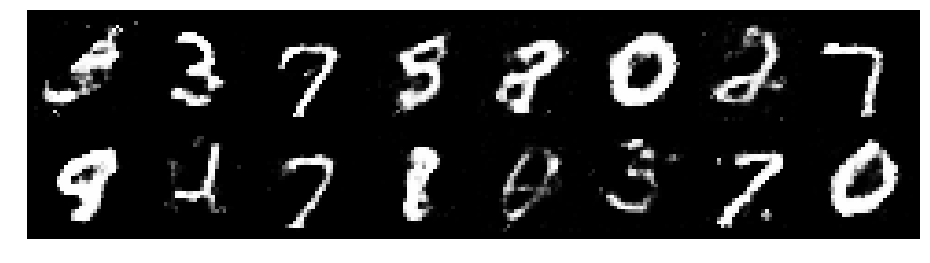

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2992, Generator Loss: 0.8317
D(x): 0.5512, D(G(z)): 0.4765


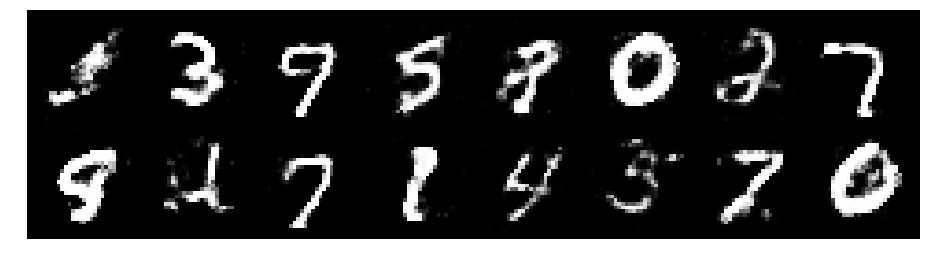

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2935, Generator Loss: 0.8062
D(x): 0.5507, D(G(z)): 0.4758


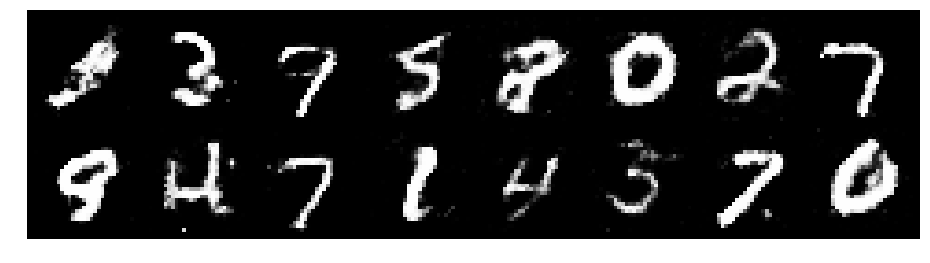

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8252
D(x): 0.5599, D(G(z)): 0.4644


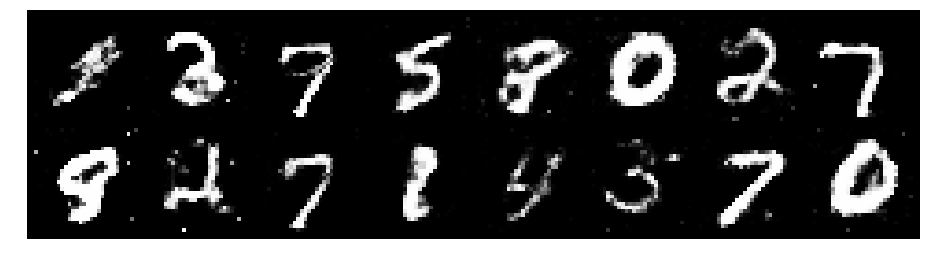

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8442
D(x): 0.5279, D(G(z)): 0.4455


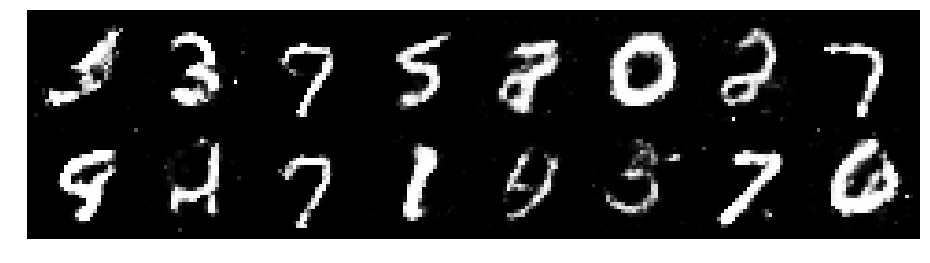

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2734, Generator Loss: 1.1523
D(x): 0.5614, D(G(z)): 0.4079


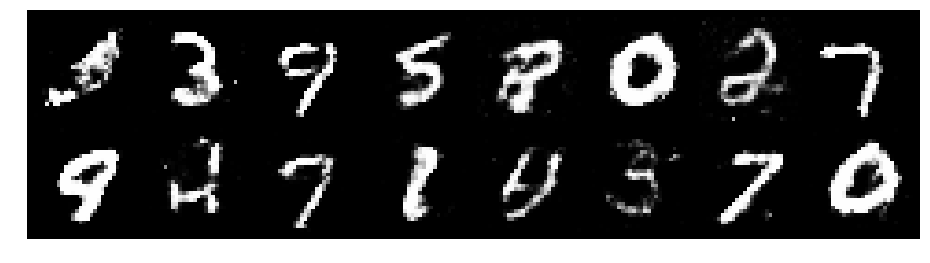

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2946, Generator Loss: 0.8574
D(x): 0.5182, D(G(z)): 0.4344


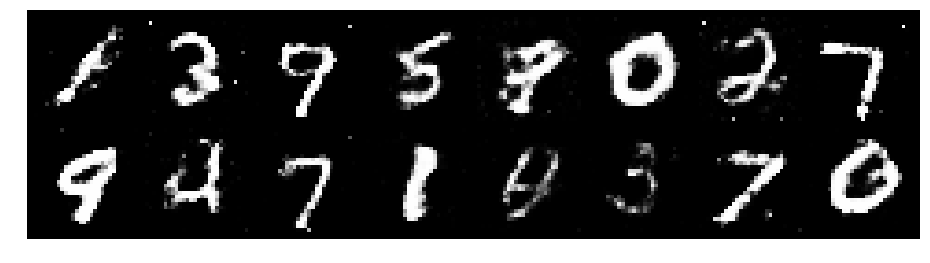

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2881, Generator Loss: 0.8731
D(x): 0.5474, D(G(z)): 0.4456


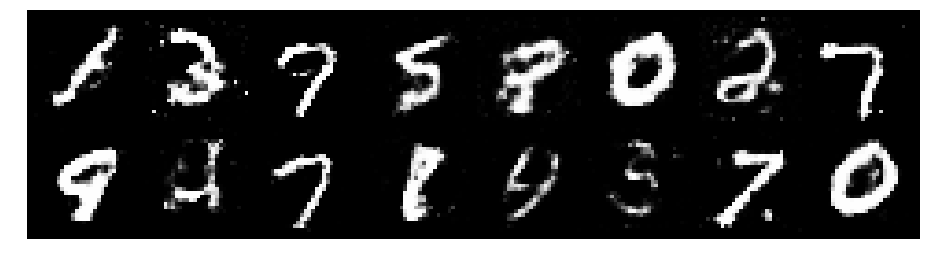

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2194, Generator Loss: 0.8624
D(x): 0.5703, D(G(z)): 0.4407


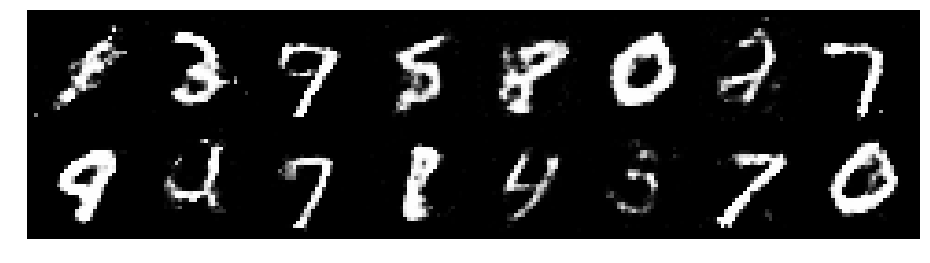

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2512, Generator Loss: 0.8813
D(x): 0.5429, D(G(z)): 0.4317


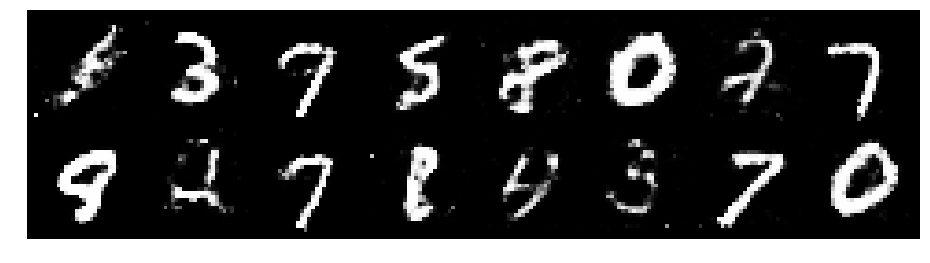

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2461, Generator Loss: 0.8681
D(x): 0.5527, D(G(z)): 0.4477


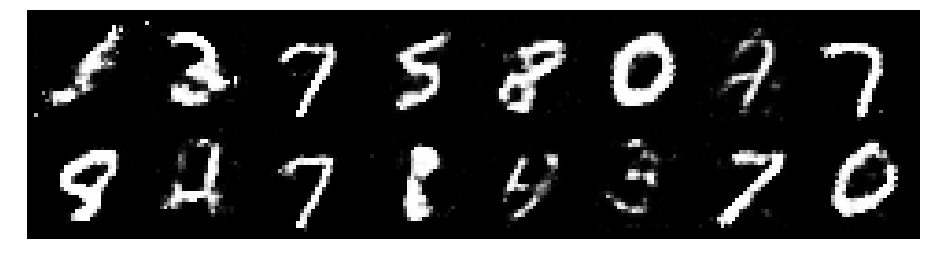

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8097
D(x): 0.5645, D(G(z)): 0.4500


In [ ]:
# Logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# Total number of epochs to train
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        
        # Generate fake data an detach
        # (So gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        
        # Train D
        d_error, d_pred_real, d_pred_fake = train_discriminator(d_optimizer, real_data, fake_data)
        
        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        # Display Progress every few batches
        if (n_batch) % 100 == 0:
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            
            logger.log_images(
                test_images, num_test_samples,
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            );
        